# Exercise 3: Shape Reconstruction

**Submission Deadline**: 16.06.2022, 23:55

We will take a look at two major approaches for 3D shape reconstruction in this last exercise.

Like in exercise 2, you can run all trainings either locally or on Google Colab. Just follow the instructions below. 

Note that training reconstruction methods generally takes relatively long, even for simple shape completion. Training the generalization will take a few hours. *Thus, please make sure to start training well before the submission deadline.*

## 3.0. Running this notebook
We recommend running this notebook on a cuda compatible local gpu. You can also run training on cpu, it will just take longer.

We describe two options for executing the training parts of this exercise below: Using Google Colab or running it locally on your machine. If you are not planning on using Colab, just skip forward to Local Execution.

### Google Colab

If you don't have access to gpu and don't wish to train on CPU, you can use Google Colab. However, we experienced the issue that inline visualization of shapes or inline images didn't work on colab, so just keep that in mind.
What you can also do is only train networks on colab, download the checkpoint, and visualize inference locally.

In case you're using Google Colab, you can upload the exercise folder (containing `exercise_3.ipynb`, directory `exercise_3` and the file `requirements.txt`) as `3d-machine-learning` to google drive (make sure you don't upload extracted datasets files).
Additionally you'd need to open the notebook `exercise_3.ipynb` in Colab using `File > Open Notebook > Upload`.

Next you'll need to run these two cells for setting up the environment. Before you do that make sure your instance has a GPU.

In [ ]:
import os
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

# We assume you uploaded the exercise folder in root Google Drive folder

!cp -r /content/drive/MyDrive/3d-machine-learning 3d-machine-learning/
os.chdir('/content/3d-machine-learning/')
print('Installing requirements')
!pip install -r requirements.txt

# Make sure you restart runtime when directed by Colab


Run this cell after restarting your colab runtime

In [ ]:
import os
import sys
import torch
os.chdir('/content/3d-machine-learning/')
sys.path.insert(1, "/content/3d-machine-learning/")
print('CUDA availability:', torch.cuda.is_available())

### Local Execution

If you run this notebook locally, you have to first install the python dependiencies again. They are the same as for exercise 1 so you can re-use the environment you used last time. If you use [poetry](https://python-poetry.org), you can also simply re-install everything (`poetry install`) and then run this notebook via `poetry run jupyter notebook`.

### Imports

The following imports should work regardless of whether you are using Colab or local execution.

In [1]:
%load_ext autoreload
%autoreload 2
from pathlib import Path
import numpy as np
import matplotlib as plt
import k3d
import trimesh
import torch
import skimage

Use the next cell to test whether a GPU was detected by pytorch.

In [2]:
torch.cuda.is_available()

True

## 3.1 Shape Reconstruction from 3D SDF grids with 3D-EPN

In the first part of this exercise, we will take a look at shape complation using [3D-EPN](https://arxiv.org/abs/1612.00101). This approach was also introduced in the lecture.

The visualization below shows an overview of the method: From an incomplete shape observation (which you would get when scanning an object with a depth sensor for example), we use a 3D encoder-predictor network that first encodes the incomplete shapes into a common latent space using several 3D convolution layers and then decodes them again using multiple 3D transpose convolutions.

This way, we get from a 32^3 SDF voxel grid to a 32^3 DF (unsigned) voxel grid that represents the completed shape. We only focus on this part here; in the original implementation, this 32^3 completed prediction would then be further improved (in an offline step after inference) by sampling parts from a shape database to get the final resolution to 128^3.

<img src="exercise_3/images/3depn_teaser.png" alt="3D-EPN Teaser" style="width: 800px;"/>

The next steps will follow the structure we established in exercise 2: Taking a look at the dataset structure and downloading the data; then, implementing dataset, model, and training loop.

### (a) Downloading the data
We will use the original dataset used in the official implementation. It consists of SDF and DF grids (representing incomplete input data and complete target data) with a resolution of 32^3 each. Each input-target pair is generated from a ShapeNet shape.

The incomplete SDF data are generated by sampling virtual camera trajectories around every object. Each trajectory is assigned an ID which is part of the file names (see below). The camera views for each trajectory are combined into a common SDF grid by volumetric fusion. It is easy to generate an SDF here since we know both camera location and object surface: Everything between camera and surface is known free space and outside the object, leading to a positive SDF sign. Everything behind the surface has a negative sign. For the complete shapes, however, deciding whether a voxel in the DF grid is inside or outside an object is not a trivial problem. This is why we use unsigned distance fields as target and prediction representation instead. This still encodes the distance to the closest surface but does not contain explicit information about the inside/outside location.

In terms of dataset layout, we follow the ShapeNet directory structure as seen in the last exercise:
Each folder in the `exercise_3/data/shapenet_dim32_sdf` and `exercise_3/data/shapenet_dim32_df` directories contains one shape category represented by a number, e.g. `02691156`.
We provide the mapping between these numbers and the corresponding names in `exercise_3/data/shape_info.json`. Each of these shape category folders contains lots of shapes in sdf or df format. In addition to that, every shape now also contains multiple trajectories: 0 to 7, encoded as `__0__` to `__7__`. These 8 files are just different input representations, meaning they vary in the level of completeness and location of missing parts; they all map to the `.df` file with corresponding shape ID and `__0__` at the end.

```
# contents of exercise_2/data/shapenet_dim32_sdf
02691156/                                           # Shape category folder with all its shapes
    ├── 10155655850468db78d106ce0a280f87__0__.sdf   # Trajectory 0 for a shape of the category
    ├── 10155655850468db78d106ce0a280f87__1__.sdf   # Trajectory 1 for the same shape
    ├── :                                      
    ├── 10155655850468db78d106ce0a280f87__7__.sdf   # Trajectory 7 for the same shape
    ├── 10155655850468db78d106ce0a280f87__0__.sdf   # Trajectory 0 for another shape
    ├── :                                           # And so on ...
02933112/                                           # Another shape category folder
02958343/                                           # In total you should have 8 shape category folders
:

# contents of exercise_2/data/shapenet_dim32_df
02691156/                                           # Shape category folder with all its shapes
    ├── 10155655850468db78d106ce0a280f87__0__.df    # A single shape of the category
    ├── 1021a0914a7207aff927ed529ad90a11__0__.df    # Another shape of the category
    ├── :                                           # And so on ...
02933112/                                           # Another shape category folder
02958343/                                           # In total you should have 55 shape category folders
:
```

Download and extract the data with the code cell below.

**Note**: If you are training on Google Colab and are running out of disk space, you can do the following:
- Only download the zip files below without extracting them (comment out all lines after `print('Extracting ...')`)
- Change `from exercise_3.data.shapenet import ShapeNet` to `from exercise_3.data.shapenet_zip import ShapeNet`
- Implement your dataset in `shapenet_zip.py`. This implementation extracts the data on-the-fly without taking up any additional disk space. Your training will therefore run a bit slower.
- Make sure you uncomment the lines setting the worker_init_fn in `train_3depn.py` (marked with TODOs)

In [49]:
print('Downloading ...')
# File sizes: 11GB for shapenet_dim32_sdf.zip (incomplete scans), 4GB for shapenet_dim32_df.zip (target shapes)
#!wget http://kaldir.vc.in.tum.de/adai/CNNComplete/shapenet_dim32_sdf.zip -P exercise_3/data
!wget http://kaldir.vc.in.tum.de/adai/CNNComplete/shapenet_dim32_df.zip -P exercise_3/data
print('Extracting ...')
!unzip -q exercise_3/data/shapenet_dim32_sdf.zip -d exercise_3/data
!unzip -q exercise_3/data/shapenet_dim32_df.zip -d exercise_3/data
!rm exercise_3/data/shapenet_dim32_sdf.zip
!rm exercise_3/data/shapenet_dim32_df.zip
print('Done.')

^C
Extracting ...


'unzip' is not recognized as an internal or external command,
operable program or batch file.
'unzip' is not recognized as an internal or external command,
operable program or batch file.
'rm' is not recognized as an internal or external command,
operable program or batch file.


Done.


'rm' is not recognized as an internal or external command,
operable program or batch file.


### (b) Dataset

The dataset implementation follows the same general structure as in exercise 2. We prepared an initial implementation already in `exercise_3/data/shapenet.py`; your task is to resolve all TODOs there.

The data for SDFs and DFs in `.sdf`/`.df` files are stored in binary form as follows:
```
dimX    #uint64 
dimY    #uint64 
dimZ    #uint64 
data    #(dimX*dimY*dimZ) floats for sdf/df values
```
The SDF values stored per-voxel represent the distance to the closest surface *in voxels*.

You have to take care of three important steps before returning the SDF and DF for the corresponding `index` in `__getitem__`:
1. **Truncation**: 3D-EPN uses a truncated SDF which means that for each voxel, the distance to the closest surface will be clamped to a max absolute value. This is helpful since we do not care about longer distances (Marching Cubes only cares about distances close to the surface). It allows us to focus our predictions on the voxels near the surface. We use a `truncation_distance` of 3 (voxels) which means we expect to get an SDF with values between -3 and 3 as input to the model.
2. **Separation** of distances and sign: 3D-EPN uses as input a 2x32x32x32 SDF grid, with absolute distance values of the SDF in channel 0 and the signs (-1 or 1) in channel 1.
3. **Log** scaling: We scale targets and prediction with a log operation to further guide predictions to focus on the surface voxels. Therefore, you should return target DFs as `log(df + 1)`.

**Hint**: An easy way to load the data from `.sdf` and `.df` files is to use `np.fromfile`. First, load the dimensions, then the data, then reshape everything into the shape you loaded in the beginning. Make sure you get the datatypes and byte offsets right! If you are using the zip version of the dataset as explained above, you should use `np.frombuffer` instead of `np.fromfile` to load from the `data`-buffer. The syntax is identical.

In [3]:
from exercise_3.data.shapenet import ShapeNet

# Create a dataset with train split
train_dataset = ShapeNet('train')
val_dataset = ShapeNet('val')
overfit_dataset = ShapeNet('overfit')

# Get length, which is a call to __len__ function
print(f'Length of train set: {len(train_dataset)}')  # expected output: 153540
# Get length, which is a call to __len__ function
print(f'Length of val set: {len(val_dataset)}')  # expected output: 32304
# Get length, which is a call to __len__ function
print(f'Length of overfit set: {len(overfit_dataset)}')  # expected output: 64

Length of train set: 153540
Length of val set: 32304
Length of overfit set: 64


In [4]:
# Visualize some shapes
from exercise_3.util.visualization import visualize_mesh
from skimage.measure import marching_cubes

train_sample = train_dataset[1]
print(f'Name: {train_sample["name"]}')  # expected output: 03001627/798a46965d9e0edfcea003eff0268278__3__-03001627/798a46965d9e0edfcea003eff0268278__0__
print(f'Input SDF: {train_sample["input_sdf"].shape}')  # expected output: (2, 32, 32, 32)
print(f'Target DF: {train_sample["target_df"].shape}')  # expected output: (32, 32, 32)

input_mesh = marching_cubes(train_sample['input_sdf'][0], level=1)
visualize_mesh(input_mesh[0], input_mesh[1], flip_axes=True)

Name: 03001627/798a46965d9e0edfcea003eff0268278__3__-03001627/798a46965d9e0edfcea003eff0268278__0__
Input SDF: (2, 32, 32, 32)
Target DF: (32, 32, 32)


Output()

In [5]:
train_sample = train_dataset[223]
print(f'Name: {train_sample["name"]}')  # expected output: 04379243/a1be21c9a71d133dc5beea20858a99d5__5__-04379243/a1be21c9a71d133dc5beea20858a99d5__0__
print(f'Input SDF: {train_sample["input_sdf"].shape}')  # expected output: (2, 32, 32, 32)
print(f'Target DF: {train_sample["target_df"].shape}')  # expected output: (32, 32, 32)

input_mesh = marching_cubes(train_sample['input_sdf'][0], level=1)
visualize_mesh(input_mesh[0], input_mesh[1], flip_axes=True)

Name: 04379243/a1be21c9a71d133dc5beea20858a99d5__5__-04379243/a1be21c9a71d133dc5beea20858a99d5__0__
Input SDF: (2, 32, 32, 32)
Target DF: (32, 32, 32)


Output()

In [6]:
train_sample = train_dataset[95]
print(f'Name: {train_sample["name"]}')  # expected output: 03636649/3889631e42a84b0f51f77a6d7299806__2__-03636649/3889631e42a84b0f51f77a6d7299806__0__
print(f'Input SDF: {train_sample["input_sdf"].shape}')  # expected output: (2, 32, 32, 32)
print(f'Target DF: {train_sample["target_df"].shape}')  # expected output: (32, 32, 32)

input_mesh = marching_cubes(train_sample['input_sdf'][0], level=1)
visualize_mesh(input_mesh[0], input_mesh[1], flip_axes=True)

Name: 03636649/3889631e42a84b0f51f77a6d7299806__2__-03636649/3889631e42a84b0f51f77a6d7299806__0__
Input SDF: (2, 32, 32, 32)
Target DF: (32, 32, 32)


Output()

### (c) Model

The model architecture of 3D-EPN is visualized below:

<img src="exercise_3/images/3depn.png" alt="3D-EPN Architecture" style="width: 800px;"/>

For this exercise, we simplify the model by omitting the classification part - this will not have a big impact since most of the shape completion performance comes from the 3D encoder-decoder unet.

The model consists of three parts: The encoder, the bottleneck, and the decoder. Encoder and decoder are constructed with the same architecture, just mirrored.

The details of each part are:
- **Encoder**: 4 layers, each one containing a 3D convolution (with kernel size 4, as seen in the visualization), a 3D batch norm (except the very first layer), and a leaky ReLU with a negative slope of 0.2. Our goal is to reduce the spatial dimension from 32x32x32 to 1x1x1 and to get the feature dimension from 2 (absolute values and sign) to `num_features * 8`. We do this by using a stride of 2 and padding of 1 for all convolutions except for the last one where we use a stride of 1 and no padding. The feature channels are increased from 2 to `num_features` in the first layer and then doubled with every subsequent layer.
- **Decoder**: Same architecture as encoder, just mirrored: Going from `num_features * 8 * 2` (the 2 will be explained later) to 1 (the DF values). The spatial dimensions go from 1x1x1 to 32x32x32. Each layer use a 3D Transpose convolution now, together with 3D batch norm and ReLU (no leaky ReLUs anymore). Note that the last layer uses neither Batch Norms nor a ReLU since we do not want to constrain the range of possible values for the prediction.
- **Bottleneck**: This is realized with 2 fully connected layers, each one going from a vector of size 640 (which is `num_features * 8`) to a vector of size 640. Each such layer is followed by a ReLU activation.

Some minor details:
- **Skip connections** allow the decoder to use information from the encoder and also improve gradient flow. We use it here to connect the output of encoder layer 1 to decoder layer 4, the output of encoder layer 2 to decoder layer 3, and so on. This means that the input to a decoder layer is the concatenation of the previous decoder output with the corresponding encoder output, along the feature dimension. Hence, the number of input features for each decoder layer are twice those of the encoder layers, as mentioned above.
- **Log scaling**: You also need to scale the final outputs of the network logarithmically: `out = log(abs(out) + 1)`. This is the same transformation you applied to the target shapes in the dataloader before and ensures that prediction and target volumes are comparable.

With this in mind, implement the network architecture and `forward()` function in `exercise_3/model/threedepn.py`. You can check your architecture with the cell below.

In [7]:
from exercise_3.model.threedepn import ThreeDEPN
from exercise_3.util.model import summarize_model

threedepn = ThreeDEPN()
print(summarize_model(threedepn))  # Expected: Rows 0-34 and TOTAL = 52455681

sdf = torch.randn(4, 1, 32, 32, 32) * 2. - 1.
input_tensor = torch.cat([torch.abs(sdf), torch.sign(sdf)], dim=1)
predictions = threedepn(input_tensor)

print('Output tensor shape: ', predictions.shape)  # Expected: torch.Size([4, 32, 32, 32])

   | Name         | Type            | Params  
----------------------------------------------------
0  | e1           | Conv3d          | 10320   
1  | e2           | Conv3d          | 819360  
2  | ebn2         | BatchNorm3d     | 320     
3  | e3           | Conv3d          | 3277120 
4  | ebn3         | BatchNorm3d     | 640     
5  | e4           | Conv3d          | 13107840
6  | ebn4         | BatchNorm3d     | 1280    
7  | bottleneck   | Sequential      | 820480  
8  | bottleneck.0 | Linear          | 410240  
9  | bottleneck.1 | ReLU            | 0       
10 | bottleneck.2 | Linear          | 410240  
11 | bottleneck.3 | ReLU            | 0       
12 | d4           | ConvTranspose3d | 26214720
13 | dbn4         | BatchNorm3d     | 640     
14 | d3           | ConvTranspose3d | 6553760 
15 | dbn3         | BatchNorm3d     | 320     
16 | d2           | ConvTranspose3d | 1638480 
17 | dbn2         | BatchNorm3d     | 160     
18 | d1           | ConvTranspose3d | 10241   
19 | TO

### (d) Training script and overfitting to a single shape reconstruction

You can now go to the train script in `exercise_3/training/train_3depn.py` and fill in the missing pieces as you did for exercise 2. Then, verify that your training work by overfitting to a few samples below.

In [57]:
from exercise_3.training import train_3depn
config = {
    'experiment_name': '3_1_3depn_overfitting',
    'device': 'cuda:0',  # change this to cpu if you do not have a GPU
    'is_overfit': True,
    'batch_size': 32,
    'resume_ckpt': None,
    'learning_rate': 0.001,
    'max_epochs': 200,
    'print_every_n': 10,
    'validate_every_n': 25,
}
train_3depn.main(config)  # should be able to get <0.0025 train_loss and <0.13 val_loss

Using device: cuda:0
[004/00001] train_loss: 0.071987
[009/00001] train_loss: 0.019176
[012/00000] val_loss: 0.456283 | best_loss_val: 0.456283
[014/00001] train_loss: 0.010984
[019/00001] train_loss: 0.007445
[024/00001] train_loss: 0.005736
[024/00001] val_loss: 0.188980 | best_loss_val: 0.188980
[029/00001] train_loss: 0.004953
[034/00001] train_loss: 0.004350
[037/00000] val_loss: 0.156653 | best_loss_val: 0.156653
[039/00001] train_loss: 0.003861
[044/00001] train_loss: 0.003527
[049/00001] train_loss: 0.003338
[049/00001] val_loss: 0.139534 | best_loss_val: 0.139534
[054/00001] train_loss: 0.003148
[059/00001] train_loss: 0.002984
[062/00000] val_loss: 0.128692 | best_loss_val: 0.128692
[064/00001] train_loss: 0.002851
[069/00001] train_loss: 0.002790
[074/00001] train_loss: 0.002711
[074/00001] val_loss: 0.122659 | best_loss_val: 0.122659
[079/00001] train_loss: 0.002616
[084/00001] train_loss: 0.002561
[087/00000] val_loss: 0.118399 | best_loss_val: 0.118399
[089/00001] train_l

### (e) Training over the entire training set
If the overfitting works, we can go ahead with training on the entire dataset.

**Note**: As is the case with most reconstruction networks and considering the size of the model (> 50M parameters), this training will take a few hours on a GPU. *Please make sure to start training early enough before the submission deadline.*

In [58]:
config = {
    'experiment_name': '3_1_3depn_generalization',
    'device': 'cuda:0',  # change this to cpu if you do not have a GPU
    'is_overfit': False,
    'batch_size': 32,
    'resume_ckpt': None,
    'learning_rate': 0.001,
    'max_epochs': 5,
    'print_every_n': 50,
    'validate_every_n': 1000,
}
train_3depn.main(config)  # should be able to get best_loss_val < 0.1 after a few hours and 5 epochs

Using device: cuda:0
[000/00049] train_loss: 0.027527
[000/00099] train_loss: 0.014213
[000/00149] train_loss: 0.012699
[000/00199] train_loss: 0.011213
[000/00249] train_loss: 0.010791
[000/00299] train_loss: 0.009974
[000/00349] train_loss: 0.009040
[000/00399] train_loss: 0.009076
[000/00449] train_loss: 0.008924
[000/00499] train_loss: 0.008503
[000/00549] train_loss: 0.008611
[000/00599] train_loss: 0.007788
[000/00649] train_loss: 0.007278
[000/00699] train_loss: 0.007500
[000/00749] train_loss: 0.007258
[000/00799] train_loss: 0.006719
[000/00849] train_loss: 0.007194
[000/00899] train_loss: 0.006815
[000/00949] train_loss: 0.006359
[000/00999] train_loss: 0.006796


--2022-06-09 00:10:05--  http://kaldir.vc.in.tum.de/adai/CNNComplete/shapenet_dim32_df.zip
Resolving kaldir.vc.in.tum.de (kaldir.vc.in.tum.de)... 131.159.40.125
Connecting to kaldir.vc.in.tum.de (kaldir.vc.in.tum.de)|131.159.40.125|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4054495236 (3.8G) [application/zip]
Saving to: 'exercise_3/data/shapenet_dim32_df.zip'

     0K .......... .......... .......... .......... ..........  0%  725K 91m0s
    50K .......... .......... .......... .......... ..........  0% 1.39M 68m39s
   100K .......... .......... .......... .......... ..........  0% 1.93M 56m55s
   150K .......... .......... .......... .......... ..........  0% 2.56M 48m59s
   200K .......... .......... .......... .......... ..........  0% 1.01M 51m55s
   250K .......... .......... .......... .......... ..........  0% 2.95M 46m55s
   300K .......... .......... .......... .......... ..........  0% 2.51M 43m52s
   350K .......... .......... .......... .......

 17650K .......... .......... .......... .......... ..........  0% 2.11M 24m45s
 17700K .......... .......... .......... .......... ..........  0% 3.29M 24m44s
 17750K .......... .......... .......... .......... ..........  0% 6.22M 24m42s
 17800K .......... .......... .......... .......... ..........  0% 2.94M 24m42s
 17850K .......... .......... .......... .......... ..........  0% 3.15M 24m41s
 17900K .......... .......... .......... .......... ..........  0% 2.51M 24m41s
 17950K .......... .......... .......... .......... ..........  0% 3.22M 24m40s
 18000K .......... .......... .......... .......... ..........  0% 1.82M 24m42s
 18050K .......... .......... .......... .......... ..........  0% 9.68M 24m39s
 18100K .......... .......... .......... .......... ..........  0% 2.46M 24m39s
 18150K .......... .......... .......... .......... ..........  0%  707K 24m50s
 18200K .......... .......... .......... .......... ..........  0% 4.81M 24m48s
 18250K .......... .......... ..........

 38650K .......... .......... .......... .......... ..........  0% 3.16M 22m52s
 38700K .......... .......... .......... .......... ..........  0% 2.05M 22m52s
 38750K .......... .......... .......... .......... ..........  0% 4.13M 22m52s
 38800K .......... .......... .......... .......... ..........  0% 1.60M 22m53s
 38850K .......... .......... .......... .......... ..........  0% 7.00M 22m52s
 38900K .......... .......... .......... .......... ..........  0% 2.45M 22m52s
 38950K .......... .......... .......... .......... ..........  0% 4.69M 22m51s
 39000K .......... .......... .......... .......... ..........  0% 2.86M 22m51s
 39050K .......... .......... .......... .......... ..........  0% 3.02M 22m51s
 39100K .......... .......... .......... .......... ..........  0% 2.15M 22m52s
 39150K .......... .......... .......... .......... ..........  0% 3.79M 22m51s
 39200K .......... .......... .......... .......... ..........  0% 2.14M 22m52s
 39250K .......... .......... ..........

 56450K .......... .......... .......... .......... ..........  1% 2.28M 22m43s
 56500K .......... .......... .......... .......... ..........  1% 3.29M 22m43s
 56550K .......... .......... .......... .......... ..........  1% 2.24M 22m44s
 56600K .......... .......... .......... .......... ..........  1% 6.10M 22m43s
 56650K .......... .......... .......... .......... ..........  1% 3.96M 22m42s
 56700K .......... .......... .......... .......... ..........  1% 2.83M 22m42s
 56750K .......... .......... .......... .......... ..........  1% 3.12M 22m42s
 56800K .......... .......... .......... .......... ..........  1%  226K 22m56s
 56850K .......... .......... .......... .......... ..........  1%  223M 22m55s
 56900K .......... .......... .......... .......... ..........  1%  195M 22m54s
 56950K .......... .......... .......... .......... ..........  1%  274M 22m53s
 57000K .......... .......... .......... .......... ..........  1% 2.08M 22m53s
 57050K .......... .......... ..........

 76750K .......... .......... .......... .......... ..........  1%  290M 22m34s
 76800K .......... .......... .......... .......... ..........  1% 93.3M 22m34s
 76850K .......... .......... .......... .......... ..........  1%  274M 22m33s
 76900K .......... .......... .......... .......... ..........  1%  163M 22m32s
 76950K .......... .......... .......... .......... ..........  1%  276M 22m31s
 77000K .......... .......... .......... .......... ..........  1%  196M 22m30s
 77050K .......... .......... .......... .......... ..........  1% 2.31M 22m30s
 77100K .......... .......... .......... .......... ..........  1%  509K 22m34s
 77150K .......... .......... .......... .......... ..........  1% 3.23M 22m34s
 77200K .......... .......... .......... .......... ..........  1% 1.57M 22m35s
 77250K .......... .......... .......... .......... ..........  1% 9.84M 22m34s
 77300K .......... .......... .......... .......... ..........  1% 2.15M 22m34s
 77350K .......... .......... ..........

 97100K .......... .......... .......... .......... ..........  2% 3.04M 22m34s
 97150K .......... .......... .......... .......... ..........  2% 2.26M 22m35s
 97200K .......... .......... .......... .......... ..........  2% 4.10M 22m34s
 97250K .......... .......... .......... .......... ..........  2% 2.46M 22m34s
 97300K .......... .......... .......... .......... ..........  2% 3.80M 22m34s
 97350K .......... .......... .......... .......... ..........  2% 2.52M 22m34s
 97400K .......... .......... .......... .......... ..........  2% 4.15M 22m34s
 97450K .......... .......... .......... .......... ..........  2% 2.96M 22m34s
 97500K .......... .......... .......... .......... ..........  2% 3.45M 22m34s
 97550K .......... .......... .......... .......... ..........  2% 1.82M 22m34s
 97600K .......... .......... .......... .......... ..........  2% 5.45M 22m34s
 97650K .......... .......... .......... .......... ..........  2% 2.90M 22m34s
 97700K .......... .......... ..........

122450K .......... .......... .......... .......... ..........  3% 2.21M 23m30s
122500K .......... .......... .......... .......... ..........  3%  268M 23m29s
122550K .......... .......... .......... .......... ..........  3%  298M 23m28s
122600K .......... .......... .......... .......... ..........  3%  111M 23m28s
122650K .......... .......... .......... .......... ..........  3%  258M 23m27s
122700K .......... .......... .......... .......... ..........  3%  242M 23m27s
122750K .......... .......... .......... .......... ..........  3%  299M 23m26s
122800K .......... .......... .......... .......... ..........  3%  107M 23m25s
122850K .......... .......... .......... .......... ..........  3%  134M 23m25s
122900K .......... .......... .......... .......... ..........  3%  305M 23m24s
122950K .......... .......... .......... .......... ..........  3%  117M 23m24s
123000K .......... .......... .......... .......... ..........  3%  287M 23m23s
123050K .......... .......... ..........

133750K .......... .......... .......... .......... ..........  3% 3.06M 24m4s
133800K .......... .......... .......... .......... ..........  3% 2.61M 24m4s
133850K .......... .......... .......... .......... ..........  3% 3.79M 24m4s
133900K .......... .......... .......... .......... ..........  3% 3.03M 24m4s
133950K .......... .......... .......... .......... ..........  3% 1017K 24m5s
134000K .......... .......... .......... .......... ..........  3% 5.38M 24m4s
134050K .......... .......... .......... .......... ..........  3% 3.10M 24m4s
134100K .......... .......... .......... .......... ..........  3% 2.23M 24m4s
134150K .......... .......... .......... .......... ..........  3% 3.66M 24m4s
134200K .......... .......... .......... .......... ..........  3% 2.65M 24m4s
134250K .......... .......... .......... .......... ..........  3% 1.56M 24m4s
134300K .......... .......... .......... .......... ..........  3% 3.18M 24m4s
134350K .......... .......... .......... .......... 

157500K .......... .......... .......... .......... ..........  3%  261K 25m22s
157550K .......... .......... .......... .......... ..........  3% 1.01M 25m22s
157600K .......... .......... .......... .......... ..........  3% 1.64M 25m22s
157650K .......... .......... .......... .......... ..........  3% 1.21M 25m23s
157700K .......... .......... .......... .......... ..........  3% 5.15M 25m23s
157750K .......... .......... .......... .......... ..........  3% 2.77M 25m23s
157800K .......... .......... .......... .......... ..........  3% 2.44M 25m23s
157850K .......... .......... .......... .......... ..........  3% 2.13M 25m23s
157900K .......... .......... .......... .......... ..........  3% 4.15M 25m22s
157950K .......... .......... .......... .......... ..........  3% 1.28M 25m23s
158000K .......... .......... .......... .......... ..........  3% 1.97M 25m23s
158050K .......... .......... .......... .......... ..........  3% 3.73M 25m23s
158100K .......... .......... ..........

176950K .......... .......... .......... .......... ..........  4% 19.9M 24m58s
177000K .......... .......... .......... .......... ..........  4% 2.10M 24m58s
177050K .......... .......... .......... .......... ..........  4% 19.2M 24m57s
177100K .......... .......... .......... .......... ..........  4% 1.51M 24m57s
177150K .......... .......... .......... .......... ..........  4% 3.76M 24m57s
177200K .......... .......... .......... .......... ..........  4% 2.67M 24m57s
177250K .......... .......... .......... .......... ..........  4%  115M 24m57s
177300K .......... .......... .......... .......... ..........  4% 2.77M 24m57s
177350K .......... .......... .......... .......... ..........  4% 2.15M 24m57s
177400K .......... .......... .......... .......... ..........  4%  709K 24m58s
177450K .......... .......... .......... .......... ..........  4% 4.65M 24m58s
177500K .......... .......... .......... .......... ..........  4% 9.97M 24m57s
177550K .......... .......... ..........

194600K .......... .......... .......... .......... ..........  4% 1.39M 24m46s
194650K .......... .......... .......... .......... ..........  4% 5.10M 24m46s
194700K .......... .......... .......... .......... ..........  4% 5.11M 24m46s
194750K .......... .......... .......... .......... ..........  4% 2.43M 24m46s
194800K .......... .......... .......... .......... ..........  4% 22.7M 24m46s
194850K .......... .......... .......... .......... ..........  4% 1.46M 24m46s
194900K .......... .......... .......... .......... ..........  4%  977K 24m46s
194950K .......... .......... .......... .......... ..........  4% 2.48M 24m46s
195000K .......... .......... .......... .......... ..........  4% 2.19M 24m46s
195050K .......... .......... .......... .......... ..........  4% 2.02M 24m46s
195100K .......... .......... .......... .......... ..........  4% 5.52M 24m46s
195150K .......... .......... .......... .......... ..........  4% 5.21M 24m46s
195200K .......... .......... ..........

217000K .......... .......... .......... .......... ..........  5% 3.16M 24m34s
217050K .......... .......... .......... .......... ..........  5% 3.00M 24m34s
217100K .......... .......... .......... .......... ..........  5% 2.61M 24m34s
217150K .......... .......... .......... .......... ..........  5% 2.05M 24m34s
217200K .......... .......... .......... .......... ..........  5% 1.38M 24m34s
217250K .......... .......... .......... .......... ..........  5% 80.9M 24m34s
217300K .......... .......... .......... .......... ..........  5% 5.99M 24m33s
217350K .......... .......... .......... .......... ..........  5% 4.87M 24m33s
217400K .......... .......... .......... .......... ..........  5% 2.02M 24m33s
217450K .......... .......... .......... .......... ..........  5% 2.89M 24m33s
217500K .......... .......... .......... .......... ..........  5% 5.51M 24m33s
217550K .......... .......... .......... .......... ..........  5% 3.39M 24m33s
217600K .......... .......... ..........

236350K .......... .......... .......... .......... ..........  5% 2.60M 24m12s
236400K .......... .......... .......... .......... ..........  5% 3.80M 24m12s
236450K .......... .......... .......... .......... ..........  5% 3.44M 24m12s
236500K .......... .......... .......... .......... ..........  5% 1.39M 24m12s
236550K .......... .......... .......... .......... ..........  5% 83.8M 24m12s
236600K .......... .......... .......... .......... ..........  5% 2.89M 24m11s
236650K .......... .......... .......... .......... ..........  5% 3.81M 24m11s
236700K .......... .......... .......... .......... ..........  5% 5.09M 24m11s
236750K .......... .......... .......... .......... ..........  5% 1.19M 24m12s
236800K .......... .......... .......... .......... ..........  5% 5.78M 24m11s
236850K .......... .......... .......... .......... ..........  5% 4.77M 24m11s
236900K .......... .......... .......... .......... ..........  5% 10.3M 24m11s
236950K .......... .......... ..........

257350K .......... .......... .......... .......... ..........  6% 4.10M 23m49s
257400K .......... .......... .......... .......... ..........  6% 4.21M 23m49s
257450K .......... .......... .......... .......... ..........  6% 8.86M 23m49s
257500K .......... .......... .......... .......... ..........  6% 5.39M 23m49s
257550K .......... .......... .......... .......... ..........  6% 8.34M 23m49s
257600K .......... .......... .......... .......... ..........  6% 7.20M 23m49s
257650K .......... .......... .......... .......... ..........  6% 7.62M 23m48s
257700K .......... .......... .......... .......... ..........  6% 4.90M 23m48s
257750K .......... .......... .......... .......... ..........  6% 2.98M 23m48s
257800K .......... .......... .......... .......... ..........  6% 3.37M 23m48s
257850K .......... .......... .......... .......... ..........  6% 1.80M 23m48s
257900K .......... .......... .......... .......... ..........  6% 6.24M 23m48s
257950K .......... .......... ..........

276350K .......... .......... .......... .......... ..........  6% 13.8M 23m32s
276400K .......... .......... .......... .......... ..........  6% 3.16M 23m32s
276450K .......... .......... .......... .......... ..........  6%  840K 23m33s
276500K .......... .......... .......... .......... ..........  6% 17.4M 23m32s
276550K .......... .......... .......... .......... ..........  6% 13.2M 23m32s
276600K .......... .......... .......... .......... ..........  6% 22.8M 23m32s
276650K .......... .......... .......... .......... ..........  6% 1.67M 23m32s
276700K .......... .......... .......... .......... ..........  6% 10.1M 23m32s
276750K .......... .......... .......... .......... ..........  6% 1.71M 23m32s
276800K .......... .......... .......... .......... ..........  6%  151M 23m32s
276850K .......... .......... .......... .......... ..........  6% 2.69M 23m32s
276900K .......... .......... .......... .......... ..........  6% 4.14M 23m31s
276950K .......... .......... ..........

298450K .......... .......... .......... .......... ..........  7% 1.70M 23m22s
298500K .......... .......... .......... .......... ..........  7% 1.33M 23m22s
298550K .......... .......... .......... .......... ..........  7% 5.57M 23m22s
298600K .......... .......... .......... .......... ..........  7% 4.40M 23m22s
298650K .......... .......... .......... .......... ..........  7% 2.11M 23m22s
298700K .......... .......... .......... .......... ..........  7% 1.06M 23m22s
298750K .......... .......... .......... .......... ..........  7% 7.40M 23m22s
298800K .......... .......... .......... .......... ..........  7% 3.13M 23m22s
298850K .......... .......... .......... .......... ..........  7% 5.07M 23m22s
298900K .......... .......... .......... .......... ..........  7% 3.05M 23m21s
298950K .......... .......... .......... .......... ..........  7% 7.82M 23m21s
299000K .......... .......... .......... .......... ..........  7% 2.86M 23m21s
299050K .......... .......... ..........

315300K .......... .......... .......... .......... ..........  7% 4.70M 23m14s
315350K .......... .......... .......... .......... ..........  7% 2.35M 23m14s
315400K .......... .......... .......... .......... ..........  7% 3.98M 23m13s
315450K .......... .......... .......... .......... ..........  7% 8.01M 23m13s
315500K .......... .......... .......... .......... ..........  7% 1.34M 23m13s
315550K .......... .......... .......... .......... ..........  7% 4.87M 23m13s
315600K .......... .......... .......... .......... ..........  7% 1.91M 23m13s
315650K .......... .......... .......... .......... ..........  7% 4.40M 23m13s
315700K .......... .......... .......... .......... ..........  7% 3.82M 23m13s
315750K .......... .......... .......... .......... ..........  7% 2.19M 23m13s
315800K .......... .......... .......... .......... ..........  7% 1.03M 23m14s
315850K .......... .......... .......... .......... ..........  7% 2.58M 23m14s
315900K .......... .......... ..........

342700K .......... .......... .......... .......... ..........  8%  840K 23m9s
342750K .......... .......... .......... .......... ..........  8% 1.80M 23m9s
342800K .......... .......... .......... .......... ..........  8%  990K 23m10s
342850K .......... .......... .......... .......... ..........  8% 2.14M 23m10s
342900K .......... .......... .......... .......... ..........  8% 1.79M 23m10s
342950K .......... .......... .......... .......... ..........  8% 1.14M 23m10s
343000K .......... .......... .......... .......... ..........  8% 2.94M 23m10s
343050K .......... .......... .......... .......... ..........  8% 4.66M 23m10s
343100K .......... .......... .......... .......... ..........  8% 10.3M 23m10s
343150K .......... .......... .......... .......... ..........  8% 2.45M 23m10s
343200K .......... .......... .......... .......... ..........  8% 2.38M 23m10s
343250K .......... .......... .......... .......... ..........  8% 2.24M 23m10s
343300K .......... .......... .......... .

356150K .......... .......... .......... .......... ..........  8% 3.49M 23m13s
356200K .......... .......... .......... .......... ..........  8% 1.19M 23m14s
356250K .......... .......... .......... .......... ..........  8% 12.0M 23m14s
356300K .......... .......... .......... .......... ..........  8% 6.84M 23m13s
356350K .......... .......... .......... .......... ..........  9% 3.15M 23m13s
356400K .......... .......... .......... .......... ..........  9% 5.01M 23m13s
356450K .......... .......... .......... .......... ..........  9% 1.35M 23m13s
356500K .......... .......... .......... .......... ..........  9% 8.22M 23m13s
356550K .......... .......... .......... .......... ..........  9% 3.74M 23m13s
356600K .......... .......... .......... .......... ..........  9% 3.10M 23m13s
356650K .......... .......... .......... .......... ..........  9% 5.20M 23m13s
356700K .......... .......... .......... .......... ..........  9% 1.63M 23m13s
356750K .......... .......... ..........

374750K .......... .......... .......... .......... ..........  9%  221M 23m3s
374800K .......... .......... .......... .......... ..........  9%  300M 23m3s
374850K .......... .......... .......... .......... ..........  9%  236M 23m3s
374900K .......... .......... .......... .......... ..........  9%  242M 23m3s
374950K .......... .......... .......... .......... ..........  9%  212M 23m2s
375000K .......... .......... .......... .......... ..........  9%  294M 23m2s
375050K .......... .......... .......... .......... ..........  9%  206M 23m2s
375100K .......... .......... .......... .......... ..........  9%  129M 23m2s
375150K .......... .......... .......... .......... ..........  9%  847K 23m2s
375200K .......... .......... .......... .......... ..........  9% 2.73M 23m2s
375250K .......... .......... .......... .......... ..........  9% 1.90M 23m2s
375300K .......... .......... .......... .......... ..........  9% 6.99M 23m2s
375350K .......... .......... .......... .......... 

394700K .......... .......... .......... .......... ..........  9% 4.54M 22m56s
394750K .......... .......... .......... .......... ..........  9% 3.31M 22m55s
394800K .......... .......... .......... .......... ..........  9% 3.74M 22m55s
394850K .......... .......... .......... .......... ..........  9% 4.02M 22m55s
394900K .......... .......... .......... .......... ..........  9% 1.35M 22m55s
394950K .......... .......... .......... .......... ..........  9% 3.19M 22m55s
395000K .......... .......... .......... .......... ..........  9% 3.68M 22m55s
395050K .......... .......... .......... .......... ..........  9% 12.1M 22m55s
395100K .......... .......... .......... .......... ..........  9%  742K 22m56s
395150K .......... .......... .......... .......... ..........  9% 8.17M 22m55s
395200K .......... .......... .......... .......... ..........  9% 10.1M 22m55s
395250K .......... .......... .......... .......... ..........  9% 5.91M 22m55s
395300K .......... .......... ..........

415450K .......... .......... .......... .......... .......... 10% 3.16M 22m43s
415500K .......... .......... .......... .......... .......... 10%  843K 22m43s
415550K .......... .......... .......... .......... .......... 10% 1.15M 22m43s
415600K .......... .......... .......... .......... .......... 10%  129M 22m43s
415650K .......... .......... .......... .......... .......... 10% 10.0M 22m43s
415700K .......... .......... .......... .......... .......... 10% 2.54M 22m43s
415750K .......... .......... .......... .......... .......... 10% 3.74M 22m43s
415800K .......... .......... .......... .......... .......... 10%  256M 22m43s
415850K .......... .......... .......... .......... .......... 10% 5.07M 22m43s
415900K .......... .......... .......... .......... .......... 10% 14.1M 22m42s
415950K .......... .......... .......... .......... .......... 10% 4.50M 22m42s
416000K .......... .......... .......... .......... .......... 10% 6.87M 22m42s
416050K .......... .......... ..........

432550K .......... .......... .......... .......... .......... 10% 2.64M 22m32s
432600K .......... .......... .......... .......... .......... 10% 1.28M 22m32s
432650K .......... .......... .......... .......... .......... 10% 1.36M 22m32s
432700K .......... .......... .......... .......... .......... 10% 2.52M 22m32s
432750K .......... .......... .......... .......... .......... 10% 2.97M 22m32s
432800K .......... .......... .......... .......... .......... 10% 6.13M 22m32s
432850K .......... .......... .......... .......... .......... 10% 8.44M 22m32s
432900K .......... .......... .......... .......... .......... 10% 4.20M 22m32s
432950K .......... .......... .......... .......... .......... 10% 1.94M 22m32s
433000K .......... .......... .......... .......... .......... 10% 2.10M 22m32s
433050K .......... .......... .......... .......... .......... 10% 2.35M 22m32s
433100K .......... .......... .......... .......... .......... 10% 6.12M 22m32s
433150K .......... .......... ..........

453400K .......... .......... .......... .......... .......... 11% 7.89M 22m31s
453450K .......... .......... .......... .......... .......... 11% 11.6M 22m31s
453500K .......... .......... .......... .......... .......... 11% 3.00M 22m31s
453550K .......... .......... .......... .......... .......... 11% 3.56M 22m31s
453600K .......... .......... .......... .......... .......... 11% 2.57M 22m31s
453650K .......... .......... .......... .......... .......... 11% 6.79M 22m31s
453700K .......... .......... .......... .......... .......... 11% 3.06M 22m31s
453750K .......... .......... .......... .......... .......... 11% 3.46M 22m31s
453800K .......... .......... .......... .......... .......... 11% 2.86M 22m31s
453850K .......... .......... .......... .......... .......... 11% 2.96M 22m31s
453900K .......... .......... .......... .......... .......... 11% 2.49M 22m31s
453950K .......... .......... .......... .......... .......... 11% 3.69M 22m31s
454000K .......... .......... ..........

480000K .......... .......... .......... .......... .......... 12% 3.23M 22m17s
480050K .......... .......... .......... .......... .......... 12% 2.12M 22m17s
480100K .......... .......... .......... .......... .......... 12% 9.07M 22m17s
480150K .......... .......... .......... .......... .......... 12% 1.99M 22m17s
480200K .......... .......... .......... .......... .......... 12% 9.22M 22m17s
480250K .......... .......... .......... .......... .......... 12% 1.57M 22m17s
480300K .......... .......... .......... .......... .......... 12% 2.64M 22m17s
480350K .......... .......... .......... .......... .......... 12% 2.85M 22m17s
480400K .......... .......... .......... .......... .......... 12% 2.55M 22m17s
480450K .......... .......... .......... .......... .......... 12% 3.10M 22m17s
480500K .......... .......... .......... .......... .......... 12% 1.33M 22m17s
480550K .......... .......... .......... .......... .......... 12% 1.59M 22m17s
480600K .......... .......... ..........

497500K .......... .......... .......... .......... .......... 12% 4.62M 22m17s
497550K .......... .......... .......... .......... .......... 12%  548K 22m18s
497600K .......... .......... .......... .......... .......... 12%  224M 22m18s
497650K .......... .......... .......... .......... .......... 12% 2.52M 22m18s
497700K .......... .......... .......... .......... .......... 12%  567K 22m18s
497750K .......... .......... .......... .......... .......... 12% 2.11M 22m18s
497800K .......... .......... .......... .......... .......... 12% 1.68M 22m18s
497850K .......... .......... .......... .......... .......... 12%  726K 22m19s
497900K .......... .......... .......... .......... .......... 12% 1.85M 22m19s
497950K .......... .......... .......... .......... .......... 12%  145M 22m18s
498000K .......... .......... .......... .......... .......... 12% 1.88M 22m18s
498050K .......... .......... .......... .......... .......... 12%  222M 22m18s
498100K .......... .......... ..........

514850K .......... .......... .......... .......... .......... 13% 2.18M 22m14s
514900K .......... .......... .......... .......... .......... 13% 5.53M 22m14s
514950K .......... .......... .......... .......... .......... 13% 3.32M 22m14s
515000K .......... .......... .......... .......... .......... 13% 1.10M 22m14s
515050K .......... .......... .......... .......... .......... 13%  164K 22m16s
515100K .......... .......... .......... .......... .......... 13%  130M 22m16s
515150K .......... .......... .......... .......... .......... 13%  232M 22m16s
515200K .......... .......... .......... .......... .......... 13%  238M 22m15s
515250K .......... .......... .......... .......... .......... 13%  564K 22m16s
515300K .......... .......... .......... .......... .......... 13%  212M 22m16s
515350K .......... .......... .......... .......... .......... 13% 9.82M 22m16s
515400K .......... .......... .......... .......... .......... 13% 4.31M 22m15s
515450K .......... .......... ..........

541400K .......... .......... .......... .......... .......... 13% 5.63M 23m6s
541450K .......... .......... .......... .......... .......... 13% 8.52M 23m6s
541500K .......... .......... .......... .......... .......... 13% 2.20M 23m6s
541550K .......... .......... .......... .......... .......... 13% 3.07M 23m6s
541600K .......... .......... .......... .......... .......... 13% 2.73M 23m6s
541650K .......... .......... .......... .......... .......... 13% 2.21M 23m6s
541700K .......... .......... .......... .......... .......... 13% 2.14M 23m6s
541750K .......... .......... .......... .......... .......... 13% 7.32M 23m6s
541800K .......... .......... .......... .......... .......... 13% 3.73M 23m6s
541850K .......... .......... .......... .......... .......... 13% 2.52M 23m6s
541900K .......... .......... .......... .......... .......... 13% 3.71M 23m6s
541950K .......... .......... .......... .......... .......... 13% 1.99M 23m6s
542000K .......... .......... .......... .......... 

557100K .......... .......... .......... .......... .......... 14% 7.78M 22m53s
557150K .......... .......... .......... .......... .......... 14% 2.09M 22m53s
557200K .......... .......... .......... .......... .......... 14% 2.35M 22m53s
557250K .......... .......... .......... .......... .......... 14% 5.43M 22m53s
557300K .......... .......... .......... .......... .......... 14% 3.57M 22m53s
557350K .......... .......... .......... .......... .......... 14% 2.52M 22m53s
557400K .......... .......... .......... .......... .......... 14% 3.21M 22m53s
557450K .......... .......... .......... .......... .......... 14% 2.58M 22m53s
557500K .......... .......... .......... .......... .......... 14% 2.43M 22m53s
557550K .......... .......... .......... .......... .......... 14% 4.18M 22m53s
557600K .......... .......... .......... .......... .......... 14% 3.69M 22m53s
557650K .......... .......... .......... .......... .......... 14% 3.38M 22m53s
557700K .......... .......... ..........

575600K .......... .......... .......... .......... .......... 14% 3.91M 22m44s
575650K .......... .......... .......... .......... .......... 14% 2.33M 22m44s
575700K .......... .......... .......... .......... .......... 14% 3.80M 22m44s
575750K .......... .......... .......... .......... .......... 14% 2.70M 22m44s
575800K .......... .......... .......... .......... .......... 14% 2.87M 22m44s
575850K .......... .......... .......... .......... .......... 14% 3.36M 22m44s
575900K .......... .......... .......... .......... .......... 14% 2.56M 22m44s
575950K .......... .......... .......... .......... .......... 14% 1.60M 22m44s
576000K .......... .......... .......... .......... .......... 14% 7.33M 22m43s
576050K .......... .......... .......... .......... .......... 14% 4.62M 22m43s
576100K .......... .......... .......... .......... .......... 14% 2.72M 22m43s
576150K .......... .......... .......... .......... .......... 14% 1.92M 22m43s
576200K .......... .......... ..........

594250K .......... .......... .......... .......... .......... 15% 5.65M 22m35s
594300K .......... .......... .......... .......... .......... 15% 4.34M 22m35s
594350K .......... .......... .......... .......... .......... 15%  545K 22m36s
594400K .......... .......... .......... .......... .......... 15% 3.40M 22m36s
594450K .......... .......... .......... .......... .......... 15% 2.40M 22m36s
594500K .......... .......... .......... .......... .......... 15% 11.5M 22m36s
594550K .......... .......... .......... .......... .......... 15% 1.93M 22m36s
594600K .......... .......... .......... .......... .......... 15% 9.17M 22m35s
594650K .......... .......... .......... .......... .......... 15% 11.5M 22m35s
594700K .......... .......... .......... .......... .......... 15%  916K 22m36s
594750K .......... .......... .......... .......... .......... 15% 14.3M 22m35s
594800K .......... .......... .......... .......... .......... 15% 11.1M 22m35s
594850K .......... .......... ..........

615650K .......... .......... .......... .......... .......... 15% 3.85M 22m23s
615700K .......... .......... .......... .......... .......... 15% 3.69M 22m23s
615750K .......... .......... .......... .......... .......... 15%  931K 22m23s
615800K .......... .......... .......... .......... .......... 15% 99.6M 22m23s
615850K .......... .......... .......... .......... .......... 15% 3.02M 22m23s
615900K .......... .......... .......... .......... .......... 15% 6.06M 22m23s
615950K .......... .......... .......... .......... .......... 15%  793K 22m23s
616000K .......... .......... .......... .......... .......... 15% 16.1M 22m23s
616050K .......... .......... .......... .......... .......... 15% 6.68M 22m23s
616100K .......... .......... .......... .......... .......... 15% 19.7M 22m23s
616150K .......... .......... .......... .......... .......... 15%  306K 22m23s
616200K .......... .......... .......... .......... .......... 15%  373K 22m24s
616250K .......... .......... ..........

637150K .......... .......... .......... .......... .......... 16% 1.35M 22m19s
637200K .......... .......... .......... .......... .......... 16% 1.09M 22m19s
637250K .......... .......... .......... .......... .......... 16% 6.83M 22m19s
637300K .......... .......... .......... .......... .......... 16% 1.12M 22m19s
637350K .......... .......... .......... .......... .......... 16% 4.38M 22m19s
637400K .......... .......... .......... .......... .......... 16% 3.56M 22m19s
637450K .......... .......... .......... .......... .......... 16% 2.95M 22m19s
637500K .......... .......... .......... .......... .......... 16% 1.11M 22m19s
637550K .......... .......... .......... .......... .......... 16% 1.09M 22m19s
637600K .......... .......... .......... .......... .......... 16% 1.14M 22m19s
637650K .......... .......... .......... .......... .......... 16% 5.06M 22m19s
637700K .......... .......... .......... .......... .......... 16% 6.22M 22m19s
637750K .......... .......... ..........

656950K .......... .......... .......... .......... .......... 16% 1.77M 22m5s
657000K .......... .......... .......... .......... .......... 16% 5.97M 22m5s
657050K .......... .......... .......... .......... .......... 16% 10.1M 22m5s
657100K .......... .......... .......... .......... .......... 16% 2.57M 22m5s
657150K .......... .......... .......... .......... .......... 16% 4.52M 22m5s
657200K .......... .......... .......... .......... .......... 16% 3.42M 22m5s
657250K .......... .......... .......... .......... .......... 16% 4.59M 22m5s
657300K .......... .......... .......... .......... .......... 16% 2.81M 22m5s
657350K .......... .......... .......... .......... .......... 16% 3.65M 22m5s
657400K .......... .......... .......... .......... .......... 16%  945K 22m5s
657450K .......... .......... .......... .......... .......... 16% 10.7M 22m5s
657500K .......... .......... .......... .......... .......... 16%  848K 22m5s
657550K .......... .......... .......... .......... 

677750K .......... .......... .......... .......... .......... 17% 5.66M 21m54s
677800K .......... .......... .......... .......... .......... 17% 31.2M 21m54s
677850K .......... .......... .......... .......... .......... 17% 3.73M 21m54s
677900K .......... .......... .......... .......... .......... 17% 3.14M 21m54s
677950K .......... .......... .......... .......... .......... 17% 2.82M 21m54s
678000K .......... .......... .......... .......... .......... 17% 2.29M 21m54s
678050K .......... .......... .......... .......... .......... 17% 1.95M 21m54s
678100K .......... .......... .......... .......... .......... 17% 3.42M 21m54s
678150K .......... .......... .......... .......... .......... 17% 5.70M 21m54s
678200K .......... .......... .......... .......... .......... 17% 3.77M 21m54s
678250K .......... .......... .......... .......... .......... 17% 2.98M 21m53s
678300K .......... .......... .......... .......... .......... 17% 3.02M 21m53s
678350K .......... .......... ..........

698250K .......... .......... .......... .......... .......... 17% 13.4M 21m43s
698300K .......... .......... .......... .......... .......... 17% 2.95M 21m43s
698350K .......... .......... .......... .......... .......... 17% 3.92M 21m43s
698400K .......... .......... .......... .......... .......... 17% 5.63M 21m43s
698450K .......... .......... .......... .......... .......... 17% 6.73M 21m43s
698500K .......... .......... .......... .......... .......... 17%  380K 21m43s
698550K .......... .......... .......... .......... .......... 17% 2.75M 21m43s
698600K .......... .......... .......... .......... .......... 17% 6.20M 21m43s
698650K .......... .......... .......... .......... .......... 17% 1.70M 21m43s
698700K .......... .......... .......... .......... .......... 17% 1.78M 21m43s
698750K .......... .......... .......... .......... .......... 17% 2.48M 21m43s
698800K .......... .......... .......... .......... .......... 17% 3.86M 21m43s
698850K .......... .......... ..........

716600K .......... .......... .......... .......... .......... 18% 5.36M 21m43s
716650K .......... .......... .......... .......... .......... 18% 1.96M 21m43s
716700K .......... .......... .......... .......... .......... 18% 1.20M 21m43s
716750K .......... .......... .......... .......... .......... 18% 4.71M 21m43s
716800K .......... .......... .......... .......... .......... 18% 5.87M 21m43s
716850K .......... .......... .......... .......... .......... 18% 2.09M 21m43s
716900K .......... .......... .......... .......... .......... 18% 8.27M 21m43s
716950K .......... .......... .......... .......... .......... 18% 4.62M 21m43s
717000K .......... .......... .......... .......... .......... 18%  948K 21m43s
717050K .......... .......... .......... .......... .......... 18% 2.30M 21m43s
717100K .......... .......... .......... .......... .......... 18% 4.37M 21m43s
717150K .......... .......... .......... .......... .......... 18% 1.50M 21m43s
717200K .......... .......... ..........

743000K .......... .......... .......... .......... .......... 18% 2.45M 21m29s
743050K .......... .......... .......... .......... .......... 18% 2.88M 21m29s
743100K .......... .......... .......... .......... .......... 18% 7.82M 21m29s
743150K .......... .......... .......... .......... .......... 18% 2.29M 21m29s
743200K .......... .......... .......... .......... .......... 18% 12.5M 21m29s
743250K .......... .......... .......... .......... .......... 18% 4.08M 21m29s
743300K .......... .......... .......... .......... .......... 18% 26.1M 21m29s
743350K .......... .......... .......... .......... .......... 18% 5.28M 21m29s
743400K .......... .......... .......... .......... .......... 18% 2.82M 21m29s
743450K .......... .......... .......... .......... .......... 18% 21.8M 21m29s
743500K .......... .......... .......... .......... .......... 18% 1.84M 21m29s
743550K .......... .......... .......... .......... .......... 18% 7.03M 21m29s
743600K .......... .......... ..........

762000K .......... .......... .......... .......... .......... 19% 3.47M 21m16s
762050K .......... .......... .......... .......... .......... 19% 2.17M 21m16s
762100K .......... .......... .......... .......... .......... 19% 1.71M 21m16s
762150K .......... .......... .......... .......... .......... 19% 10.4M 21m16s
762200K .......... .......... .......... .......... .......... 19% 1.53M 21m16s
762250K .......... .......... .......... .......... .......... 19% 4.72M 21m16s
762300K .......... .......... .......... .......... .......... 19% 4.68M 21m16s
762350K .......... .......... .......... .......... .......... 19% 2.62M 21m16s
762400K .......... .......... .......... .......... .......... 19% 3.73M 21m16s
762450K .......... .......... .......... .......... .......... 19% 1.74M 21m16s
762500K .......... .......... .......... .......... .......... 19% 2.49M 21m16s
762550K .......... .......... .......... .......... .......... 19% 8.69M 21m16s
762600K .......... .......... ..........

779650K .......... .......... .......... .......... .......... 19% 3.06M 21m9s
779700K .......... .......... .......... .......... .......... 19% 1.85M 21m9s
779750K .......... .......... .......... .......... .......... 19% 6.20M 21m9s
779800K .......... .......... .......... .......... .......... 19% 2.47M 21m9s
779850K .......... .......... .......... .......... .......... 19% 3.16M 21m9s
779900K .......... .......... .......... .......... .......... 19% 2.38M 21m9s
779950K .......... .......... .......... .......... .......... 19% 5.27M 21m8s
780000K .......... .......... .......... .......... .......... 19% 3.12M 21m8s
780050K .......... .......... .......... .......... .......... 19% 2.90M 21m8s
780100K .......... .......... .......... .......... .......... 19% 2.69M 21m8s
780150K .......... .......... .......... .......... .......... 19% 4.06M 21m8s
780200K .......... .......... .......... .......... .......... 19% 2.75M 21m8s
780250K .......... .......... .......... .......... 

801000K .......... .......... .......... .......... .......... 20% 2.36M 21m0s
801050K .......... .......... .......... .......... .......... 20% 4.10M 21m0s
801100K .......... .......... .......... .......... .......... 20% 2.33M 21m0s
801150K .......... .......... .......... .......... .......... 20% 3.44M 21m0s
801200K .......... .......... .......... .......... .......... 20% 2.27M 21m0s
801250K .......... .......... .......... .......... .......... 20% 4.16M 21m0s
801300K .......... .......... .......... .......... .......... 20% 1.74M 21m0s
801350K .......... .......... .......... .......... .......... 20% 1.96M 21m0s
801400K .......... .......... .......... .......... .......... 20% 12.5M 21m0s
801450K .......... .......... .......... .......... .......... 20% 2.43M 21m0s
801500K .......... .......... .......... .......... .......... 20% 2.37M 21m0s
801550K .......... .......... .......... .......... .......... 20% 7.07M 21m0s
801600K .......... .......... .......... .......... 

818350K .......... .......... .......... .......... .......... 20% 4.16M 20m49s
818400K .......... .......... .......... .......... .......... 20% 6.40M 20m49s
818450K .......... .......... .......... .......... .......... 20% 1.45M 20m49s
818500K .......... .......... .......... .......... .......... 20% 6.44M 20m49s
818550K .......... .......... .......... .......... .......... 20% 1.10M 20m49s
818600K .......... .......... .......... .......... .......... 20% 4.54M 20m49s
818650K .......... .......... .......... .......... .......... 20% 2.95M 20m49s
818700K .......... .......... .......... .......... .......... 20% 4.45M 20m49s
818750K .......... .......... .......... .......... .......... 20% 1.11M 20m49s
818800K .......... .......... .......... .......... .......... 20% 1.91M 20m49s
818850K .......... .......... .......... .......... .......... 20% 2.41M 20m49s
818900K .......... .......... .......... .......... .......... 20% 7.47M 20m49s
818950K .......... .......... ..........

842550K .......... .......... .......... .......... .......... 21% 9.47M 20m37s
842600K .......... .......... .......... .......... .......... 21% 3.70M 20m36s
842650K .......... .......... .......... .......... .......... 21% 2.27M 20m36s
842700K .......... .......... .......... .......... .......... 21% 3.68M 20m36s
842750K .......... .......... .......... .......... .......... 21% 1.24M 20m36s
842800K .......... .......... .......... .......... .......... 21% 9.93M 20m36s
842850K .......... .......... .......... .......... .......... 21% 10.4M 20m36s
842900K .......... .......... .......... .......... .......... 21% 3.99M 20m36s
842950K .......... .......... .......... .......... .......... 21% 2.70M 20m36s
843000K .......... .......... .......... .......... .......... 21% 1.91M 20m36s
843050K .......... .......... .......... .......... .......... 21% 8.45M 20m36s
843100K .......... .......... .......... .......... .......... 21% 2.47M 20m36s
843150K .......... .......... ..........

860800K .......... .......... .......... .......... .......... 21% 6.70M 20m26s
860850K .......... .......... .......... .......... .......... 21% 30.1M 20m26s
860900K .......... .......... .......... .......... .......... 21% 5.48M 20m26s
860950K .......... .......... .......... .......... .......... 21% 6.58M 20m26s
861000K .......... .......... .......... .......... .......... 21% 3.92M 20m26s
861050K .......... .......... .......... .......... .......... 21% 8.42M 20m26s
861100K .......... .......... .......... .......... .......... 21% 4.08M 20m26s
861150K .......... .......... .......... .......... .......... 21% 1.81M 20m26s
861200K .......... .......... .......... .......... .......... 21% 3.28M 20m26s
861250K .......... .......... .......... .......... .......... 21% 1.88M 20m26s
861300K .......... .......... .......... .......... .......... 21% 4.93M 20m26s
861350K .......... .......... .......... .......... .......... 21% 3.60M 20m26s
861400K .......... .......... ..........

888350K .......... .......... .......... .......... .......... 22% 2.98M 20m11s
888400K .......... .......... .......... .......... .......... 22% 3.80M 20m11s
888450K .......... .......... .......... .......... .......... 22% 2.38M 20m11s
888500K .......... .......... .......... .......... .......... 22% 1.68M 20m11s
888550K .......... .......... .......... .......... .......... 22% 31.9M 20m11s
888600K .......... .......... .......... .......... .......... 22% 3.29M 20m11s
888650K .......... .......... .......... .......... .......... 22% 2.17M 20m11s
888700K .......... .......... .......... .......... .......... 22% 2.95M 20m11s
888750K .......... .......... .......... .......... .......... 22% 4.18M 20m11s
888800K .......... .......... .......... .......... .......... 22%  819K 20m11s
888850K .......... .......... .......... .......... .......... 22% 8.25M 20m11s
888900K .......... .......... .......... .......... .......... 22% 3.21M 20m11s
888950K .......... .......... ..........

901850K .......... .......... .......... .......... .......... 22% 1.84M 20m4s
901900K .......... .......... .......... .......... .......... 22% 3.79M 20m4s
901950K .......... .......... .......... .......... .......... 22% 5.56M 20m4s
902000K .......... .......... .......... .......... .......... 22% 2.80M 20m4s
902050K .......... .......... .......... .......... .......... 22% 2.23M 20m4s
902100K .......... .......... .......... .......... .......... 22% 7.05M 20m4s
902150K .......... .......... .......... .......... .......... 22% 1.92M 20m4s
902200K .......... .......... .......... .......... .......... 22% 6.65M 20m4s
902250K .......... .......... .......... .......... .......... 22% 1.70M 20m4s
902300K .......... .......... .......... .......... .......... 22% 4.04M 20m4s
902350K .......... .......... .......... .......... .......... 22% 4.82M 20m4s
902400K .......... .......... .......... .......... .......... 22% 2.75M 20m4s
902450K .......... .......... .......... .......... 

922550K .......... .......... .......... .......... .......... 23% 14.9M 19m54s
922600K .......... .......... .......... .......... .......... 23% 2.12M 19m54s
922650K .......... .......... .......... .......... .......... 23% 4.19M 19m54s
922700K .......... .......... .......... .......... .......... 23% 2.11M 19m54s
922750K .......... .......... .......... .......... .......... 23% 9.58M 19m54s
922800K .......... .......... .......... .......... .......... 23% 5.06M 19m54s
922850K .......... .......... .......... .......... .......... 23% 3.86M 19m54s
922900K .......... .......... .......... .......... .......... 23% 3.77M 19m54s
922950K .......... .......... .......... .......... .......... 23% 7.91M 19m54s
923000K .......... .......... .......... .......... .......... 23% 5.50M 19m54s
923050K .......... .......... .......... .......... .......... 23% 4.49M 19m54s
923100K .......... .......... .......... .......... .......... 23% 5.09M 19m54s
923150K .......... .......... ..........

941650K .......... .......... .......... .......... .......... 23% 2.40M 19m48s
941700K .......... .......... .......... .......... .......... 23% 2.05M 19m48s
941750K .......... .......... .......... .......... .......... 23% 3.10M 19m48s
941800K .......... .......... .......... .......... .......... 23% 3.38M 19m48s
941850K .......... .......... .......... .......... .......... 23% 2.70M 19m48s
941900K .......... .......... .......... .......... .......... 23% 3.12M 19m48s
941950K .......... .......... .......... .......... .......... 23% 2.56M 19m48s
942000K .......... .......... .......... .......... .......... 23% 4.11M 19m48s
942050K .......... .......... .......... .......... .......... 23% 2.03M 19m48s
942100K .......... .......... .......... .......... .......... 23% 1.39M 19m48s
942150K .......... .......... .......... .......... .......... 23% 7.99M 19m48s
942200K .......... .......... .......... .......... .......... 23% 2.18M 19m48s
942250K .......... .......... ..........

961450K .......... .......... .......... .......... .......... 24% 2.12M 19m43s
961500K .......... .......... .......... .......... .......... 24% 1.41M 19m43s
961550K .......... .......... .......... .......... .......... 24% 2.77M 19m43s
961600K .......... .......... .......... .......... .......... 24% 17.3M 19m43s
961650K .......... .......... .......... .......... .......... 24% 5.28M 19m43s
961700K .......... .......... .......... .......... .......... 24% 2.69M 19m43s
961750K .......... .......... .......... .......... .......... 24% 1.21M 19m43s
961800K .......... .......... .......... .......... .......... 24% 3.84M 19m43s
961850K .......... .......... .......... .......... .......... 24% 11.6M 19m43s
961900K .......... .......... .......... .......... .......... 24% 6.59M 19m43s
961950K .......... .......... .......... .......... .......... 24% 1.74M 19m43s
962000K .......... .......... .......... .......... .......... 24%  847K 19m43s
962050K .......... .......... ..........

988200K .......... .......... .......... .......... .......... 24% 11.1M 19m34s
988250K .......... .......... .......... .......... .......... 24% 5.39M 19m34s
988300K .......... .......... .......... .......... .......... 24% 2.67M 19m34s
988350K .......... .......... .......... .......... .......... 24% 2.11M 19m34s
988400K .......... .......... .......... .......... .......... 24% 1.07M 19m34s
988450K .......... .......... .......... .......... .......... 24% 4.22M 19m34s
988500K .......... .......... .......... .......... .......... 24% 2.54M 19m34s
988550K .......... .......... .......... .......... .......... 24%  131M 19m34s
988600K .......... .......... .......... .......... .......... 24% 16.5M 19m34s
988650K .......... .......... .......... .......... .......... 24% 1.01M 19m34s
988700K .......... .......... .......... .......... .......... 24% 3.74M 19m34s
988750K .......... .......... .......... .......... .......... 24% 16.9M 19m34s
988800K .......... .......... ..........

1016500K .......... .......... .......... .......... .......... 25% 12.6M 19m22s
1016550K .......... .......... .......... .......... .......... 25% 2.80M 19m22s
1016600K .......... .......... .......... .......... .......... 25% 3.66M 19m22s
1016650K .......... .......... .......... .......... .......... 25% 2.51M 19m22s
1016700K .......... .......... .......... .......... .......... 25%  938K 19m22s
1016750K .......... .......... .......... .......... .......... 25% 89.1M 19m22s
1016800K .......... .......... .......... .......... .......... 25% 6.30M 19m22s
1016850K .......... .......... .......... .......... .......... 25% 3.84M 19m22s
1016900K .......... .......... .......... .......... .......... 25% 1.57M 19m22s
1016950K .......... .......... .......... .......... .......... 25% 5.67M 19m22s
1017000K .......... .......... .......... .......... .......... 25%  971K 19m22s
1017050K .......... .......... .......... .......... .......... 25% 5.07M 19m22s
1017100K .......... ........

1029500K .......... .......... .......... .......... .......... 26% 11.5M 19m18s
1029550K .......... .......... .......... .......... .......... 26% 9.66M 19m18s
1029600K .......... .......... .......... .......... .......... 26% 1.93M 19m18s
1029650K .......... .......... .......... .......... .......... 26% 2.15M 19m18s
1029700K .......... .......... .......... .......... .......... 26% 2.22M 19m18s
1029750K .......... .......... .......... .......... .......... 26% 4.57M 19m18s
1029800K .......... .......... .......... .......... .......... 26% 3.84M 19m18s
1029850K .......... .......... .......... .......... .......... 26% 2.23M 19m18s
1029900K .......... .......... .......... .......... .......... 26% 3.36M 19m18s
1029950K .......... .......... .......... .......... .......... 26% 4.63M 19m18s
1030000K .......... .......... .......... .......... .......... 26% 1.97M 19m18s
1030050K .......... .......... .......... .......... .......... 26% 4.40M 19m18s
1030100K .......... ........

1046250K .......... .......... .......... .......... .......... 26% 2.35M 19m11s
1046300K .......... .......... .......... .......... .......... 26% 1.29M 19m11s
1046350K .......... .......... .......... .......... .......... 26% 1.27M 19m11s
1046400K .......... .......... .......... .......... .......... 26% 3.76M 19m11s
1046450K .......... .......... .......... .......... .......... 26% 3.85M 19m11s
1046500K .......... .......... .......... .......... .......... 26% 2.27M 19m11s
1046550K .......... .......... .......... .......... .......... 26% 4.29M 19m11s
1046600K .......... .......... .......... .......... .......... 26% 1.87M 19m11s
1046650K .......... .......... .......... .......... .......... 26% 1.90M 19m11s
1046700K .......... .......... .......... .......... .......... 26% 4.11M 19m11s
1046750K .......... .......... .......... .......... .......... 26%  821K 19m11s
1046800K .......... .......... .......... .......... .......... 26%  112M 19m11s
1046850K .......... ........

1070450K .......... .......... .......... .......... .......... 27% 2.14M 19m2s
1070500K .......... .......... .......... .......... .......... 27% 7.27M 19m2s
1070550K .......... .......... .......... .......... .......... 27%  432K 19m2s
1070600K .......... .......... .......... .......... .......... 27% 24.1M 19m2s
1070650K .......... .......... .......... .......... .......... 27% 1.79M 19m2s
1070700K .......... .......... .......... .......... .......... 27% 4.41M 19m2s
1070750K .......... .......... .......... .......... .......... 27% 3.01M 19m2s
1070800K .......... .......... .......... .......... .......... 27%  834K 19m2s
1070850K .......... .......... .......... .......... .......... 27% 4.10M 19m2s
1070900K .......... .......... .......... .......... .......... 27% 3.54M 19m2s
1070950K .......... .......... .......... .......... .......... 27% 4.91M 19m2s
1071000K .......... .......... .......... .......... .......... 27% 4.54M 19m2s
1071050K .......... .......... .........

1088050K .......... .......... .......... .......... .......... 27% 2.14M 18m57s
1088100K .......... .......... .......... .......... .......... 27% 2.76M 18m57s
1088150K .......... .......... .......... .......... .......... 27% 2.08M 18m57s
1088200K .......... .......... .......... .......... .......... 27% 5.12M 18m57s
1088250K .......... .......... .......... .......... .......... 27% 2.13M 18m57s
1088300K .......... .......... .......... .......... .......... 27% 4.03M 18m57s
1088350K .......... .......... .......... .......... .......... 27% 2.02M 18m57s
1088400K .......... .......... .......... .......... .......... 27% 6.12M 18m57s
1088450K .......... .......... .......... .......... .......... 27% 2.74M 18m57s
1088500K .......... .......... .......... .......... .......... 27% 1.45M 18m57s
1088550K .......... .......... .......... .......... .......... 27% 3.21M 18m57s
1088600K .......... .......... .......... .......... .......... 27% 1.32M 18m57s
1088650K .......... ........

1109100K .......... .......... .......... .......... .......... 28% 3.99M 18m50s
1109150K .......... .......... .......... .......... .......... 28% 4.09M 18m50s
1109200K .......... .......... .......... .......... .......... 28% 1.67M 18m50s
1109250K .......... .......... .......... .......... .......... 28% 4.24M 18m50s
1109300K .......... .......... .......... .......... .......... 28% 2.82M 18m50s
1109350K .......... .......... .......... .......... .......... 28% 5.91M 18m50s
1109400K .......... .......... .......... .......... .......... 28% 2.33M 18m50s
1109450K .......... .......... .......... .......... .......... 28% 3.36M 18m49s
1109500K .......... .......... .......... .......... .......... 28% 1.84M 18m49s
1109550K .......... .......... .......... .......... .......... 28% 43.1M 18m49s
1109600K .......... .......... .......... .......... .......... 28% 33.7M 18m49s
1109650K .......... .......... .......... .......... .......... 28% 14.6M 18m49s
1109700K .......... ........

1135350K .......... .......... .......... .......... .......... 28%  998K 18m38s
1135400K .......... .......... .......... .......... .......... 28%  806K 18m38s
1135450K .......... .......... .......... .......... .......... 28% 2.90M 18m38s
1135500K .......... .......... .......... .......... .......... 28% 3.71M 18m38s
1135550K .......... .......... .......... .......... .......... 28% 1.02M 18m38s
1135600K .......... .......... .......... .......... .......... 28% 2.14M 18m38s
1135650K .......... .......... .......... .......... .......... 28% 3.68M 18m38s
1135700K .......... .......... .......... .......... .......... 28% 4.42M 18m38s
1135750K .......... .......... .......... .......... .......... 28% 6.83M 18m38s
1135800K .......... .......... .......... .......... .......... 28% 7.58M 18m38s
1135850K .......... .......... .......... .......... .......... 28% 2.59M 18m38s
1135900K .......... .......... .......... .......... .......... 28% 6.26M 18m38s
1135950K .......... ........

1151750K .......... .......... .......... .......... .......... 29% 1.74M 18m31s
1151800K .......... .......... .......... .......... .......... 29% 4.25M 18m31s
1151850K .......... .......... .......... .......... .......... 29% 2.96M 18m31s
1151900K .......... .......... .......... .......... .......... 29% 2.00M 18m30s
1151950K .......... .......... .......... .......... .......... 29% 7.90M 18m30s
1152000K .......... .......... .......... .......... .......... 29% 1.53M 18m30s
1152050K .......... .......... .......... .......... .......... 29% 2.48M 18m30s
1152100K .......... .......... .......... .......... .......... 29% 4.21M 18m30s
1152150K .......... .......... .......... .......... .......... 29% 2.66M 18m30s
1152200K .......... .......... .......... .......... .......... 29% 2.64M 18m30s
1152250K .......... .......... .......... .......... .......... 29% 5.02M 18m30s
1152300K .......... .......... .......... .......... .......... 29% 3.16M 18m30s
1152350K .......... ........

1171400K .......... .......... .......... .......... .......... 29% 3.25M 18m23s
1171450K .......... .......... .......... .......... .......... 29% 1.59M 18m23s
1171500K .......... .......... .......... .......... .......... 29% 4.20M 18m23s
1171550K .......... .......... .......... .......... .......... 29% 5.73M 18m23s
1171600K .......... .......... .......... .......... .......... 29%  738K 18m23s
1171650K .......... .......... .......... .......... .......... 29% 2.52M 18m23s
1171700K .......... .......... .......... .......... .......... 29% 3.63M 18m23s
1171750K .......... .......... .......... .......... .......... 29% 2.14M 18m23s
1171800K .......... .......... .......... .......... .......... 29% 3.16M 18m23s
1171850K .......... .......... .......... .......... .......... 29% 1.49M 18m23s
1171900K .......... .......... .......... .......... .......... 29% 6.05M 18m22s
1171950K .......... .......... .......... .......... .......... 29% 6.45M 18m22s
1172000K .......... ........

1193500K .......... .......... .......... .......... .......... 30% 7.35M 18m13s
1193550K .......... .......... .......... .......... .......... 30% 12.8M 18m12s
1193600K .......... .......... .......... .......... .......... 30% 12.7M 18m12s
1193650K .......... .......... .......... .......... .......... 30% 1.51M 18m12s
1193700K .......... .......... .......... .......... .......... 30% 13.7M 18m12s
1193750K .......... .......... .......... .......... .......... 30% 3.01M 18m12s
1193800K .......... .......... .......... .......... .......... 30% 6.23M 18m12s
1193850K .......... .......... .......... .......... .......... 30% 2.07M 18m12s
1193900K .......... .......... .......... .......... .......... 30% 1.24M 18m12s
1193950K .......... .......... .......... .......... .......... 30% 7.40M 18m12s
1194000K .......... .......... .......... .......... .......... 30% 11.0M 18m12s
1194050K .......... .......... .......... .......... .......... 30% 2.54M 18m12s
1194100K .......... ........

1213750K .......... .......... .......... .......... .......... 30% 2.51M 18m5s
1213800K .......... .......... .......... .......... .......... 30% 14.6M 18m5s
1213850K .......... .......... .......... .......... .......... 30% 4.36M 18m5s
1213900K .......... .......... .......... .......... .......... 30% 4.43M 18m5s
1213950K .......... .......... .......... .......... .......... 30% 19.2M 18m5s
1214000K .......... .......... .......... .......... .......... 30% 6.01M 18m4s
1214050K .......... .......... .......... .......... .......... 30% 6.47M 18m4s
1214100K .......... .......... .......... .......... .......... 30% 1.27M 18m4s
1214150K .......... .......... .......... .......... .......... 30% 3.18M 18m4s
1214200K .......... .......... .......... .......... .......... 30% 8.05M 18m4s
1214250K .......... .......... .......... .......... .......... 30% 4.48M 18m4s
1214300K .......... .......... .......... .......... .......... 30% 2.20M 18m4s
1214350K .......... .......... .........

1233100K .......... .......... .......... .......... .......... 31% 7.94M 17m57s
1233150K .......... .......... .......... .......... .......... 31% 5.60M 17m57s
1233200K .......... .......... .......... .......... .......... 31% 2.05M 17m57s
1233250K .......... .......... .......... .......... .......... 31% 38.2M 17m57s
1233300K .......... .......... .......... .......... .......... 31% 3.00M 17m57s
1233350K .......... .......... .......... .......... .......... 31% 23.2M 17m57s
1233400K .......... .......... .......... .......... .......... 31% 2.37M 17m57s
1233450K .......... .......... .......... .......... .......... 31% 2.29M 17m57s
1233500K .......... .......... .......... .......... .......... 31% 3.42M 17m57s
1233550K .......... .......... .......... .......... .......... 31% 2.19M 17m57s
1233600K .......... .......... .......... .......... .......... 31% 8.60M 17m57s
1233650K .......... .......... .......... .......... .......... 31% 2.66M 17m57s
1233700K .......... ........

1252300K .......... .......... .......... .......... .......... 31% 2.61M 17m49s
1252350K .......... .......... .......... .......... .......... 31% 3.76M 17m49s
1252400K .......... .......... .......... .......... .......... 31% 2.47M 17m49s
1252450K .......... .......... .......... .......... .......... 31% 1.36M 17m49s
1252500K .......... .......... .......... .......... .......... 31% 2.68M 17m49s
1252550K .......... .......... .......... .......... .......... 31% 2.77M 17m49s
1252600K .......... .......... .......... .......... .......... 31% 5.11M 17m49s
1252650K .......... .......... .......... .......... .......... 31% 3.86M 17m49s
1252700K .......... .......... .......... .......... .......... 31% 1.48M 17m49s
1252750K .......... .......... .......... .......... .......... 31% 7.43M 17m49s
1252800K .......... .......... .......... .......... .......... 31%  924K 17m49s
1252850K .......... .......... .......... .......... .......... 31% 7.51M 17m49s
1252900K .......... ........

1272900K .......... .......... .......... .......... .......... 32% 1.40M 17m41s
1272950K .......... .......... .......... .......... .......... 32% 9.49M 17m41s
1273000K .......... .......... .......... .......... .......... 32% 1.91M 17m41s
1273050K .......... .......... .......... .......... .......... 32% 4.51M 17m41s
1273100K .......... .......... .......... .......... .......... 32% 2.98M 17m41s
1273150K .......... .......... .......... .......... .......... 32% 2.64M 17m41s
1273200K .......... .......... .......... .......... .......... 32% 1.52M 17m41s
1273250K .......... .......... .......... .......... .......... 32% 17.9M 17m41s
1273300K .......... .......... .......... .......... .......... 32% 3.60M 17m41s
1273350K .......... .......... .......... .......... .......... 32% 4.01M 17m41s
1273400K .......... .......... .......... .......... .......... 32% 1.87M 17m41s
1273450K .......... .......... .......... .......... .......... 32% 7.85M 17m41s
1273500K .......... ........

1293850K .......... .......... .......... .......... .......... 32% 4.65M 17m32s
1293900K .......... .......... .......... .......... .......... 32% 2.48M 17m32s
1293950K .......... .......... .......... .......... .......... 32% 2.57M 17m32s
1294000K .......... .......... .......... .......... .......... 32% 3.68M 17m32s
1294050K .......... .......... .......... .......... .......... 32% 2.72M 17m32s
1294100K .......... .......... .......... .......... .......... 32% 1.98M 17m32s
1294150K .......... .......... .......... .......... .......... 32% 2.96M 17m32s
1294200K .......... .......... .......... .......... .......... 32% 8.13M 17m31s
1294250K .......... .......... .......... .......... .......... 32% 2.81M 17m31s
1294300K .......... .......... .......... .......... .......... 32% 3.24M 17m31s
1294350K .......... .......... .......... .......... .......... 32% 2.49M 17m31s
1294400K .......... .......... .......... .......... .......... 32%  840K 17m31s
1294450K .......... ........

1314950K .......... .......... .......... .......... .......... 33% 1.67M 17m22s
1315000K .......... .......... .......... .......... .......... 33%  865K 17m22s
1315050K .......... .......... .......... .......... .......... 33% 7.20M 17m22s
1315100K .......... .......... .......... .......... .......... 33% 5.08M 17m22s
1315150K .......... .......... .......... .......... .......... 33% 5.22M 17m22s
1315200K .......... .......... .......... .......... .......... 33% 4.99M 17m22s
1315250K .......... .......... .......... .......... .......... 33% 5.88M 17m22s
1315300K .......... .......... .......... .......... .......... 33% 1.95M 17m22s
1315350K .......... .......... .......... .......... .......... 33% 1.25M 17m22s
1315400K .......... .......... .......... .......... .......... 33% 3.50M 17m22s
1315450K .......... .......... .......... .......... .......... 33% 8.48M 17m22s
1315500K .......... .......... .......... .......... .......... 33% 3.87M 17m22s
1315550K .......... ........

1335650K .......... .......... .......... .......... .......... 33% 6.15M 17m13s
1335700K .......... .......... .......... .......... .......... 33% 17.5M 17m13s
1335750K .......... .......... .......... .......... .......... 33% 5.78M 17m13s
1335800K .......... .......... .......... .......... .......... 33% 2.91M 17m13s
1335850K .......... .......... .......... .......... .......... 33%  271K 17m13s
1335900K .......... .......... .......... .......... .......... 33% 8.39M 17m13s
1335950K .......... .......... .......... .......... .......... 33%  112M 17m13s
1336000K .......... .......... .......... .......... .......... 33% 96.7M 17m13s
1336050K .......... .......... .......... .......... .......... 33% 77.6M 17m13s
1336100K .......... .......... .......... .......... .......... 33% 56.4M 17m13s
1336150K .......... .......... .......... .......... .......... 33% 3.14M 17m13s
1336200K .......... .......... .......... .......... .......... 33% 4.11M 17m13s
1336250K .......... ........

1355850K .......... .......... .......... .......... .......... 34% 2.85M 17m5s
1355900K .......... .......... .......... .......... .......... 34% 2.97M 17m5s
1355950K .......... .......... .......... .......... .......... 34% 7.47M 17m5s
1356000K .......... .......... .......... .......... .......... 34% 3.28M 17m5s
1356050K .......... .......... .......... .......... .......... 34% 2.10M 17m5s
1356100K .......... .......... .......... .......... .......... 34% 4.27M 17m5s
1356150K .......... .......... .......... .......... .......... 34% 3.34M 17m5s
1356200K .......... .......... .......... .......... .......... 34% 1.92M 17m5s
1356250K .......... .......... .......... .......... .......... 34% 5.58M 17m5s
1356300K .......... .......... .......... .......... .......... 34% 2.46M 17m5s
1356350K .......... .......... .......... .......... .......... 34% 1.83M 17m5s
1356400K .......... .......... .......... .......... .......... 34% 5.32M 17m5s
1356450K .......... .......... .........

1375750K .......... .......... .......... .......... .......... 34% 1.10M 16m56s
1375800K .......... .......... .......... .......... .......... 34% 4.39M 16m56s
1375850K .......... .......... .......... .......... .......... 34% 2.84M 16m56s
1375900K .......... .......... .......... .......... .......... 34% 42.8M 16m56s
1375950K .......... .......... .......... .......... .......... 34% 4.20M 16m56s
1376000K .......... .......... .......... .......... .......... 34% 2.91M 16m56s
1376050K .......... .......... .......... .......... .......... 34% 3.51M 16m56s
1376100K .......... .......... .......... .......... .......... 34% 3.17M 16m56s
1376150K .......... .......... .......... .......... .......... 34% 2.30M 16m56s
1376200K .......... .......... .......... .......... .......... 34% 2.62M 16m56s
1376250K .......... .......... .......... .......... .......... 34% 6.03M 16m56s
1376300K .......... .......... .......... .......... .......... 34% 2.75M 16m56s
1376350K .......... ........

1396950K .......... .......... .......... .......... .......... 35% 3.12M 16m51s
1397000K .......... .......... .......... .......... .......... 35% 1.57M 16m51s
1397050K .......... .......... .......... .......... .......... 35% 4.85M 16m51s
1397100K .......... .......... .......... .......... .......... 35% 2.68M 16m51s
1397150K .......... .......... .......... .......... .......... 35%  938K 16m51s
1397200K .......... .......... .......... .......... .......... 35%  999K 16m51s
1397250K .......... .......... .......... .......... .......... 35% 16.6M 16m51s
1397300K .......... .......... .......... .......... .......... 35% 5.62M 16m51s
1397350K .......... .......... .......... .......... .......... 35%  647K 16m51s
1397400K .......... .......... .......... .......... .......... 35% 97.2M 16m51s
1397450K .......... .......... .......... .......... .......... 35% 9.61M 16m51s
1397500K .......... .......... .......... .......... .......... 35% 1014K 16m51s
1397550K .......... ........

1422350K .......... .......... .......... .......... .......... 35% 15.5M 16m47s
1422400K .......... .......... .......... .......... .......... 35% 2.90M 16m47s
1422450K .......... .......... .......... .......... .......... 35% 4.21M 16m47s
1422500K .......... .......... .......... .......... .......... 35% 2.54M 16m47s
1422550K .......... .......... .......... .......... .......... 35%  789K 16m47s
1422600K .......... .......... .......... .......... .......... 35% 5.32M 16m47s
1422650K .......... .......... .......... .......... .......... 35% 2.41M 16m47s
1422700K .......... .......... .......... .......... .......... 35% 5.65M 16m47s
1422750K .......... .......... .......... .......... .......... 35%  164K 16m47s
1422800K .......... .......... .......... .......... .......... 35% 1.14M 16m47s
1422850K .......... .......... .......... .......... .......... 35% 3.31M 16m47s
1422900K .......... .......... .......... .......... .......... 35% 2.49M 16m47s
1422950K .......... ........

1439550K .......... .......... .......... .......... .......... 36% 2.16M 16m43s
1439600K .......... .......... .......... .......... .......... 36%  709K 16m43s
1439650K .......... .......... .......... .......... .......... 36% 8.79M 16m43s
1439700K .......... .......... .......... .......... .......... 36% 3.59M 16m43s
1439750K .......... .......... .......... .......... .......... 36% 1.01M 16m43s
1439800K .......... .......... .......... .......... .......... 36% 27.2M 16m43s
1439850K .......... .......... .......... .......... .......... 36% 5.36M 16m43s
1439900K .......... .......... .......... .......... .......... 36% 13.6M 16m43s
1439950K .......... .......... .......... .......... .......... 36% 1.93M 16m43s
1440000K .......... .......... .......... .......... .......... 36% 11.1M 16m43s
1440050K .......... .......... .......... .......... .......... 36% 1.09M 16m43s
1440100K .......... .......... .......... .......... .......... 36% 3.01M 16m43s
1440150K .......... ........

1465700K .......... .......... .......... .......... .......... 37% 6.09M 16m36s
1465750K .......... .......... .......... .......... .......... 37% 8.74M 16m36s
1465800K .......... .......... .......... .......... .......... 37% 7.52M 16m36s
1465850K .......... .......... .......... .......... .......... 37% 1.73M 16m36s
1465900K .......... .......... .......... .......... .......... 37% 16.7M 16m36s
1465950K .......... .......... .......... .......... .......... 37% 8.70M 16m36s
1466000K .......... .......... .......... .......... .......... 37% 1.08M 16m36s
1466050K .......... .......... .......... .......... .......... 37% 4.17M 16m36s
1466100K .......... .......... .......... .......... .......... 37%  981K 16m36s
1466150K .......... .......... .......... .......... .......... 37%  900K 16m36s
1466200K .......... .......... .......... .......... .......... 37% 7.19M 16m36s
1466250K .......... .......... .......... .......... .......... 37% 12.7M 16m36s
1466300K .......... ........

1493400K .......... .......... .......... .......... .......... 37% 1.79M 16m25s
1493450K .......... .......... .......... .......... .......... 37%  674K 16m25s
1493500K .......... .......... .......... .......... .......... 37% 1.47M 16m25s
1493550K .......... .......... .......... .......... .......... 37% 2.17M 16m25s
1493600K .......... .......... .......... .......... .......... 37% 8.40M 16m25s
1493650K .......... .......... .......... .......... .......... 37% 8.49M 16m25s
1493700K .......... .......... .......... .......... .......... 37% 8.22M 16m25s
1493750K .......... .......... .......... .......... .......... 37% 1.82M 16m25s
1493800K .......... .......... .......... .......... .......... 37%  883K 16m25s
1493850K .......... .......... .......... .......... .......... 37%  748K 16m25s
1493900K .......... .......... .......... .......... .......... 37%  556K 16m25s
1493950K .......... .......... .......... .......... .......... 37%  757K 16m25s
1494000K .......... ........

1505900K .......... .......... .......... .......... .......... 38% 4.65M 16m21s
1505950K .......... .......... .......... .......... .......... 38% 2.89M 16m21s
1506000K .......... .......... .......... .......... .......... 38% 10.5M 16m21s
1506050K .......... .......... .......... .......... .......... 38% 1.74M 16m21s
1506100K .......... .......... .......... .......... .......... 38% 28.1M 16m21s
1506150K .......... .......... .......... .......... .......... 38% 2.63M 16m21s
1506200K .......... .......... .......... .......... .......... 38% 3.67M 16m21s
1506250K .......... .......... .......... .......... .......... 38% 2.49M 16m21s
1506300K .......... .......... .......... .......... .......... 38% 1.17M 16m21s
1506350K .......... .......... .......... .......... .......... 38% 1.51M 16m21s
1506400K .......... .......... .......... .......... .......... 38% 11.0M 16m21s
1506450K .......... .......... .......... .......... .......... 38% 7.83M 16m21s
1506500K .......... ........

1526700K .......... .......... .......... .......... .......... 38%  992K 16m15s
1526750K .......... .......... .......... .......... .......... 38% 6.29M 16m15s
1526800K .......... .......... .......... .......... .......... 38% 2.81M 16m15s
1526850K .......... .......... .......... .......... .......... 38% 4.73M 16m15s
1526900K .......... .......... .......... .......... .......... 38% 42.4M 16m14s
1526950K .......... .......... .......... .......... .......... 38%  900K 16m15s
1527000K .......... .......... .......... .......... .......... 38% 8.36M 16m14s
1527050K .......... .......... .......... .......... .......... 38% 9.28M 16m14s
1527100K .......... .......... .......... .......... .......... 38% 1.95M 16m14s
1527150K .......... .......... .......... .......... .......... 38% 4.75M 16m14s
1527200K .......... .......... .......... .......... .......... 38% 2.59M 16m14s
1527250K .......... .......... .......... .......... .......... 38% 2.86M 16m14s
1527300K .......... ........

1551700K .......... .......... .......... .......... .......... 39% 2.55M 16m6s
1551750K .......... .......... .......... .......... .......... 39%  649K 16m6s
1551800K .......... .......... .......... .......... .......... 39% 4.40M 16m6s
1551850K .......... .......... .......... .......... .......... 39% 3.20M 16m6s
1551900K .......... .......... .......... .......... .......... 39% 2.21M 16m6s
1551950K .......... .......... .......... .......... .......... 39% 1.78M 16m6s
1552000K .......... .......... .......... .......... .......... 39% 1.71M 16m6s
1552050K .......... .......... .......... .......... .......... 39% 4.27M 16m6s
1552100K .......... .......... .......... .......... .......... 39% 1.76M 16m6s
1552150K .......... .......... .......... .......... .......... 39% 2.74M 16m6s
1552200K .......... .......... .......... .......... .......... 39%  957K 16m6s
1552250K .......... .......... .......... .......... .......... 39% 7.31M 16m6s
1552300K .......... .......... .........

1569100K .......... .......... .......... .......... .......... 39%  170M 15m59s
1569150K .......... .......... .......... .......... .......... 39% 73.2M 15m59s
1569200K .......... .......... .......... .......... .......... 39% 54.6M 15m59s
1569250K .......... .......... .......... .......... .......... 39%  114M 15m59s
1569300K .......... .......... .......... .......... .......... 39% 10.2M 15m59s
1569350K .......... .......... .......... .......... .......... 39%  980K 15m59s
1569400K .......... .......... .......... .......... .......... 39% 46.0M 15m59s
1569450K .......... .......... .......... .......... .......... 39% 3.62M 15m59s
1569500K .......... .......... .......... .......... .......... 39% 2.16M 15m59s
1569550K .......... .......... .......... .......... .......... 39% 1.42M 15m59s
1569600K .......... .......... .......... .......... .......... 39% 3.92M 15m59s
1569650K .......... .......... .......... .......... .......... 39%  979K 15m59s
1569700K .......... ........

1590200K .......... .......... .......... .......... .......... 40% 2.12M 15m51s
1590250K .......... .......... .......... .......... .......... 40% 10.7M 15m51s
1590300K .......... .......... .......... .......... .......... 40% 1.64M 15m51s
1590350K .......... .......... .......... .......... .......... 40% 4.92M 15m51s
1590400K .......... .......... .......... .......... .......... 40% 2.31M 15m51s
1590450K .......... .......... .......... .......... .......... 40% 3.50M 15m51s
1590500K .......... .......... .......... .......... .......... 40% 3.15M 15m51s
1590550K .......... .......... .......... .......... .......... 40% 1.47M 15m51s
1590600K .......... .......... .......... .......... .......... 40% 3.02M 15m51s
1590650K .......... .......... .......... .......... .......... 40% 17.7M 15m51s
1590700K .......... .......... .......... .......... .......... 40% 6.51M 15m51s
1590750K .......... .......... .......... .......... .......... 40% 2.86M 15m51s
1590800K .......... ........

1610950K .......... .......... .......... .......... .......... 40% 3.58M 15m42s
1611000K .......... .......... .......... .......... .......... 40% 2.37M 15m42s
1611050K .......... .......... .......... .......... .......... 40% 3.00M 15m42s
1611100K .......... .......... .......... .......... .......... 40% 2.06M 15m42s
1611150K .......... .......... .......... .......... .......... 40% 6.88M 15m42s
1611200K .......... .......... .......... .......... .......... 40% 1.50M 15m42s
1611250K .......... .......... .......... .......... .......... 40% 15.4M 15m42s
1611300K .......... .......... .......... .......... .......... 40% 3.83M 15m42s
1611350K .......... .......... .......... .......... .......... 40%  668K 15m42s
1611400K .......... .......... .......... .......... .......... 40% 13.9M 15m42s
1611450K .......... .......... .......... .......... .......... 40% 3.36M 15m42s
1611500K .......... .......... .......... .......... .......... 40% 1.46M 15m42s
1611550K .......... ........

1629700K .......... .......... .......... .......... .......... 41% 3.58M 15m34s
1629750K .......... .......... .......... .......... .......... 41% 2.53M 15m34s
1629800K .......... .......... .......... .......... .......... 41% 6.23M 15m34s
1629850K .......... .......... .......... .......... .......... 41% 1.62M 15m34s
1629900K .......... .......... .......... .......... .......... 41% 5.95M 15m34s
1629950K .......... .......... .......... .......... .......... 41% 2.88M 15m34s
1630000K .......... .......... .......... .......... .......... 41% 2.99M 15m34s
1630050K .......... .......... .......... .......... .......... 41% 2.61M 15m34s
1630100K .......... .......... .......... .......... .......... 41% 2.81M 15m34s
1630150K .......... .......... .......... .......... .......... 41%  986K 15m34s
1630200K .......... .......... .......... .......... .......... 41% 2.28M 15m34s
1630250K .......... .......... .......... .......... .......... 41% 3.87M 15m34s
1630300K .......... ........

1650300K .......... .......... .......... .......... .......... 41%  306K 15m26s
1650350K .......... .......... .......... .......... .......... 41% 5.47M 15m26s
1650400K .......... .......... .......... .......... .......... 41%  117M 15m26s
1650450K .......... .......... .......... .......... .......... 41% 2.61M 15m26s
1650500K .......... .......... .......... .......... .......... 41% 11.6M 15m26s
1650550K .......... .......... .......... .......... .......... 41% 7.67M 15m26s
1650600K .......... .......... .......... .......... .......... 41%  128M 15m26s
1650650K .......... .......... .......... .......... .......... 41% 87.2M 15m26s
1650700K .......... .......... .......... .......... .......... 41%  105M 15m26s
1650750K .......... .......... .......... .......... .......... 41%  138M 15m26s
1650800K .......... .......... .......... .......... .......... 41%  136M 15m26s
1650850K .......... .......... .......... .......... .......... 41%  118M 15m26s
1650900K .......... ........

1671300K .......... .......... .......... .......... .......... 42% 2.68M 15m19s
1671350K .......... .......... .......... .......... .......... 42% 3.06M 15m19s
1671400K .......... .......... .......... .......... .......... 42% 4.51M 15m19s
1671450K .......... .......... .......... .......... .......... 42% 2.62M 15m19s
1671500K .......... .......... .......... .......... .......... 42% 1.80M 15m19s
1671550K .......... .......... .......... .......... .......... 42% 5.24M 15m19s
1671600K .......... .......... .......... .......... .......... 42% 2.87M 15m19s
1671650K .......... .......... .......... .......... .......... 42% 2.73M 15m19s
1671700K .......... .......... .......... .......... .......... 42% 3.43M 15m19s
1671750K .......... .......... .......... .......... .......... 42% 2.15M 15m19s
1671800K .......... .......... .......... .......... .......... 42%  849K 15m19s
1671850K .......... .......... .......... .......... .......... 42% 6.31M 15m19s
1671900K .......... ........

1690750K .......... .......... .......... .......... .......... 42% 9.78M 15m12s
1690800K .......... .......... .......... .......... .......... 42% 1.00M 15m12s
1690850K .......... .......... .......... .......... .......... 42% 7.62M 15m12s
1690900K .......... .......... .......... .......... .......... 42% 9.25M 15m12s
1690950K .......... .......... .......... .......... .......... 42% 5.31M 15m12s
1691000K .......... .......... .......... .......... .......... 42% 3.89M 15m12s
1691050K .......... .......... .......... .......... .......... 42% 2.60M 15m12s
1691100K .......... .......... .......... .......... .......... 42% 4.25M 15m12s
1691150K .......... .......... .......... .......... .......... 42% 2.83M 15m12s
1691200K .......... .......... .......... .......... .......... 42% 1.92M 15m12s
1691250K .......... .......... .......... .......... .......... 42% 2.33M 15m12s
1691300K .......... .......... .......... .......... .......... 42% 7.23M 15m12s
1691350K .......... ........

1709200K .......... .......... .......... .......... .......... 43% 7.22M 15m6s
1709250K .......... .......... .......... .......... .......... 43% 3.63M 15m6s
1709300K .......... .......... .......... .......... .......... 43% 2.19M 15m6s
1709350K .......... .......... .......... .......... .......... 43% 7.02M 15m6s
1709400K .......... .......... .......... .......... .......... 43% 2.01M 15m6s
1709450K .......... .......... .......... .......... .......... 43% 3.60M 15m6s
1709500K .......... .......... .......... .......... .......... 43% 11.8M 15m6s
1709550K .......... .......... .......... .......... .......... 43% 1.31M 15m6s
1709600K .......... .......... .......... .......... .......... 43% 2.45M 15m6s
1709650K .......... .......... .......... .......... .......... 43% 1.53M 15m6s
1709700K .......... .......... .......... .......... .......... 43% 5.18M 15m6s
1709750K .......... .......... .......... .......... .......... 43% 1.43M 15m6s
1709800K .......... .......... .........

1729450K .......... .......... .......... .......... .......... 43% 1.49M 14m58s
1729500K .......... .......... .......... .......... .......... 43% 6.98M 14m58s
1729550K .......... .......... .......... .......... .......... 43% 2.05M 14m58s
1729600K .......... .......... .......... .......... .......... 43% 1.36M 14m58s
1729650K .......... .......... .......... .......... .......... 43% 1.25M 14m58s
1729700K .......... .......... .......... .......... .......... 43% 2.29M 14m58s
1729750K .......... .......... .......... .......... .......... 43% 5.47M 14m58s
1729800K .......... .......... .......... .......... .......... 43% 8.80M 14m58s
1729850K .......... .......... .......... .......... .......... 43% 2.58M 14m58s
1729900K .......... .......... .......... .......... .......... 43% 5.07M 14m58s
1729950K .......... .......... .......... .......... .......... 43% 8.63M 14m58s
1730000K .......... .......... .......... .......... .......... 43% 4.12M 14m58s
1730050K .......... ........

1754800K .......... .......... .......... .......... .......... 44% 1.74M 14m47s
1754850K .......... .......... .......... .......... .......... 44% 28.4M 14m47s
1754900K .......... .......... .......... .......... .......... 44% 2.10M 14m47s
1754950K .......... .......... .......... .......... .......... 44% 2.47M 14m47s
1755000K .......... .......... .......... .......... .......... 44% 1.58M 14m47s
1755050K .......... .......... .......... .......... .......... 44% 10.1M 14m47s
1755100K .......... .......... .......... .......... .......... 44% 15.7M 14m47s
1755150K .......... .......... .......... .......... .......... 44%  957K 14m47s
1755200K .......... .......... .......... .......... .......... 44% 49.9M 14m47s
1755250K .......... .......... .......... .......... .......... 44% 22.0M 14m47s
1755300K .......... .......... .......... .......... .......... 44% 4.74M 14m47s
1755350K .......... .......... .......... .......... .......... 44% 3.00M 14m47s
1755400K .......... ........

1772850K .......... .......... .......... .......... .......... 44%  367K 14m44s
1772900K .......... .......... .......... .......... .......... 44% 6.43M 14m44s
1772950K .......... .......... .......... .......... .......... 44% 14.7M 14m44s
1773000K .......... .......... .......... .......... .......... 44% 1.42M 14m44s
1773050K .......... .......... .......... .......... .......... 44%  580K 14m44s
1773100K .......... .......... .......... .......... .......... 44% 75.9M 14m44s
1773150K .......... .......... .......... .......... .......... 44%  156K 14m45s
1773200K .......... .......... .......... .......... .......... 44% 3.85M 14m45s
1773250K .......... .......... .......... .......... .......... 44% 5.12M 14m45s
1773300K .......... .......... .......... .......... .......... 44% 2.34M 14m45s
1773350K .......... .......... .......... .......... .......... 44% 1.05M 14m45s
1773400K .......... .......... .......... .......... .......... 44% 4.86M 14m45s
1773450K .......... ........

1790750K .......... .......... .......... .......... .......... 45% 3.54M 14m39s
1790800K .......... .......... .......... .......... .......... 45% 4.91M 14m39s
1790850K .......... .......... .......... .......... .......... 45% 1.72M 14m39s
1790900K .......... .......... .......... .......... .......... 45% 2.08M 14m39s
1790950K .......... .......... .......... .......... .......... 45% 5.86M 14m39s
1791000K .......... .......... .......... .......... .......... 45% 2.75M 14m39s
1791050K .......... .......... .......... .......... .......... 45% 12.5M 14m39s
1791100K .......... .......... .......... .......... .......... 45%  393K 14m39s
1791150K .......... .......... .......... .......... .......... 45% 34.1M 14m39s
1791200K .......... .......... .......... .......... .......... 45% 26.5M 14m39s
1791250K .......... .......... .......... .......... .......... 45% 2.80M 14m39s
1791300K .......... .......... .......... .......... .......... 45% 8.77M 14m39s
1791350K .......... ........

1812500K .......... .......... .......... .......... .......... 45% 1.44M 14m29s
1812550K .......... .......... .......... .......... .......... 45% 4.94M 14m29s
1812600K .......... .......... .......... .......... .......... 45% 21.4M 14m29s
1812650K .......... .......... .......... .......... .......... 45%  831K 14m29s
1812700K .......... .......... .......... .......... .......... 45% 2.24M 14m29s
1812750K .......... .......... .......... .......... .......... 45% 95.7M 14m29s
1812800K .......... .......... .......... .......... .......... 45% 10.6M 14m29s
1812850K .......... .......... .......... .......... .......... 45% 1.66M 14m29s
1812900K .......... .......... .......... .......... .......... 45% 6.77M 14m29s
1812950K .......... .......... .......... .......... .......... 45% 7.41M 14m28s
1813000K .......... .......... .......... .......... .......... 45% 27.8M 14m28s
1813050K .......... .......... .......... .......... .......... 45% 1.40M 14m28s
1813100K .......... ........

1830250K .......... .......... .......... .......... .......... 46% 3.26M 14m20s
1830300K .......... .......... .......... .......... .......... 46% 2.62M 14m20s
1830350K .......... .......... .......... .......... .......... 46% 3.18M 14m20s
1830400K .......... .......... .......... .......... .......... 46% 2.34M 14m20s
1830450K .......... .......... .......... .......... .......... 46% 4.37M 14m20s
1830500K .......... .......... .......... .......... .......... 46% 1.91M 14m20s
1830550K .......... .......... .......... .......... .......... 46% 4.59M 14m20s
1830600K .......... .......... .......... .......... .......... 46% 2.59M 14m20s
1830650K .......... .......... .......... .......... .......... 46% 5.05M 14m20s
1830700K .......... .......... .......... .......... .......... 46% 2.98M 14m20s
1830750K .......... .......... .......... .......... .......... 46% 2.59M 14m20s
1830800K .......... .......... .......... .......... .......... 46% 2.85M 14m20s
1830850K .......... ........

1852350K .......... .......... .......... .......... .......... 46% 3.37M 14m11s
1852400K .......... .......... .......... .......... .......... 46% 7.73M 14m11s
1852450K .......... .......... .......... .......... .......... 46% 1.11M 14m11s
1852500K .......... .......... .......... .......... .......... 46% 11.0M 14m11s
1852550K .......... .......... .......... .......... .......... 46% 3.35M 14m11s
1852600K .......... .......... .......... .......... .......... 46% 6.71M 14m10s
1852650K .......... .......... .......... .......... .......... 46% 2.72M 14m10s
1852700K .......... .......... .......... .......... .......... 46% 1.14M 14m10s
1852750K .......... .......... .......... .......... .......... 46% 8.05M 14m10s
1852800K .......... .......... .......... .......... .......... 46% 7.10M 14m10s
1852850K .......... .......... .......... .......... .......... 46% 2.24M 14m10s
1852900K .......... .......... .......... .......... .......... 46% 8.05M 14m10s
1852950K .......... ........

1872150K .......... .......... .......... .......... .......... 47% 1.57M 14m2s
1872200K .......... .......... .......... .......... .......... 47% 11.4M 14m2s
1872250K .......... .......... .......... .......... .......... 47% 2.62M 14m2s
1872300K .......... .......... .......... .......... .......... 47% 2.09M 14m2s
1872350K .......... .......... .......... .......... .......... 47% 3.76M 14m2s
1872400K .......... .......... .......... .......... .......... 47% 5.14M 14m2s
1872450K .......... .......... .......... .......... .......... 47%  529K 14m2s
1872500K .......... .......... .......... .......... .......... 47% 59.5M 14m2s
1872550K .......... .......... .......... .......... .......... 47% 4.39M 14m2s
1872600K .......... .......... .......... .......... .......... 47% 76.0M 14m2s
1872650K .......... .......... .......... .......... .......... 47% 1.49M 14m2s
1872700K .......... .......... .......... .......... .......... 47% 5.73M 14m2s
1872750K .......... .......... .........

1896300K .......... .......... .......... .......... .......... 47%  855K 13m52s
1896350K .......... .......... .......... .......... .......... 47% 3.54M 13m52s
1896400K .......... .......... .......... .......... .......... 47% 14.9M 13m52s
1896450K .......... .......... .......... .......... .......... 47% 8.15M 13m52s
1896500K .......... .......... .......... .......... .......... 47% 23.0M 13m52s
1896550K .......... .......... .......... .......... .......... 47% 2.55M 13m52s
1896600K .......... .......... .......... .......... .......... 47% 3.37M 13m52s
1896650K .......... .......... .......... .......... .......... 47% 3.99M 13m52s
1896700K .......... .......... .......... .......... .......... 47%  701K 13m52s
1896750K .......... .......... .......... .......... .......... 47% 22.9M 13m52s
1896800K .......... .......... .......... .......... .......... 47% 2.36M 13m52s
1896850K .......... .......... .......... .......... .......... 47% 7.20M 13m52s
1896900K .......... ........

1915900K .......... .......... .......... .......... .......... 48% 42.2M 13m43s
1915950K .......... .......... .......... .......... .......... 48% 17.5M 13m43s
1916000K .......... .......... .......... .......... .......... 48% 3.88M 13m43s
1916050K .......... .......... .......... .......... .......... 48% 9.86M 13m43s
1916100K .......... .......... .......... .......... .......... 48%  907K 13m43s
1916150K .......... .......... .......... .......... .......... 48% 61.1M 13m43s
1916200K .......... .......... .......... .......... .......... 48% 5.44M 13m43s
1916250K .......... .......... .......... .......... .......... 48% 2.96M 13m43s
1916300K .......... .......... .......... .......... .......... 48% 3.39M 13m43s
1916350K .......... .......... .......... .......... .......... 48% 1.18M 13m43s
1916400K .......... .......... .......... .......... .......... 48% 11.8M 13m43s
1916450K .......... .......... .......... .......... .......... 48% 8.35M 13m43s
1916500K .......... ........

1939200K .......... .......... .......... .......... .......... 48% 32.8M 13m33s
1939250K .......... .......... .......... .......... .......... 48% 1.13M 13m33s
1939300K .......... .......... .......... .......... .......... 48% 3.59M 13m33s
1939350K .......... .......... .......... .......... .......... 48% 5.15M 13m33s
1939400K .......... .......... .......... .......... .......... 48% 5.68M 13m33s
1939450K .......... .......... .......... .......... .......... 48% 1.39M 13m33s
1939500K .......... .......... .......... .......... .......... 48% 4.59M 13m33s
1939550K .......... .......... .......... .......... .......... 48% 1.79M 13m33s
1939600K .......... .......... .......... .......... .......... 48% 2.79M 13m33s
1939650K .......... .......... .......... .......... .......... 48% 5.50M 13m33s
1939700K .......... .......... .......... .......... .......... 48% 5.28M 13m33s
1939750K .......... .......... .......... .......... .......... 48% 8.23M 13m33s
1939800K .......... ........

1954950K .......... .......... .......... .......... .......... 49% 4.13M 13m26s
1955000K .......... .......... .......... .......... .......... 49% 13.0M 13m26s
1955050K .......... .......... .......... .......... .......... 49% 2.97M 13m26s
1955100K .......... .......... .......... .......... .......... 49% 7.24M 13m26s
1955150K .......... .......... .......... .......... .......... 49% 4.73M 13m26s
1955200K .......... .......... .......... .......... .......... 49% 6.91M 13m26s
1955250K .......... .......... .......... .......... .......... 49% 1.62M 13m26s
1955300K .......... .......... .......... .......... .......... 49%  858K 13m26s
1955350K .......... .......... .......... .......... .......... 49% 3.26M 13m26s
1955400K .......... .......... .......... .......... .......... 49% 5.72M 13m26s
1955450K .......... .......... .......... .......... .......... 49% 21.7M 13m26s
1955500K .......... .......... .......... .......... .......... 49% 3.84M 13m26s
1955550K .......... ........

1976000K .......... .......... .......... .......... .......... 49% 7.21M 13m17s
1976050K .......... .......... .......... .......... .......... 49% 1.98M 13m17s
1976100K .......... .......... .......... .......... .......... 49% 4.04M 13m17s
1976150K .......... .......... .......... .......... .......... 49% 8.69M 13m17s
1976200K .......... .......... .......... .......... .......... 49% 2.15M 13m17s
1976250K .......... .......... .......... .......... .......... 49% 4.10M 13m17s
1976300K .......... .......... .......... .......... .......... 49% 55.8M 13m17s
1976350K .......... .......... .......... .......... .......... 49% 4.08M 13m17s
1976400K .......... .......... .......... .......... .......... 49% 4.16M 13m17s
1976450K .......... .......... .......... .......... .......... 49% 1.27M 13m17s
1976500K .......... .......... .......... .......... .......... 49% 2.31M 13m17s
1976550K .......... .......... .......... .......... .......... 49% 2.92M 13m17s
1976600K .......... ........

1994950K .......... .......... .......... .......... .......... 50% 3.20M 13m9s
1995000K .......... .......... .......... .......... .......... 50%  373K 13m9s
1995050K .......... .......... .......... .......... .......... 50% 18.0M 13m9s
1995100K .......... .......... .......... .......... .......... 50% 6.77M 13m9s
1995150K .......... .......... .......... .......... .......... 50% 12.1M 13m9s
1995200K .......... .......... .......... .......... .......... 50% 1.80M 13m9s
1995250K .......... .......... .......... .......... .......... 50% 1.20M 13m9s
1995300K .......... .......... .......... .......... .......... 50% 12.8M 13m9s
1995350K .......... .......... .......... .......... .......... 50% 6.13M 13m9s
1995400K .......... .......... .......... .......... .......... 50% 9.47M 13m9s
1995450K .......... .......... .......... .......... .......... 50% 3.97M 13m9s
1995500K .......... .......... .......... .......... .......... 50% 2.39M 13m9s
1995550K .......... .......... .........

2015550K .......... .......... .......... .......... .......... 50% 4.13M 13m0s
2015600K .......... .......... .......... .......... .......... 50% 7.71M 13m0s
2015650K .......... .......... .......... .......... .......... 50% 4.22M 13m0s
2015700K .......... .......... .......... .......... .......... 50%  734K 13m0s
2015750K .......... .......... .......... .......... .......... 50% 22.5M 13m0s
2015800K .......... .......... .......... .......... .......... 50% 6.02M 13m0s
2015850K .......... .......... .......... .......... .......... 50% 8.19M 13m0s
2015900K .......... .......... .......... .......... .......... 50% 3.30M 13m0s
2015950K .......... .......... .......... .......... .......... 50% 1.01M 13m0s
2016000K .......... .......... .......... .......... .......... 50% 3.02M 13m0s
2016050K .......... .......... .......... .......... .......... 50% 1.39M 13m0s
2016100K .......... .......... .......... .......... .......... 50% 50.2M 12m59s
2016150K .......... .......... ........

2038500K .......... .......... .......... .......... .......... 51% 1.71M 12m50s
2038550K .......... .......... .......... .......... .......... 51% 63.6M 12m50s
2038600K .......... .......... .......... .......... .......... 51% 25.9M 12m50s
2038650K .......... .......... .......... .......... .......... 51% 1.28M 12m50s
2038700K .......... .......... .......... .......... .......... 51%  766K 12m50s
2038750K .......... .......... .......... .......... .......... 51% 2.09M 12m50s
2038800K .......... .......... .......... .......... .......... 51% 2.42M 12m50s
2038850K .......... .......... .......... .......... .......... 51% 4.39M 12m50s
2038900K .......... .......... .......... .......... .......... 51% 4.38M 12m50s
2038950K .......... .......... .......... .......... .......... 51% 2.07M 12m50s
2039000K .......... .......... .......... .......... .......... 51% 5.29M 12m50s
2039050K .......... .......... .......... .......... .......... 51% 2.49M 12m50s
2039100K .......... ........

2057650K .......... .......... .......... .......... .......... 51% 2.70M 12m41s
2057700K .......... .......... .......... .......... .......... 51% 1.32M 12m41s
2057750K .......... .......... .......... .......... .......... 51% 7.77M 12m41s
2057800K .......... .......... .......... .......... .......... 51% 2.48M 12m41s
2057850K .......... .......... .......... .......... .......... 51% 3.10M 12m41s
2057900K .......... .......... .......... .......... .......... 51% 3.86M 12m41s
2057950K .......... .......... .......... .......... .......... 51% 2.39M 12m41s
2058000K .......... .......... .......... .......... .......... 51% 1.96M 12m41s
2058050K .......... .......... .......... .......... .......... 51% 3.49M 12m41s
2058100K .......... .......... .......... .......... .......... 51% 5.07M 12m41s
2058150K .......... .......... .......... .......... .......... 51% 2.59M 12m41s
2058200K .......... .......... .......... .......... .......... 51% 2.96M 12m41s
2058250K .......... ........

2075450K .......... .......... .......... .......... .......... 52% 2.55M 12m34s
2075500K .......... .......... .......... .......... .......... 52% 1.67M 12m34s
2075550K .......... .......... .......... .......... .......... 52% 5.95M 12m34s
2075600K .......... .......... .......... .......... .......... 52% 5.75M 12m34s
2075650K .......... .......... .......... .......... .......... 52% 2.27M 12m34s
2075700K .......... .......... .......... .......... .......... 52% 4.58M 12m34s
2075750K .......... .......... .......... .......... .......... 52% 2.84M 12m34s
2075800K .......... .......... .......... .......... .......... 52% 1.05M 12m34s
2075850K .......... .......... .......... .......... .......... 52% 14.3M 12m34s
2075900K .......... .......... .......... .......... .......... 52% 2.93M 12m34s
2075950K .......... .......... .......... .......... .......... 52% 4.59M 12m34s
2076000K .......... .......... .......... .......... .......... 52% 3.11M 12m34s
2076050K .......... ........

2098350K .......... .......... .......... .......... .......... 52% 1.36M 12m24s
2098400K .......... .......... .......... .......... .......... 52% 11.4M 12m24s
2098450K .......... .......... .......... .......... .......... 52% 2.06M 12m24s
2098500K .......... .......... .......... .......... .......... 53% 12.4M 12m24s
2098550K .......... .......... .......... .......... .......... 53% 3.56M 12m24s
2098600K .......... .......... .......... .......... .......... 53%  254K 12m24s
2098650K .......... .......... .......... .......... .......... 53% 2.21M 12m24s
2098700K .......... .......... .......... .......... .......... 53% 3.45M 12m24s
2098750K .......... .......... .......... .......... .......... 53% 1.06M 12m24s
2098800K .......... .......... .......... .......... .......... 53% 5.63M 12m24s
2098850K .......... .......... .......... .......... .......... 53% 4.82M 12m24s
2098900K .......... .......... .......... .......... .......... 53% 6.53M 12m24s
2098950K .......... ........

2115250K .......... .......... .......... .......... .......... 53% 2.97M 12m18s
2115300K .......... .......... .......... .......... .......... 53% 1.94M 12m18s
2115350K .......... .......... .......... .......... .......... 53% 2.33M 12m18s
2115400K .......... .......... .......... .......... .......... 53%  964K 12m18s
2115450K .......... .......... .......... .......... .......... 53% 1.87M 12m18s
2115500K .......... .......... .......... .......... .......... 53% 1.56M 12m18s
2115550K .......... .......... .......... .......... .......... 53% 12.9M 12m18s
2115600K .......... .......... .......... .......... .......... 53% 3.30M 12m18s
2115650K .......... .......... .......... .......... .......... 53% 3.01M 12m18s
2115700K .......... .......... .......... .......... .......... 53% 1.60M 12m18s
2115750K .......... .......... .......... .......... .......... 53% 1.56M 12m18s
2115800K .......... .......... .......... .......... .......... 53% 4.24M 12m18s
2115850K .......... ........

2137550K .......... .......... .......... .......... .......... 53% 4.43M 12m9s
2137600K .......... .......... .......... .......... .......... 53% 1.84M 12m9s
2137650K .......... .......... .......... .......... .......... 53% 8.39M 12m9s
2137700K .......... .......... .......... .......... .......... 53% 2.25M 12m9s
2137750K .......... .......... .......... .......... .......... 53% 1.51M 12m9s
2137800K .......... .......... .......... .......... .......... 53% 10.3M 12m9s
2137850K .......... .......... .......... .......... .......... 53% 2.26M 12m9s
2137900K .......... .......... .......... .......... .......... 53%  784K 12m9s
2137950K .......... .......... .......... .......... .......... 53% 5.49M 12m9s
2138000K .......... .......... .......... .......... .......... 53% 4.08M 12m9s
2138050K .......... .......... .......... .......... .......... 53% 6.26M 12m8s
2138100K .......... .......... .......... .......... .......... 54% 2.81M 12m8s
2138150K .......... .......... .........

2158400K .......... .......... .......... .......... .......... 54% 72.1M 12m0s
2158450K .......... .......... .......... .......... .......... 54%  771K 12m0s
2158500K .......... .......... .......... .......... .......... 54%  523K 12m0s
2158550K .......... .......... .......... .......... .......... 54% 2.76M 12m0s
2158600K .......... .......... .......... .......... .......... 54% 1.29M 12m0s
2158650K .......... .......... .......... .......... .......... 54% 6.46M 12m0s
2158700K .......... .......... .......... .......... .......... 54% 11.0M 12m0s
2158750K .......... .......... .......... .......... .......... 54% 3.91M 12m0s
2158800K .......... .......... .......... .......... .......... 54% 2.79M 11m59s
2158850K .......... .......... .......... .......... .......... 54%  760K 12m0s
2158900K .......... .......... .......... .......... .......... 54% 11.3M 11m59s
2158950K .......... .......... .......... .......... .......... 54% 2.72M 11m59s
2159000K .......... .......... ......

2177500K .......... .......... .......... .......... .......... 54% 4.27M 11m51s
2177550K .......... .......... .......... .......... .......... 54% 3.30M 11m51s
2177600K .......... .......... .......... .......... .......... 54% 3.05M 11m51s
2177650K .......... .......... .......... .......... .......... 54% 4.06M 11m51s
2177700K .......... .......... .......... .......... .......... 55% 3.25M 11m51s
2177750K .......... .......... .......... .......... .......... 55% 3.56M 11m51s
2177800K .......... .......... .......... .......... .......... 55% 2.61M 11m51s
2177850K .......... .......... .......... .......... .......... 55% 1.79M 11m51s
2177900K .......... .......... .......... .......... .......... 55% 4.55M 11m51s
2177950K .......... .......... .......... .......... .......... 55% 1.13M 11m51s
2178000K .......... .......... .......... .......... .......... 55%  813K 11m51s
2178050K .......... .......... .......... .......... .......... 55% 3.88M 11m51s
2178100K .......... ........

2202650K .......... .......... .......... .......... .......... 55% 3.56M 11m40s
2202700K .......... .......... .......... .......... .......... 55% 3.39M 11m40s
2202750K .......... .......... .......... .......... .......... 55% 1017K 11m40s
2202800K .......... .......... .......... .......... .......... 55% 18.2M 11m40s
2202850K .......... .......... .......... .......... .......... 55% 5.39M 11m40s
2202900K .......... .......... .......... .......... .......... 55% 6.17M 11m40s
2202950K .......... .......... .......... .......... .......... 55% 3.11M 11m40s
2203000K .......... .......... .......... .......... .......... 55% 3.44M 11m40s
2203050K .......... .......... .......... .......... .......... 55% 1009K 11m40s
2203100K .......... .......... .......... .......... .......... 55% 16.8M 11m40s
2203150K .......... .......... .......... .......... .......... 55% 12.0M 11m40s
2203200K .......... .......... .......... .......... .......... 55% 4.66M 11m40s
2203250K .......... ........

2222650K .......... .......... .......... .......... .......... 56% 4.19M 11m32s
2222700K .......... .......... .......... .......... .......... 56% 1.76M 11m32s
2222750K .......... .......... .......... .......... .......... 56% 5.56M 11m32s
2222800K .......... .......... .......... .......... .......... 56% 3.33M 11m32s
2222850K .......... .......... .......... .......... .......... 56% 4.39M 11m32s
2222900K .......... .......... .......... .......... .......... 56% 1.80M 11m32s
2222950K .......... .......... .......... .......... .......... 56% 6.24M 11m32s
2223000K .......... .......... .......... .......... .......... 56% 2.56M 11m32s
2223050K .......... .......... .......... .......... .......... 56% 3.28M 11m32s
2223100K .......... .......... .......... .......... .......... 56% 3.35M 11m32s
2223150K .......... .......... .......... .......... .......... 56% 3.16M 11m32s
2223200K .......... .......... .......... .......... .......... 56% 2.93M 11m31s
2223250K .......... ........

2238050K .......... .......... .......... .......... .......... 56% 3.05M 11m25s
2238100K .......... .......... .......... .......... .......... 56% 11.8M 11m25s
2238150K .......... .......... .......... .......... .......... 56% 2.34M 11m25s
2238200K .......... .......... .......... .......... .......... 56% 48.1M 11m25s
2238250K .......... .......... .......... .......... .......... 56% 4.47M 11m25s
2238300K .......... .......... .......... .......... .......... 56% 5.43M 11m25s
2238350K .......... .......... .......... .......... .......... 56% 3.76M 11m25s
2238400K .......... .......... .......... .......... .......... 56% 2.14M 11m25s
2238450K .......... .......... .......... .......... .......... 56% 4.32M 11m25s
2238500K .......... .......... .......... .......... .......... 56% 1.27M 11m25s
2238550K .......... .......... .......... .......... .......... 56% 2.83M 11m25s
2238600K .......... .......... .......... .......... .......... 56% 2.45M 11m25s
2238650K .......... ........

2259850K .......... .......... .......... .......... .......... 57% 5.84M 11m15s
2259900K .......... .......... .......... .......... .......... 57% 2.10M 11m15s
2259950K .......... .......... .......... .......... .......... 57% 3.23M 11m15s
2260000K .......... .......... .......... .......... .......... 57% 2.89M 11m15s
2260050K .......... .......... .......... .......... .......... 57% 3.06M 11m15s
2260100K .......... .......... .......... .......... .......... 57% 4.77M 11m15s
2260150K .......... .......... .......... .......... .......... 57% 2.45M 11m15s
2260200K .......... .......... .......... .......... .......... 57% 1.32M 11m15s
2260250K .......... .......... .......... .......... .......... 57% 2.89M 11m15s
2260300K .......... .......... .......... .......... .......... 57% 2.37M 11m15s
2260350K .......... .......... .......... .......... .......... 57% 3.89M 11m15s
2260400K .......... .......... .......... .......... .......... 57% 6.61M 11m15s
2260450K .......... ........

2284200K .......... .......... .......... .......... .......... 57% 1.72M 11m5s
2284250K .......... .......... .......... .......... .......... 57% 4.14M 11m5s
2284300K .......... .......... .......... .......... .......... 57% 2.37M 11m5s
2284350K .......... .......... .......... .......... .......... 57% 13.5M 11m5s
2284400K .......... .......... .......... .......... .......... 57% 3.79M 11m5s
2284450K .......... .......... .......... .......... .......... 57% 2.53M 11m5s
2284500K .......... .......... .......... .......... .......... 57% 3.32M 11m5s
2284550K .......... .......... .......... .......... .......... 57% 2.60M 11m5s
2284600K .......... .......... .......... .......... .......... 57% 4.12M 11m5s
2284650K .......... .......... .......... .......... .......... 57% 5.68M 11m5s
2284700K .......... .......... .......... .......... .......... 57% 3.99M 11m5s
2284750K .......... .......... .......... .......... .......... 57%  728K 11m5s
2284800K .......... .......... .........

2302000K .......... .......... .......... .......... .......... 58% 3.18M 10m58s
2302050K .......... .......... .......... .......... .......... 58% 2.06M 10m58s
2302100K .......... .......... .......... .......... .......... 58% 4.02M 10m58s
2302150K .......... .......... .......... .......... .......... 58% 1.91M 10m58s
2302200K .......... .......... .......... .......... .......... 58% 2.31M 10m58s
2302250K .......... .......... .......... .......... .......... 58% 4.63M 10m58s
2302300K .......... .......... .......... .......... .......... 58% 2.18M 10m58s
2302350K .......... .......... .......... .......... .......... 58% 1.55M 10m58s
2302400K .......... .......... .......... .......... .......... 58% 7.19M 10m58s
2302450K .......... .......... .......... .......... .......... 58% 3.19M 10m58s
2302500K .......... .......... .......... .......... .......... 58% 3.06M 10m58s
2302550K .......... .......... .......... .......... .......... 58% 14.1M 10m58s
2302600K .......... ........

2330250K .......... .......... .......... .......... .......... 58% 1.64M 10m46s
2330300K .......... .......... .......... .......... .......... 58% 1.33M 10m46s
2330350K .......... .......... .......... .......... .......... 58% 2.01M 10m46s
2330400K .......... .......... .......... .......... .......... 58% 8.57M 10m46s
2330450K .......... .......... .......... .......... .......... 58% 1.84M 10m46s
2330500K .......... .......... .......... .......... .......... 58% 4.58M 10m46s
2330550K .......... .......... .......... .......... .......... 58% 3.68M 10m46s
2330600K .......... .......... .......... .......... .......... 58% 8.17M 10m46s
2330650K .......... .......... .......... .......... .......... 58% 4.72M 10m45s
2330700K .......... .......... .......... .......... .......... 58% 1.96M 10m45s
2330750K .......... .......... .......... .......... .......... 58% 5.98M 10m45s
2330800K .......... .......... .......... .......... .......... 58% 6.56M 10m45s
2330850K .......... ........

2358000K .......... .......... .......... .......... .......... 59% 2.66M 10m34s
2358050K .......... .......... .......... .......... .......... 59% 3.03M 10m34s
2358100K .......... .......... .......... .......... .......... 59% 3.33M 10m34s
2358150K .......... .......... .......... .......... .......... 59% 2.35M 10m34s
2358200K .......... .......... .......... .......... .......... 59% 3.40M 10m34s
2358250K .......... .......... .......... .......... .......... 59% 2.80M 10m34s
2358300K .......... .......... .......... .......... .......... 59% 3.79M 10m34s
2358350K .......... .......... .......... .......... .......... 59% 1.37M 10m34s
2358400K .......... .......... .......... .......... .......... 59% 2.57M 10m34s
2358450K .......... .......... .......... .......... .......... 59% 12.3M 10m34s
2358500K .......... .......... .......... .......... .......... 59% 2.66M 10m34s
2358550K .......... .......... .......... .......... .......... 59% 4.68M 10m34s
2358600K .......... ........

2368100K .......... .......... .......... .......... .......... 59% 2.17M 10m29s
2368150K .......... .......... .......... .......... .......... 59% 5.11M 10m29s
2368200K .......... .......... .......... .......... .......... 59% 2.99M 10m29s
2368250K .......... .......... .......... .......... .......... 59% 3.38M 10m29s
2368300K .......... .......... .......... .......... .......... 59% 2.61M 10m29s
2368350K .......... .......... .......... .......... .......... 59% 3.28M 10m29s
2368400K .......... .......... .......... .......... .......... 59% 3.24M 10m29s
2368450K .......... .......... .......... .......... .......... 59% 2.10M 10m29s
2368500K .......... .......... .......... .......... .......... 59% 1.63M 10m29s
2368550K .......... .......... .......... .......... .......... 59% 1.74M 10m29s
2368600K .......... .......... .......... .......... .......... 59% 2.11M 10m29s
2368650K .......... .......... .......... .......... .......... 59% 17.6M 10m29s
2368700K .......... ........

2387650K .......... .......... .......... .......... .......... 60% 2.32M 10m21s
2387700K .......... .......... .......... .......... .......... 60% 4.50M 10m21s
2387750K .......... .......... .......... .......... .......... 60% 2.79M 10m21s
2387800K .......... .......... .......... .......... .......... 60% 5.38M 10m21s
2387850K .......... .......... .......... .......... .......... 60% 3.27M 10m21s
2387900K .......... .......... .......... .......... .......... 60% 2.99M 10m21s
2387950K .......... .......... .......... .......... .......... 60% 6.23M 10m21s
2388000K .......... .......... .......... .......... .......... 60% 5.07M 10m21s
2388050K .......... .......... .......... .......... .......... 60% 4.71M 10m21s
2388100K .......... .......... .......... .......... .......... 60% 6.58M 10m21s
2388150K .......... .......... .......... .......... .......... 60% 1.33M 10m21s
2388200K .......... .......... .......... .......... .......... 60% 5.93M 10m21s
2388250K .......... ........

2407650K .......... .......... .......... .......... .......... 60% 6.23M 10m13s
2407700K .......... .......... .......... .......... .......... 60% 3.54M 10m13s
2407750K .......... .......... .......... .......... .......... 60% 3.96M 10m13s
2407800K .......... .......... .......... .......... .......... 60% 2.21M 10m13s
2407850K .......... .......... .......... .......... .......... 60% 7.23M 10m13s
2407900K .......... .......... .......... .......... .......... 60% 4.03M 10m13s
2407950K .......... .......... .......... .......... .......... 60%  568K 10m13s
2408000K .......... .......... .......... .......... .......... 60% 10.8M 10m13s
2408050K .......... .......... .......... .......... .......... 60% 4.79M 10m12s
2408100K .......... .......... .......... .......... .......... 60% 2.67M 10m12s
2408150K .......... .......... .......... .......... .......... 60% 4.15M 10m12s
2408200K .......... .......... .......... .......... .......... 60%  510K 10m12s
2408250K .......... ........

2426300K .......... .......... .......... .......... .......... 61% 2.43M 10m5s
2426350K .......... .......... .......... .......... .......... 61% 11.2M 10m5s
2426400K .......... .......... .......... .......... .......... 61% 3.67M 10m5s
2426450K .......... .......... .......... .......... .......... 61% 4.02M 10m5s
2426500K .......... .......... .......... .......... .......... 61% 2.09M 10m5s
2426550K .......... .......... .......... .......... .......... 61% 2.72M 10m5s
2426600K .......... .......... .......... .......... .......... 61% 2.67M 10m4s
2426650K .......... .......... .......... .......... .......... 61% 3.82M 10m4s
2426700K .......... .......... .......... .......... .......... 61% 5.55M 10m4s
2426750K .......... .......... .......... .......... .......... 61% 3.54M 10m4s
2426800K .......... .......... .......... .......... .......... 61% 2.25M 10m4s
2426850K .......... .......... .......... .......... .......... 61% 2.07M 10m4s
2426900K .......... .......... .........

2447200K .......... .......... .......... .......... .......... 61% 2.91M 9m56s
2447250K .......... .......... .......... .......... .......... 61% 4.28M 9m56s
2447300K .......... .......... .......... .......... .......... 61% 2.88M 9m56s
2447350K .......... .......... .......... .......... .......... 61% 3.99M 9m56s
2447400K .......... .......... .......... .......... .......... 61% 2.71M 9m56s
2447450K .......... .......... .......... .......... .......... 61% 1.35M 9m56s
2447500K .......... .......... .......... .......... .......... 61% 1.63M 9m56s
2447550K .......... .......... .......... .......... .......... 61% 10.0M 9m56s
2447600K .......... .......... .......... .......... .......... 61% 6.05M 9m56s
2447650K .......... .......... .......... .......... .......... 61% 4.30M 9m56s
2447700K .......... .......... .......... .......... .......... 61% 4.73M 9m56s
2447750K .......... .......... .......... .......... .......... 61% 3.48M 9m56s
2447800K .......... .......... .........

2466600K .......... .......... .......... .......... .......... 62% 1.61M 9m48s
2466650K .......... .......... .......... .......... .......... 62% 9.45M 9m48s
2466700K .......... .......... .......... .......... .......... 62% 2.86M 9m48s
2466750K .......... .......... .......... .......... .......... 62% 3.31M 9m48s
2466800K .......... .......... .......... .......... .......... 62% 2.08M 9m48s
2466850K .......... .......... .......... .......... .......... 62% 3.27M 9m48s
2466900K .......... .......... .......... .......... .......... 62% 3.12M 9m48s
2466950K .......... .......... .......... .......... .......... 62% 3.44M 9m48s
2467000K .......... .......... .......... .......... .......... 62% 3.80M 9m48s
2467050K .......... .......... .......... .......... .......... 62%  546K 9m48s
2467100K .......... .......... .......... .......... .......... 62% 9.45M 9m48s
2467150K .......... .......... .......... .......... .......... 62% 2.66M 9m48s
2467200K .......... .......... .........

2494000K .......... .......... .......... .......... .......... 62% 4.07M 9m38s
2494050K .......... .......... .......... .......... .......... 62% 2.20M 9m38s
2494100K .......... .......... .......... .......... .......... 62% 3.00M 9m38s
2494150K .......... .......... .......... .......... .......... 62% 1.19M 9m38s
2494200K .......... .......... .......... .......... .......... 62% 5.98M 9m38s
2494250K .......... .......... .......... .......... .......... 62% 6.25M 9m38s
2494300K .......... .......... .......... .......... .......... 62% 1.89M 9m38s
2494350K .......... .......... .......... .......... .......... 62% 5.31M 9m38s
2494400K .......... .......... .......... .......... .......... 62% 6.04M 9m38s
2494450K .......... .......... .......... .......... .......... 63% 2.05M 9m38s
2494500K .......... .......... .......... .......... .......... 63% 1.31M 9m38s
2494550K .......... .......... .......... .......... .......... 63% 3.62M 9m38s
2494600K .......... .......... .........

2509600K .......... .......... .......... .......... .......... 63% 2.35M 9m31s
2509650K .......... .......... .......... .......... .......... 63% 1.80M 9m31s
2509700K .......... .......... .......... .......... .......... 63% 3.00M 9m31s
2509750K .......... .......... .......... .......... .......... 63% 9.30M 9m31s
2509800K .......... .......... .......... .......... .......... 63% 2.50M 9m31s
2509850K .......... .......... .......... .......... .......... 63% 3.09M 9m31s
2509900K .......... .......... .......... .......... .......... 63% 2.98M 9m31s
2509950K .......... .......... .......... .......... .......... 63% 3.20M 9m31s
2510000K .......... .......... .......... .......... .......... 63% 1.10M 9m31s
2510050K .......... .......... .......... .......... .......... 63% 10.4M 9m31s
2510100K .......... .......... .......... .......... .......... 63% 6.32M 9m31s
2510150K .......... .......... .......... .......... .......... 63% 1.81M 9m31s
2510200K .......... .......... .........

2530800K .......... .......... .......... .......... .......... 63% 1.16M 9m23s
2530850K .......... .......... .......... .......... .......... 63% 6.05M 9m23s
2530900K .......... .......... .......... .......... .......... 63% 8.71M 9m23s
2530950K .......... .......... .......... .......... .......... 63% 1.21M 9m23s
2531000K .......... .......... .......... .......... .......... 63%  867K 9m23s
2531050K .......... .......... .......... .......... .......... 63% 3.22M 9m23s
2531100K .......... .......... .......... .......... .......... 63% 2.36M 9m23s
2531150K .......... .......... .......... .......... .......... 63% 1.85M 9m23s
2531200K .......... .......... .......... .......... .......... 63% 1.82M 9m23s
2531250K .......... .......... .......... .......... .......... 63% 3.41M 9m22s
2531300K .......... .......... .......... .......... .......... 63% 2.13M 9m22s
2531350K .......... .......... .......... .......... .......... 63% 2.17M 9m22s
2531400K .......... .......... .........

2550450K .......... .......... .......... .......... .......... 64% 3.03M 9m15s
2550500K .......... .......... .......... .......... .......... 64% 4.27M 9m15s
2550550K .......... .......... .......... .......... .......... 64% 3.04M 9m15s
2550600K .......... .......... .......... .......... .......... 64% 4.90M 9m15s
2550650K .......... .......... .......... .......... .......... 64% 5.22M 9m15s
2550700K .......... .......... .......... .......... .......... 64% 4.19M 9m15s
2550750K .......... .......... .......... .......... .......... 64% 1.37M 9m15s
2550800K .......... .......... .......... .......... .......... 64% 1.63M 9m15s
2550850K .......... .......... .......... .......... .......... 64%  516K 9m15s
2550900K .......... .......... .......... .......... .......... 64% 1.68M 9m15s
2550950K .......... .......... .......... .......... .......... 64% 1.99M 9m15s
2551000K .......... .......... .......... .......... .......... 64% 34.5M 9m15s
2551050K .......... .......... .........

2569800K .......... .......... .......... .......... .......... 64% 3.35M 9m10s
2569850K .......... .......... .......... .......... .......... 64%  472K 9m10s
2569900K .......... .......... .......... .......... .......... 64% 6.81M 9m10s
2569950K .......... .......... .......... .......... .......... 64%  813K 9m10s
2570000K .......... .......... .......... .......... .......... 64% 5.21M 9m10s
2570050K .......... .......... .......... .......... .......... 64%  510K 9m10s
2570100K .......... .......... .......... .......... .......... 64% 16.3M 9m10s
2570150K .......... .......... .......... .......... .......... 64% 4.62M 9m10s
2570200K .......... .......... .......... .......... .......... 64% 1.25M 9m10s
2570250K .......... .......... .......... .......... .......... 64% 2.69M 9m10s
2570300K .......... .......... .......... .......... .......... 64%  768K 9m10s
2570350K .......... .......... .......... .......... .......... 64% 2.08M 9m10s
2570400K .......... .......... .........

2589850K .......... .......... .......... .......... .......... 65% 3.42M 9m3s
2589900K .......... .......... .......... .......... .......... 65% 2.29M 9m3s
2589950K .......... .......... .......... .......... .......... 65% 4.23M 9m3s
2590000K .......... .......... .......... .......... .......... 65%  702K 9m3s
2590050K .......... .......... .......... .......... .......... 65% 11.4M 9m3s
2590100K .......... .......... .......... .......... .......... 65% 7.87M 9m3s
2590150K .......... .......... .......... .......... .......... 65% 4.36M 9m3s
2590200K .......... .......... .......... .......... .......... 65% 5.39M 9m3s
2590250K .......... .......... .......... .......... .......... 65% 6.40M 9m3s
2590300K .......... .......... .......... .......... .......... 65% 8.81M 9m3s
2590350K .......... .......... .......... .......... .......... 65% 5.06M 9m2s
2590400K .......... .......... .......... .......... .......... 65% 2.50M 9m2s
2590450K .......... .......... .......... ..........

2610350K .......... .......... .......... .......... .......... 65% 1.09M 8m54s
2610400K .......... .......... .......... .......... .......... 65% 5.47M 8m54s
2610450K .......... .......... .......... .......... .......... 65% 3.55M 8m54s
2610500K .......... .......... .......... .......... .......... 65% 3.94M 8m54s
2610550K .......... .......... .......... .......... .......... 65% 2.69M 8m54s
2610600K .......... .......... .......... .......... .......... 65% 5.83M 8m54s
2610650K .......... .......... .......... .......... .......... 65% 10.5M 8m54s
2610700K .......... .......... .......... .......... .......... 65%  977K 8m54s
2610750K .......... .......... .......... .......... .......... 65% 7.06M 8m54s
2610800K .......... .......... .......... .......... .......... 65% 1.15M 8m54s
2610850K .......... .......... .......... .......... .......... 65% 7.02M 8m54s
2610900K .......... .......... .......... .......... .......... 65% 2.50M 8m54s
2610950K .......... .......... .........

2629550K .......... .......... .......... .......... .......... 66% 3.26M 8m46s
2629600K .......... .......... .......... .......... .......... 66% 1.21M 8m46s
2629650K .......... .......... .......... .......... .......... 66% 2.31M 8m46s
2629700K .......... .......... .......... .......... .......... 66% 5.25M 8m46s
2629750K .......... .......... .......... .......... .......... 66% 4.56M 8m46s
2629800K .......... .......... .......... .......... .......... 66% 11.6M 8m46s
2629850K .......... .......... .......... .......... .......... 66% 7.31M 8m46s
2629900K .......... .......... .......... .......... .......... 66% 3.25M 8m46s
2629950K .......... .......... .......... .......... .......... 66%  635K 8m46s
2630000K .......... .......... .......... .......... .......... 66% 8.83M 8m46s
2630050K .......... .......... .......... .......... .......... 66% 3.34M 8m46s
2630100K .......... .......... .......... .......... .......... 66% 12.5M 8m46s
2630150K .......... .......... .........

2652100K .......... .......... .......... .......... .......... 66% 2.78M 8m37s
2652150K .......... .......... .......... .......... .......... 66% 7.68M 8m37s
2652200K .......... .......... .......... .......... .......... 66%  819K 8m37s
2652250K .......... .......... .......... .......... .......... 66% 1.44M 8m37s
2652300K .......... .......... .......... .......... .......... 66% 29.7M 8m37s
2652350K .......... .......... .......... .......... .......... 66%  959K 8m37s
2652400K .......... .......... .......... .......... .......... 66% 5.53M 8m36s
2652450K .......... .......... .......... .......... .......... 66% 3.02M 8m36s
2652500K .......... .......... .......... .......... .......... 66% 8.61M 8m36s
2652550K .......... .......... .......... .......... .......... 66% 6.80M 8m36s
2652600K .......... .......... .......... .......... .......... 66% 4.45M 8m36s
2652650K .......... .......... .......... .......... .......... 66% 2.41M 8m36s
2652700K .......... .......... .........

2671300K .......... .......... .......... .......... .......... 67% 25.3M 8m29s
2671350K .......... .......... .......... .......... .......... 67% 2.66M 8m29s
2671400K .......... .......... .......... .......... .......... 67% 4.90M 8m29s
2671450K .......... .......... .......... .......... .......... 67% 4.40M 8m29s
2671500K .......... .......... .......... .......... .......... 67% 2.06M 8m29s
2671550K .......... .......... .......... .......... .......... 67% 1.42M 8m29s
2671600K .......... .......... .......... .......... .......... 67% 6.16M 8m29s
2671650K .......... .......... .......... .......... .......... 67% 5.35M 8m29s
2671700K .......... .......... .......... .......... .......... 67% 4.39M 8m29s
2671750K .......... .......... .......... .......... .......... 67% 3.22M 8m29s
2671800K .......... .......... .......... .......... .......... 67% 3.75M 8m29s
2671850K .......... .......... .......... .......... .......... 67% 2.21M 8m29s
2671900K .......... .......... .........

2693550K .......... .......... .......... .......... .......... 68%  738K 8m20s
2693600K .......... .......... .......... .......... .......... 68% 2.88M 8m20s
2693650K .......... .......... .......... .......... .......... 68% 2.30M 8m20s
2693700K .......... .......... .......... .......... .......... 68% 4.33M 8m20s
2693750K .......... .......... .......... .......... .......... 68% 4.51M 8m20s
2693800K .......... .......... .......... .......... .......... 68% 1.64M 8m20s
2693850K .......... .......... .......... .......... .......... 68% 3.00M 8m20s
2693900K .......... .......... .......... .......... .......... 68% 6.43M 8m20s
2693950K .......... .......... .......... .......... .......... 68% 1.92M 8m19s
2694000K .......... .......... .......... .......... .......... 68% 1.73M 8m19s
2694050K .......... .......... .......... .......... .......... 68% 6.86M 8m19s
2694100K .......... .......... .......... .......... .......... 68% 6.53M 8m19s
2694150K .......... .......... .........

2718000K .......... .......... .......... .......... .......... 68% 3.41M 8m10s
2718050K .......... .......... .......... .......... .......... 68% 2.45M 8m10s
2718100K .......... .......... .......... .......... .......... 68% 2.76M 8m10s
2718150K .......... .......... .......... .......... .......... 68% 4.22M 8m10s
2718200K .......... .......... .......... .......... .......... 68% 1.53M 8m10s
2718250K .......... .......... .......... .......... .......... 68% 4.54M 8m10s
2718300K .......... .......... .......... .......... .......... 68% 3.97M 8m10s
2718350K .......... .......... .......... .......... .......... 68% 3.85M 8m10s
2718400K .......... .......... .......... .......... .......... 68% 2.95M 8m10s
2718450K .......... .......... .......... .......... .......... 68% 2.32M 8m10s
2718500K .......... .......... .......... .......... .......... 68% 4.17M 8m10s
2718550K .......... .......... .......... .......... .......... 68% 2.91M 8m10s
2718600K .......... .......... .........

2735100K .......... .......... .......... .......... .......... 69% 4.22M 8m3s
2735150K .......... .......... .......... .......... .......... 69% 3.11M 8m3s
2735200K .......... .......... .......... .......... .......... 69% 1.56M 8m3s
2735250K .......... .......... .......... .......... .......... 69%  668K 8m3s
2735300K .......... .......... .......... .......... .......... 69% 5.94M 8m3s
2735350K .......... .......... .......... .......... .......... 69% 2.46M 8m3s
2735400K .......... .......... .......... .......... .......... 69% 9.26M 8m3s
2735450K .......... .......... .......... .......... .......... 69% 1.54M 8m3s
2735500K .......... .......... .......... .......... .......... 69% 1.38M 8m3s
2735550K .......... .......... .......... .......... .......... 69% 7.40M 8m3s
2735600K .......... .......... .......... .......... .......... 69% 9.61M 8m3s
2735650K .......... .......... .......... .......... .......... 69% 4.01M 8m3s
2735700K .......... .......... .......... ..........

2756150K .......... .......... .......... .......... .......... 69% 2.15M 7m54s
2756200K .......... .......... .......... .......... .......... 69% 4.19M 7m54s
2756250K .......... .......... .......... .......... .......... 69% 1.79M 7m54s
2756300K .......... .......... .......... .......... .......... 69% 8.92M 7m54s
2756350K .......... .......... .......... .......... .......... 69% 6.97M 7m54s
2756400K .......... .......... .......... .......... .......... 69%  756K 7m54s
2756450K .......... .......... .......... .......... .......... 69% 4.26M 7m54s
2756500K .......... .......... .......... .......... .......... 69% 1.32M 7m54s
2756550K .......... .......... .......... .......... .......... 69% 1.38M 7m54s
2756600K .......... .......... .......... .......... .......... 69% 1.47M 7m54s
2756650K .......... .......... .......... .......... .......... 69% 2.16M 7m54s
2756700K .......... .......... .......... .......... .......... 69% 5.20M 7m54s
2756750K .......... .......... .........

2773350K .......... .......... .......... .......... .......... 70% 3.44M 7m47s
2773400K .......... .......... .......... .......... .......... 70% 1.50M 7m47s
2773450K .......... .......... .......... .......... .......... 70% 5.30M 7m47s
2773500K .......... .......... .......... .......... .......... 70% 4.12M 7m47s
2773550K .......... .......... .......... .......... .......... 70% 1.78M 7m47s
2773600K .......... .......... .......... .......... .......... 70% 6.41M 7m47s
2773650K .......... .......... .......... .......... .......... 70% 3.27M 7m47s
2773700K .......... .......... .......... .......... .......... 70%  573K 7m47s
2773750K .......... .......... .......... .......... .......... 70% 3.71M 7m47s
2773800K .......... .......... .......... .......... .......... 70% 6.73M 7m47s
2773850K .......... .......... .......... .......... .......... 70% 4.49M 7m47s
2773900K .......... .......... .......... .......... .......... 70% 4.19M 7m47s
2773950K .......... .......... .........

2796800K .......... .......... .......... .......... .......... 70% 13.8M 7m38s
2796850K .......... .......... .......... .......... .......... 70% 3.09M 7m38s
2796900K .......... .......... .......... .......... .......... 70% 6.54M 7m38s
2796950K .......... .......... .......... .......... .......... 70% 1.04M 7m38s
2797000K .......... .......... .......... .......... .......... 70% 2.71M 7m38s
2797050K .......... .......... .......... .......... .......... 70% 3.16M 7m38s
2797100K .......... .......... .......... .......... .......... 70% 2.50M 7m38s
2797150K .......... .......... .......... .......... .......... 70% 7.64M 7m38s
2797200K .......... .......... .......... .......... .......... 70% 5.71M 7m38s
2797250K .......... .......... .......... .......... .......... 70% 5.71M 7m38s
2797300K .......... .......... .......... .......... .......... 70% 4.24M 7m38s
2797350K .......... .......... .......... .......... .......... 70% 1.74M 7m38s
2797400K .......... .......... .........

2816100K .......... .......... .......... .......... .......... 71% 30.0M 7m30s
2816150K .......... .......... .......... .......... .......... 71% 3.51M 7m30s
2816200K .......... .......... .......... .......... .......... 71% 5.60M 7m30s
2816250K .......... .......... .......... .......... .......... 71% 12.1M 7m30s
2816300K .......... .......... .......... .......... .......... 71% 5.13M 7m30s
2816350K .......... .......... .......... .......... .......... 71% 34.5M 7m30s
2816400K .......... .......... .......... .......... .......... 71% 1.06M 7m30s
2816450K .......... .......... .......... .......... .......... 71% 4.49M 7m30s
2816500K .......... .......... .......... .......... .......... 71% 4.54M 7m30s
2816550K .......... .......... .......... .......... .......... 71% 2.87M 7m30s
2816600K .......... .......... .......... .......... .......... 71% 9.03M 7m30s
2816650K .......... .......... .......... .......... .......... 71% 7.16M 7m30s
2816700K .......... .......... .........

2842050K .......... .......... .......... .......... .......... 71% 2.86M 7m20s
2842100K .......... .......... .......... .......... .......... 71% 4.39M 7m20s
2842150K .......... .......... .......... .......... .......... 71% 3.09M 7m20s
2842200K .......... .......... .......... .......... .......... 71% 2.29M 7m19s
2842250K .......... .......... .......... .......... .......... 71% 1.83M 7m19s
2842300K .......... .......... .......... .......... .......... 71% 3.55M 7m19s
2842350K .......... .......... .......... .......... .......... 71% 3.75M 7m19s
2842400K .......... .......... .......... .......... .......... 71% 2.63M 7m19s
2842450K .......... .......... .......... .......... .......... 71% 5.87M 7m19s
2842500K .......... .......... .......... .......... .......... 71% 3.55M 7m19s
2842550K .......... .......... .......... .......... .......... 71% 3.11M 7m19s
2842600K .......... .......... .......... .......... .......... 71% 2.17M 7m19s
2842650K .......... .......... .........

2858050K .......... .......... .......... .......... .......... 72% 4.60M 7m13s
2858100K .......... .......... .......... .......... .......... 72% 5.54M 7m13s
2858150K .......... .......... .......... .......... .......... 72% 2.72M 7m13s
2858200K .......... .......... .......... .......... .......... 72% 3.09M 7m13s
2858250K .......... .......... .......... .......... .......... 72% 2.29M 7m13s
2858300K .......... .......... .......... .......... .......... 72% 6.17M 7m13s
2858350K .......... .......... .......... .......... .......... 72% 3.54M 7m13s
2858400K .......... .......... .......... .......... .......... 72% 1.97M 7m13s
2858450K .......... .......... .......... .......... .......... 72% 3.53M 7m13s
2858500K .......... .......... .......... .......... .......... 72% 3.16M 7m13s
2858550K .......... .......... .......... .......... .......... 72% 2.29M 7m13s
2858600K .......... .......... .......... .......... .......... 72% 4.69M 7m13s
2858650K .......... .......... .........

2885000K .......... .......... .......... .......... .......... 72% 5.96M 7m2s
2885050K .......... .......... .......... .......... .......... 72% 4.05M 7m2s
2885100K .......... .......... .......... .......... .......... 72% 3.44M 7m2s
2885150K .......... .......... .......... .......... .......... 72% 3.04M 7m2s
2885200K .......... .......... .......... .......... .......... 72% 2.04M 7m2s
2885250K .......... .......... .......... .......... .......... 72% 2.85M 7m2s
2885300K .......... .......... .......... .......... .......... 72% 6.14M 7m2s
2885350K .......... .......... .......... .......... .......... 72% 2.00M 7m2s
2885400K .......... .......... .......... .......... .......... 72% 2.28M 7m2s
2885450K .......... .......... .......... .......... .......... 72% 3.77M 7m2s
2885500K .......... .......... .......... .......... .......... 72% 4.42M 7m2s
2885550K .......... .......... .......... .......... .......... 72% 4.29M 7m2s
2885600K .......... .......... .......... ..........

2904050K .......... .......... .......... .......... .......... 73% 4.50M 6m54s
2904100K .......... .......... .......... .......... .......... 73% 3.66M 6m54s
2904150K .......... .......... .......... .......... .......... 73% 2.50M 6m54s
2904200K .......... .......... .......... .......... .......... 73%  942K 6m54s
2904250K .......... .......... .......... .......... .......... 73% 31.7M 6m54s
2904300K .......... .......... .......... .......... .......... 73% 20.9M 6m54s
2904350K .......... .......... .......... .......... .......... 73% 2.43M 6m54s
2904400K .......... .......... .......... .......... .......... 73% 4.08M 6m54s
2904450K .......... .......... .......... .......... .......... 73% 8.32M 6m54s
2904500K .......... .......... .......... .......... .......... 73% 2.77M 6m54s
2904550K .......... .......... .......... .......... .......... 73% 3.01M 6m54s
2904600K .......... .......... .......... .......... .......... 73% 2.21M 6m54s
2904650K .......... .......... .........

2925000K .......... .......... .......... .......... .......... 73% 2.95M 6m46s
2925050K .......... .......... .......... .......... .......... 73% 2.47M 6m46s
2925100K .......... .......... .......... .......... .......... 73% 1003K 6m46s
2925150K .......... .......... .......... .......... .......... 73%  821K 6m46s
2925200K .......... .......... .......... .......... .......... 73% 1.70M 6m46s
2925250K .......... .......... .......... .......... .......... 73% 1.85M 6m46s
2925300K .......... .......... .......... .......... .......... 73% 2.89M 6m46s
2925350K .......... .......... .......... .......... .......... 73% 4.34M 6m46s
2925400K .......... .......... .......... .......... .......... 73% 4.61M 6m46s
2925450K .......... .......... .......... .......... .......... 73% 5.36M 6m46s
2925500K .......... .......... .......... .......... .......... 73% 7.95M 6m45s
2925550K .......... .......... .......... .......... .......... 73% 3.11M 6m45s
2925600K .......... .......... .........

2950650K .......... .......... .......... .......... .......... 74% 1.91M 6m35s
2950700K .......... .......... .......... .......... .......... 74% 1.85M 6m35s
2950750K .......... .......... .......... .......... .......... 74% 8.32M 6m35s
2950800K .......... .......... .......... .......... .......... 74% 5.23M 6m35s
2950850K .......... .......... .......... .......... .......... 74% 2.98M 6m35s
2950900K .......... .......... .......... .......... .......... 74% 2.57M 6m35s
2950950K .......... .......... .......... .......... .......... 74% 3.68M 6m35s
2951000K .......... .......... .......... .......... .......... 74% 3.72M 6m35s
2951050K .......... .......... .......... .......... .......... 74% 2.27M 6m35s
2951100K .......... .......... .......... .......... .......... 74% 2.22M 6m35s
2951150K .......... .......... .......... .......... .......... 74%  891K 6m35s
2951200K .......... .......... .......... .......... .......... 74% 4.46M 6m35s
2951250K .......... .......... .........

2972400K .......... .......... .......... .......... .......... 75% 1.69M 6m26s
2972450K .......... .......... .......... .......... .......... 75% 8.47M 6m26s
2972500K .......... .......... .......... .......... .......... 75% 2.54M 6m26s
2972550K .......... .......... .......... .......... .......... 75% 3.32M 6m26s
2972600K .......... .......... .......... .......... .......... 75% 4.14M 6m26s
2972650K .......... .......... .......... .......... .......... 75% 2.63M 6m26s
2972700K .......... .......... .......... .......... .......... 75% 3.46M 6m26s
2972750K .......... .......... .......... .......... .......... 75% 3.02M 6m26s
2972800K .......... .......... .......... .......... .......... 75% 2.12M 6m26s
2972850K .......... .......... .......... .......... .......... 75% 4.08M 6m26s
2972900K .......... .......... .......... .......... .......... 75% 3.87M 6m26s
2972950K .......... .......... .......... .......... .......... 75% 2.10M 6m26s
2973000K .......... .......... .........

2992850K .......... .......... .......... .......... .......... 75% 8.47M 6m18s
2992900K .......... .......... .......... .......... .......... 75% 2.23M 6m18s
2992950K .......... .......... .......... .......... .......... 75% 1.92M 6m18s
2993000K .......... .......... .......... .......... .......... 75% 10.3M 6m18s
2993050K .......... .......... .......... .......... .......... 75% 3.51M 6m18s
2993100K .......... .......... .......... .......... .......... 75% 1.52M 6m18s
2993150K .......... .......... .......... .......... .......... 75% 6.53M 6m18s
2993200K .......... .......... .......... .......... .......... 75% 4.37M 6m18s
2993250K .......... .......... .......... .......... .......... 75% 2.61M 6m18s
2993300K .......... .......... .......... .......... .......... 75% 2.14M 6m18s
2993350K .......... .......... .......... .......... .......... 75% 5.93M 6m18s
2993400K .......... .......... .......... .......... .......... 75% 3.99M 6m18s
2993450K .......... .......... .........

3014950K .......... .......... .......... .......... .......... 76% 5.73M 6m9s
3015000K .......... .......... .......... .......... .......... 76% 10.8M 6m9s
3015050K .......... .......... .......... .......... .......... 76% 3.99M 6m9s
3015100K .......... .......... .......... .......... .......... 76% 11.3M 6m9s
3015150K .......... .......... .......... .......... .......... 76% 4.03M 6m9s
3015200K .......... .......... .......... .......... .......... 76% 3.30M 6m9s
3015250K .......... .......... .......... .......... .......... 76% 3.36M 6m9s
3015300K .......... .......... .......... .......... .......... 76% 1.47M 6m9s
3015350K .......... .......... .......... .......... .......... 76% 9.74M 6m9s
3015400K .......... .......... .......... .......... .......... 76% 3.78M 6m9s
3015450K .......... .......... .......... .......... .......... 76% 3.22M 6m9s
3015500K .......... .......... .......... .......... .......... 76%  925K 6m9s
3015550K .......... .......... .......... ..........

3032950K .......... .......... .......... .......... .......... 76% 2.46M 6m2s
3033000K .......... .......... .......... .......... .......... 76% 3.74M 6m2s
3033050K .......... .......... .......... .......... .......... 76% 3.11M 6m2s
3033100K .......... .......... .......... .......... .......... 76% 2.46M 6m2s
3033150K .......... .......... .......... .......... .......... 76% 2.63M 6m2s
3033200K .......... .......... .......... .......... .......... 76% 3.30M 6m2s
3033250K .......... .......... .......... .......... .......... 76% 3.43M 6m2s
3033300K .......... .......... .......... .......... .......... 76% 2.13M 6m2s
3033350K .......... .......... .......... .......... .......... 76% 7.07M 6m2s
3033400K .......... .......... .......... .......... .......... 76% 2.49M 6m2s
3033450K .......... .......... .......... .......... .......... 76% 1.16M 6m2s
3033500K .......... .......... .......... .......... .......... 76% 8.45M 6m2s
3033550K .......... .......... .......... ..........

3054000K .......... .......... .......... .......... .......... 77% 3.91M 5m54s
3054050K .......... .......... .......... .......... .......... 77% 2.76M 5m54s
3054100K .......... .......... .......... .......... .......... 77% 3.19M 5m54s
3054150K .......... .......... .......... .......... .......... 77% 2.67M 5m54s
3054200K .......... .......... .......... .......... .......... 77% 3.05M 5m54s
3054250K .......... .......... .......... .......... .......... 77% 2.96M 5m54s
3054300K .......... .......... .......... .......... .......... 77% 3.76M 5m54s
3054350K .......... .......... .......... .......... .......... 77% 1.58M 5m54s
3054400K .......... .......... .......... .......... .......... 77% 2.00M 5m54s
3054450K .......... .......... .......... .......... .......... 77% 8.54M 5m53s
3054500K .......... .......... .......... .......... .......... 77% 5.30M 5m53s
3054550K .......... .......... .......... .......... .......... 77% 4.62M 5m53s
3054600K .......... .......... .........

3077600K .......... .......... .......... .......... .......... 77% 9.01M 5m44s
3077650K .......... .......... .......... .......... .......... 77% 1.76M 5m44s
3077700K .......... .......... .......... .......... .......... 77% 8.19M 5m44s
3077750K .......... .......... .......... .......... .......... 77% 2.74M 5m44s
3077800K .......... .......... .......... .......... .......... 77% 7.92M 5m44s
3077850K .......... .......... .......... .......... .......... 77% 2.89M 5m44s
3077900K .......... .......... .......... .......... .......... 77% 4.64M 5m44s
3077950K .......... .......... .......... .......... .......... 77% 2.11M 5m44s
3078000K .......... .......... .......... .......... .......... 77% 7.83M 5m44s
3078050K .......... .......... .......... .......... .......... 77% 3.15M 5m44s
3078100K .......... .......... .......... .......... .......... 77% 4.81M 5m44s
3078150K .......... .......... .......... .......... .......... 77%  916K 5m44s
3078200K .......... .......... .........

3097150K .......... .......... .......... .......... .......... 78% 51.7M 5m36s
3097200K .......... .......... .......... .......... .......... 78% 48.2M 5m36s
3097250K .......... .......... .......... .......... .......... 78% 50.9M 5m36s
3097300K .......... .......... .......... .......... .......... 78% 50.7M 5m36s
3097350K .......... .......... .......... .......... .......... 78% 44.8M 5m36s
3097400K .......... .......... .......... .......... .......... 78% 40.4M 5m36s
3097450K .......... .......... .......... .......... .......... 78% 25.9M 5m36s
3097500K .......... .......... .......... .......... .......... 78% 21.3M 5m36s
3097550K .......... .......... .......... .......... .......... 78% 3.46M 5m36s
3097600K .......... .......... .......... .......... .......... 78%  510K 5m36s
3097650K .......... .......... .......... .......... .......... 78% 7.99M 5m36s
3097700K .......... .......... .......... .......... .......... 78% 10.3M 5m36s
3097750K .......... .......... .........

3131150K .......... .......... .......... .......... .......... 79% 4.57M 5m23s
3131200K .......... .......... .......... .......... .......... 79% 3.68M 5m23s
3131250K .......... .......... .......... .......... .......... 79% 2.16M 5m23s
3131300K .......... .......... .......... .......... .......... 79% 2.52M 5m23s
3131350K .......... .......... .......... .......... .......... 79% 6.31M 5m23s
3131400K .......... .......... .......... .......... .......... 79% 1.61M 5m23s
3131450K .......... .......... .......... .......... .......... 79% 3.28M 5m23s
3131500K .......... .......... .......... .......... .......... 79% 8.23M 5m23s
3131550K .......... .......... .......... .......... .......... 79% 8.99M 5m23s
3131600K .......... .......... .......... .......... .......... 79% 4.85M 5m23s
3131650K .......... .......... .......... .......... .......... 79% 10.4M 5m23s
3131700K .......... .......... .......... .......... .......... 79% 5.76M 5m23s
3131750K .......... .......... .........

3142800K .......... .......... .......... .......... .......... 79% 1.75M 5m18s
3142850K .......... .......... .......... .......... .......... 79% 1.34M 5m18s
3142900K .......... .......... .......... .......... .......... 79% 4.94M 5m18s
3142950K .......... .......... .......... .......... .......... 79% 8.24M 5m18s
3143000K .......... .......... .......... .......... .......... 79% 4.77M 5m18s
3143050K .......... .......... .......... .......... .......... 79% 3.77M 5m18s
3143100K .......... .......... .......... .......... .......... 79% 4.10M 5m18s
3143150K .......... .......... .......... .......... .......... 79% 1.65M 5m18s
3143200K .......... .......... .......... .......... .......... 79% 1.65M 5m18s
3143250K .......... .......... .......... .......... .......... 79%  577K 5m18s
3143300K .......... .......... .......... .......... .......... 79% 2.90M 5m18s
3143350K .......... .......... .......... .......... .......... 79% 2.30M 5m18s
3143400K .......... .......... .........

3162400K .......... .......... .......... .......... .......... 79% 3.87M 5m10s
3162450K .......... .......... .......... .......... .......... 79% 3.47M 5m10s
3162500K .......... .......... .......... .......... .......... 79% 1.98M 5m10s
3162550K .......... .......... .......... .......... .......... 79% 2.52M 5m10s
3162600K .......... .......... .......... .......... .......... 79% 2.63M 5m10s
3162650K .......... .......... .......... .......... .......... 79% 3.38M 5m10s
3162700K .......... .......... .......... .......... .......... 79% 2.16M 5m10s
3162750K .......... .......... .......... .......... .......... 79% 2.84M 5m10s
3162800K .......... .......... .......... .......... .......... 79%  990K 5m10s
3162850K .......... .......... .......... .......... .......... 79% 7.69M 5m10s
3162900K .......... .......... .......... .......... .......... 79% 3.09M 5m10s
3162950K .......... .......... .......... .......... .......... 79% 9.08M 5m10s
3163000K .......... .......... .........

3180800K .......... .......... .......... .......... .......... 80% 3.34M 5m3s
3180850K .......... .......... .......... .......... .......... 80% 1.40M 5m3s
3180900K .......... .......... .......... .......... .......... 80% 2.75M 5m3s
3180950K .......... .......... .......... .......... .......... 80% 7.27M 5m3s
3181000K .......... .......... .......... .......... .......... 80% 6.60M 5m3s
3181050K .......... .......... .......... .......... .......... 80% 3.03M 5m3s
3181100K .......... .......... .......... .......... .......... 80% 3.02M 5m3s
3181150K .......... .......... .......... .......... .......... 80% 2.43M 5m3s
3181200K .......... .......... .......... .......... .......... 80% 3.47M 5m3s
3181250K .......... .......... .......... .......... .......... 80% 2.82M 5m3s
3181300K .......... .......... .......... .......... .......... 80% 3.12M 5m3s
3181350K .......... .......... .......... .......... .......... 80% 3.23M 5m3s
3181400K .......... .......... .......... ..........

3203150K .......... .......... .......... .......... .......... 80% 7.07M 4m54s
3203200K .......... .......... .......... .......... .......... 80% 2.74M 4m54s
3203250K .......... .......... .......... .......... .......... 80% 24.4M 4m54s
3203300K .......... .......... .......... .......... .......... 80%  716K 4m54s
3203350K .......... .......... .......... .......... .......... 80% 1.22M 4m54s
3203400K .......... .......... .......... .......... .......... 80% 1.48M 4m54s
3203450K .......... .......... .......... .......... .......... 80% 7.50M 4m54s
3203500K .......... .......... .......... .......... .......... 80%  850K 4m54s
3203550K .......... .......... .......... .......... .......... 80% 2.69M 4m54s
3203600K .......... .......... .......... .......... .......... 80% 4.25M 4m54s
3203650K .......... .......... .......... .......... .......... 80% 3.13M 4m54s
3203700K .......... .......... .......... .......... .......... 80% 23.2M 4m54s
3203750K .......... .......... .........

3219150K .......... .......... .......... .......... .......... 81% 7.87M 4m48s
3219200K .......... .......... .......... .......... .......... 81% 3.40M 4m48s
3219250K .......... .......... .......... .......... .......... 81% 1.84M 4m48s
3219300K .......... .......... .......... .......... .......... 81% 3.66M 4m48s
3219350K .......... .......... .......... .......... .......... 81%  875K 4m48s
3219400K .......... .......... .......... .......... .......... 81% 1.09M 4m48s
3219450K .......... .......... .......... .......... .......... 81% 10.7M 4m48s
3219500K .......... .......... .......... .......... .......... 81% 5.35M 4m48s
3219550K .......... .......... .......... .......... .......... 81% 2.52M 4m48s
3219600K .......... .......... .......... .......... .......... 81% 1.14M 4m48s
3219650K .......... .......... .......... .......... .......... 81% 3.94M 4m48s
3219700K .......... .......... .......... .......... .......... 81% 8.01M 4m48s
3219750K .......... .......... .........

3242250K .......... .......... .......... .......... .......... 81% 6.77M 4m39s
3242300K .......... .......... .......... .......... .......... 81% 2.71M 4m39s
3242350K .......... .......... .......... .......... .......... 81% 2.46M 4m39s
3242400K .......... .......... .......... .......... .......... 81% 2.88M 4m39s
3242450K .......... .......... .......... .......... .......... 81% 1.88M 4m39s
3242500K .......... .......... .......... .......... .......... 81% 2.29M 4m39s
3242550K .......... .......... .......... .......... .......... 81%  578K 4m39s
3242600K .......... .......... .......... .......... .......... 81% 5.69M 4m39s
3242650K .......... .......... .......... .......... .......... 81% 2.88M 4m39s
3242700K .......... .......... .......... .......... .......... 81% 4.05M 4m39s
3242750K .......... .......... .......... .......... .......... 81% 3.62M 4m39s
3242800K .......... .......... .......... .......... .......... 81% 10.3M 4m39s
3242850K .......... .......... .........

3261650K .......... .......... .......... .......... .......... 82% 8.13M 4m32s
3261700K .......... .......... .......... .......... .......... 82% 8.48M 4m32s
3261750K .......... .......... .......... .......... .......... 82% 6.96M 4m32s
3261800K .......... .......... .......... .......... .......... 82% 3.35M 4m32s
3261850K .......... .......... .......... .......... .......... 82% 1.69M 4m32s
3261900K .......... .......... .......... .......... .......... 82% 2.93M 4m32s
3261950K .......... .......... .......... .......... .......... 82% 6.17M 4m32s
3262000K .......... .......... .......... .......... .......... 82% 8.70M 4m32s
3262050K .......... .......... .......... .......... .......... 82% 3.59M 4m32s
3262100K .......... .......... .......... .......... .......... 82% 3.06M 4m31s
3262150K .......... .......... .......... .......... .......... 82% 2.50M 4m31s
3262200K .......... .......... .......... .......... .......... 82% 2.11M 4m31s
3262250K .......... .......... .........

3284550K .......... .......... .......... .......... .......... 82% 1.04M 4m23s
3284600K .......... .......... .......... .......... .......... 82% 31.4M 4m23s
3284650K .......... .......... .......... .......... .......... 82% 3.84M 4m23s
3284700K .......... .......... .......... .......... .......... 82% 5.13M 4m23s
3284750K .......... .......... .......... .......... .......... 82% 3.81M 4m23s
3284800K .......... .......... .......... .......... .......... 82% 1.48M 4m23s
3284850K .......... .......... .......... .......... .......... 82% 2.94M 4m23s
3284900K .......... .......... .......... .......... .......... 82% 1.24M 4m23s
3284950K .......... .......... .......... .......... .......... 82% 5.59M 4m23s
3285000K .......... .......... .......... .......... .......... 82% 4.39M 4m23s
3285050K .......... .......... .......... .......... .......... 82% 3.01M 4m23s
3285100K .......... .......... .......... .......... .......... 82% 2.04M 4m22s
3285150K .......... .......... .........

3303000K .......... .......... .......... .......... .......... 83% 36.2M 4m16s
3303050K .......... .......... .......... .......... .......... 83% 81.9M 4m16s
3303100K .......... .......... .......... .......... .......... 83% 49.3M 4m16s
3303150K .......... .......... .......... .......... .......... 83% 52.3M 4m16s
3303200K .......... .......... .......... .......... .......... 83%  530K 4m16s
3303250K .......... .......... .......... .......... .......... 83% 2.12M 4m16s
3303300K .......... .......... .......... .......... .......... 83% 2.75M 4m16s
3303350K .......... .......... .......... .......... .......... 83% 2.59M 4m16s
3303400K .......... .......... .......... .......... .......... 83% 3.03M 4m16s
3303450K .......... .......... .......... .......... .......... 83% 4.89M 4m15s
3303500K .......... .......... .......... .......... .......... 83% 1.47M 4m15s
3303550K .......... .......... .......... .......... .......... 83% 1.44M 4m15s
3303600K .......... .......... .........

3321600K .......... .......... .......... .......... .......... 83% 5.98M 4m8s
3321650K .......... .......... .......... .......... .......... 83% 6.39M 4m8s
3321700K .......... .......... .......... .......... .......... 83% 3.52M 4m8s
3321750K .......... .......... .......... .......... .......... 83% 4.78M 4m8s
3321800K .......... .......... .......... .......... .......... 83% 1.31M 4m8s
3321850K .......... .......... .......... .......... .......... 83% 5.61M 4m8s
3321900K .......... .......... .......... .......... .......... 83% 9.50M 4m8s
3321950K .......... .......... .......... .......... .......... 83% 3.25M 4m8s
3322000K .......... .......... .......... .......... .......... 83% 3.04M 4m8s
3322050K .......... .......... .......... .......... .......... 83% 2.78M 4m8s
3322100K .......... .......... .......... .......... .......... 83% 1.26M 4m8s
3322150K .......... .......... .......... .......... .......... 83%  826K 4m8s
3322200K .......... .......... .......... ..........

3340050K .......... .......... .......... .......... .......... 84% 2.67M 4m1s
3340100K .......... .......... .......... .......... .......... 84% 1.59M 4m1s
3340150K .......... .......... .......... .......... .......... 84% 4.82M 4m1s
3340200K .......... .......... .......... .......... .......... 84% 3.01M 4m1s
3340250K .......... .......... .......... .......... .......... 84% 9.83M 4m1s
3340300K .......... .......... .......... .......... .......... 84% 1.67M 4m1s
3340350K .......... .......... .......... .......... .......... 84% 5.83M 4m1s
3340400K .......... .......... .......... .......... .......... 84%  808K 4m1s
3340450K .......... .......... .......... .......... .......... 84% 3.63M 4m1s
3340500K .......... .......... .......... .......... .......... 84% 5.53M 4m1s
3340550K .......... .......... .......... .......... .......... 84% 10.2M 4m1s
3340600K .......... .......... .......... .......... .......... 84% 4.18M 4m1s
3340650K .......... .......... .......... ..........

3362100K .......... .......... .......... .......... .......... 84% 5.59M 3m52s
3362150K .......... .......... .......... .......... .......... 84% 7.76M 3m52s
3362200K .......... .......... .......... .......... .......... 84% 7.91M 3m52s
3362250K .......... .......... .......... .......... .......... 84% 4.03M 3m52s
3362300K .......... .......... .......... .......... .......... 84% 2.16M 3m52s
3362350K .......... .......... .......... .......... .......... 84% 2.39M 3m52s
3362400K .......... .......... .......... .......... .......... 84% 1.31M 3m52s
3362450K .......... .......... .......... .......... .......... 84% 2.18M 3m52s
3362500K .......... .......... .......... .......... .......... 84% 5.04M 3m52s
3362550K .......... .......... .......... .......... .......... 84% 3.43M 3m52s
3362600K .......... .......... .......... .......... .......... 84% 2.24M 3m52s
3362650K .......... .......... .......... .......... .......... 84% 2.96M 3m52s
3362700K .......... .......... .........

3384600K .......... .......... .......... .......... .......... 85% 3.76M 3m44s
3384650K .......... .......... .......... .......... .......... 85% 1.75M 3m43s
3384700K .......... .......... .......... .......... .......... 85% 8.27M 3m43s
3384750K .......... .......... .......... .......... .......... 85% 3.04M 3m43s
3384800K .......... .......... .......... .......... .......... 85% 2.56M 3m43s
3384850K .......... .......... .......... .......... .......... 85% 2.58M 3m43s
3384900K .......... .......... .......... .......... .......... 85% 3.76M 3m43s
3384950K .......... .......... .......... .......... .......... 85% 1.72M 3m43s
3385000K .......... .......... .......... .......... .......... 85% 1.72M 3m43s
3385050K .......... .......... .......... .......... .......... 85% 2.61M 3m43s
3385100K .......... .......... .......... .......... .......... 85% 2.13M 3m43s
3385150K .......... .......... .......... .......... .......... 85% 6.04M 3m43s
3385200K .......... .......... .........

3409200K .......... .......... .......... .......... .......... 86% 1.12M 3m34s
3409250K .......... .......... .......... .......... .......... 86% 4.41M 3m34s
3409300K .......... .......... .......... .......... .......... 86% 3.50M 3m34s
3409350K .......... .......... .......... .......... .......... 86% 6.50M 3m34s
3409400K .......... .......... .......... .......... .......... 86% 2.70M 3m34s
3409450K .......... .......... .......... .......... .......... 86% 3.90M 3m34s
3409500K .......... .......... .......... .......... .......... 86% 6.23M 3m34s
3409550K .......... .......... .......... .......... .......... 86% 2.56M 3m34s
3409600K .......... .......... .......... .......... .......... 86% 3.02M 3m34s
3409650K .......... .......... .......... .......... .......... 86% 1.26M 3m34s
3409700K .......... .......... .......... .......... .......... 86% 1.85M 3m34s
3409750K .......... .......... .......... .......... .......... 86% 5.45M 3m33s
3409800K .......... .......... .........

3428350K .......... .......... .......... .......... .......... 86% 4.97M 3m26s
3428400K .......... .......... .......... .......... .......... 86% 2.42M 3m26s
3428450K .......... .......... .......... .......... .......... 86% 4.16M 3m26s
3428500K .......... .......... .......... .......... .......... 86% 5.97M 3m26s
3428550K .......... .......... .......... .......... .......... 86% 3.43M 3m26s
3428600K .......... .......... .......... .......... .......... 86% 3.33M 3m26s
3428650K .......... .......... .......... .......... .......... 86% 2.43M 3m26s
3428700K .......... .......... .......... .......... .......... 86% 3.29M 3m26s
3428750K .......... .......... .......... .......... .......... 86% 1.71M 3m26s
3428800K .......... .......... .......... .......... .......... 86% 14.5M 3m26s
3428850K .......... .......... .......... .......... .......... 86% 2.95M 3m26s
3428900K .......... .......... .......... .......... .......... 86% 2.63M 3m26s
3428950K .......... .......... .........

3448850K .......... .......... .......... .......... .......... 87% 3.50M 3m18s
3448900K .......... .......... .......... .......... .......... 87% 3.85M 3m18s
3448950K .......... .......... .......... .......... .......... 87% 7.44M 3m18s
3449000K .......... .......... .......... .......... .......... 87% 2.79M 3m18s
3449050K .......... .......... .......... .......... .......... 87% 5.25M 3m18s
3449100K .......... .......... .......... .......... .......... 87% 6.50M 3m18s
3449150K .......... .......... .......... .......... .......... 87% 3.13M 3m18s
3449200K .......... .......... .......... .......... .......... 87% 4.77M 3m18s
3449250K .......... .......... .......... .......... .......... 87% 6.69M 3m18s
3449300K .......... .......... .......... .......... .......... 87% 6.02M 3m18s
3449350K .......... .......... .......... .......... .......... 87% 1.76M 3m18s
3449400K .......... .......... .......... .......... .......... 87% 3.97M 3m18s
3449450K .......... .......... .........

3470150K .......... .......... .......... .......... .......... 87% 3.03M 3m10s
3470200K .......... .......... .......... .......... .......... 87% 2.55M 3m10s
3470250K .......... .......... .......... .......... .......... 87% 3.61M 3m10s
3470300K .......... .......... .......... .......... .......... 87% 2.18M 3m10s
3470350K .......... .......... .......... .......... .......... 87% 3.64M 3m10s
3470400K .......... .......... .......... .......... .......... 87% 3.43M 3m10s
3470450K .......... .......... .......... .......... .......... 87%  835K 3m10s
3470500K .......... .......... .......... .......... .......... 87% 4.16M 3m10s
3470550K .......... .......... .......... .......... .......... 87% 4.75M 3m10s
3470600K .......... .......... .......... .......... .......... 87% 3.36M 3m10s
3470650K .......... .......... .......... .......... .......... 87% 5.15M 3m10s
3470700K .......... .......... .......... .......... .......... 87% 2.45M 3m10s
3470750K .......... .......... .........

3493950K .......... .......... .......... .......... .......... 88% 2.43M 3m0s
3494000K .......... .......... .......... .......... .......... 88% 2.99M 3m0s
3494050K .......... .......... .......... .......... .......... 88% 5.59M 3m0s
3494100K .......... .......... .......... .......... .......... 88% 2.23M 3m0s
3494150K .......... .......... .......... .......... .......... 88% 1.95M 3m0s
3494200K .......... .......... .......... .......... .......... 88% 10.3M 3m0s
3494250K .......... .......... .......... .......... .......... 88% 2.77M 3m0s
3494300K .......... .......... .......... .......... .......... 88% 3.97M 3m0s
3494350K .......... .......... .......... .......... .......... 88% 2.31M 3m0s
3494400K .......... .......... .......... .......... .......... 88% 3.13M 3m0s
3494450K .......... .......... .......... .......... .......... 88% 3.20M 3m0s
3494500K .......... .......... .......... .......... .......... 88% 2.81M 3m0s
3494550K .......... .......... .......... ..........

3516400K .......... .......... .......... .......... .......... 88% 2.78M 2m52s
3516450K .......... .......... .......... .......... .......... 88% 6.27M 2m51s
3516500K .......... .......... .......... .......... .......... 88% 2.68M 2m51s
3516550K .......... .......... .......... .......... .......... 88% 1.18M 2m51s
3516600K .......... .......... .......... .......... .......... 88% 3.20M 2m51s
3516650K .......... .......... .......... .......... .......... 88% 10.4M 2m51s
3516700K .......... .......... .......... .......... .......... 88% 4.24M 2m51s
3516750K .......... .......... .......... .......... .......... 88% 1.22M 2m51s
3516800K .......... .......... .......... .......... .......... 88% 29.4M 2m51s
3516850K .......... .......... .......... .......... .......... 88% 2.13M 2m51s
3516900K .......... .......... .......... .......... .......... 88% 4.88M 2m51s
3516950K .......... .......... .......... .......... .......... 88% 3.71M 2m51s
3517000K .......... .......... .........

3532500K .......... .......... .......... .......... .......... 89% 5.45M 2m45s
3532550K .......... .......... .......... .......... .......... 89% 2.54M 2m45s
3532600K .......... .......... .......... .......... .......... 89% 2.62M 2m45s
3532650K .......... .......... .......... .......... .......... 89% 4.84M 2m45s
3532700K .......... .......... .......... .......... .......... 89% 2.75M 2m45s
3532750K .......... .......... .......... .......... .......... 89% 1.32M 2m45s
3532800K .......... .......... .......... .......... .......... 89% 1.84M 2m45s
3532850K .......... .......... .......... .......... .......... 89% 11.1M 2m45s
3532900K .......... .......... .......... .......... .......... 89% 5.65M 2m45s
3532950K .......... .......... .......... .......... .......... 89% 2.90M 2m45s
3533000K .......... .......... .......... .......... .......... 89% 3.02M 2m45s
3533050K .......... .......... .......... .......... .......... 89% 2.38M 2m45s
3533100K .......... .......... .........

3554600K .......... .......... .......... .......... .......... 89% 2.91M 2m37s
3554650K .......... .......... .......... .......... .......... 89% 2.45M 2m37s
3554700K .......... .......... .......... .......... .......... 89% 4.44M 2m37s
3554750K .......... .......... .......... .......... .......... 89%  859K 2m37s
3554800K .......... .......... .......... .......... .......... 89% 4.33M 2m37s
3554850K .......... .......... .......... .......... .......... 89% 6.27M 2m37s
3554900K .......... .......... .......... .......... .......... 89% 2.95M 2m37s
3554950K .......... .......... .......... .......... .......... 89% 5.91M 2m36s
3555000K .......... .......... .......... .......... .......... 89% 25.7M 2m36s
3555050K .......... .......... .......... .......... .......... 89% 5.47M 2m36s
3555100K .......... .......... .......... .......... .......... 89% 1.47M 2m36s
3555150K .......... .......... .......... .......... .......... 89% 8.58M 2m36s
3555200K .......... .......... .........

3577350K .......... .......... .......... .......... .......... 90% 7.65M 2m28s
3577400K .......... .......... .......... .......... .......... 90% 3.38M 2m28s
3577450K .......... .......... .......... .......... .......... 90% 1.15M 2m28s
3577500K .......... .......... .......... .......... .......... 90% 5.24M 2m28s
3577550K .......... .......... .......... .......... .......... 90% 3.18M 2m28s
3577600K .......... .......... .......... .......... .......... 90% 2.90M 2m28s
3577650K .......... .......... .......... .......... .......... 90% 9.87M 2m28s
3577700K .......... .......... .......... .......... .......... 90% 4.20M 2m28s
3577750K .......... .......... .......... .......... .......... 90% 3.32M 2m28s
3577800K .......... .......... .......... .......... .......... 90% 2.07M 2m28s
3577850K .......... .......... .......... .......... .......... 90% 3.65M 2m28s
3577900K .......... .......... .......... .......... .......... 90% 2.64M 2m28s
3577950K .......... .......... .........

3597750K .......... .......... .......... .......... .......... 90% 5.17M 2m20s
3597800K .......... .......... .......... .......... .......... 90% 1.61M 2m20s
3597850K .......... .......... .......... .......... .......... 90% 5.93M 2m20s
3597900K .......... .......... .......... .......... .......... 90% 2.23M 2m20s
3597950K .......... .......... .......... .......... .......... 90% 6.12M 2m20s
3598000K .......... .......... .......... .......... .......... 90% 3.74M 2m20s
3598050K .......... .......... .......... .......... .......... 90% 1.71M 2m20s
3598100K .......... .......... .......... .......... .......... 90% 3.55M 2m20s
3598150K .......... .......... .......... .......... .......... 90% 7.43M 2m20s
3598200K .......... .......... .......... .......... .......... 90% 2.83M 2m20s
3598250K .......... .......... .......... .......... .......... 90% 3.64M 2m20s
3598300K .......... .......... .......... .......... .......... 90% 3.00M 2m20s
3598350K .......... .......... .........

3622650K .......... .......... .......... .......... .......... 91% 2.76M 2m10s
3622700K .......... .......... .......... .......... .......... 91% 2.55M 2m10s
3622750K .......... .......... .......... .......... .......... 91% 4.29M 2m10s
3622800K .......... .......... .......... .......... .......... 91% 2.84M 2m10s
3622850K .......... .......... .......... .......... .......... 91% 2.51M 2m10s
3622900K .......... .......... .......... .......... .......... 91%  900K 2m10s
3622950K .......... .......... .......... .......... .......... 91% 22.1M 2m10s
3623000K .......... .......... .......... .......... .......... 91% 5.39M 2m10s
3623050K .......... .......... .......... .......... .......... 91% 5.66M 2m10s
3623100K .......... .......... .......... .......... .......... 91% 9.15M 2m10s
3623150K .......... .......... .......... .......... .......... 91% 1.78M 2m10s
3623200K .......... .......... .......... .......... .......... 91% 1.65M 2m10s
3623250K .......... .......... .........

3643250K .......... .......... .......... .......... .......... 92% 1.64M 2m2s
3643300K .......... .......... .......... .......... .......... 92% 3.30M 2m2s
3643350K .......... .......... .......... .......... .......... 92% 2.26M 2m2s
3643400K .......... .......... .......... .......... .......... 92% 5.72M 2m2s
3643450K .......... .......... .......... .......... .......... 92% 2.22M 2m2s
3643500K .......... .......... .......... .......... .......... 92% 7.57M 2m2s
3643550K .......... .......... .......... .......... .......... 92% 3.45M 2m2s
3643600K .......... .......... .......... .......... .......... 92% 1.18M 2m2s
3643650K .......... .......... .......... .......... .......... 92% 3.98M 2m2s
3643700K .......... .......... .......... .......... .......... 92%  770K 2m2s
3643750K .......... .......... .......... .......... .......... 92% 1.58M 2m2s
3643800K .......... .......... .......... .......... .......... 92% 8.08M 2m2s
3643850K .......... .......... .......... ..........

3664650K .......... .......... .......... .......... .......... 92% 3.97M 1m54s
3664700K .......... .......... .......... .......... .......... 92%  580K 1m54s
3664750K .......... .......... .......... .......... .......... 92% 2.27M 1m54s
3664800K .......... .......... .......... .......... .......... 92% 2.41M 1m54s
3664850K .......... .......... .......... .......... .......... 92% 3.16M 1m54s
3664900K .......... .......... .......... .......... .......... 92% 13.1M 1m54s
3664950K .......... .......... .......... .......... .......... 92% 2.53M 1m54s
3665000K .......... .......... .......... .......... .......... 92% 3.75M 1m54s
3665050K .......... .......... .......... .......... .......... 92% 2.10M 1m54s
3665100K .......... .......... .......... .......... .......... 92% 2.18M 1m54s
3665150K .......... .......... .......... .......... .......... 92% 8.40M 1m54s
3665200K .......... .......... .......... .......... .......... 92% 2.00M 1m54s
3665250K .......... .......... .........

3687150K .......... .......... .......... .......... .......... 93% 6.61M 1m45s
3687200K .......... .......... .......... .......... .......... 93% 2.64M 1m45s
3687250K .......... .......... .......... .......... .......... 93% 1.18M 1m45s
3687300K .......... .......... .......... .......... .......... 93% 4.75M 1m45s
3687350K .......... .......... .......... .......... .......... 93% 4.42M 1m45s
3687400K .......... .......... .......... .......... .......... 93% 4.03M 1m45s
3687450K .......... .......... .......... .......... .......... 93% 5.65M 1m45s
3687500K .......... .......... .......... .......... .......... 93% 3.70M 1m45s
3687550K .......... .......... .......... .......... .......... 93% 5.35M 1m45s
3687600K .......... .......... .......... .......... .......... 93% 2.64M 1m45s
3687650K .......... .......... .......... .......... .......... 93% 8.33M 1m45s
3687700K .......... .......... .......... .......... .......... 93% 4.12M 1m45s
3687750K .......... .......... .........

3708400K .......... .......... .......... .......... .......... 93% 2.67M 97s
3708450K .......... .......... .......... .......... .......... 93% 3.69M 97s
3708500K .......... .......... .......... .......... .......... 93% 3.03M 97s
3708550K .......... .......... .......... .......... .......... 93% 2.98M 97s
3708600K .......... .......... .......... .......... .......... 93% 2.74M 97s
3708650K .......... .......... .......... .......... .......... 93% 3.12M 97s
3708700K .......... .......... .......... .......... .......... 93% 2.71M 97s
3708750K .......... .......... .......... .......... .......... 93% 3.01M 97s
3708800K .......... .......... .......... .......... .......... 93% 3.66M 97s
3708850K .......... .......... .......... .......... .......... 93% 2.34M 97s
3708900K .......... .......... .......... .......... .......... 93% 4.80M 97s
3708950K .......... .......... .......... .......... .......... 93% 5.36M 97s
3709000K .......... .......... .......... .......... .......... 

3729250K .......... .......... .......... .......... .......... 94% 1022K 89s
3729300K .......... .......... .......... .......... .......... 94% 2.46M 89s
3729350K .......... .......... .......... .......... .......... 94% 3.62M 89s
3729400K .......... .......... .......... .......... .......... 94% 3.27M 89s
3729450K .......... .......... .......... .......... .......... 94% 3.65M 89s
3729500K .......... .......... .......... .......... .......... 94% 3.12M 89s
3729550K .......... .......... .......... .......... .......... 94% 3.16M 89s
3729600K .......... .......... .......... .......... .......... 94% 7.72M 89s
3729650K .......... .......... .......... .......... .......... 94% 2.04M 89s
3729700K .......... .......... .......... .......... .......... 94% 3.58M 89s
3729750K .......... .......... .......... .......... .......... 94% 3.37M 89s
3729800K .......... .......... .......... .......... .......... 94% 6.65M 89s
3729850K .......... .......... .......... .......... .......... 

3754050K .......... .......... .......... .......... .......... 94% 2.94M 79s
3754100K .......... .......... .......... .......... .......... 94% 3.00M 79s
3754150K .......... .......... .......... .......... .......... 94% 2.88M 79s
3754200K .......... .......... .......... .......... .......... 94% 3.45M 79s
3754250K .......... .......... .......... .......... .......... 94% 2.43M 79s
3754300K .......... .......... .......... .......... .......... 94% 2.48M 79s
3754350K .......... .......... .......... .......... .......... 94% 1.18M 79s
3754400K .......... .......... .......... .......... .......... 94% 1.90M 79s
3754450K .......... .......... .......... .......... .......... 94% 2.88M 79s
3754500K .......... .......... .......... .......... .......... 94% 3.63M 79s
3754550K .......... .......... .......... .......... .......... 94% 6.39M 79s
3754600K .......... .......... .......... .......... .......... 94% 3.82M 79s
3754650K .......... .......... .......... .......... .......... 

3772350K .......... .......... .......... .......... .......... 95% 2.84M 72s
3772400K .......... .......... .......... .......... .......... 95% 6.62M 72s
3772450K .......... .......... .......... .......... .......... 95% 2.88M 72s
3772500K .......... .......... .......... .......... .......... 95% 1.76M 72s
3772550K .......... .......... .......... .......... .......... 95% 3.53M 72s
3772600K .......... .......... .......... .......... .......... 95% 5.19M 72s
3772650K .......... .......... .......... .......... .......... 95% 2.30M 72s
3772700K .......... .......... .......... .......... .......... 95% 3.32M 72s
3772750K .......... .......... .......... .......... .......... 95% 1.94M 72s
3772800K .......... .......... .......... .......... .......... 95% 2.28M 72s
3772850K .......... .......... .......... .......... .......... 95% 4.21M 72s
3772900K .......... .......... .......... .......... .......... 95% 13.9M 72s
3772950K .......... .......... .......... .......... .......... 

3795650K .......... .......... .......... .......... .......... 95% 2.64M 63s
3795700K .......... .......... .......... .......... .......... 95% 4.23M 63s
3795750K .......... .......... .......... .......... .......... 95% 1.89M 63s
3795800K .......... .......... .......... .......... .......... 95% 7.18M 63s
3795850K .......... .......... .......... .......... .......... 95% 3.76M 63s
3795900K .......... .......... .......... .......... .......... 95%  757K 63s
3795950K .......... .......... .......... .......... .......... 95% 9.10M 63s
3796000K .......... .......... .......... .......... .......... 95%  414K 63s
3796050K .......... .......... .......... .......... .......... 95% 4.94M 63s
3796100K .......... .......... .......... .......... .......... 95%  636K 63s
3796150K .......... .......... .......... .......... .......... 95% 6.28M 63s
3796200K .......... .......... .......... .......... .......... 95% 3.88M 63s
3796250K .......... .......... .......... .......... .......... 

3814800K .......... .......... .......... .......... .......... 96% 8.21M 56s
3814850K .......... .......... .......... .......... .......... 96% 4.19M 56s
3814900K .......... .......... .......... .......... .......... 96% 8.98M 56s
3814950K .......... .......... .......... .......... .......... 96% 2.20M 56s
3815000K .......... .......... .......... .......... .......... 96% 6.58M 56s
3815050K .......... .......... .......... .......... .......... 96% 4.86M 56s
3815100K .......... .......... .......... .......... .......... 96% 3.49M 56s
3815150K .......... .......... .......... .......... .......... 96% 1.64M 56s
3815200K .......... .......... .......... .......... .......... 96% 2.07M 56s
3815250K .......... .......... .......... .......... .......... 96% 5.81M 56s
3815300K .......... .......... .......... .......... .......... 96% 2.78M 56s
3815350K .......... .......... .......... .......... .......... 96% 2.01M 55s
3815400K .......... .......... .......... .......... .......... 

3845250K .......... .......... .......... .......... .......... 97% 5.60M 44s
3845300K .......... .......... .......... .......... .......... 97% 2.11M 44s
3845350K .......... .......... .......... .......... .......... 97% 4.67M 44s
3845400K .......... .......... .......... .......... .......... 97% 2.57M 44s
3845450K .......... .......... .......... .......... .......... 97% 5.10M 44s
3845500K .......... .......... .......... .......... .......... 97% 2.35M 44s
3845550K .......... .......... .......... .......... .......... 97% 4.75M 44s
3845600K .......... .......... .......... .......... .......... 97% 2.40M 44s
3845650K .......... .......... .......... .......... .......... 97% 1.99M 44s
3845700K .......... .......... .......... .......... .......... 97% 4.31M 44s
3845750K .......... .......... .......... .......... .......... 97% 2.94M 44s
3845800K .......... .......... .......... .......... .......... 97% 4.26M 44s
3845850K .......... .......... .......... .......... .......... 

3859650K .......... .......... .......... .......... .......... 97% 4.14M 38s
3859700K .......... .......... .......... .......... .......... 97% 6.06M 38s
3859750K .......... .......... .......... .......... .......... 97% 5.75M 38s
3859800K .......... .......... .......... .......... .......... 97% 5.79M 38s
3859850K .......... .......... .......... .......... .......... 97% 3.01M 38s
3859900K .......... .......... .......... .......... .......... 97% 2.65M 38s
3859950K .......... .......... .......... .......... .......... 97% 1.07M 38s
3860000K .......... .......... .......... .......... .......... 97% 3.51M 38s
3860050K .......... .......... .......... .......... .......... 97% 3.12M 38s
3860100K .......... .......... .......... .......... .......... 97% 1.47M 38s
3860150K .......... .......... .......... .......... .......... 97% 7.68M 38s
3860200K .......... .......... .......... .......... .......... 97% 3.07M 38s
3860250K .......... .......... .......... .......... .......... 

3880000K .......... .......... .......... .......... .......... 97% 4.20M 31s
3880050K .......... .......... .......... .......... .......... 97% 2.73M 31s
3880100K .......... .......... .......... .......... .......... 97% 5.66M 31s
3880150K .......... .......... .......... .......... .......... 97% 4.19M 31s
3880200K .......... .......... .......... .......... .......... 97% 3.44M 31s
3880250K .......... .......... .......... .......... .......... 98% 9.17M 31s
3880300K .......... .......... .......... .......... .......... 98%  231K 30s
3880350K .......... .......... .......... .......... .......... 98% 93.4K 30s
3880400K .......... .......... .......... .......... .......... 98% 14.4M 30s
3880450K .......... .......... .......... .......... .......... 98% 1.30M 30s
3880500K .......... .......... .......... .......... .......... 98% 48.5M 30s
3880550K .......... .......... .......... .......... .......... 98% 37.5M 30s
3880600K .......... .......... .......... .......... .......... 

3901950K .......... .......... .......... .......... .......... 98% 41.2M 22s
3902000K .......... .......... .......... .......... .......... 98% 38.0M 22s
3902050K .......... .......... .......... .......... .......... 98% 31.2M 22s
3902100K .......... .......... .......... .......... .......... 98%  826K 22s
3902150K .......... .......... .......... .......... .......... 98% 66.0M 22s
3902200K .......... .......... .......... .......... .......... 98% 61.1M 22s
3902250K .......... .......... .......... .......... .......... 98% 40.1M 22s
3902300K .......... .......... .......... .......... .......... 98% 48.6M 22s
3902350K .......... .......... .......... .......... .......... 98% 60.9M 22s
3902400K .......... .......... .......... .......... .......... 98% 39.7M 22s
3902450K .......... .......... .......... .......... .......... 98% 36.6M 22s
3902500K .......... .......... .......... .......... .......... 98% 36.8M 22s
3902550K .......... .......... .......... .......... .......... 

3931150K .......... .......... .......... .......... .......... 99% 1.89M 11s
3931200K .......... .......... .......... .......... .......... 99% 4.38M 11s
3931250K .......... .......... .......... .......... .......... 99% 2.68M 11s
3931300K .......... .......... .......... .......... .......... 99%  960K 11s
3931350K .......... .......... .......... .......... .......... 99% 4.07M 11s
3931400K .......... .......... .......... .......... .......... 99% 3.38M 11s
3931450K .......... .......... .......... .......... .......... 99% 8.15M 11s
3931500K .......... .......... .......... .......... .......... 99% 5.16M 11s
3931550K .......... .......... .......... .......... .......... 99% 8.57M 11s
3931600K .......... .......... .......... .......... .......... 99% 4.38M 11s
3931650K .......... .......... .......... .......... .......... 99% 4.99M 11s
3931700K .......... .......... .......... .......... .......... 99% 3.65M 11s
3931750K .......... .......... .......... .......... .......... 

3950450K .......... .......... .......... .......... .......... 99% 2.14M 3s
3950500K .......... .......... .......... .......... .......... 99% 6.75M 3s
3950550K .......... .......... .......... .......... .......... 99% 5.67M 3s
3950600K .......... .......... .......... .......... .......... 99% 2.61M 3s
3950650K .......... .......... .......... .......... .......... 99% 4.82M 3s
3950700K .......... .......... .......... .......... .......... 99% 2.66M 3s
3950750K .......... .......... .......... .......... .......... 99% 3.00M 3s
3950800K .......... .......... .......... .......... .......... 99% 2.85M 3s
3950850K .......... .......... .......... .......... .......... 99% 2.31M 3s
3950900K .......... .......... .......... .......... .......... 99% 1.62M 3s
3950950K .......... .......... .......... .......... .......... 99% 6.64M 3s
3951000K .......... .......... .......... .......... .......... 99% 5.32M 3s
3951050K .......... .......... .......... .......... .......... 99% 2.72M 3s

[000/00999] val_loss: 0.169467 | best_loss_val: 0.169467
[000/01049] train_loss: 0.006597
[000/01099] train_loss: 0.006508
[000/01149] train_loss: 0.006089
[000/01199] train_loss: 0.006102
[000/01249] train_loss: 0.006037
[000/01299] train_loss: 0.006155
[000/01349] train_loss: 0.006184
[000/01399] train_loss: 0.006276
[000/01449] train_loss: 0.005905
[000/01499] train_loss: 0.005986
[000/01549] train_loss: 0.006158
[000/01599] train_loss: 0.005620
[000/01649] train_loss: 0.005990
[000/01699] train_loss: 0.005935
[000/01749] train_loss: 0.005871
[000/01799] train_loss: 0.005830
[000/01849] train_loss: 0.005754
[000/01899] train_loss: 0.005959
[000/01949] train_loss: 0.005642
[000/01999] train_loss: 0.005236
[000/01999] val_loss: 0.167151 | best_loss_val: 0.167151
[000/02049] train_loss: 0.005514
[000/02099] train_loss: 0.005633
[000/02149] train_loss: 0.005690
[000/02199] train_loss: 0.005165
[000/02249] train_loss: 0.005282
[000/02299] train_loss: 0.005243
[000/02349] train_loss: 0.00

[002/02851] train_loss: 0.003475
[002/02901] train_loss: 0.003533
[002/02951] train_loss: 0.003740
[002/03001] train_loss: 0.003335
[002/03051] train_loss: 0.003474
[002/03101] train_loss: 0.003267
[002/03151] train_loss: 0.003394
[002/03201] train_loss: 0.003268
[002/03251] train_loss: 0.003327
[002/03301] train_loss: 0.003369
[002/03351] train_loss: 0.003208
[002/03401] train_loss: 0.003301
[002/03401] val_loss: 0.610083 | best_loss_val: 0.084669
[002/03451] train_loss: 0.003504
[002/03501] train_loss: 0.003582
[002/03551] train_loss: 0.003478
[002/03601] train_loss: 0.003460
[002/03651] train_loss: 0.003407
[002/03701] train_loss: 0.003616
[002/03751] train_loss: 0.003530
[002/03801] train_loss: 0.003380
[002/03851] train_loss: 0.003292
[002/03901] train_loss: 0.003318
[002/03951] train_loss: 0.003430
[002/04001] train_loss: 0.003486
[002/04051] train_loss: 0.003425
[002/04101] train_loss: 0.003412
[002/04151] train_loss: 0.003335
[002/04201] train_loss: 0.003363
[002/04251] train_l

[004/04753] train_loss: 0.002753


### (f) Inference

Implement the missing bits in `exercise_3/inference/infer_3depn.py`. You should then be able to see your reconstructions below.

The outputs of our provided visualization functions are, from left to right:
- Input, partial shape
- Predicted completion
- Target shape

In [8]:
from exercise_3.util.visualization import visualize_meshes
from exercise_3.inference.infer_3depn import InferenceHandler3DEPN

# create a handler for inference using a trained checkpoint
inferer = InferenceHandler3DEPN('exercise_3/runs/3_1_3depn_generalization/model_best.ckpt')

In [9]:
input_sdf = ShapeNet.get_shape_sdf('03636649/b286c9c136784db2af1744fdb1fbe7df__0__')
target_df = ShapeNet.get_shape_df('03636649/b286c9c136784db2af1744fdb1fbe7df__0__')

input_mesh, reconstructed_mesh, target_mesh = inferer.infer_single(input_sdf, target_df)
visualize_meshes([input_mesh, reconstructed_mesh, target_mesh], flip_axes=True)

Output()

In [10]:
input_sdf = ShapeNet.get_shape_sdf('03636649/23eaba9bdd51a5b0dfe9cab879fd37e8__1__')
target_df = ShapeNet.get_shape_df('03636649/23eaba9bdd51a5b0dfe9cab879fd37e8__0__')

input_mesh, reconstructed_mesh, target_mesh = inferer.infer_single(input_sdf, target_df)
visualize_meshes([input_mesh, reconstructed_mesh, target_mesh], flip_axes=True)

Output()

In [11]:
input_sdf = ShapeNet.get_shape_sdf('02691156/5de2cc606b65b960e0b6546e08902f28__0__')
target_df = ShapeNet.get_shape_df('02691156/5de2cc606b65b960e0b6546e08902f28__0__')

input_mesh, reconstructed_mesh, target_mesh = inferer.infer_single(input_sdf, target_df)
visualize_meshes([input_mesh, reconstructed_mesh, target_mesh], flip_axes=True)

Output()

## 3.2 DeepSDF


Here, we will take a look at 3D-reconstruction using [DeepSDF](https://arxiv.org/abs/1901.05103). We recommend reading the paper before attempting the exercise.

DeepSDF is an auto-decoder based approach that learns a continuous SDF representation for a class of shapes. Once trained, it can be used for shape representation, interpolation and shape completion. We'll look at each of these
applications.

<img src="exercise_3/images/deepsdf_teaser.png" alt="deepsdf_teaser" style="width: 800px;"/>

During training, the autodecoder optimizes both the network parameters and the latent codes representing each of the training shapes. Once trained, to reconstruct a shape given its SDF observations, a latent code is
optimized keeping the network parameters fixed, such that the optimized latent code gives the lowest error with observed SDF values.

An advantage that implicit representations have over voxel/grid based approaches is that they are not tied to a particular grid resolution, and can be evaluated at any resolution once trained.

Similar to previous exercise, we'll first download the processed dataset, look at the implementation of the dataset, the model and the trainer, try out overfitting and generalization over the entire dataset, and finally inference on unseen samples.

### (a) Downloading the data

Whereas volumetric models output entire 3d shape representations, implicit models like DeepSDF work on per point basis. The network takes in a 3D-coordinate (and additionally the latent vector) and outputs the SDF value at the queried point. To train such a model,
we therefore need, for each of the training shapes, a bunch of points with their corresponding SDF values for supervision. Points are sampled more aggressively near the surface of the object as we want to capture a more detailed SDF near the surface. For those curious,
data preparation is decribed in more detail in section 5 of the paper.

We'll be using the ShapeNet Sofa class for the experiments in this exercise. We've already prepared this data, so that you don't need to deal with the preprocessing. For each shape, the following files are provided:
- `mesh.obj` representing the mesh representation of the shape
- `sdf.npz` file containing large number of points sampled on and around the mesh and their sdf values; contains numpy arrays under keys "pos" and "neg", containing points with positive and negative sdf values respectively

```
# contents of exercise_3/data/sdf_sofas
1faa4c299b93a3e5593ebeeedbff73b/                    # shape 0
    ├── mesh.obj                                    # shape 0 mesh
    ├── sdf.npz                                     # shape 0 sdf
    ├── surface.obj                                 # shape 0 surface
1fde48d83065ef5877a929f61fea4d0/                    # shape 1
1fe1411b6c8097acf008d8a3590fb522/                   # shape 2
:
```
Download and extract the data with the code cell below.

In [10]:
print('Downloading ...')
# File sizes: ~10GB
!wget https://www.dropbox.com/s/4k5pw126nzus8ef/sdf_sofas.zip\?dl\=0 -O exercise_3/data/sdf_sofas.zip -P exercise_3/data

print('Extracting ...')
!unzip -q exercise_3/data/sdf_sofas.zip -d exercise_3/data
!rm exercise_3/data/sdf_sofas.zip

print('Done.')

Extracting ...


--2022-06-08 08:01:06--  https://www.dropbox.com/s/4k5pw126nzus8ef/sdf_sofas.zip%5C?dl%5C=0
Resolving www.dropbox.com (www.dropbox.com)... 2620:100:6022:18::a27d:4212, 162.125.66.18
Connecting to www.dropbox.com (www.dropbox.com)|2620:100:6022:18::a27d:4212|:443... connected.
HTTP request sent, awaiting response... 307 Temporary Redirect
Location: /s/4k5pw126nzus8ef/sdf_sofas.zip/?dl%5C=0 [following]
--2022-06-08 08:01:07--  https://www.dropbox.com/s/4k5pw126nzus8ef/sdf_sofas.zip/?dl%5C=0
Reusing existing connection to [www.dropbox.com]:443.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/4k5pw126nzus8ef/sdf_sofas.zip [following]
--2022-06-08 08:01:07--  https://www.dropbox.com/s/raw/4k5pw126nzus8ef/sdf_sofas.zip
Reusing existing connection to [www.dropbox.com]:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uca6b7698d9f93a47bf53e082851.dl.dropboxusercontent.com/cd/0/inline/BmzLm52qZVglfLOSeSLpifszrhvJNgxml4fg5gx-3X8cAxwr4v5Jn60UL

  6150K .......... .......... .......... .......... ..........  0% 3.04M 68m47s
  6200K .......... .......... .......... .......... ..........  0% 3.77M 68m35s
  6250K .......... .......... .......... .......... ..........  0% 2.99M 68m28s
  6300K .......... .......... .......... .......... ..........  0% 1.05M 69m8s
  6350K .......... .......... .......... .......... ..........  0% 6.23M 68m48s
  6400K .......... .......... .......... .......... ..........  0% 1.02M 69m29s
  6450K .......... .......... .......... .......... ..........  0% 5.49M 69m10s
  6500K .......... .......... .......... .......... ..........  0% 6.73M 68m50s
  6550K .......... .......... .......... .......... ..........  0% 4.29M 68m35s
  6600K .......... .......... .......... .......... ..........  0% 3.56M 68m25s
  6650K .......... .......... .......... .......... ..........  0% 2.08M 68m29s
  6700K .......... .......... .......... .......... ..........  0% 5.36M 68m12s
  6750K .......... .......... .......... 

 27100K .......... .......... .......... .......... ..........  0% 2.59M 76m53s
 27150K .......... .......... .......... .......... ..........  0% 3.44M 76m50s
 27200K .......... .......... .......... .......... ..........  0% 1.48M 76m53s
 27250K .......... .......... .......... .......... ..........  0% 6.66M 76m47s
 27300K .......... .......... .......... .......... ..........  0% 4.31M 76m43s
 27350K .......... .......... .......... .......... ..........  0% 1.21M 76m49s
 27400K .......... .......... .......... .......... ..........  0% 2.32M 76m48s
 27450K .......... .......... .......... .......... ..........  0% 5.08M 76m43s
 27500K .......... .......... .......... .......... ..........  0% 2.29M 76m42s
 27550K .......... .......... .......... .......... ..........  0% 3.78M 76m39s
 27600K .......... .......... .......... .......... ..........  0% 3.05M 76m36s
 27650K .......... .......... .......... .......... ..........  0% 2.27M 76m35s
 27700K .......... .......... ..........

Done.


 47150K .......... .......... .......... .......... ..........  0% 2.33M 69m40s
 47200K .......... .......... .......... .......... ..........  0% 1.47M 69m43s
 47250K .......... .......... .......... .......... ..........  0% 2.11M 69m43s
 47300K .......... .......... .......... .......... ..........  0% 5.30M 69m40s
 47350K .......... .......... .......... .......... ..........  0%  990K 69m46s
 47400K .......... .......... .......... .......... ..........  0% 1.21M 69m50s
 47450K .......... .......... .......... .......... ..........  0% 1.58M 69m52s
 47500K .......... .......... .......... .......... ..........  0% 2.82M 69m52s
 47550K .......... .......... .......... .......... ..........  0% 1.97M 69m52s
 47600K .......... .......... .......... .......... ..........  0% 1.82M 69m53s
 47650K .......... .......... .......... .......... ..........  0% 4.06M 69m51s
 47700K .......... .......... .......... .......... ..........  0% 4.08M 69m50s
 47750K .......... .......... ..........

 65000K .......... .......... .......... .......... ..........  0% 3.14M 67m17s
 65050K .......... .......... .......... .......... ..........  0% 2.13M 67m17s
 65100K .......... .......... .......... .......... ..........  0% 4.31M 67m16s
 65150K .......... .......... .......... .......... ..........  0% 3.42M 67m15s
 65200K .......... .......... .......... .......... ..........  0% 2.14M 67m15s
 65250K .......... .......... .......... .......... ..........  0% 1.85M 67m16s
 65300K .......... .......... .......... .......... ..........  0% 2.94M 67m15s
 65350K .......... .......... .......... .......... ..........  0% 2.81M 67m15s
 65400K .......... .......... .......... .......... ..........  0% 3.52M 67m14s
 65450K .......... .......... .......... .......... ..........  0% 2.72M 67m13s
 65500K .......... .......... .......... .......... ..........  0% 4.40M 67m12s
 65550K .......... .......... .......... .......... ..........  0% 3.11M 67m11s
 65600K .......... .......... ..........

 89850K .......... .......... .......... .......... ..........  0% 2.67M 64m42s
 89900K .......... .......... .......... .......... ..........  0% 7.34M 64m41s
 89950K .......... .......... .......... .......... ..........  0% 2.29M 64m41s
 90000K .......... .......... .......... .......... ..........  0% 3.12M 64m40s
 90050K .......... .......... .......... .......... ..........  0% 3.58M 64m40s
 90100K .......... .......... .......... .......... ..........  0% 2.85M 64m39s
 90150K .......... .......... .......... .......... ..........  0% 2.70M 64m39s
 90200K .......... .......... .......... .......... ..........  0% 3.53M 64m38s
 90250K .......... .......... .......... .......... ..........  0% 3.64M 64m38s
 90300K .......... .......... .......... .......... ..........  0% 2.75M 64m38s
 90350K .......... .......... .......... .......... ..........  0% 2.75M 64m37s
 90400K .......... .......... .......... .......... ..........  0%  953K 64m41s
 90450K .......... .......... ..........

120200K .......... .......... .......... .......... ..........  1% 2.21M 63m9s
120250K .......... .......... .......... .......... ..........  1% 3.41M 63m8s
120300K .......... .......... .......... .......... ..........  1% 5.47M 63m7s
120350K .......... .......... .......... .......... ..........  1% 2.71M 63m7s
120400K .......... .......... .......... .......... ..........  1% 2.54M 63m7s
120450K .......... .......... .......... .......... ..........  1% 3.16M 63m7s
120500K .......... .......... .......... .......... ..........  1% 3.24M 63m7s
120550K .......... .......... .......... .......... ..........  1% 3.03M 63m6s
120600K .......... .......... .......... .......... ..........  1% 2.36M 63m6s
120650K .......... .......... .......... .......... ..........  1% 3.14M 63m6s
120700K .......... .......... .......... .......... ..........  1% 5.13M 63m5s
120750K .......... .......... .......... .......... ..........  1% 2.79M 63m5s
120800K .......... .......... .......... .......... 

127850K .......... .......... .......... .......... ..........  1% 5.40M 62m59s
127900K .......... .......... .......... .......... ..........  1% 2.97M 62m58s
127950K .......... .......... .......... .......... ..........  1% 3.42M 62m58s
128000K .......... .......... .......... .......... ..........  1% 2.27M 62m58s
128050K .......... .......... .......... .......... ..........  1% 3.60M 62m58s
128100K .......... .......... .......... .......... ..........  1% 3.18M 62m57s
128150K .......... .......... .......... .......... ..........  1% 2.29M 62m58s
128200K .......... .......... .......... .......... ..........  1% 4.36M 62m57s
128250K .......... .......... .......... .......... ..........  1% 3.02M 62m57s
128300K .......... .......... .......... .......... ..........  1% 3.52M 62m56s
128350K .......... .......... .......... .......... ..........  1% 2.20M 62m56s
128400K .......... .......... .......... .......... ..........  1% 2.73M 62m56s
128450K .......... .......... ..........

154100K .......... .......... .......... .......... ..........  1% 1.74M 62m40s
154150K .......... .......... .......... .......... ..........  1% 5.16M 62m39s
154200K .......... .......... .......... .......... ..........  1% 4.08M 62m39s
154250K .......... .......... .......... .......... ..........  1% 4.14M 62m38s
154300K .......... .......... .......... .......... ..........  1% 2.01M 62m39s
154350K .......... .......... .......... .......... ..........  1% 5.10M 62m38s
154400K .......... .......... .......... .......... ..........  1% 2.73M 62m38s
154450K .......... .......... .......... .......... ..........  1% 3.17M 62m38s
154500K .......... .......... .......... .......... ..........  1% 2.82M 62m38s
154550K .......... .......... .......... .......... ..........  1% 3.19M 62m37s
154600K .......... .......... .......... .......... ..........  1% 2.93M 62m37s
154650K .......... .......... .......... .......... ..........  1%  472K 62m43s
154700K .......... .......... ..........

176400K .......... .......... .......... .......... ..........  1% 2.11M 62m20s
176450K .......... .......... .......... .......... ..........  1% 2.68M 62m20s
176500K .......... .......... .......... .......... ..........  1% 4.27M 62m19s
176550K .......... .......... .......... .......... ..........  1% 3.04M 62m19s
176600K .......... .......... .......... .......... ..........  1% 3.59M 62m19s
176650K .......... .......... .......... .......... ..........  1% 3.41M 62m18s
176700K .......... .......... .......... .......... ..........  1% 2.66M 62m18s
176750K .......... .......... .......... .......... ..........  1% 3.18M 62m18s
176800K .......... .......... .......... .......... ..........  1% 2.29M 62m18s
176850K .......... .......... .......... .......... ..........  1% 2.90M 62m18s
176900K .......... .......... .......... .......... ..........  1% 3.12M 62m18s
176950K .......... .......... .......... .......... ..........  1% 4.45M 62m17s
177000K .......... .......... ..........

198550K .......... .......... .......... .......... ..........  2% 2.84M 61m53s
198600K .......... .......... .......... .......... ..........  2% 2.85M 61m53s
198650K .......... .......... .......... .......... ..........  2% 2.24M 61m53s
198700K .......... .......... .......... .......... ..........  2% 2.79M 61m53s
198750K .......... .......... .......... .......... ..........  2% 2.69M 61m53s
198800K .......... .......... .......... .......... ..........  2% 2.28M 61m53s
198850K .......... .......... .......... .......... ..........  2% 3.00M 61m53s
198900K .......... .......... .......... .......... ..........  2% 2.64M 61m53s
198950K .......... .......... .......... .......... ..........  2% 2.73M 61m53s
199000K .......... .......... .......... .......... ..........  2% 2.74M 61m53s
199050K .......... .......... .......... .......... ..........  2% 1.33M 61m54s
199100K .......... .......... .......... .......... ..........  2% 5.34M 61m53s
199150K .......... .......... ..........

210900K .......... .......... .......... .......... ..........  2% 2.48M 61m31s
210950K .......... .......... .......... .......... ..........  2% 1.50M 61m32s
211000K .......... .......... .......... .......... ..........  2% 5.36M 61m31s
211050K .......... .......... .......... .......... ..........  2% 6.20M 61m31s
211100K .......... .......... .......... .......... ..........  2% 5.45M 61m30s
211150K .......... .......... .......... .......... ..........  2% 3.55M 61m30s
211200K .......... .......... .......... .......... ..........  2% 1.54M 61m31s
211250K .......... .......... .......... .......... ..........  2% 2.95M 61m30s
211300K .......... .......... .......... .......... ..........  2% 7.25M 61m30s
211350K .......... .......... .......... .......... ..........  2% 3.56M 61m30s
211400K .......... .......... .......... .......... ..........  2% 3.03M 61m29s
211450K .......... .......... .......... .......... ..........  2% 2.54M 61m29s
211500K .......... .......... ..........

226000K .......... .......... .......... .......... ..........  2% 2.37M 61m4s
226050K .......... .......... .......... .......... ..........  2% 1.76M 61m5s
226100K .......... .......... .......... .......... ..........  2% 2.19M 61m5s
226150K .......... .......... .......... .......... ..........  2% 3.58M 61m5s
226200K .......... .......... .......... .......... ..........  2% 1.12M 61m6s
226250K .......... .......... .......... .......... ..........  2% 2.83M 61m6s
226300K .......... .......... .......... .......... ..........  2% 3.66M 61m5s
226350K .......... .......... .......... .......... ..........  2% 3.52M 61m5s
226400K .......... .......... .......... .......... ..........  2% 1.52M 61m6s
226450K .......... .......... .......... .......... ..........  2% 3.78M 61m5s
226500K .......... .......... .......... .......... ..........  2% 2.91M 61m5s
226550K .......... .......... .......... .......... ..........  2% 2.83M 61m5s
226600K .......... .......... .......... .......... 

243950K .......... .......... .......... .......... ..........  2% 3.24M 61m8s
244000K .......... .......... .......... .......... ..........  2% 1.87M 61m8s
244050K .......... .......... .......... .......... ..........  2% 3.62M 61m8s
244100K .......... .......... .......... .......... ..........  2% 4.01M 61m7s
244150K .......... .......... .......... .......... ..........  2% 3.88M 61m7s
244200K .......... .......... .......... .......... ..........  2% 1.77M 61m7s
244250K .......... .......... .......... .......... ..........  2% 3.62M 61m7s
244300K .......... .......... .......... .......... ..........  2% 3.20M 61m7s
244350K .......... .......... .......... .......... ..........  2% 2.15M 61m7s
244400K .......... .......... .......... .......... ..........  2% 3.78M 61m7s
244450K .......... .......... .......... .......... ..........  2% 2.96M 61m7s
244500K .......... .......... .......... .......... ..........  2% 2.12M 61m7s
244550K .......... .......... .......... .......... 

264500K .......... .......... .......... .......... ..........  2% 3.87M 61m5s
264550K .......... .......... .......... .......... ..........  2% 5.99M 61m5s
264600K .......... .......... .......... .......... ..........  2% 3.03M 61m4s
264650K .......... .......... .......... .......... ..........  2% 2.69M 61m4s
264700K .......... .......... .......... .......... ..........  2% 3.83M 61m4s
264750K .......... .......... .......... .......... ..........  2% 1.43M 61m5s
264800K .......... .......... .......... .......... ..........  2% 1.43M 61m5s
264850K .......... .......... .......... .......... ..........  2% 3.36M 61m5s
264900K .......... .......... .......... .......... ..........  2% 5.62M 61m5s
264950K .......... .......... .......... .......... ..........  2% 6.69M 61m4s
265000K .......... .......... .......... .......... ..........  2% 7.43M 61m4s
265050K .......... .......... .......... .......... ..........  2% 3.09M 61m4s
265100K .......... .......... .......... .......... 

280850K .......... .......... .......... .......... ..........  2% 3.62M 60m45s
280900K .......... .......... .......... .......... ..........  2% 2.79M 60m44s
280950K .......... .......... .......... .......... ..........  2% 3.57M 60m44s
281000K .......... .......... .......... .......... ..........  2% 2.41M 60m44s
281050K .......... .......... .......... .......... ..........  2% 4.13M 60m44s
281100K .......... .......... .......... .......... ..........  2% 2.88M 60m44s
281150K .......... .......... .......... .......... ..........  2% 3.64M 60m44s
281200K .......... .......... .......... .......... ..........  2% 2.35M 60m44s
281250K .......... .......... .......... .......... ..........  2% 2.75M 60m44s
281300K .......... .......... .......... .......... ..........  2% 3.65M 60m43s
281350K .......... .......... .......... .......... ..........  2% 2.63M 60m43s
281400K .......... .......... .......... .......... ..........  2% 2.24M 60m44s
281450K .......... .......... ..........

291400K .......... .......... .......... .......... ..........  2% 2.04M 60m35s
291450K .......... .......... .......... .......... ..........  2% 3.47M 60m35s
291500K .......... .......... .......... .......... ..........  2%  496K 60m37s
291550K .......... .......... .......... .......... ..........  2% 3.17M 60m37s
291600K .......... .......... .......... .......... ..........  2% 2.36M 60m37s
291650K .......... .......... .......... .......... ..........  2% 2.91M 60m37s
291700K .......... .......... .......... .......... ..........  2% 2.58M 60m37s
291750K .......... .......... .......... .......... ..........  2% 2.95M 60m37s
291800K .......... .......... .......... .......... ..........  2% 3.53M 60m37s
291850K .......... .......... .......... .......... ..........  2%  499K 60m39s
291900K .......... .......... .......... .......... ..........  2% 3.69M 60m39s
291950K .......... .......... .......... .......... ..........  2% 3.35M 60m39s
292000K .......... .......... ..........

309150K .......... .......... .......... .......... ..........  3% 3.68M 60m13s
309200K .......... .......... .......... .......... ..........  3% 2.40M 60m13s
309250K .......... .......... .......... .......... ..........  3% 3.20M 60m13s
309300K .......... .......... .......... .......... ..........  3% 2.24M 60m13s
309350K .......... .......... .......... .......... ..........  3% 4.54M 60m13s
309400K .......... .......... .......... .......... ..........  3% 3.89M 60m12s
309450K .......... .......... .......... .......... ..........  3% 3.03M 60m12s
309500K .......... .......... .......... .......... ..........  3% 2.99M 60m12s
309550K .......... .......... .......... .......... ..........  3% 2.48M 60m12s
309600K .......... .......... .......... .......... ..........  3% 3.14M 60m12s
309650K .......... .......... .......... .......... ..........  3% 2.34M 60m12s
309700K .......... .......... .......... .......... ..........  3% 4.18M 60m12s
309750K .......... .......... ..........

326950K .......... .......... .......... .......... ..........  3% 3.64M 60m50s
327000K .......... .......... .......... .......... ..........  3%  879K 60m51s
327050K .......... .......... .......... .......... ..........  3% 2.17M 60m51s
327100K .......... .......... .......... .......... ..........  3%  752K 60m53s
327150K .......... .......... .......... .......... ..........  3%  174K 61m0s
327200K .......... .......... .......... .......... ..........  3%  639K 61m2s
327250K .......... .......... .......... .......... ..........  3% 2.14M 61m2s
327300K .......... .......... .......... .......... ..........  3% 4.45M 61m2s
327350K .......... .......... .......... .......... ..........  3% 3.49M 61m2s
327400K .......... .......... .......... .......... ..........  3% 6.74M 61m1s
327450K .......... .......... .......... .......... ..........  3% 6.20M 61m1s
327500K .......... .......... .......... .......... ..........  3% 3.85M 61m1s
327550K .......... .......... .......... .......

346850K .......... .......... .......... .......... ..........  3% 8.59M 61m12s
346900K .......... .......... .......... .......... ..........  3% 4.26M 61m12s
346950K .......... .......... .......... .......... ..........  3% 6.22M 61m12s
347000K .......... .......... .......... .......... ..........  3% 12.1M 61m11s
347050K .......... .......... .......... .......... ..........  3% 1.20M 61m12s
347100K .......... .......... .......... .......... ..........  3% 6.45M 61m12s
347150K .......... .......... .......... .......... ..........  3% 6.86M 61m11s
347200K .......... .......... .......... .......... ..........  3% 3.71M 61m11s
347250K .......... .......... .......... .......... ..........  3% 7.99M 61m11s
347300K .......... .......... .......... .......... ..........  3% 7.75M 61m10s
347350K .......... .......... .......... .......... ..........  3% 6.36M 61m10s
347400K .......... .......... .......... .......... ..........  3%  976K 61m11s
347450K .......... .......... ..........

377900K .......... .......... .......... .......... ..........  3% 2.78M 60m44s
377950K .......... .......... .......... .......... ..........  3% 2.84M 60m44s
378000K .......... .......... .......... .......... ..........  3% 1.78M 60m44s
378050K .......... .......... .......... .......... ..........  3% 1.08M 60m45s
378100K .......... .......... .......... .......... ..........  3% 3.37M 60m44s
378150K .......... .......... .......... .......... ..........  3% 6.90M 60m44s
378200K .......... .......... .......... .......... ..........  3% 5.38M 60m44s
378250K .......... .......... .......... .......... ..........  3% 1.22M 60m44s
378300K .......... .......... .......... .......... ..........  3% 4.07M 60m44s
378350K .......... .......... .......... .......... ..........  3% 6.20M 60m44s
378400K .......... .......... .......... .......... ..........  3% 2.48M 60m44s
378450K .......... .......... .......... .......... ..........  3% 6.17M 60m44s
378500K .......... .......... ..........

398250K .......... .......... .......... .......... ..........  4% 4.95M 60m49s
398300K .......... .......... .......... .......... ..........  4% 6.91M 60m49s
398350K .......... .......... .......... .......... ..........  4% 5.39M 60m48s
398400K .......... .......... .......... .......... ..........  4% 3.57M 60m48s
398450K .......... .......... .......... .......... ..........  4% 3.71M 60m48s
398500K .......... .......... .......... .......... ..........  4% 2.53M 60m48s
398550K .......... .......... .......... .......... ..........  4% 4.14M 60m48s
398600K .......... .......... .......... .......... ..........  4% 3.33M 60m48s
398650K .......... .......... .......... .......... ..........  4% 2.19M 60m48s
398700K .......... .......... .......... .......... ..........  4% 2.73M 60m48s
398750K .......... .......... .......... .......... ..........  4% 2.81M 60m48s
398800K .......... .......... .......... .......... ..........  4% 4.30M 60m48s
398850K .......... .......... ..........

409800K .......... .......... .......... .......... ..........  4% 1.96M 60m33s
409850K .......... .......... .......... .......... ..........  4% 3.33M 60m33s
409900K .......... .......... .......... .......... ..........  4% 3.33M 60m33s
409950K .......... .......... .......... .......... ..........  4% 2.71M 60m33s
410000K .......... .......... .......... .......... ..........  4% 3.23M 60m33s
410050K .......... .......... .......... .......... ..........  4% 5.08M 60m33s
410100K .......... .......... .......... .......... ..........  4% 2.88M 60m33s
410150K .......... .......... .......... .......... ..........  4% 3.37M 60m33s
410200K .......... .......... .......... .......... ..........  4% 3.60M 60m32s
410250K .......... .......... .......... .......... ..........  4% 2.71M 60m32s
410300K .......... .......... .......... .......... ..........  4% 3.46M 60m32s
410350K .......... .......... .......... .......... ..........  4% 3.55M 60m32s
410400K .......... .......... ..........

427450K .......... .......... .......... .......... ..........  4% 3.29M 60m21s
427500K .......... .......... .......... .......... ..........  4% 2.99M 60m21s
427550K .......... .......... .......... .......... ..........  4% 2.77M 60m21s
427600K .......... .......... .......... .......... ..........  4% 2.54M 60m21s
427650K .......... .......... .......... .......... ..........  4% 3.18M 60m21s
427700K .......... .......... .......... .......... ..........  4% 2.55M 60m21s
427750K .......... .......... .......... .......... ..........  4% 4.68M 60m20s
427800K .......... .......... .......... .......... ..........  4% 1.89M 60m21s
427850K .......... .......... .......... .......... ..........  4% 6.70M 60m20s
427900K .......... .......... .......... .......... ..........  4% 2.39M 60m20s
427950K .......... .......... .......... .......... ..........  4% 4.87M 60m20s
428000K .......... .......... .......... .......... ..........  4% 2.41M 60m20s
428050K .......... .......... ..........

442550K .......... .......... .......... .......... ..........  4% 2.62M 60m3s
442600K .......... .......... .......... .......... ..........  4% 3.86M 60m3s
442650K .......... .......... .......... .......... ..........  4% 3.67M 60m3s
442700K .......... .......... .......... .......... ..........  4% 2.80M 60m3s
442750K .......... .......... .......... .......... ..........  4% 2.74M 60m3s
442800K .......... .......... .......... .......... ..........  4% 2.76M 60m3s
442850K .......... .......... .......... .......... ..........  4% 3.04M 60m3s
442900K .......... .......... .......... .......... ..........  4% 3.19M 60m3s
442950K .......... .......... .......... .......... ..........  4% 2.53M 60m3s
443000K .......... .......... .......... .......... ..........  4% 4.13M 60m3s
443050K .......... .......... .......... .......... ..........  4% 3.08M 60m2s
443100K .......... .......... .......... .......... ..........  4% 3.48M 60m2s
443150K .......... .......... .......... .......... 

460900K .......... .......... .......... .......... ..........  4% 4.26M 59m49s
460950K .......... .......... .......... .......... ..........  4% 3.16M 59m49s
461000K .......... .......... .......... .......... ..........  4% 2.95M 59m49s
461050K .......... .......... .......... .......... ..........  4% 3.41M 59m49s
461100K .......... .......... .......... .......... ..........  4% 2.10M 59m49s
461150K .......... .......... .......... .......... ..........  4% 4.54M 59m49s
461200K .......... .......... .......... .......... ..........  4% 2.79M 59m49s
461250K .......... .......... .......... .......... ..........  4% 2.18M 59m49s
461300K .......... .......... .......... .......... ..........  4% 3.21M 59m49s
461350K .......... .......... .......... .......... ..........  4% 5.13M 59m48s
461400K .......... .......... .......... .......... ..........  4% 2.60M 59m48s
461450K .......... .......... .......... .......... ..........  4% 3.85M 59m48s
461500K .......... .......... ..........

479350K .......... .......... .......... .......... ..........  4% 3.05M 59m30s
479400K .......... .......... .......... .......... ..........  4% 2.29M 59m30s
479450K .......... .......... .......... .......... ..........  4% 1.39M 59m30s
479500K .......... .......... .......... .......... ..........  4%  215K 59m35s
479550K .......... .......... .......... .......... ..........  4% 8.84M 59m34s
479600K .......... .......... .......... .......... ..........  4% 1.88M 59m34s
479650K .......... .......... .......... .......... ..........  4% 5.79M 59m34s
479700K .......... .......... .......... .......... ..........  4% 4.20M 59m34s
479750K .......... .......... .......... .......... ..........  4% 1.06M 59m35s
479800K .......... .......... .......... .......... ..........  4% 3.18M 59m34s
479850K .......... .......... .......... .......... ..........  4% 4.94M 59m34s
479900K .......... .......... .......... .......... ..........  4% 3.40M 59m34s
479950K .......... .......... ..........

493900K .......... .......... .......... .......... ..........  4% 4.35M 59m22s
493950K .......... .......... .......... .......... ..........  4% 6.96M 59m21s
494000K .......... .......... .......... .......... ..........  4% 2.37M 59m21s
494050K .......... .......... .......... .......... ..........  4% 3.43M 59m21s
494100K .......... .......... .......... .......... ..........  4% 2.48M 59m21s
494150K .......... .......... .......... .......... ..........  4% 3.08M 59m21s
494200K .......... .......... .......... .......... ..........  4% 5.61M 59m21s
494250K .......... .......... .......... .......... ..........  4% 2.67M 59m21s
494300K .......... .......... .......... .......... ..........  4% 2.11M 59m21s
494350K .......... .......... .......... .......... ..........  4% 2.36M 59m21s
494400K .......... .......... .......... .......... ..........  4% 5.19M 59m21s
494450K .......... .......... .......... .......... ..........  4% 4.26M 59m21s
494500K .......... .......... ..........

523150K .......... .......... .......... .......... ..........  5% 2.80M 59m2s
523200K .......... .......... .......... .......... ..........  5% 2.17M 59m2s
523250K .......... .......... .......... .......... ..........  5% 3.97M 59m2s
523300K .......... .......... .......... .......... ..........  5% 3.09M 59m2s
523350K .......... .......... .......... .......... ..........  5% 2.67M 59m2s
523400K .......... .......... .......... .......... ..........  5% 3.16M 59m2s
523450K .......... .......... .......... .......... ..........  5% 3.30M 59m2s
523500K .......... .......... .......... .......... ..........  5% 3.03M 59m2s
523550K .......... .......... .......... .......... ..........  5% 3.25M 59m2s
523600K .......... .......... .......... .......... ..........  5% 2.68M 59m2s
523650K .......... .......... .......... .......... ..........  5% 2.24M 59m2s
523700K .......... .......... .......... .......... ..........  5% 2.46M 59m2s
523750K .......... .......... .......... .......... 

544200K .......... .......... .......... .......... ..........  5% 4.59M 58m49s
544250K .......... .......... .......... .......... ..........  5% 2.11M 58m49s
544300K .......... .......... .......... .......... ..........  5% 9.33M 58m49s
544350K .......... .......... .......... .......... ..........  5% 3.42M 58m49s
544400K .......... .......... .......... .......... ..........  5% 2.02M 58m49s
544450K .......... .......... .......... .......... ..........  5% 4.82M 58m49s
544500K .......... .......... .......... .......... ..........  5% 3.13M 58m49s
544550K .......... .......... .......... .......... ..........  5% 2.95M 58m49s
544600K .......... .......... .......... .......... ..........  5% 3.20M 58m49s
544650K .......... .......... .......... .......... ..........  5% 3.31M 58m49s
544700K .......... .......... .......... .......... ..........  5% 3.19M 58m49s
544750K .......... .......... .......... .......... ..........  5% 3.32M 58m49s
544800K .......... .......... ..........

550050K .......... .......... .......... .......... ..........  5% 2.93M 58m42s
550100K .......... .......... .......... .......... ..........  5% 3.44M 58m42s
550150K .......... .......... .......... .......... ..........  5% 3.76M 58m42s
550200K .......... .......... .......... .......... ..........  5% 3.25M 58m42s
550250K .......... .......... .......... .......... ..........  5% 2.92M 58m41s
550300K .......... .......... .......... .......... ..........  5% 2.32M 58m41s
550350K .......... .......... .......... .......... ..........  5% 5.74M 58m41s
550400K .......... .......... .......... .......... ..........  5% 2.30M 58m41s
550450K .......... .......... .......... .......... ..........  5% 3.34M 58m41s
550500K .......... .......... .......... .......... ..........  5% 2.31M 58m41s
550550K .......... .......... .......... .......... ..........  5% 3.96M 58m41s
550600K .......... .......... .......... .......... ..........  5% 3.96M 58m41s
550650K .......... .......... ..........

574450K .......... .......... .......... .......... ..........  5% 3.47M 58m28s
574500K .......... .......... .......... .......... ..........  5% 2.60M 58m28s
574550K .......... .......... .......... .......... ..........  5% 3.41M 58m28s
574600K .......... .......... .......... .......... ..........  5% 3.40M 58m28s
574650K .......... .......... .......... .......... ..........  5% 2.76M 58m28s
574700K .......... .......... .......... .......... ..........  5% 3.58M 58m28s
574750K .......... .......... .......... .......... ..........  5% 2.91M 58m28s
574800K .......... .......... .......... .......... ..........  5% 2.46M 58m28s
574850K .......... .......... .......... .......... ..........  5% 3.29M 58m28s
574900K .......... .......... .......... .......... ..........  5% 2.79M 58m28s
574950K .......... .......... .......... .......... ..........  5% 2.36M 58m28s
575000K .......... .......... .......... .......... ..........  5% 4.93M 58m28s
575050K .......... .......... ..........

594300K .......... .......... .......... .......... ..........  6% 5.35M 58m17s
594350K .......... .......... .......... .......... ..........  6% 1.96M 58m17s
594400K .......... .......... .......... .......... ..........  6% 1.21M 58m17s
594450K .......... .......... .......... .......... ..........  6% 3.25M 58m17s
594500K .......... .......... .......... .......... ..........  6% 2.85M 58m17s
594550K .......... .......... .......... .......... ..........  6% 3.67M 58m17s
594600K .......... .......... .......... .......... ..........  6% 3.10M 58m17s
594650K .......... .......... .......... .......... ..........  6% 2.48M 58m17s
594700K .......... .......... .......... .......... ..........  6% 4.39M 58m17s
594750K .......... .......... .......... .......... ..........  6% 3.04M 58m17s
594800K .......... .......... .......... .......... ..........  6% 2.34M 58m17s
594850K .......... .......... .......... .......... ..........  6% 3.36M 58m17s
594900K .......... .......... ..........

602250K .......... .......... .......... .......... ..........  6% 3.07M 58m13s
602300K .......... .......... .......... .......... ..........  6% 1.73M 58m13s
602350K .......... .......... .......... .......... ..........  6% 3.97M 58m13s
602400K .......... .......... .......... .......... ..........  6% 3.48M 58m13s
602450K .......... .......... .......... .......... ..........  6% 3.18M 58m13s
602500K .......... .......... .......... .......... ..........  6% 3.84M 58m13s
602550K .......... .......... .......... .......... ..........  6% 2.96M 58m12s
602600K .......... .......... .......... .......... ..........  6% 3.53M 58m12s
602650K .......... .......... .......... .......... ..........  6% 3.18M 58m12s
602700K .......... .......... .......... .......... ..........  6% 3.05M 58m12s
602750K .......... .......... .......... .......... ..........  6% 3.10M 58m12s
602800K .......... .......... .......... .......... ..........  6% 1.91M 58m12s
602850K .......... .......... ..........

631750K .......... .......... .......... .......... ..........  6% 3.09M 57m54s
631800K .......... .......... .......... .......... ..........  6% 2.41M 57m54s
631850K .......... .......... .......... .......... ..........  6% 2.75M 57m54s
631900K .......... .......... .......... .......... ..........  6% 5.94M 57m53s
631950K .......... .......... .......... .......... ..........  6% 2.34M 57m53s
632000K .......... .......... .......... .......... ..........  6% 4.64M 57m53s
632050K .......... .......... .......... .......... ..........  6% 1.04M 57m54s
632100K .......... .......... .......... .......... ..........  6% 14.5M 57m53s
632150K .......... .......... .......... .......... ..........  6% 4.96M 57m53s
632200K .......... .......... .......... .......... ..........  6% 17.8M 57m53s
632250K .......... .......... .......... .......... ..........  6% 1.41M 57m53s
632300K .......... .......... .......... .......... ..........  6% 3.16M 57m53s
632350K .......... .......... ..........

651050K .......... .......... .......... .......... ..........  6% 7.60M 57m52s
651100K .......... .......... .......... .......... ..........  6% 1.01M 57m52s
651150K .......... .......... .......... .......... ..........  6% 8.75M 57m52s
651200K .......... .......... .......... .......... ..........  6% 2.33M 57m52s
651250K .......... .......... .......... .......... ..........  6% 4.52M 57m52s
651300K .......... .......... .......... .......... ..........  6% 1.25M 57m52s
651350K .......... .......... .......... .......... ..........  6% 2.21M 57m52s
651400K .......... .......... .......... .......... ..........  6% 4.71M 57m52s
651450K .......... .......... .......... .......... ..........  6% 4.42M 57m52s
651500K .......... .......... .......... .......... ..........  6% 5.95M 57m52s
651550K .......... .......... .......... .......... ..........  6% 1.10M 57m52s
651600K .......... .......... .......... .......... ..........  6% 1.27M 57m52s
651650K .......... .......... ..........

668750K .......... .......... .......... .......... ..........  6% 4.31M 57m54s
668800K .......... .......... .......... .......... ..........  6% 3.38M 57m54s
668850K .......... .......... .......... .......... ..........  6% 6.43M 57m54s
668900K .......... .......... .......... .......... ..........  6% 3.92M 57m53s
668950K .......... .......... .......... .......... ..........  6% 1.40M 57m54s
669000K .......... .......... .......... .......... ..........  6%  443K 57m55s
669050K .......... .......... .......... .......... ..........  6% 1022K 57m55s
669100K .......... .......... .......... .......... ..........  6% 3.56M 57m55s
669150K .......... .......... .......... .......... ..........  6% 2.56M 57m55s
669200K .......... .......... .......... .......... ..........  6% 1.39M 57m55s
669250K .......... .......... .......... .......... ..........  6% 4.14M 57m55s
669300K .......... .......... .......... .......... ..........  6% 2.94M 57m55s
669350K .......... .......... ..........

676550K .......... .......... .......... .......... ..........  6% 1.11M 58m3s
676600K .......... .......... .......... .......... ..........  6% 2.88M 58m3s
676650K .......... .......... .......... .......... ..........  6% 5.36M 58m3s
676700K .......... .......... .......... .......... ..........  6% 5.86M 58m3s
676750K .......... .......... .......... .......... ..........  6% 2.27M 58m3s
676800K .......... .......... .......... .......... ..........  6% 2.86M 58m3s
676850K .......... .......... .......... .......... ..........  6% 2.91M 58m3s
676900K .......... .......... .......... .......... ..........  6% 2.48M 58m3s
676950K .......... .......... .......... .......... ..........  6% 1.99M 58m3s
677000K .......... .......... .......... .......... ..........  6% 3.71M 58m3s
677050K .......... .......... .......... .......... ..........  6% 3.06M 58m2s
677100K .......... .......... .......... .......... ..........  6% 1.97M 58m3s
677150K .......... .......... .......... .......... 

706250K .......... .......... .......... .......... ..........  7% 7.36M 60m5s
706300K .......... .......... .......... .......... ..........  7%  461K 60m7s
706350K .......... .......... .......... .......... ..........  7% 1.67M 60m7s
706400K .......... .......... .......... .......... ..........  7% 2.31M 60m7s
706450K .......... .......... .......... .......... ..........  7%  979K 60m7s
706500K .......... .......... .......... .......... ..........  7% 6.08M 60m7s
706550K .......... .......... .......... .......... ..........  7% 2.22M 60m7s
706600K .......... .......... .......... .......... ..........  7% 3.45M 60m7s
706650K .......... .......... .......... .......... ..........  7% 1010K 60m7s
706700K .......... .......... .......... .......... ..........  7% 6.69M 60m7s
706750K .......... .......... .......... .......... ..........  7% 1.03M 60m7s
706800K .......... .......... .......... .......... ..........  7% 2.24M 60m7s
706850K .......... .......... .......... .......... 

720500K .......... .......... .......... .......... ..........  7% 3.61M 60m9s
720550K .......... .......... .......... .......... ..........  7% 9.80M 60m8s
720600K .......... .......... .......... .......... ..........  7% 2.87M 60m8s
720650K .......... .......... .......... .......... ..........  7% 2.51M 60m8s
720700K .......... .......... .......... .......... ..........  7% 4.86M 60m8s
720750K .......... .......... .......... .......... ..........  7% 2.58M 60m8s
720800K .......... .......... .......... .......... ..........  7% 2.70M 60m8s
720850K .......... .......... .......... .......... ..........  7% 3.20M 60m8s
720900K .......... .......... .......... .......... ..........  7% 2.77M 60m8s
720950K .......... .......... .......... .......... ..........  7% 3.36M 60m8s
721000K .......... .......... .......... .......... ..........  7% 3.02M 60m8s
721050K .......... .......... .......... .......... ..........  7% 1.39M 60m8s
721100K .......... .......... .......... .......... 

743850K .......... .......... .......... .......... ..........  7% 1.68M 60m22s
743900K .......... .......... .......... .......... ..........  7% 3.12M 60m22s
743950K .......... .......... .......... .......... ..........  7% 1.97M 60m22s
744000K .......... .......... .......... .......... ..........  7% 1.15M 60m23s
744050K .......... .......... .......... .......... ..........  7% 3.51M 60m22s
744100K .......... .......... .......... .......... ..........  7% 1.88M 60m23s
744150K .......... .......... .......... .......... ..........  7% 1.34M 60m23s
744200K .......... .......... .......... .......... ..........  7% 3.28M 60m23s
744250K .......... .......... .......... .......... ..........  7% 4.23M 60m23s
744300K .......... .......... .......... .......... ..........  7% 2.43M 60m23s
744350K .......... .......... .......... .......... ..........  7% 5.17M 60m22s
744400K .......... .......... .......... .......... ..........  7% 2.39M 60m22s
744450K .......... .......... ..........

772750K .......... .......... .......... .......... ..........  7% 1.59M 60m24s
772800K .......... .......... .......... .......... ..........  7% 2.14M 60m24s
772850K .......... .......... .......... .......... ..........  7% 5.67M 60m24s
772900K .......... .......... .......... .......... ..........  7% 1.75M 60m24s
772950K .......... .......... .......... .......... ..........  7%  810K 60m25s
773000K .......... .......... .......... .......... ..........  7% 4.56M 60m25s
773050K .......... .......... .......... .......... ..........  7% 1.32M 60m25s
773100K .......... .......... .......... .......... ..........  7% 3.01M 60m25s
773150K .......... .......... .......... .......... ..........  7% 2.11M 60m25s
773200K .......... .......... .......... .......... ..........  7% 3.08M 60m25s
773250K .......... .......... .......... .......... ..........  7%  952K 60m25s
773300K .......... .......... .......... .......... ..........  7% 4.89M 60m25s
773350K .......... .......... ..........

779900K .......... .......... .......... .......... ..........  7% 2.00M 60m28s
779950K .......... .......... .......... .......... ..........  7% 5.63M 60m28s
780000K .......... .......... .......... .......... ..........  7% 2.00M 60m28s
780050K .......... .......... .......... .......... ..........  7% 5.66M 60m27s
780100K .......... .......... .......... .......... ..........  7% 1.01M 60m28s
780150K .......... .......... .......... .......... ..........  7% 2.40M 60m28s
780200K .......... .......... .......... .......... ..........  7% 4.81M 60m28s
780250K .......... .......... .......... .......... ..........  7% 3.52M 60m28s
780300K .......... .......... .......... .......... ..........  7% 3.17M 60m27s
780350K .......... .......... .......... .......... ..........  7% 2.99M 60m27s
780400K .......... .......... .......... .......... ..........  7% 2.08M 60m27s
780450K .......... .......... .......... .......... ..........  7% 1.45M 60m28s
780500K .......... .......... ..........

808800K .......... .......... .......... .......... ..........  8% 2.05M 60m26s
808850K .......... .......... .......... .......... ..........  8% 3.34M 60m26s
808900K .......... .......... .......... .......... ..........  8% 3.13M 60m26s
808950K .......... .......... .......... .......... ..........  8% 4.69M 60m25s
809000K .......... .......... .......... .......... ..........  8% 2.95M 60m25s
809050K .......... .......... .......... .......... ..........  8% 1.89M 60m25s
809100K .......... .......... .......... .......... ..........  8% 8.85M 60m25s
809150K .......... .......... .......... .......... ..........  8% 3.61M 60m25s
809200K .......... .......... .......... .......... ..........  8% 2.30M 60m25s
809250K .......... .......... .......... .......... ..........  8%  510K 60m26s
809300K .......... .......... .......... .......... ..........  8% 3.04M 60m26s
809350K .......... .......... .......... .......... ..........  8% 2.11M 60m26s
809400K .......... .......... ..........

823050K .......... .......... .......... .......... ..........  8% 3.08M 60m32s
823100K .......... .......... .......... .......... ..........  8% 2.59M 60m31s
823150K .......... .......... .......... .......... ..........  8%  560K 60m32s
823200K .......... .......... .......... .......... ..........  8% 3.05M 60m32s
823250K .......... .......... .......... .......... ..........  8% 4.46M 60m32s
823300K .......... .......... .......... .......... ..........  8% 1.27M 60m32s
823350K .......... .......... .......... .......... ..........  8% 5.60M 60m32s
823400K .......... .......... .......... .......... ..........  8% 4.12M 60m32s
823450K .......... .......... .......... .......... ..........  8% 4.89M 60m32s
823500K .......... .......... .......... .......... ..........  8% 5.11M 60m32s
823550K .......... .......... .......... .......... ..........  8% 3.94M 60m32s
823600K .......... .......... .......... .......... ..........  8% 1.60M 60m32s
823650K .......... .......... ..........

836900K .......... .......... .......... .......... ..........  8% 2.75M 60m35s
836950K .......... .......... .......... .......... ..........  8% 3.45M 60m35s
837000K .......... .......... .......... .......... ..........  8% 3.36M 60m35s
837050K .......... .......... .......... .......... ..........  8% 3.25M 60m35s
837100K .......... .......... .......... .......... ..........  8% 2.67M 60m35s
837150K .......... .......... .......... .......... ..........  8% 1.06M 60m35s
837200K .......... .......... .......... .......... ..........  8% 2.53M 60m35s
837250K .......... .......... .......... .......... ..........  8% 3.32M 60m35s
837300K .......... .......... .......... .......... ..........  8% 2.98M 60m35s
837350K .......... .......... .......... .......... ..........  8% 3.08M 60m35s
837400K .......... .......... .......... .......... ..........  8% 2.16M 60m35s
837450K .......... .......... .......... .......... ..........  8% 1.29M 60m35s
837500K .......... .......... ..........

860200K .......... .......... .......... .......... ..........  8% 5.35M 61m3s
860250K .......... .......... .......... .......... ..........  8% 1.04M 61m4s
860300K .......... .......... .......... .......... ..........  8% 2.47M 61m4s
860350K .......... .......... .......... .......... ..........  8% 3.13M 61m4s
860400K .......... .......... .......... .......... ..........  8% 1.72M 61m4s
860450K .......... .......... .......... .......... ..........  8% 2.42M 61m4s
860500K .......... .......... .......... .......... ..........  8% 4.30M 61m4s
860550K .......... .......... .......... .......... ..........  8% 1.12M 61m4s
860600K .......... .......... .......... .......... ..........  8% 2.67M 61m4s
860650K .......... .......... .......... .......... ..........  8% 1.79M 61m4s
860700K .......... .......... .......... .......... ..........  8% 3.52M 61m4s
860750K .......... .......... .......... .......... ..........  8% 3.04M 61m4s
860800K .......... .......... .......... .......... 

880400K .......... .......... .......... .......... ..........  8% 2.19M 60m50s
880450K .......... .......... .......... .......... ..........  8% 3.24M 60m50s
880500K .......... .......... .......... .......... ..........  8% 3.53M 60m50s
880550K .......... .......... .......... .......... ..........  8% 2.64M 60m50s
880600K .......... .......... .......... .......... ..........  8% 3.81M 60m50s
880650K .......... .......... .......... .......... ..........  8% 1.54M 60m50s
880700K .......... .......... .......... .......... ..........  8% 3.18M 60m50s
880750K .......... .......... .......... .......... ..........  8% 1.94M 60m50s
880800K .......... .......... .......... .......... ..........  8% 2.18M 60m50s
880850K .......... .......... .......... .......... ..........  8% 2.16M 60m50s
880900K .......... .......... .......... .......... ..........  8% 6.94M 60m50s
880950K .......... .......... .......... .......... ..........  8% 3.02M 60m50s
881000K .......... .......... ..........

891000K .......... .......... .......... .......... ..........  8% 2.89M 60m44s
891050K .......... .......... .......... .......... ..........  9% 3.26M 60m44s
891100K .......... .......... .......... .......... ..........  9% 2.31M 60m44s
891150K .......... .......... .......... .......... ..........  9% 3.04M 60m44s
891200K .......... .......... .......... .......... ..........  9% 2.27M 60m44s
891250K .......... .......... .......... .......... ..........  9% 2.58M 60m44s
891300K .......... .......... .......... .......... ..........  9% 3.72M 60m44s
891350K .......... .......... .......... .......... ..........  9% 3.09M 60m43s
891400K .......... .......... .......... .......... ..........  9% 3.61M 60m43s
891450K .......... .......... .......... .......... ..........  9% 1.55M 60m43s
891500K .......... .......... .......... .......... ..........  9% 3.89M 60m43s
891550K .......... .......... .......... .......... ..........  9% 5.26M 60m43s
891600K .......... .......... ..........

902800K .......... .......... .......... .......... ..........  9% 2.02M 60m47s
902850K .......... .......... .......... .......... ..........  9% 1.44M 60m47s
902900K .......... .......... .......... .......... ..........  9% 1.51M 60m47s
902950K .......... .......... .......... .......... ..........  9% 3.80M 60m47s
903000K .......... .......... .......... .......... ..........  9% 6.17M 60m47s
903050K .......... .......... .......... .......... ..........  9% 1.57M 60m47s
903100K .......... .......... .......... .......... ..........  9%  455K 60m48s
903150K .......... .......... .......... .......... ..........  9% 2.26M 60m48s
903200K .......... .......... .......... .......... ..........  9% 1.57M 60m48s
903250K .......... .......... .......... .......... ..........  9% 2.82M 60m48s
903300K .......... .......... .......... .......... ..........  9% 2.58M 60m48s
903350K .......... .......... .......... .......... ..........  9% 2.68M 60m47s
903400K .......... .......... ..........

926100K .......... .......... .......... .......... ..........  9% 3.73M 60m44s
926150K .......... .......... .......... .......... ..........  9% 2.80M 60m44s
926200K .......... .......... .......... .......... ..........  9% 4.49M 60m44s
926250K .......... .......... .......... .......... ..........  9% 1.85M 60m44s
926300K .......... .......... .......... .......... ..........  9% 7.31M 60m44s
926350K .......... .......... .......... .......... ..........  9% 6.28M 60m44s
926400K .......... .......... .......... .......... ..........  9% 2.76M 60m44s
926450K .......... .......... .......... .......... ..........  9% 2.30M 60m44s
926500K .......... .......... .......... .......... ..........  9% 3.76M 60m44s
926550K .......... .......... .......... .......... ..........  9% 3.44M 60m44s
926600K .......... .......... .......... .......... ..........  9% 3.43M 60m44s
926650K .......... .......... .......... .......... ..........  9% 1.86M 60m44s
926700K .......... .......... ..........

936200K .......... .......... .......... .......... ..........  9% 3.25M 60m40s
936250K .......... .......... .......... .......... ..........  9% 2.49M 60m40s
936300K .......... .......... .......... .......... ..........  9%  908K 60m40s
936350K .......... .......... .......... .......... ..........  9% 2.93M 60m40s
936400K .......... .......... .......... .......... ..........  9% 2.08M 60m40s
936450K .......... .......... .......... .......... ..........  9% 3.60M 60m40s
936500K .......... .......... .......... .......... ..........  9% 2.84M 60m40s
936550K .......... .......... .......... .......... ..........  9% 2.60M 60m40s
936600K .......... .......... .......... .......... ..........  9% 2.41M 60m40s
936650K .......... .......... .......... .......... ..........  9% 2.11M 60m40s
936700K .......... .......... .......... .......... ..........  9% 2.14M 60m40s
936750K .......... .......... .......... .......... ..........  9% 2.26M 60m40s
936800K .......... .......... ..........

961950K .......... .......... .......... .......... ..........  9% 2.42M 60m34s
962000K .......... .......... .......... .......... ..........  9% 2.69M 60m34s
962050K .......... .......... .......... .......... ..........  9% 1.09M 60m34s
962100K .......... .......... .......... .......... ..........  9% 3.22M 60m34s
962150K .......... .......... .......... .......... ..........  9%  958K 60m35s
962200K .......... .......... .......... .......... ..........  9% 1.71M 60m35s
962250K .......... .......... .......... .......... ..........  9% 5.71M 60m34s
962300K .......... .......... .......... .......... ..........  9% 3.33M 60m34s
962350K .......... .......... .......... .......... ..........  9% 2.06M 60m34s
962400K .......... .......... .......... .......... ..........  9% 2.66M 60m34s
962450K .......... .......... .......... .......... ..........  9% 1.86M 60m34s
962500K .......... .......... .......... .......... ..........  9% 4.35M 60m34s
962550K .......... .......... ..........

977100K .......... .......... .......... .......... ..........  9% 2.99M 60m26s
977150K .......... .......... .......... .......... ..........  9% 1.85M 60m26s
977200K .......... .......... .......... .......... ..........  9% 1.41M 60m26s
977250K .......... .......... .......... .......... ..........  9% 3.29M 60m26s
977300K .......... .......... .......... .......... ..........  9% 2.04M 60m26s
977350K .......... .......... .......... .......... ..........  9% 2.49M 60m26s
977400K .......... .......... .......... .......... ..........  9% 2.16M 60m26s
977450K .......... .......... .......... .......... ..........  9% 1.65M 60m26s
977500K .......... .......... .......... .......... ..........  9% 2.45M 60m26s
977550K .......... .......... .......... .......... ..........  9% 3.85M 60m26s
977600K .......... .......... .......... .......... ..........  9% 1.81M 60m26s
977650K .......... .......... .......... .......... ..........  9% 2.52M 60m26s
977700K .......... .......... ..........

987400K .......... .......... .......... .......... ..........  9% 3.15M 60m23s
987450K .......... .......... .......... .......... ..........  9% 8.91M 60m23s
987500K .......... .......... .......... .......... ..........  9% 1.80M 60m23s
987550K .......... .......... .......... .......... ..........  9% 9.10M 60m23s
987600K .......... .......... .......... .......... ..........  9% 1.20M 60m23s
987650K .......... .......... .......... .......... ..........  9% 9.12M 60m23s
987700K .......... .......... .......... .......... ..........  9% 9.06M 60m23s
987750K .......... .......... .......... .......... ..........  9% 2.01M 60m23s
987800K .......... .......... .......... .......... ..........  9% 7.43M 60m23s
987850K .......... .......... .......... .......... ..........  9% 1.62M 60m23s
987900K .......... .......... .......... .......... ..........  9% 6.67M 60m23s
987950K .......... .......... .......... .......... ..........  9% 1.92M 60m23s
988000K .......... .......... ..........

1008700K .......... .......... .......... .......... .......... 10% 3.27M 60m39s
1008750K .......... .......... .......... .......... .......... 10% 4.46M 60m39s
1008800K .......... .......... .......... .......... .......... 10% 2.07M 60m39s
1008850K .......... .......... .......... .......... .......... 10% 3.54M 60m39s
1008900K .......... .......... .......... .......... .......... 10% 2.96M 60m39s
1008950K .......... .......... .......... .......... .......... 10% 2.43M 60m39s
1009000K .......... .......... .......... .......... .......... 10% 3.29M 60m39s
1009050K .......... .......... .......... .......... .......... 10% 2.71M 60m39s
1009100K .......... .......... .......... .......... .......... 10% 3.26M 60m39s
1009150K .......... .......... .......... .......... .......... 10% 3.64M 60m39s
1009200K .......... .......... .......... .......... .......... 10% 2.29M 60m39s
1009250K .......... .......... .......... .......... .......... 10% 1.73M 60m39s
1009300K .......... ........

1029600K .......... .......... .......... .......... .......... 10% 1.89M 60m26s
1029650K .......... .......... .......... .......... .......... 10% 4.41M 60m26s
1029700K .......... .......... .......... .......... .......... 10% 2.75M 60m26s
1029750K .......... .......... .......... .......... .......... 10% 1.87M 60m26s
1029800K .......... .......... .......... .......... .......... 10% 3.87M 60m26s
1029850K .......... .......... .......... .......... .......... 10% 2.86M 60m26s
1029900K .......... .......... .......... .......... .......... 10% 2.18M 60m26s
1029950K .......... .......... .......... .......... .......... 10% 4.21M 60m26s
1030000K .......... .......... .......... .......... .......... 10% 1.57M 60m26s
1030050K .......... .......... .......... .......... .......... 10% 3.34M 60m26s
1030100K .......... .......... .......... .......... .......... 10% 4.35M 60m26s
1030150K .......... .......... .......... .......... .......... 10% 4.31M 60m25s
1030200K .......... ........

1035500K .......... .......... .......... .......... .......... 10% 2.48M 60m28s
1035550K .......... .......... .......... .......... .......... 10% 1.15M 60m28s
1035600K .......... .......... .......... .......... .......... 10%  798K 60m29s
1035650K .......... .......... .......... .......... .......... 10% 1.56M 60m29s
1035700K .......... .......... .......... .......... .......... 10% 1.11M 60m29s
1035750K .......... .......... .......... .......... .......... 10%  989K 60m29s
1035800K .......... .......... .......... .......... .......... 10% 8.62M 60m29s
1035850K .......... .......... .......... .......... .......... 10% 1.17M 60m29s
1035900K .......... .......... .......... .......... .......... 10% 1.47M 60m29s
1035950K .......... .......... .......... .......... .......... 10% 1.32M 60m29s
1036000K .......... .......... .......... .......... .......... 10% 1.29M 60m29s
1036050K .......... .......... .......... .......... .......... 10% 1.55M 60m30s
1036100K .......... ........

1060300K .......... .......... .......... .......... .......... 10%  735K 60m26s
1060350K .......... .......... .......... .......... .......... 10% 1.78M 60m26s
1060400K .......... .......... .......... .......... .......... 10% 1.49M 60m26s
1060450K .......... .......... .......... .......... .......... 10% 1.92M 60m26s
1060500K .......... .......... .......... .......... .......... 10% 2.33M 60m26s
1060550K .......... .......... .......... .......... .......... 10% 1.69M 60m26s
1060600K .......... .......... .......... .......... .......... 10% 2.28M 60m26s
1060650K .......... .......... .......... .......... .......... 10% 2.07M 60m26s
1060700K .......... .......... .......... .......... .......... 10% 2.24M 60m26s
1060750K .......... .......... .......... .......... .......... 10% 2.19M 60m26s
1060800K .......... .......... .......... .......... .......... 10% 1.65M 60m26s
1060850K .......... .......... .......... .......... .......... 10% 2.19M 60m26s
1060900K .......... ........

1097300K .......... .......... .......... .......... .......... 11% 3.53M 60m19s
1097350K .......... .......... .......... .......... .......... 11% 4.09M 60m19s
1097400K .......... .......... .......... .......... .......... 11% 5.99M 60m19s
1097450K .......... .......... .......... .......... .......... 11% 6.27M 60m19s
1097500K .......... .......... .......... .......... .......... 11% 4.66M 60m19s
1097550K .......... .......... .......... .......... .......... 11% 1.09M 60m19s
1097600K .......... .......... .......... .......... .......... 11% 1.32M 60m19s
1097650K .......... .......... .......... .......... .......... 11% 3.86M 60m19s
1097700K .......... .......... .......... .......... .......... 11% 5.18M 60m19s
1097750K .......... .......... .......... .......... .......... 11% 2.25M 60m19s
1097800K .......... .......... .......... .......... .......... 11% 2.72M 60m19s
1097850K .......... .......... .......... .......... .......... 11% 3.33M 60m19s
1097900K .......... ........

1105500K .......... .......... .......... .......... .......... 11% 3.17M 60m17s
1105550K .......... .......... .......... .......... .......... 11% 2.38M 60m17s
1105600K .......... .......... .......... .......... .......... 11% 1.73M 60m17s
1105650K .......... .......... .......... .......... .......... 11% 2.31M 60m17s
1105700K .......... .......... .......... .......... .......... 11% 2.84M 60m17s
1105750K .......... .......... .......... .......... .......... 11% 2.91M 60m17s
1105800K .......... .......... .......... .......... .......... 11% 2.41M 60m17s
1105850K .......... .......... .......... .......... .......... 11% 2.11M 60m17s
1105900K .......... .......... .......... .......... .......... 11% 1.71M 60m17s
1105950K .......... .......... .......... .......... .......... 11% 3.06M 60m17s
1106000K .......... .......... .......... .......... .......... 11% 1.49M 60m17s
1106050K .......... .......... .......... .......... .......... 11% 2.01M 60m17s
1106100K .......... ........

1123500K .......... .......... .......... .......... .......... 11% 2.81M 60m8s
1123550K .......... .......... .......... .......... .......... 11% 1.69M 60m8s
1123600K .......... .......... .......... .......... .......... 11% 2.12M 60m8s
1123650K .......... .......... .......... .......... .......... 11% 2.70M 60m8s
1123700K .......... .......... .......... .......... .......... 11% 1.14M 60m8s
1123750K .......... .......... .......... .......... .......... 11% 4.55M 60m8s
1123800K .......... .......... .......... .......... .......... 11%  926K 60m8s
1123850K .......... .......... .......... .......... .......... 11% 2.77M 60m8s
1123900K .......... .......... .......... .......... .......... 11% 2.41M 60m8s
1123950K .......... .......... .......... .......... .......... 11% 3.03M 60m8s
1124000K .......... .......... .......... .......... .......... 11% 1.38M 60m8s
1124050K .......... .......... .......... .......... .......... 11% 3.32M 60m8s
1124100K .......... .......... .........

1147050K .......... .......... .......... .......... .......... 11%  994K 60m6s
1147100K .......... .......... .......... .......... .......... 11% 3.55M 60m5s
1147150K .......... .......... .......... .......... .......... 11% 2.49M 60m5s
1147200K .......... .......... .......... .......... .......... 11% 1.81M 60m5s
1147250K .......... .......... .......... .......... .......... 11% 1.04M 60m6s
1147300K .......... .......... .......... .......... .......... 11% 3.73M 60m6s
1147350K .......... .......... .......... .......... .......... 11%  678K 60m6s
1147400K .......... .......... .......... .......... .......... 11%  412K 60m7s
1147450K .......... .......... .......... .......... .......... 11% 2.13M 60m7s
1147500K .......... .......... .......... .......... .......... 11% 4.51M 60m7s
1147550K .......... .......... .......... .......... .......... 11% 3.43M 60m7s
1147600K .......... .......... .......... .......... .......... 11% 1.73M 60m7s
1147650K .......... .......... .........

1166650K .......... .......... .......... .......... .......... 11% 2.20M 59m53s
1166700K .......... .......... .......... .......... .......... 11% 3.62M 59m53s
1166750K .......... .......... .......... .......... .......... 11% 6.77M 59m53s
1166800K .......... .......... .......... .......... .......... 11% 4.06M 59m53s
1166850K .......... .......... .......... .......... .......... 11% 4.53M 59m53s
1166900K .......... .......... .......... .......... .......... 11% 1.18M 59m53s
1166950K .......... .......... .......... .......... .......... 11% 3.95M 59m53s
1167000K .......... .......... .......... .......... .......... 11% 3.92M 59m53s
1167050K .......... .......... .......... .......... .......... 11% 3.11M 59m53s
1167100K .......... .......... .......... .......... .......... 11% 2.70M 59m53s
1167150K .......... .......... .......... .......... .......... 11% 4.12M 59m53s
1167200K .......... .......... .......... .......... .......... 11% 1.83M 59m53s
1167250K .......... ........

1178650K .......... .......... .......... .......... .......... 11% 2.36M 59m47s
1178700K .......... .......... .......... .......... .......... 11% 2.28M 59m47s
1178750K .......... .......... .......... .......... .......... 11% 1.99M 59m47s
1178800K .......... .......... .......... .......... .......... 11% 2.17M 59m47s
1178850K .......... .......... .......... .......... .......... 11% 1.48M 59m47s
1178900K .......... .......... .......... .......... .......... 11% 2.65M 59m47s
1178950K .......... .......... .......... .......... .......... 11% 3.97M 59m47s
1179000K .......... .......... .......... .......... .......... 11% 3.94M 59m47s
1179050K .......... .......... .......... .......... .......... 11% 3.52M 59m47s
1179100K .......... .......... .......... .......... .......... 11% 3.15M 59m47s
1179150K .......... .......... .......... .......... .......... 11% 2.53M 59m47s
1179200K .......... .......... .......... .......... .......... 11% 2.76M 59m47s
1179250K .......... ........

1199150K .......... .......... .......... .......... .......... 12% 2.82M 59m32s
1199200K .......... .......... .......... .......... .......... 12% 2.74M 59m32s
1199250K .......... .......... .......... .......... .......... 12% 3.09M 59m32s
1199300K .......... .......... .......... .......... .......... 12% 2.18M 59m32s
1199350K .......... .......... .......... .......... .......... 12% 4.35M 59m32s
1199400K .......... .......... .......... .......... .......... 12% 3.54M 59m32s
1199450K .......... .......... .......... .......... .......... 12% 3.53M 59m32s
1199500K .......... .......... .......... .......... .......... 12% 1.30M 59m32s
1199550K .......... .......... .......... .......... .......... 12% 10.9M 59m32s
1199600K .......... .......... .......... .......... .......... 12% 1.97M 59m32s
1199650K .......... .......... .......... .......... .......... 12% 2.48M 59m32s
1199700K .......... .......... .......... .......... .......... 12% 1.04M 59m32s
1199750K .......... ........

1220100K .......... .......... .......... .......... .......... 12%  459K 59m15s
1220150K .......... .......... .......... .......... .......... 12%  314K 59m16s
1220200K .......... .......... .......... .......... .......... 12% 2.62M 59m16s
1220250K .......... .......... .......... .......... .......... 12% 4.01M 59m16s
1220300K .......... .......... .......... .......... .......... 12% 2.80M 59m16s
1220350K .......... .......... .......... .......... .......... 12% 1008K 59m16s
1220400K .......... .......... .......... .......... .......... 12% 6.91M 59m16s
1220450K .......... .......... .......... .......... .......... 12% 1.73M 59m16s
1220500K .......... .......... .......... .......... .......... 12% 9.70M 59m16s
1220550K .......... .......... .......... .......... .......... 12% 4.13M 59m16s
1220600K .......... .......... .......... .......... .......... 12% 7.68M 59m16s
1220650K .......... .......... .......... .......... .......... 12% 11.7M 59m16s
1220700K .......... ........

1249600K .......... .......... .......... .......... .......... 12% 2.27M 58m53s
1249650K .......... .......... .......... .......... .......... 12% 2.26M 58m53s
1249700K .......... .......... .......... .......... .......... 12% 4.88M 58m53s
1249750K .......... .......... .......... .......... .......... 12% 3.25M 58m53s
1249800K .......... .......... .......... .......... .......... 12% 2.55M 58m53s
1249850K .......... .......... .......... .......... .......... 12% 2.67M 58m53s
1249900K .......... .......... .......... .......... .......... 12% 2.52M 58m53s
1249950K .......... .......... .......... .......... .......... 12% 3.94M 58m53s
1250000K .......... .......... .......... .......... .......... 12% 2.52M 58m53s
1250050K .......... .......... .......... .......... .......... 12% 3.45M 58m53s
1250100K .......... .......... .......... .......... .......... 12% 2.00M 58m53s
1250150K .......... .......... .......... .......... .......... 12% 3.01M 58m53s
1250200K .......... ........

1269400K .......... .......... .......... .......... .......... 12% 4.96M 58m40s
1269450K .......... .......... .......... .......... .......... 12% 7.24M 58m40s
1269500K .......... .......... .......... .......... .......... 12% 3.90M 58m40s
1269550K .......... .......... .......... .......... .......... 12% 3.58M 58m39s
1269600K .......... .......... .......... .......... .......... 12% 2.49M 58m39s
1269650K .......... .......... .......... .......... .......... 12% 2.74M 58m39s
1269700K .......... .......... .......... .......... .......... 12% 3.43M 58m39s
1269750K .......... .......... .......... .......... .......... 12% 1.43M 58m39s
1269800K .......... .......... .......... .......... .......... 12% 4.19M 58m39s
1269850K .......... .......... .......... .......... .......... 12% 3.10M 58m39s
1269900K .......... .......... .......... .......... .......... 12% 3.13M 58m39s
1269950K .......... .......... .......... .......... .......... 12% 2.20M 58m39s
1270000K .......... ........

1285650K .......... .......... .......... .......... .......... 12% 3.75M 58m28s
1285700K .......... .......... .......... .......... .......... 12% 1.02M 58m28s
1285750K .......... .......... .......... .......... .......... 12% 3.38M 58m28s
1285800K .......... .......... .......... .......... .......... 12% 3.14M 58m28s
1285850K .......... .......... .......... .......... .......... 12% 2.22M 58m28s
1285900K .......... .......... .......... .......... .......... 12% 3.47M 58m28s
1285950K .......... .......... .......... .......... .......... 12% 3.86M 58m28s
1286000K .......... .......... .......... .......... .......... 12% 2.22M 58m28s
1286050K .......... .......... .......... .......... .......... 12% 3.33M 58m28s
1286100K .......... .......... .......... .......... .......... 12% 3.35M 58m28s
1286150K .......... .......... .......... .......... .......... 12% 2.58M 58m28s
1286200K .......... .......... .......... .......... .......... 12% 3.49M 58m28s
1286250K .......... ........

1305950K .......... .......... .......... .......... .......... 13% 2.22M 58m17s
1306000K .......... .......... .......... .......... .......... 13% 2.46M 58m17s
1306050K .......... .......... .......... .......... .......... 13% 4.71M 58m17s
1306100K .......... .......... .......... .......... .......... 13% 1.99M 58m17s
1306150K .......... .......... .......... .......... .......... 13% 7.22M 58m17s
1306200K .......... .......... .......... .......... .......... 13% 2.49M 58m17s
1306250K .......... .......... .......... .......... .......... 13% 4.02M 58m17s
1306300K .......... .......... .......... .......... .......... 13% 3.25M 58m17s
1306350K .......... .......... .......... .......... .......... 13% 3.42M 58m17s
1306400K .......... .......... .......... .......... .......... 13% 2.31M 58m17s
1306450K .......... .......... .......... .......... .......... 13% 3.05M 58m17s
1306500K .......... .......... .......... .......... .......... 13% 2.78M 58m17s
1306550K .......... ........

1344650K .......... .......... .......... .......... .......... 13% 2.33M 57m52s
1344700K .......... .......... .......... .......... .......... 13% 3.04M 57m52s
1344750K .......... .......... .......... .......... .......... 13% 4.28M 57m52s
1344800K .......... .......... .......... .......... .......... 13% 2.25M 57m52s
1344850K .......... .......... .......... .......... .......... 13% 2.89M 57m52s
1344900K .......... .......... .......... .......... .......... 13% 4.02M 57m52s
1344950K .......... .......... .......... .......... .......... 13% 3.33M 57m52s
1345000K .......... .......... .......... .......... .......... 13% 3.02M 57m52s
1345050K .......... .......... .......... .......... .......... 13% 3.14M 57m52s
1345100K .......... .......... .......... .......... .......... 13% 2.70M 57m52s
1345150K .......... .......... .......... .......... .......... 13% 3.67M 57m51s
1345200K .......... .......... .......... .......... .......... 13% 1.34M 57m52s
1345250K .......... ........

1369200K .......... .......... .......... .......... .......... 13% 1.76M 57m37s
1369250K .......... .......... .......... .......... .......... 13% 3.92M 57m37s
1369300K .......... .......... .......... .......... .......... 13% 1014K 57m37s
1369350K .......... .......... .......... .......... .......... 13% 2.06M 57m37s
1369400K .......... .......... .......... .......... .......... 13% 5.67M 57m37s
1369450K .......... .......... .......... .......... .......... 13% 2.81M 57m37s
1369500K .......... .......... .......... .......... .......... 13% 3.48M 57m37s
1369550K .......... .......... .......... .......... .......... 13% 3.45M 57m37s
1369600K .......... .......... .......... .......... .......... 13% 2.02M 57m37s
1369650K .......... .......... .......... .......... .......... 13% 3.52M 57m37s
1369700K .......... .......... .......... .......... .......... 13% 3.75M 57m37s
1369750K .......... .......... .......... .......... .......... 13% 3.15M 57m37s
1369800K .......... ........

1421950K .......... .......... .......... .......... .......... 14% 3.38M 57m4s
1422000K .......... .......... .......... .......... .......... 14% 2.64M 57m4s
1422050K .......... .......... .......... .......... .......... 14% 3.27M 57m4s
1422100K .......... .......... .......... .......... .......... 14% 1.14M 57m4s
1422150K .......... .......... .......... .......... .......... 14% 3.38M 57m4s
1422200K .......... .......... .......... .......... .......... 14% 3.00M 57m4s
1422250K .......... .......... .......... .......... .......... 14% 2.99M 57m4s
1422300K .......... .......... .......... .......... .......... 14% 2.82M 57m4s
1422350K .......... .......... .......... .......... .......... 14% 2.82M 57m4s
1422400K .......... .......... .......... .......... .......... 14% 2.57M 57m4s
1422450K .......... .......... .......... .......... .......... 14% 3.28M 57m3s
1422500K .......... .......... .......... .......... .......... 14% 3.82M 57m3s
1422550K .......... .......... .........

1427750K .......... .......... .......... .......... .......... 14%  184M 57m2s
1427800K .......... .......... .......... .......... .......... 14%  170M 57m2s
1427850K .......... .......... .......... .......... .......... 14% 14.1M 57m2s
1427900K .......... .......... .......... .......... .......... 14%  111M 57m2s
1427950K .......... .......... .......... .......... .......... 14%  108M 57m1s
1428000K .......... .......... .......... .......... .......... 14% 3.98M 57m1s
1428050K .......... .......... .......... .......... .......... 14%  834K 57m2s
1428100K .......... .......... .......... .......... .......... 14% 2.13M 57m2s
1428150K .......... .......... .......... .......... .......... 14%  340K 57m2s
1428200K .......... .......... .......... .......... .......... 14%  106M 57m2s
1428250K .......... .......... .......... .......... .......... 14%  142M 57m2s
1428300K .......... .......... .......... .......... .......... 14%  181M 57m2s
1428350K .......... .......... .........

1459800K .......... .......... .......... .......... .......... 14% 3.25M 56m57s
1459850K .......... .......... .......... .......... .......... 14% 2.38M 56m57s
1459900K .......... .......... .......... .......... .......... 14% 3.63M 56m57s
1459950K .......... .......... .......... .......... .......... 14% 3.27M 56m57s
1460000K .......... .......... .......... .......... .......... 14% 2.42M 56m57s
1460050K .......... .......... .......... .......... .......... 14% 2.94M 56m57s
1460100K .......... .......... .......... .......... .......... 14% 2.09M 56m57s
1460150K .......... .......... .......... .......... .......... 14% 7.90M 56m57s
1460200K .......... .......... .......... .......... .......... 14% 3.41M 56m57s
1460250K .......... .......... .......... .......... .......... 14% 2.56M 56m57s
1460300K .......... .......... .......... .......... .......... 14% 3.61M 56m57s
1460350K .......... .......... .......... .......... .......... 14% 3.59M 56m57s
1460400K .......... ........

1482450K .......... .......... .......... .......... .......... 14% 3.79M 56m40s
1482500K .......... .......... .......... .......... .......... 14% 5.54M 56m40s
1482550K .......... .......... .......... .......... .......... 14% 3.26M 56m40s
1482600K .......... .......... .......... .......... .......... 14% 3.58M 56m40s
1482650K .......... .......... .......... .......... .......... 14% 2.72M 56m40s
1482700K .......... .......... .......... .......... .......... 14% 4.08M 56m40s
1482750K .......... .......... .......... .......... .......... 14% 2.44M 56m40s
1482800K .......... .......... .......... .......... .......... 14% 2.42M 56m40s
1482850K .......... .......... .......... .......... .......... 14% 3.83M 56m40s
1482900K .......... .......... .......... .......... .......... 14%  309K 56m41s
1482950K .......... .......... .......... .......... .......... 14%  498K 56m41s
1483000K .......... .......... .......... .......... .......... 14% 2.78M 56m41s
1483050K .......... ........

1546550K .......... .......... .......... .......... .......... 15% 4.27M 55m58s
1546600K .......... .......... .......... .......... .......... 15% 2.24M 55m58s
1546650K .......... .......... .......... .......... .......... 15% 1.40M 55m58s
1546700K .......... .......... .......... .......... .......... 15% 1.27M 55m58s
1546750K .......... .......... .......... .......... .......... 15% 3.88M 55m58s
1546800K .......... .......... .......... .......... .......... 15% 2.45M 55m58s
1546850K .......... .......... .......... .......... .......... 15% 1.12M 55m59s
1546900K .......... .......... .......... .......... .......... 15% 3.41M 55m58s
1546950K .......... .......... .......... .......... .......... 15% 2.76M 55m58s
1547000K .......... .......... .......... .......... .......... 15% 3.57M 55m58s
1547050K .......... .......... .......... .......... .......... 15% 3.17M 55m58s
1547100K .......... .......... .......... .......... .......... 15% 3.30M 55m58s
1547150K .......... ........

1604550K .......... .......... .......... .......... .......... 16% 2.54M 55m30s
1604600K .......... .......... .......... .......... .......... 16% 1.50M 55m30s
1604650K .......... .......... .......... .......... .......... 16% 2.83M 55m30s
1604700K .......... .......... .......... .......... .......... 16% 3.32M 55m30s
1604750K .......... .......... .......... .......... .......... 16% 3.71M 55m30s
1604800K .......... .......... .......... .......... .......... 16% 1.24M 55m30s
1604850K .......... .......... .......... .......... .......... 16%  747K 55m30s
1604900K .......... .......... .......... .......... .......... 16% 1.33M 55m30s
1604950K .......... .......... .......... .......... .......... 16% 1.50M 55m30s
1605000K .......... .......... .......... .......... .......... 16% 1.40M 55m30s
1605050K .......... .......... .......... .......... .......... 16% 2.11M 55m30s
1605100K .......... .......... .......... .......... .......... 16% 1.74M 55m30s
1605150K .......... ........

1630250K .......... .......... .......... .......... .......... 16% 1.52M 55m44s
1630300K .......... .......... .......... .......... .......... 16% 3.47M 55m43s
1630350K .......... .......... .......... .......... .......... 16% 2.44M 55m43s
1630400K .......... .......... .......... .......... .......... 16% 2.26M 55m43s
1630450K .......... .......... .......... .......... .......... 16% 2.79M 55m43s
1630500K .......... .......... .......... .......... .......... 16% 1.89M 55m43s
1630550K .......... .......... .......... .......... .......... 16% 3.33M 55m43s
1630600K .......... .......... .......... .......... .......... 16% 2.15M 55m43s
1630650K .......... .......... .......... .......... .......... 16% 2.13M 55m43s
1630700K .......... .......... .......... .......... .......... 16% 2.41M 55m43s
1630750K .......... .......... .......... .......... .......... 16% 3.02M 55m43s
1630800K .......... .......... .......... .......... .......... 16% 1.30M 55m43s
1630850K .......... ........

1675300K .......... .......... .......... .......... .......... 16% 3.54M 55m22s
1675350K .......... .......... .......... .......... .......... 16% 2.78M 55m21s
1675400K .......... .......... .......... .......... .......... 16% 3.52M 55m21s
1675450K .......... .......... .......... .......... .......... 16% 3.18M 55m21s
1675500K .......... .......... .......... .......... .......... 16% 2.43M 55m21s
1675550K .......... .......... .......... .......... .......... 16% 4.77M 55m21s
1675600K .......... .......... .......... .......... .......... 16% 2.39M 55m21s
1675650K .......... .......... .......... .......... .......... 16% 3.02M 55m21s
1675700K .......... .......... .......... .......... .......... 16% 3.18M 55m21s
1675750K .......... .......... .......... .......... .......... 16% 2.97M 55m21s
1675800K .......... .......... .......... .......... .......... 16% 3.07M 55m21s
1675850K .......... .......... .......... .......... .......... 16% 3.32M 55m21s
1675900K .......... ........

1690550K .......... .......... .......... .......... .......... 17% 3.05M 55m10s
1690600K .......... .......... .......... .......... .......... 17% 2.15M 55m10s
1690650K .......... .......... .......... .......... .......... 17% 8.95M 55m10s
1690700K .......... .......... .......... .......... .......... 17% 3.60M 55m10s
1690750K .......... .......... .......... .......... .......... 17% 3.58M 55m10s
1690800K .......... .......... .......... .......... .......... 17% 1.73M 55m10s
1690850K .......... .......... .......... .......... .......... 17% 3.45M 55m10s
1690900K .......... .......... .......... .......... .......... 17% 4.27M 55m10s
1690950K .......... .......... .......... .......... .......... 17% 3.56M 55m10s
1691000K .......... .......... .......... .......... .......... 17% 1.43M 55m10s
1691050K .......... .......... .......... .......... .......... 17% 5.35M 55m10s
1691100K .......... .......... .......... .......... .......... 17% 3.17M 55m10s
1691150K .......... ........

1730450K .......... .......... .......... .......... .......... 17% 3.31M 54m45s
1730500K .......... .......... .......... .......... .......... 17% 2.73M 54m45s
1730550K .......... .......... .......... .......... .......... 17% 3.64M 54m45s
1730600K .......... .......... .......... .......... .......... 17% 3.39M 54m45s
1730650K .......... .......... .......... .......... .......... 17% 1.92M 54m45s
1730700K .......... .......... .......... .......... .......... 17% 5.50M 54m45s
1730750K .......... .......... .......... .......... .......... 17% 1.97M 54m45s
1730800K .......... .......... .......... .......... .......... 17% 4.83M 54m45s
1730850K .......... .......... .......... .......... .......... 17% 2.89M 54m45s
1730900K .......... .......... .......... .......... .......... 17% 3.85M 54m45s
1730950K .......... .......... .......... .......... .......... 17% 2.37M 54m44s
1731000K .......... .......... .......... .......... .......... 17% 3.69M 54m44s
1731050K .......... ........

1749550K .......... .......... .......... .......... .......... 17% 3.80M 54m39s
1749600K .......... .......... .......... .......... .......... 17% 3.88M 54m39s
1749650K .......... .......... .......... .......... .......... 17% 4.32M 54m39s
1749700K .......... .......... .......... .......... .......... 17% 4.76M 54m39s
1749750K .......... .......... .......... .......... .......... 17% 3.69M 54m39s
1749800K .......... .......... .......... .......... .......... 17% 1.27M 54m39s
1749850K .......... .......... .......... .......... .......... 17% 3.46M 54m39s
1749900K .......... .......... .......... .......... .......... 17% 2.66M 54m39s
1749950K .......... .......... .......... .......... .......... 17% 1.65M 54m39s
1750000K .......... .......... .......... .......... .......... 17% 3.96M 54m39s
1750050K .......... .......... .......... .......... .......... 17% 2.71M 54m39s
1750100K .......... .......... .......... .......... .......... 17%  871K 54m39s
1750150K .......... ........

1801400K .......... .......... .......... .......... .......... 18% 1.29M 54m34s
1801450K .......... .......... .......... .......... .......... 18% 6.13M 54m34s
1801500K .......... .......... .......... .......... .......... 18% 2.49M 54m34s
1801550K .......... .......... .......... .......... .......... 18% 2.77M 54m34s
1801600K .......... .......... .......... .......... .......... 18% 1.11M 54m34s
1801650K .......... .......... .......... .......... .......... 18% 1.24M 54m34s
1801700K .......... .......... .......... .......... .......... 18% 2.73M 54m34s
1801750K .......... .......... .......... .......... .......... 18% 2.40M 54m34s
1801800K .......... .......... .......... .......... .......... 18% 3.06M 54m34s
1801850K .......... .......... .......... .......... .......... 18% 3.53M 54m34s
1801900K .......... .......... .......... .......... .......... 18% 3.69M 54m34s
1801950K .......... .......... .......... .......... .......... 18% 2.72M 54m34s
1802000K .......... ........

1821650K .......... .......... .......... .......... .......... 18% 4.31M 54m30s
1821700K .......... .......... .......... .......... .......... 18% 1.45M 54m30s
1821750K .......... .......... .......... .......... .......... 18% 7.17M 54m30s
1821800K .......... .......... .......... .......... .......... 18% 2.56M 54m30s
1821850K .......... .......... .......... .......... .......... 18% 3.36M 54m29s
1821900K .......... .......... .......... .......... .......... 18% 2.03M 54m29s
1821950K .......... .......... .......... .......... .......... 18% 2.79M 54m29s
1822000K .......... .......... .......... .......... .......... 18% 2.60M 54m29s
1822050K .......... .......... .......... .......... .......... 18% 6.53M 54m29s
1822100K .......... .......... .......... .......... .......... 18% 2.50M 54m29s
1822150K .......... .......... .......... .......... .......... 18% 1.89M 54m29s
1822200K .......... .......... .......... .......... .......... 18% 2.41M 54m29s
1822250K .......... ........

1853800K .......... .......... .......... .......... .......... 18% 3.61M 54m24s
1853850K .......... .......... .......... .......... .......... 18% 4.20M 54m24s
1853900K .......... .......... .......... .......... .......... 18% 2.51M 54m24s
1853950K .......... .......... .......... .......... .......... 18% 1.31M 54m24s
1854000K .......... .......... .......... .......... .......... 18% 5.22M 54m24s
1854050K .......... .......... .......... .......... .......... 18% 3.95M 54m24s
1854100K .......... .......... .......... .......... .......... 18% 2.57M 54m24s
1854150K .......... .......... .......... .......... .......... 18% 2.89M 54m24s
1854200K .......... .......... .......... .......... .......... 18% 3.59M 54m24s
1854250K .......... .......... .......... .......... .......... 18% 5.60M 54m23s
1854300K .......... .......... .......... .......... .......... 18% 4.43M 54m23s
1854350K .......... .......... .......... .......... .......... 18% 1.53M 54m23s
1854400K .......... ........

1878950K .......... .......... .......... .......... .......... 18% 3.34M 54m8s
1879000K .......... .......... .......... .......... .......... 18% 2.43M 54m8s
1879050K .......... .......... .......... .......... .......... 18% 4.18M 54m8s
1879100K .......... .......... .......... .......... .......... 18% 2.94M 54m8s
1879150K .......... .......... .......... .......... .......... 18% 1.77M 54m8s
1879200K .......... .......... .......... .......... .......... 18% 6.19M 54m8s
1879250K .......... .......... .......... .......... .......... 18% 3.46M 54m8s
1879300K .......... .......... .......... .......... .......... 18% 3.25M 54m8s
1879350K .......... .......... .......... .......... .......... 18% 3.00M 54m8s
1879400K .......... .......... .......... .......... .......... 18% 3.11M 54m8s
1879450K .......... .......... .......... .......... .......... 18% 2.81M 54m8s
1879500K .......... .......... .......... .......... .......... 18% 3.63M 54m8s
1879550K .......... .......... .........

1912550K .......... .......... .......... .......... .......... 19% 2.88M 53m47s
1912600K .......... .......... .......... .......... .......... 19% 1.44M 53m47s
1912650K .......... .......... .......... .......... .......... 19% 5.92M 53m47s
1912700K .......... .......... .......... .......... .......... 19% 3.63M 53m47s
1912750K .......... .......... .......... .......... .......... 19% 2.74M 53m47s
1912800K .......... .......... .......... .......... .......... 19% 4.60M 53m47s
1912850K .......... .......... .......... .......... .......... 19% 2.87M 53m47s
1912900K .......... .......... .......... .......... .......... 19% 1.81M 53m47s
1912950K .......... .......... .......... .......... .......... 19% 3.02M 53m47s
1913000K .......... .......... .......... .......... .......... 19% 3.73M 53m47s
1913050K .......... .......... .......... .......... .......... 19% 6.66M 53m47s
1913100K .......... .......... .......... .......... .......... 19% 4.33M 53m47s
1913150K .......... ........

1937800K .......... .......... .......... .......... .......... 19% 4.88M 53m35s
1937850K .......... .......... .......... .......... .......... 19% 1.51M 53m35s
1937900K .......... .......... .......... .......... .......... 19% 6.80M 53m35s
1937950K .......... .......... .......... .......... .......... 19% 2.27M 53m35s
1938000K .......... .......... .......... .......... .......... 19% 5.71M 53m35s
1938050K .......... .......... .......... .......... .......... 19% 2.43M 53m35s
1938100K .......... .......... .......... .......... .......... 19% 4.78M 53m35s
1938150K .......... .......... .......... .......... .......... 19% 3.27M 53m35s
1938200K .......... .......... .......... .......... .......... 19% 3.24M 53m35s
1938250K .......... .......... .......... .......... .......... 19% 2.34M 53m35s
1938300K .......... .......... .......... .......... .......... 19% 3.39M 53m35s
1938350K .......... .......... .......... .......... .......... 19% 1.83M 53m35s
1938400K .......... ........

1961900K .......... .......... .......... .......... .......... 19% 2.57M 53m21s
1961950K .......... .......... .......... .......... .......... 19% 2.95M 53m21s
1962000K .......... .......... .......... .......... .......... 19% 2.75M 53m21s
1962050K .......... .......... .......... .......... .......... 19% 3.79M 53m21s
1962100K .......... .......... .......... .......... .......... 19% 2.97M 53m21s
1962150K .......... .......... .......... .......... .......... 19% 3.16M 53m21s
1962200K .......... .......... .......... .......... .......... 19% 2.16M 53m21s
1962250K .......... .......... .......... .......... .......... 19% 5.18M 53m21s
1962300K .......... .......... .......... .......... .......... 19% 2.16M 53m21s
1962350K .......... .......... .......... .......... .......... 19% 4.16M 53m21s
1962400K .......... .......... .......... .......... .......... 19% 3.44M 53m21s
1962450K .......... .......... .......... .......... .......... 19% 3.03M 53m21s
1962500K .......... ........

1991500K .......... .......... .......... .......... .......... 20% 3.38M 53m3s
1991550K .......... .......... .......... .......... .......... 20% 2.46M 53m3s
1991600K .......... .......... .......... .......... .......... 20% 2.83M 53m3s
1991650K .......... .......... .......... .......... .......... 20% 3.12M 53m3s
1991700K .......... .......... .......... .......... .......... 20% 2.66M 53m3s
1991750K .......... .......... .......... .......... .......... 20% 4.42M 53m3s
1991800K .......... .......... .......... .......... .......... 20% 3.06M 53m3s
1991850K .......... .......... .......... .......... .......... 20% 3.10M 53m3s
1991900K .......... .......... .......... .......... .......... 20% 3.04M 53m3s
1991950K .......... .......... .......... .......... .......... 20% 2.47M 53m3s
1992000K .......... .......... .......... .......... .......... 20% 2.74M 53m3s
1992050K .......... .......... .......... .......... .......... 20% 3.13M 53m3s
1992100K .......... .......... .........

2046450K .......... .......... .......... .......... .......... 20% 3.32M 52m34s
2046500K .......... .......... .......... .......... .......... 20% 2.69M 52m34s
2046550K .......... .......... .......... .......... .......... 20% 2.90M 52m34s
2046600K .......... .......... .......... .......... .......... 20% 2.83M 52m34s
2046650K .......... .......... .......... .......... .......... 20% 2.90M 52m34s
2046700K .......... .......... .......... .......... .......... 20% 1.00M 52m34s
2046750K .......... .......... .......... .......... .......... 20% 1.41M 52m34s
2046800K .......... .......... .......... .......... .......... 20% 2.06M 52m34s
2046850K .......... .......... .......... .......... .......... 20% 1.97M 52m34s
2046900K .......... .......... .......... .......... .......... 20% 1.76M 52m34s
2046950K .......... .......... .......... .......... .......... 20% 2.29M 52m34s
2047000K .......... .......... .......... .......... .......... 20% 1.78M 52m34s
2047050K .......... ........

2058950K .......... .......... .......... .......... .......... 20% 4.22M 52m27s
2059000K .......... .......... .......... .......... .......... 20% 3.29M 52m27s
2059050K .......... .......... .......... .......... .......... 20% 2.58M 52m27s
2059100K .......... .......... .......... .......... .......... 20% 4.00M 52m27s
2059150K .......... .......... .......... .......... .......... 20% 2.33M 52m27s
2059200K .......... .......... .......... .......... .......... 20% 2.24M 52m27s
2059250K .......... .......... .......... .......... .......... 20% 5.88M 52m27s
2059300K .......... .......... .......... .......... .......... 20% 2.96M 52m27s
2059350K .......... .......... .......... .......... .......... 20% 3.02M 52m27s
2059400K .......... .......... .......... .......... .......... 20% 2.82M 52m27s
2059450K .......... .......... .......... .......... .......... 20% 4.17M 52m27s
2059500K .......... .......... .......... .......... .......... 20% 2.55M 52m27s
2059550K .......... ........

2109300K .......... .......... .......... .......... .......... 21% 3.26M 51m56s
2109350K .......... .......... .......... .......... .......... 21% 2.43M 51m56s
2109400K .......... .......... .......... .......... .......... 21% 4.11M 51m56s
2109450K .......... .......... .......... .......... .......... 21% 2.99M 51m56s
2109500K .......... .......... .......... .......... .......... 21% 2.96M 51m56s
2109550K .......... .......... .......... .......... .......... 21% 2.69M 51m56s
2109600K .......... .......... .......... .......... .......... 21% 2.97M 51m56s
2109650K .......... .......... .......... .......... .......... 21% 3.25M 51m56s
2109700K .......... .......... .......... .......... .......... 21% 3.32M 51m56s
2109750K .......... .......... .......... .......... .......... 21% 3.01M 51m56s
2109800K .......... .......... .......... .......... .......... 21% 2.70M 51m56s
2109850K .......... .......... .......... .......... .......... 21% 3.74M 51m56s
2109900K .......... ........

2128650K .......... .......... .......... .......... .......... 21% 4.77M 51m45s
2128700K .......... .......... .......... .......... .......... 21% 5.06M 51m45s
2128750K .......... .......... .......... .......... .......... 21% 2.84M 51m45s
2128800K .......... .......... .......... .......... .......... 21% 5.03M 51m45s
2128850K .......... .......... .......... .......... .......... 21% 3.43M 51m45s
2128900K .......... .......... .......... .......... .......... 21% 3.26M 51m45s
2128950K .......... .......... .......... .......... .......... 21% 3.03M 51m45s
2129000K .......... .......... .......... .......... .......... 21% 3.13M 51m45s
2129050K .......... .......... .......... .......... .......... 21% 3.19M 51m45s
2129100K .......... .......... .......... .......... .......... 21% 3.02M 51m44s
2129150K .......... .......... .......... .......... .......... 21% 2.27M 51m44s
2129200K .......... .......... .......... .......... .......... 21% 3.70M 51m44s
2129250K .......... ........

2154600K .......... .......... .......... .......... .......... 21% 4.61M 51m29s
2154650K .......... .......... .......... .......... .......... 21% 3.21M 51m29s
2154700K .......... .......... .......... .......... .......... 21% 3.18M 51m29s
2154750K .......... .......... .......... .......... .......... 21% 2.25M 51m29s
2154800K .......... .......... .......... .......... .......... 21% 2.93M 51m29s
2154850K .......... .......... .......... .......... .......... 21% 2.71M 51m29s
2154900K .......... .......... .......... .......... .......... 21% 4.48M 51m29s
2154950K .......... .......... .......... .......... .......... 21% 2.91M 51m29s
2155000K .......... .......... .......... .......... .......... 21% 2.52M 51m29s
2155050K .......... .......... .......... .......... .......... 21% 3.17M 51m29s
2155100K .......... .......... .......... .......... .......... 21% 2.17M 51m29s
2155150K .......... .......... .......... .......... .......... 21% 3.09M 51m29s
2155200K .......... ........

2196300K .......... .......... .......... .......... .......... 22% 3.99M 51m2s
2196350K .......... .......... .......... .......... .......... 22% 1.45M 51m2s
2196400K .......... .......... .......... .......... .......... 22% 8.97M 51m2s
2196450K .......... .......... .......... .......... .......... 22% 2.56M 51m2s
2196500K .......... .......... .......... .......... .......... 22% 2.50M 51m2s
2196550K .......... .......... .......... .......... .......... 22% 6.73M 51m2s
2196600K .......... .......... .......... .......... .......... 22% 3.96M 51m2s
2196650K .......... .......... .......... .......... .......... 22% 2.79M 51m2s
2196700K .......... .......... .......... .......... .......... 22% 3.74M 51m2s
2196750K .......... .......... .......... .......... .......... 22% 1.98M 51m2s
2196800K .......... .......... .......... .......... .......... 22% 4.07M 51m2s
2196850K .......... .......... .......... .......... .......... 22% 1.69M 51m2s
2196900K .......... .......... .........

2225850K .......... .......... .......... .......... .......... 22% 3.38M 50m46s
2225900K .......... .......... .......... .......... .......... 22% 2.14M 50m46s
2225950K .......... .......... .......... .......... .......... 22% 2.66M 50m46s
2226000K .......... .......... .......... .......... .......... 22% 3.85M 50m46s
2226050K .......... .......... .......... .......... .......... 22% 3.24M 50m46s
2226100K .......... .......... .......... .......... .......... 22% 2.24M 50m46s
2226150K .......... .......... .......... .......... .......... 22% 2.82M 50m46s
2226200K .......... .......... .......... .......... .......... 22% 3.68M 50m46s
2226250K .......... .......... .......... .......... .......... 22% 5.74M 50m46s
2226300K .......... .......... .......... .......... .......... 22% 2.69M 50m46s
2226350K .......... .......... .......... .......... .......... 22% 2.78M 50m45s
2226400K .......... .......... .......... .......... .......... 22% 2.95M 50m45s
2226450K .......... ........

2242500K .......... .......... .......... .......... .......... 22% 2.18M 50m36s
2242550K .......... .......... .......... .......... .......... 22% 3.89M 50m36s
2242600K .......... .......... .......... .......... .......... 22% 4.55M 50m36s
2242650K .......... .......... .......... .......... .......... 22% 2.47M 50m36s
2242700K .......... .......... .......... .......... .......... 22% 3.85M 50m36s
2242750K .......... .......... .......... .......... .......... 22% 2.64M 50m36s
2242800K .......... .......... .......... .......... .......... 22% 2.91M 50m36s
2242850K .......... .......... .......... .......... .......... 22% 2.52M 50m36s
2242900K .......... .......... .......... .......... .......... 22% 4.61M 50m36s
2242950K .......... .......... .......... .......... .......... 22% 2.78M 50m36s
2243000K .......... .......... .......... .......... .......... 22% 2.80M 50m36s
2243050K .......... .......... .......... .......... .......... 22% 3.83M 50m36s
2243100K .......... ........

2296250K .......... .......... .......... .......... .......... 23% 3.47M 50m5s
2296300K .......... .......... .......... .......... .......... 23% 4.35M 50m5s
2296350K .......... .......... .......... .......... .......... 23% 1.72M 50m5s
2296400K .......... .......... .......... .......... .......... 23% 6.73M 50m5s
2296450K .......... .......... .......... .......... .......... 23% 2.84M 50m5s
2296500K .......... .......... .......... .......... .......... 23% 3.63M 50m5s
2296550K .......... .......... .......... .......... .......... 23% 2.81M 50m5s
2296600K .......... .......... .......... .......... .......... 23% 1.08M 50m5s
2296650K .......... .......... .......... .......... .......... 23% 2.70M 50m5s
2296700K .......... .......... .......... .......... .......... 23% 2.72M 50m5s
2296750K .......... .......... .......... .......... .......... 23% 3.53M 50m5s
2296800K .......... .......... .......... .......... .......... 23% 3.01M 50m5s
2296850K .......... .......... .........

2311900K .......... .......... .......... .......... .......... 23% 3.32M 49m56s
2311950K .......... .......... .......... .......... .......... 23% 2.29M 49m56s
2312000K .......... .......... .......... .......... .......... 23% 2.90M 49m56s
2312050K .......... .......... .......... .......... .......... 23% 3.64M 49m56s
2312100K .......... .......... .......... .......... .......... 23% 2.87M 49m56s
2312150K .......... .......... .......... .......... .......... 23% 3.23M 49m56s
2312200K .......... .......... .......... .......... .......... 23% 3.42M 49m56s
2312250K .......... .......... .......... .......... .......... 23% 2.92M 49m56s
2312300K .......... .......... .......... .......... .......... 23% 3.11M 49m56s
2312350K .......... .......... .......... .......... .......... 23% 1.75M 49m56s
2312400K .......... .......... .......... .......... .......... 23% 4.56M 49m56s
2312450K .......... .......... .......... .......... .......... 23% 2.83M 49m56s
2312500K .......... ........

2364150K .......... .......... .......... .......... .......... 23% 5.38M 49m42s
2364200K .......... .......... .......... .......... .......... 23% 3.13M 49m42s
2364250K .......... .......... .......... .......... .......... 23% 3.02M 49m42s
2364300K .......... .......... .......... .......... .......... 23% 1.65M 49m42s
2364350K .......... .......... .......... .......... .......... 23% 1.49M 49m42s
2364400K .......... .......... .......... .......... .......... 23% 7.13M 49m42s
2364450K .......... .......... .......... .......... .......... 23% 4.03M 49m42s
2364500K .......... .......... .......... .......... .......... 23% 3.63M 49m42s
2364550K .......... .......... .......... .......... .......... 23% 6.45M 49m42s
2364600K .......... .......... .......... .......... .......... 23% 4.38M 49m42s
2364650K .......... .......... .......... .......... .......... 23% 4.11M 49m42s
2364700K .......... .......... .......... .......... .......... 23% 3.11M 49m42s
2364750K .......... ........

2379850K .......... .......... .......... .......... .......... 24% 3.36M 49m36s
2379900K .......... .......... .......... .......... .......... 24% 1021K 49m36s
2379950K .......... .......... .......... .......... .......... 24% 3.34M 49m36s
2380000K .......... .......... .......... .......... .......... 24% 3.74M 49m36s
2380050K .......... .......... .......... .......... .......... 24% 5.74M 49m36s
2380100K .......... .......... .......... .......... .......... 24% 7.04M 49m36s
2380150K .......... .......... .......... .......... .......... 24% 1.40M 49m36s
2380200K .......... .......... .......... .......... .......... 24% 3.04M 49m36s
2380250K .......... .......... .......... .......... .......... 24% 3.19M 49m36s
2380300K .......... .......... .......... .......... .......... 24% 3.09M 49m36s
2380350K .......... .......... .......... .......... .......... 24% 2.37M 49m36s
2380400K .......... .......... .......... .......... .......... 24% 2.90M 49m36s
2380450K .......... ........

2406200K .......... .......... .......... .......... .......... 24% 2.88M 49m21s
2406250K .......... .......... .......... .......... .......... 24% 2.52M 49m21s
2406300K .......... .......... .......... .......... .......... 24% 5.98M 49m21s
2406350K .......... .......... .......... .......... .......... 24% 2.11M 49m21s
2406400K .......... .......... .......... .......... .......... 24% 3.63M 49m21s
2406450K .......... .......... .......... .......... .......... 24% 2.90M 49m21s
2406500K .......... .......... .......... .......... .......... 24% 3.45M 49m21s
2406550K .......... .......... .......... .......... .......... 24% 2.47M 49m21s
2406600K .......... .......... .......... .......... .......... 24% 3.59M 49m21s
2406650K .......... .......... .......... .......... .......... 24% 3.72M 49m21s
2406700K .......... .......... .......... .......... .......... 24% 2.61M 49m21s
2406750K .......... .......... .......... .......... .......... 24% 2.17M 49m21s
2406800K .......... ........

2448500K .......... .......... .......... .......... .......... 24% 1.98M 49m1s
2448550K .......... .......... .......... .......... .......... 24% 5.29M 49m1s
2448600K .......... .......... .......... .......... .......... 24% 3.79M 49m1s
2448650K .......... .......... .......... .......... .......... 24% 2.97M 49m1s
2448700K .......... .......... .......... .......... .......... 24% 3.13M 49m1s
2448750K .......... .......... .......... .......... .......... 24% 2.37M 49m1s
2448800K .......... .......... .......... .......... .......... 24% 2.56M 49m1s
2448850K .......... .......... .......... .......... .......... 24% 1.97M 49m1s
2448900K .......... .......... .......... .......... .......... 24% 5.04M 49m1s
2448950K .......... .......... .......... .......... .......... 24% 4.33M 49m1s
2449000K .......... .......... .......... .......... .......... 24% 3.50M 49m1s
2449050K .......... .......... .......... .......... .......... 24% 3.42M 49m1s
2449100K .......... .......... .........

2486400K .......... .......... .......... .......... .......... 25% 3.12M 48m42s
2486450K .......... .......... .......... .......... .......... 25% 3.07M 48m42s
2486500K .......... .......... .......... .......... .......... 25% 3.43M 48m42s
2486550K .......... .......... .......... .......... .......... 25% 3.14M 48m42s
2486600K .......... .......... .......... .......... .......... 25% 3.21M 48m42s
2486650K .......... .......... .......... .......... .......... 25% 1.57M 48m42s
2486700K .......... .......... .......... .......... .......... 25% 10.8M 48m42s
2486750K .......... .......... .......... .......... .......... 25% 2.74M 48m42s
2486800K .......... .......... .......... .......... .......... 25% 3.01M 48m42s
2486850K .......... .......... .......... .......... .......... 25% 3.62M 48m42s
2486900K .......... .......... .......... .......... .......... 25% 3.16M 48m42s
2486950K .......... .......... .......... .......... .......... 25% 3.13M 48m42s
2487000K .......... ........

2511350K .......... .......... .......... .......... .......... 25% 3.18M 48m30s
2511400K .......... .......... .......... .......... .......... 25% 2.90M 48m29s
2511450K .......... .......... .......... .......... .......... 25% 3.32M 48m29s
2511500K .......... .......... .......... .......... .......... 25% 1.59M 48m29s
2511550K .......... .......... .......... .......... .......... 25% 7.15M 48m29s
2511600K .......... .......... .......... .......... .......... 25% 3.31M 48m29s
2511650K .......... .......... .......... .......... .......... 25% 3.44M 48m29s
2511700K .......... .......... .......... .......... .......... 25% 2.94M 48m29s
2511750K .......... .......... .......... .......... .......... 25% 3.07M 48m29s
2511800K .......... .......... .......... .......... .......... 25% 1.61M 48m29s
2511850K .......... .......... .......... .......... .......... 25% 5.26M 48m29s
2511900K .......... .......... .......... .......... .......... 25% 3.81M 48m29s
2511950K .......... ........

2571050K .......... .......... .......... .......... .......... 25%  649K 48m4s
2571100K .......... .......... .......... .......... .......... 25% 3.23M 48m4s
2571150K .......... .......... .......... .......... .......... 25% 2.28M 48m4s
2571200K .......... .......... .......... .......... .......... 25% 2.70M 48m4s
2571250K .......... .......... .......... .......... .......... 25% 4.08M 48m4s
2571300K .......... .......... .......... .......... .......... 25% 2.98M 48m4s
2571350K .......... .......... .......... .......... .......... 25% 3.20M 48m4s
2571400K .......... .......... .......... .......... .......... 25% 3.39M 48m4s
2571450K .......... .......... .......... .......... .......... 25% 2.56M 48m4s
2571500K .......... .......... .......... .......... .......... 25% 2.67M 48m4s
2571550K .......... .......... .......... .......... .......... 25% 2.14M 48m4s
2571600K .......... .......... .......... .......... .......... 25% 5.36M 48m4s
2571650K .......... .......... .........

2618100K .......... .......... .......... .......... .......... 26% 6.07M 47m43s
2618150K .......... .......... .......... .......... .......... 26% 1.12M 47m43s
2618200K .......... .......... .......... .......... .......... 26% 2.96M 47m43s
2618250K .......... .......... .......... .......... .......... 26% 2.54M 47m43s
2618300K .......... .......... .......... .......... .......... 26% 3.83M 47m43s
2618350K .......... .......... .......... .......... .......... 26% 2.21M 47m43s
2618400K .......... .......... .......... .......... .......... 26% 2.72M 47m43s
2618450K .......... .......... .......... .......... .......... 26%  967K 47m43s
2618500K .......... .......... .......... .......... .......... 26% 5.39M 47m43s
2618550K .......... .......... .......... .......... .......... 26% 3.57M 47m43s
2618600K .......... .......... .......... .......... .......... 26% 6.03M 47m43s
2618650K .......... .......... .......... .......... .......... 26% 5.98M 47m43s
2618700K .......... ........

2637000K .......... .......... .......... .......... .......... 26% 5.11M 47m36s
2637050K .......... .......... .......... .......... .......... 26%  483K 47m36s
2637100K .......... .......... .......... .......... .......... 26% 3.42M 47m36s
2637150K .......... .......... .......... .......... .......... 26% 2.13M 47m36s
2637200K .......... .......... .......... .......... .......... 26% 1.70M 47m36s
2637250K .......... .......... .......... .......... .......... 26% 6.45M 47m36s
2637300K .......... .......... .......... .......... .......... 26% 1.30M 47m36s
2637350K .......... .......... .......... .......... .......... 26% 6.14M 47m36s
2637400K .......... .......... .......... .......... .......... 26% 5.73M 47m36s
2637450K .......... .......... .......... .......... .......... 26% 1.29M 47m36s
2637500K .......... .......... .......... .......... .......... 26% 3.14M 47m36s
2637550K .......... .......... .......... .......... .......... 26% 2.10M 47m36s
2637600K .......... ........

2684750K .......... .......... .......... .......... .......... 27% 2.91M 47m13s
2684800K .......... .......... .......... .......... .......... 27% 4.01M 47m13s
2684850K .......... .......... .......... .......... .......... 27% 3.47M 47m13s
2684900K .......... .......... .......... .......... .......... 27% 3.36M 47m13s
2684950K .......... .......... .......... .......... .......... 27% 3.46M 47m13s
2685000K .......... .......... .......... .......... .......... 27% 2.92M 47m13s
2685050K .......... .......... .......... .......... .......... 27% 3.75M 47m13s
2685100K .......... .......... .......... .......... .......... 27% 2.55M 47m13s
2685150K .......... .......... .......... .......... .......... 27% 2.66M 47m13s
2685200K .......... .......... .......... .......... .......... 27% 2.80M 47m13s
2685250K .......... .......... .......... .......... .......... 27% 4.00M 47m13s
2685300K .......... .......... .......... .......... .......... 27% 2.99M 47m13s
2685350K .......... ........

2694400K .......... .......... .......... .......... .......... 27% 1.84M 47m9s
2694450K .......... .......... .......... .......... .......... 27% 7.82M 47m9s
2694500K .......... .......... .......... .......... .......... 27% 1.75M 47m9s
2694550K .......... .......... .......... .......... .......... 27% 2.43M 47m9s
2694600K .......... .......... .......... .......... .......... 27% 6.43M 47m9s
2694650K .......... .......... .......... .......... .......... 27% 9.62M 47m8s
2694700K .......... .......... .......... .......... .......... 27% 2.57M 47m8s
2694750K .......... .......... .......... .......... .......... 27% 3.03M 47m8s
2694800K .......... .......... .......... .......... .......... 27% 1.59M 47m8s
2694850K .......... .......... .......... .......... .......... 27% 8.97M 47m8s
2694900K .......... .......... .......... .......... .......... 27% 2.76M 47m8s
2694950K .......... .......... .......... .......... .......... 27% 2.76M 47m8s
2695000K .......... .......... .........

2741800K .......... .......... .......... .......... .......... 27% 2.40M 46m43s
2741850K .......... .......... .......... .......... .......... 27% 2.84M 46m43s
2741900K .......... .......... .......... .......... .......... 27% 3.42M 46m43s
2741950K .......... .......... .......... .......... .......... 27% 3.32M 46m43s
2742000K .......... .......... .......... .......... .......... 27% 2.80M 46m43s
2742050K .......... .......... .......... .......... .......... 27% 3.44M 46m43s
2742100K .......... .......... .......... .......... .......... 27% 3.21M 46m43s
2742150K .......... .......... .......... .......... .......... 27% 2.60M 46m43s
2742200K .......... .......... .......... .......... .......... 27% 4.35M 46m43s
2742250K .......... .......... .......... .......... .......... 27% 2.68M 46m43s
2742300K .......... .......... .......... .......... .......... 27% 2.23M 46m43s
2742350K .......... .......... .......... .......... .......... 27% 3.62M 46m43s
2742400K .......... ........

2770850K .......... .......... .......... .......... .......... 27% 2.96M 46m29s
2770900K .......... .......... .......... .......... .......... 27% 2.65M 46m29s
2770950K .......... .......... .......... .......... .......... 27% 3.88M 46m29s
2771000K .......... .......... .......... .......... .......... 27% 3.10M 46m29s
2771050K .......... .......... .......... .......... .......... 27% 3.05M 46m29s
2771100K .......... .......... .......... .......... .......... 27% 2.42M 46m29s
2771150K .......... .......... .......... .......... .......... 27% 2.91M 46m29s
2771200K .......... .......... .......... .......... .......... 27% 3.21M 46m29s
2771250K .......... .......... .......... .......... .......... 27% 3.24M 46m29s
2771300K .......... .......... .......... .......... .......... 27% 2.53M 46m29s
2771350K .......... .......... .......... .......... .......... 27% 2.61M 46m29s
2771400K .......... .......... .......... .......... .......... 27% 3.29M 46m29s
2771450K .......... ........

2820850K .......... .......... .......... .......... .......... 28% 2.75M 46m3s
2820900K .......... .......... .......... .......... .......... 28% 1.56M 46m3s
2820950K .......... .......... .......... .......... .......... 28% 4.30M 46m3s
2821000K .......... .......... .......... .......... .......... 28% 5.27M 46m3s
2821050K .......... .......... .......... .......... .......... 28% 3.10M 46m3s
2821100K .......... .......... .......... .......... .......... 28% 2.71M 46m3s
2821150K .......... .......... .......... .......... .......... 28% 2.83M 46m3s
2821200K .......... .......... .......... .......... .......... 28% 3.92M 46m3s
2821250K .......... .......... .......... .......... .......... 28% 2.74M 46m3s
2821300K .......... .......... .......... .......... .......... 28% 4.53M 46m3s
2821350K .......... .......... .......... .......... .......... 28% 3.60M 46m3s
2821400K .......... .......... .......... .......... .......... 28% 2.61M 46m3s
2821450K .......... .......... .........

2831650K .......... .......... .......... .......... .......... 28% 3.51M 45m58s
2831700K .......... .......... .......... .......... .......... 28% 2.92M 45m58s
2831750K .......... .......... .......... .......... .......... 28% 3.46M 45m58s
2831800K .......... .......... .......... .......... .......... 28% 3.04M 45m58s
2831850K .......... .......... .......... .......... .......... 28% 2.93M 45m58s
2831900K .......... .......... .......... .......... .......... 28% 2.36M 45m58s
2831950K .......... .......... .......... .......... .......... 28% 2.84M 45m58s
2832000K .......... .......... .......... .......... .......... 28% 3.97M 45m58s
2832050K .......... .......... .......... .......... .......... 28% 2.17M 45m58s
2832100K .......... .......... .......... .......... .......... 28% 3.57M 45m58s
2832150K .......... .......... .......... .......... .......... 28% 3.49M 45m58s
2832200K .......... .......... .......... .......... .......... 28% 2.15M 45m58s
2832250K .......... ........

2882150K .......... .......... .......... .......... .......... 29% 2.84M 45m42s
2882200K .......... .......... .......... .......... .......... 29% 4.12M 45m42s
2882250K .......... .......... .......... .......... .......... 29% 2.34M 45m42s
2882300K .......... .......... .......... .......... .......... 29% 4.32M 45m42s
2882350K .......... .......... .......... .......... .......... 29% 2.22M 45m42s
2882400K .......... .......... .......... .......... .......... 29% 3.51M 45m42s
2882450K .......... .......... .......... .......... .......... 29% 3.10M 45m42s
2882500K .......... .......... .......... .......... .......... 29% 2.60M 45m42s
2882550K .......... .......... .......... .......... .......... 29% 1.17M 45m42s
2882600K .......... .......... .......... .......... .......... 29% 1.94M 45m42s
2882650K .......... .......... .......... .......... .......... 29% 3.76M 45m42s
2882700K .......... .......... .......... .......... .......... 29% 2.33M 45m42s
2882750K .......... ........

2895850K .......... .......... .......... .......... .......... 29% 1.86M 45m35s
2895900K .......... .......... .......... .......... .......... 29% 3.78M 45m35s
2895950K .......... .......... .......... .......... .......... 29% 3.49M 45m35s
2896000K .......... .......... .......... .......... .......... 29% 3.33M 45m35s
2896050K .......... .......... .......... .......... .......... 29% 2.95M 45m35s
2896100K .......... .......... .......... .......... .......... 29% 3.20M 45m35s
2896150K .......... .......... .......... .......... .......... 29% 2.99M 45m35s
2896200K .......... .......... .......... .......... .......... 29% 3.35M 45m35s
2896250K .......... .......... .......... .......... .......... 29% 2.23M 45m35s
2896300K .......... .......... .......... .......... .......... 29% 2.43M 45m35s
2896350K .......... .......... .......... .......... .......... 29% 4.03M 45m35s
2896400K .......... .......... .......... .......... .......... 29% 2.94M 45m35s
2896450K .......... ........

2946800K .......... .......... .......... .......... .......... 29% 3.40M 45m26s
2946850K .......... .......... .......... .......... .......... 29% 4.74M 45m26s
2946900K .......... .......... .......... .......... .......... 29% 2.25M 45m26s
2946950K .......... .......... .......... .......... .......... 29% 2.91M 45m26s
2947000K .......... .......... .......... .......... .......... 29% 3.21M 45m26s
2947050K .......... .......... .......... .......... .......... 29% 2.08M 45m26s
2947100K .......... .......... .......... .......... .......... 29% 2.77M 45m26s
2947150K .......... .......... .......... .......... .......... 29% 4.24M 45m26s
2947200K .......... .......... .......... .......... .......... 29% 3.26M 45m26s
2947250K .......... .......... .......... .......... .......... 29% 2.40M 45m26s
2947300K .......... .......... .......... .......... .......... 29% 4.10M 45m26s
2947350K .......... .......... .......... .......... .......... 29% 2.43M 45m26s
2947400K .......... ........

2970700K .......... .......... .......... .......... .......... 30% 6.06M 45m28s
2970750K .......... .......... .......... .......... .......... 30% 8.13M 45m28s
2970800K .......... .......... .......... .......... .......... 30% 2.94M 45m28s
2970850K .......... .......... .......... .......... .......... 30% 3.18M 45m28s
2970900K .......... .......... .......... .......... .......... 30% 2.42M 45m28s
2970950K .......... .......... .......... .......... .......... 30% 2.36M 45m28s
2971000K .......... .......... .......... .......... .......... 30% 11.2M 45m27s
2971050K .......... .......... .......... .......... .......... 30% 2.93M 45m27s
2971100K .......... .......... .......... .......... .......... 30% 1.89M 45m27s
2971150K .......... .......... .......... .......... .......... 30% 3.38M 45m27s
2971200K .......... .......... .......... .......... .......... 30% 1.01M 45m27s
2971250K .......... .......... .......... .......... .......... 30% 3.41M 45m27s
2971300K .......... ........

3016300K .......... .......... .......... .......... .......... 30% 2.03M 45m4s
3016350K .......... .......... .......... .......... .......... 30% 2.28M 45m4s
3016400K .......... .......... .......... .......... .......... 30% 9.50M 45m4s
3016450K .......... .......... .......... .......... .......... 30% 3.11M 45m4s
3016500K .......... .......... .......... .......... .......... 30% 3.08M 45m4s
3016550K .......... .......... .......... .......... .......... 30% 3.18M 45m4s
3016600K .......... .......... .......... .......... .......... 30% 3.13M 45m4s
3016650K .......... .......... .......... .......... .......... 30% 2.53M 45m4s
3016700K .......... .......... .......... .......... .......... 30% 2.76M 45m4s
3016750K .......... .......... .......... .......... .......... 30% 2.82M 45m3s
3016800K .......... .......... .......... .......... .......... 30% 3.65M 45m3s
3016850K .......... .......... .......... .......... .......... 30% 3.44M 45m3s
3016900K .......... .......... .........

3041750K .......... .......... .......... .......... .......... 30%  730K 44m55s
3041800K .......... .......... .......... .......... .......... 30%  594K 44m56s
3041850K .......... .......... .......... .......... .......... 30%  773K 44m56s
3041900K .......... .......... .......... .......... .......... 30% 4.24M 44m56s
3041950K .......... .......... .......... .......... .......... 30%  163M 44m56s
3042000K .......... .......... .......... .......... .......... 30%  238M 44m55s
3042050K .......... .......... .......... .......... .......... 30%  178M 44m55s
3042100K .......... .......... .......... .......... .......... 30% 21.4M 44m55s
3042150K .......... .......... .......... .......... .......... 30%  734K 44m55s
3042200K .......... .......... .......... .......... .......... 30% 1.84M 44m55s
3042250K .......... .......... .......... .......... .......... 30% 10.0M 44m55s
3042300K .......... .......... .......... .......... .......... 30%  145M 44m55s
3042350K .......... ........

3069700K .......... .......... .......... .......... .......... 31% 6.22M 45m11s
3069750K .......... .......... .......... .......... .......... 31% 1.15M 45m11s
3069800K .......... .......... .......... .......... .......... 31% 9.01M 45m11s
3069850K .......... .......... .......... .......... .......... 31% 4.68M 45m10s
3069900K .......... .......... .......... .......... .......... 31% 3.84M 45m10s
3069950K .......... .......... .......... .......... .......... 31% 1.80M 45m10s
3070000K .......... .......... .......... .......... .......... 31% 1.14M 45m10s
3070050K .......... .......... .......... .......... .......... 31% 3.15M 45m10s
3070100K .......... .......... .......... .......... .......... 31% 2.83M 45m10s
3070150K .......... .......... .......... .......... .......... 31% 2.62M 45m10s
3070200K .......... .......... .......... .......... .......... 31% 2.64M 45m10s
3070250K .......... .......... .......... .......... .......... 31% 3.37M 45m10s
3070300K .......... ........

3083750K .......... .......... .......... .......... .......... 31% 3.05M 45m3s
3083800K .......... .......... .......... .......... .......... 31% 1.76M 45m3s
3083850K .......... .......... .......... .......... .......... 31% 14.6M 45m3s
3083900K .......... .......... .......... .......... .......... 31% 2.27M 45m3s
3083950K .......... .......... .......... .......... .......... 31% 2.78M 45m3s
3084000K .......... .......... .......... .......... .......... 31% 2.20M 45m3s
3084050K .......... .......... .......... .......... .......... 31% 8.95M 45m3s
3084100K .......... .......... .......... .......... .......... 31% 2.29M 45m3s
3084150K .......... .......... .......... .......... .......... 31% 2.92M 45m3s
3084200K .......... .......... .......... .......... .......... 31% 5.23M 45m3s
3084250K .......... .......... .......... .......... .......... 31% 2.48M 45m3s
3084300K .......... .......... .......... .......... .......... 31% 2.24M 45m3s
3084350K .......... .......... .........

3145600K .......... .......... .......... .......... .......... 31% 2.55M 44m32s
3145650K .......... .......... .......... .......... .......... 31% 2.64M 44m32s
3145700K .......... .......... .......... .......... .......... 31% 2.52M 44m32s
3145750K .......... .......... .......... .......... .......... 31% 2.95M 44m32s
3145800K .......... .......... .......... .......... .......... 31% 2.86M 44m32s
3145850K .......... .......... .......... .......... .......... 31% 3.02M 44m32s
3145900K .......... .......... .......... .......... .......... 31% 1.69M 44m32s
3145950K .......... .......... .......... .......... .......... 31% 2.93M 44m32s
3146000K .......... .......... .......... .......... .......... 31% 3.20M 44m32s
3146050K .......... .......... .......... .......... .......... 31% 4.84M 44m32s
3146100K .......... .......... .......... .......... .......... 31% 1.62M 44m32s
3146150K .......... .......... .......... .......... .......... 31% 1.65M 44m32s
3146200K .......... ........

3190950K .......... .......... .......... .......... .......... 32% 4.33M 44m9s
3191000K .......... .......... .......... .......... .......... 32% 2.38M 44m9s
3191050K .......... .......... .......... .......... .......... 32% 3.93M 44m9s
3191100K .......... .......... .......... .......... .......... 32% 2.16M 44m9s
3191150K .......... .......... .......... .......... .......... 32% 4.23M 44m9s
3191200K .......... .......... .......... .......... .......... 32% 2.48M 44m9s
3191250K .......... .......... .......... .......... .......... 32% 3.09M 44m9s
3191300K .......... .......... .......... .......... .......... 32% 2.88M 44m9s
3191350K .......... .......... .......... .......... .......... 32% 5.18M 44m9s
3191400K .......... .......... .......... .......... .......... 32% 3.13M 44m9s
3191450K .......... .......... .......... .......... .......... 32% 3.30M 44m9s
3191500K .......... .......... .......... .......... .......... 32% 2.34M 44m9s
3191550K .......... .......... .........

3220500K .......... .......... .......... .......... .......... 32% 2.77M 43m54s
3220550K .......... .......... .......... .......... .......... 32% 3.32M 43m54s
3220600K .......... .......... .......... .......... .......... 32% 3.01M 43m54s
3220650K .......... .......... .......... .......... .......... 32% 3.35M 43m54s
3220700K .......... .......... .......... .......... .......... 32% 1.76M 43m54s
3220750K .......... .......... .......... .......... .......... 32% 2.53M 43m54s
3220800K .......... .......... .......... .......... .......... 32% 7.26M 43m54s
3220850K .......... .......... .......... .......... .......... 32% 3.39M 43m54s
3220900K .......... .......... .......... .......... .......... 32% 3.51M 43m54s
3220950K .......... .......... .......... .......... .......... 32% 2.66M 43m54s
3221000K .......... .......... .......... .......... .......... 32% 1.78M 43m54s
3221050K .......... .......... .......... .......... .......... 32% 11.9M 43m54s
3221100K .......... ........

3263250K .......... .......... .......... .......... .......... 32% 4.82M 43m35s
3263300K .......... .......... .......... .......... .......... 32% 2.87M 43m35s
3263350K .......... .......... .......... .......... .......... 32% 3.42M 43m35s
3263400K .......... .......... .......... .......... .......... 32% 2.58M 43m35s
3263450K .......... .......... .......... .......... .......... 32% 3.20M 43m35s
3263500K .......... .......... .......... .......... .......... 32% 2.28M 43m35s
3263550K .......... .......... .......... .......... .......... 32% 3.76M 43m35s
3263600K .......... .......... .......... .......... .......... 32% 3.01M 43m35s
3263650K .......... .......... .......... .......... .......... 32% 3.61M 43m35s
3263700K .......... .......... .......... .......... .......... 32% 1.90M 43m34s
3263750K .......... .......... .......... .......... .......... 32% 3.75M 43m34s
3263800K .......... .......... .......... .......... .......... 32% 3.16M 43m34s
3263850K .......... ........

3276600K .......... .......... .......... .......... .......... 33% 2.88M 43m28s
3276650K .......... .......... .......... .......... .......... 33% 8.34M 43m28s
3276700K .......... .......... .......... .......... .......... 33% 2.36M 43m28s
3276750K .......... .......... .......... .......... .......... 33% 2.93M 43m28s
3276800K .......... .......... .......... .......... .......... 33% 3.03M 43m28s
3276850K .......... .......... .......... .......... .......... 33% 3.51M 43m28s
3276900K .......... .......... .......... .......... .......... 33% 3.14M 43m28s
3276950K .......... .......... .......... .......... .......... 33% 3.37M 43m28s
3277000K .......... .......... .......... .......... .......... 33% 2.93M 43m28s
3277050K .......... .......... .......... .......... .......... 33% 3.02M 43m28s
3277100K .......... .......... .......... .......... .......... 33% 2.41M 43m28s
3277150K .......... .......... .......... .......... .......... 33% 3.25M 43m28s
3277200K .......... ........

3324850K .......... .......... .......... .......... .......... 33% 3.41M 43m10s
3324900K .......... .......... .......... .......... .......... 33% 3.49M 43m10s
3324950K .......... .......... .......... .......... .......... 33% 3.68M 43m10s
3325000K .......... .......... .......... .......... .......... 33% 3.00M 43m10s
3325050K .......... .......... .......... .......... .......... 33%  441K 43m10s
3325100K .......... .......... .......... .......... .......... 33% 2.01M 43m10s
3325150K .......... .......... .......... .......... .......... 33% 1.61M 43m10s
3325200K .......... .......... .......... .......... .......... 33% 3.63M 43m10s
3325250K .......... .......... .......... .......... .......... 33% 2.64M 43m10s
3325300K .......... .......... .......... .......... .......... 33% 1.66M 43m10s
3325350K .......... .......... .......... .......... .......... 33% 3.16M 43m10s
3325400K .......... .......... .......... .......... .......... 33% 1.49M 43m10s
3325450K .......... ........

3365350K .......... .......... .......... .......... .......... 33% 3.45M 43m17s
3365400K .......... .......... .......... .......... .......... 33% 1.22M 43m17s
3365450K .......... .......... .......... .......... .......... 33% 2.89M 43m17s
3365500K .......... .......... .......... .......... .......... 33% 1.79M 43m17s
3365550K .......... .......... .......... .......... .......... 33% 4.33M 43m17s
3365600K .......... .......... .......... .......... .......... 33% 5.22M 43m17s
3365650K .......... .......... .......... .......... .......... 33% 3.90M 43m17s
3365700K .......... .......... .......... .......... .......... 33% 2.51M 43m17s
3365750K .......... .......... .......... .......... .......... 33% 3.69M 43m17s
3365800K .......... .......... .......... .......... .......... 33% 6.18M 43m17s
3365850K .......... .......... .......... .......... .......... 33% 4.84M 43m17s
3365900K .......... .......... .......... .......... .......... 33% 2.38M 43m17s
3365950K .......... ........

3392350K .......... .......... .......... .......... .......... 34% 4.78M 43m5s
3392400K .......... .......... .......... .......... .......... 34% 12.8M 43m5s
3392450K .......... .......... .......... .......... .......... 34% 2.80M 43m5s
3392500K .......... .......... .......... .......... .......... 34% 4.79M 43m5s
3392550K .......... .......... .......... .......... .......... 34% 1.02M 43m5s
3392600K .......... .......... .......... .......... .......... 34% 3.40M 43m5s
3392650K .......... .......... .......... .......... .......... 34% 3.41M 43m5s
3392700K .......... .......... .......... .......... .......... 34% 2.05M 43m5s
3392750K .......... .......... .......... .......... .......... 34% 5.26M 43m5s
3392800K .......... .......... .......... .......... .......... 34% 2.84M 43m5s
3392850K .......... .......... .......... .......... .......... 34% 3.12M 43m5s
3392900K .......... .......... .......... .......... .......... 34% 2.60M 43m5s
3392950K .......... .......... .........

3409650K .......... .......... .......... .......... .......... 34% 5.22M 42m57s
3409700K .......... .......... .......... .......... .......... 34% 2.99M 42m57s
3409750K .......... .......... .......... .......... .......... 34% 3.13M 42m57s
3409800K .......... .......... .......... .......... .......... 34% 2.87M 42m57s
3409850K .......... .......... .......... .......... .......... 34% 3.23M 42m57s
3409900K .......... .......... .......... .......... .......... 34% 2.47M 42m57s
3409950K .......... .......... .......... .......... .......... 34% 2.81M 42m57s
3410000K .......... .......... .......... .......... .......... 34% 3.94M 42m57s
3410050K .......... .......... .......... .......... .......... 34% 2.00M 42m57s
3410100K .......... .......... .......... .......... .......... 34% 1.92M 42m57s
3410150K .......... .......... .......... .......... .......... 34% 3.08M 42m57s
3410200K .......... .......... .......... .......... .......... 34% 3.30M 42m56s
3410250K .......... ........

3462200K .......... .......... .......... .......... .......... 34% 3.04M 42m33s
3462250K .......... .......... .......... .......... .......... 34% 2.48M 42m32s
3462300K .......... .......... .......... .......... .......... 34% 2.72M 42m32s
3462350K .......... .......... .......... .......... .......... 34% 3.74M 42m32s
3462400K .......... .......... .......... .......... .......... 34% 2.40M 42m32s
3462450K .......... .......... .......... .......... .......... 34% 4.49M 42m32s
3462500K .......... .......... .......... .......... .......... 34% 2.35M 42m32s
3462550K .......... .......... .......... .......... .......... 34% 3.12M 42m32s
3462600K .......... .......... .......... .......... .......... 34% 1.33M 42m32s
3462650K .......... .......... .......... .......... .......... 34% 2.18M 42m32s
3462700K .......... .......... .......... .......... .......... 34% 3.14M 42m32s
3462750K .......... .......... .......... .......... .......... 34% 2.23M 42m32s
3462800K .......... ........

3470300K .......... .......... .......... .......... .......... 35% 2.73M 42m30s
3470350K .......... .......... .......... .......... .......... 35% 5.41M 42m30s
3470400K .......... .......... .......... .......... .......... 35% 2.93M 42m30s
3470450K .......... .......... .......... .......... .......... 35% 2.62M 42m30s
3470500K .......... .......... .......... .......... .......... 35% 4.04M 42m30s
3470550K .......... .......... .......... .......... .......... 35% 3.31M 42m30s
3470600K .......... .......... .......... .......... .......... 35% 2.25M 42m30s
3470650K .......... .......... .......... .......... .......... 35% 2.37M 42m30s
3470700K .......... .......... .......... .......... .......... 35% 2.99M 42m30s
3470750K .......... .......... .......... .......... .......... 35% 4.35M 42m30s
3470800K .......... .......... .......... .......... .......... 35% 2.69M 42m30s
3470850K .......... .......... .......... .......... .......... 35% 3.31M 42m30s
3470900K .......... ........

3491000K .......... .......... .......... .......... .......... 35% 3.07M 42m25s
3491050K .......... .......... .......... .......... .......... 35% 2.12M 42m25s
3491100K .......... .......... .......... .......... .......... 35% 3.36M 42m25s
3491150K .......... .......... .......... .......... .......... 35% 2.93M 42m25s
3491200K .......... .......... .......... .......... .......... 35% 3.97M 42m25s
3491250K .......... .......... .......... .......... .......... 35% 2.66M 42m25s
3491300K .......... .......... .......... .......... .......... 35%  903K 42m25s
3491350K .......... .......... .......... .......... .......... 35% 7.71M 42m25s
3491400K .......... .......... .......... .......... .......... 35% 2.71M 42m25s
3491450K .......... .......... .......... .......... .......... 35% 7.20M 42m24s
3491500K .......... .......... .......... .......... .......... 35% 3.66M 42m24s
3491550K .......... .......... .......... .......... .......... 35% 2.73M 42m24s
3491600K .......... ........

3502300K .......... .......... .......... .......... .......... 35% 3.32M 42m20s
3502350K .......... .......... .......... .......... .......... 35% 3.80M 42m20s
3502400K .......... .......... .......... .......... .......... 35% 1.99M 42m20s
3502450K .......... .......... .......... .......... .......... 35% 3.38M 42m20s
3502500K .......... .......... .......... .......... .......... 35% 4.03M 42m20s
3502550K .......... .......... .......... .......... .......... 35% 6.48M 42m20s
3502600K .......... .......... .......... .......... .......... 35% 5.66M 42m20s
3502650K .......... .......... .......... .......... .......... 35% 5.31M 42m20s
3502700K .......... .......... .......... .......... .......... 35% 1.94M 42m20s
3502750K .......... .......... .......... .......... .......... 35% 2.56M 42m20s
3502800K .......... .......... .......... .......... .......... 35% 1.35M 42m20s
3502850K .......... .......... .......... .......... .......... 35% 3.63M 42m20s
3502900K .......... ........

3532250K .......... .......... .......... .......... .......... 35% 2.37M 42m24s
3532300K .......... .......... .......... .......... .......... 35% 1.31M 42m24s
3532350K .......... .......... .......... .......... .......... 35% 1.76M 42m24s
3532400K .......... .......... .......... .......... .......... 35% 1.58M 42m24s
3532450K .......... .......... .......... .......... .......... 35% 1.61M 42m24s
3532500K .......... .......... .......... .......... .......... 35% 2.09M 42m24s
3532550K .......... .......... .......... .......... .......... 35% 1.42M 42m24s
3532600K .......... .......... .......... .......... .......... 35% 1.85M 42m24s
3532650K .......... .......... .......... .......... .......... 35% 1.61M 42m24s
3532700K .......... .......... .......... .......... .......... 35%  937K 42m24s
3532750K .......... .......... .......... .......... .......... 35% 4.63M 42m24s
3532800K .......... .......... .......... .......... .......... 35% 2.87M 42m24s
3532850K .......... ........

3553300K .......... .......... .......... .......... .......... 35% 3.21M 42m21s
3553350K .......... .......... .......... .......... .......... 35% 3.07M 42m21s
3553400K .......... .......... .......... .......... .......... 35% 3.16M 42m21s
3553450K .......... .......... .......... .......... .......... 35% 3.10M 42m21s
3553500K .......... .......... .......... .......... .......... 35% 2.39M 42m21s
3553550K .......... .......... .......... .......... .......... 35% 3.20M 42m21s
3553600K .......... .......... .......... .......... .......... 35% 2.90M 42m21s
3553650K .......... .......... .......... .......... .......... 35% 3.36M 42m21s
3553700K .......... .......... .......... .......... .......... 35% 3.35M 42m21s
3553750K .......... .......... .......... .......... .......... 35% 1.94M 42m21s
3553800K .......... .......... .......... .......... .......... 35% 3.77M 42m21s
3553850K .......... .......... .......... .......... .......... 35% 3.58M 42m21s
3553900K .......... ........

3590750K .......... .......... .......... .......... .......... 36% 2.89M 42m5s
3590800K .......... .......... .......... .......... .......... 36% 4.03M 42m5s
3590850K .......... .......... .......... .......... .......... 36% 2.43M 42m5s
3590900K .......... .......... .......... .......... .......... 36% 1.61M 42m5s
3590950K .......... .......... .......... .......... .......... 36% 1.99M 42m5s
3591000K .......... .......... .......... .......... .......... 36% 2.27M 42m5s
3591050K .......... .......... .......... .......... .......... 36% 2.09M 42m5s
3591100K .......... .......... .......... .......... .......... 36% 1.42M 42m5s
3591150K .......... .......... .......... .......... .......... 36% 2.00M 42m5s
3591200K .......... .......... .......... .......... .......... 36% 2.76M 42m5s
3591250K .......... .......... .......... .......... .......... 36% 4.13M 42m5s
3591300K .......... .......... .......... .......... .......... 36% 3.30M 42m5s
3591350K .......... .......... .........

3610000K .......... .......... .......... .......... .......... 36% 3.25M 41m56s
3610050K .......... .......... .......... .......... .......... 36% 2.47M 41m56s
3610100K .......... .......... .......... .......... .......... 36% 2.90M 41m56s
3610150K .......... .......... .......... .......... .......... 36% 3.95M 41m56s
3610200K .......... .......... .......... .......... .......... 36% 3.29M 41m56s
3610250K .......... .......... .......... .......... .......... 36% 1.90M 41m56s
3610300K .......... .......... .......... .......... .......... 36% 4.15M 41m56s
3610350K .......... .......... .......... .......... .......... 36% 2.68M 41m56s
3610400K .......... .......... .......... .......... .......... 36% 3.95M 41m56s
3610450K .......... .......... .......... .......... .......... 36% 2.59M 41m56s
3610500K .......... .......... .......... .......... .......... 36% 4.49M 41m56s
3610550K .......... .......... .......... .......... .......... 36% 2.94M 41m56s
3610600K .......... ........

3641600K .......... .......... .......... .......... .......... 36% 3.18M 41m47s
3641650K .......... .......... .......... .......... .......... 36% 2.48M 41m47s
3641700K .......... .......... .......... .......... .......... 36% 2.34M 41m47s
3641750K .......... .......... .......... .......... .......... 36% 3.17M 41m46s
3641800K .......... .......... .......... .......... .......... 36% 3.47M 41m46s
3641850K .......... .......... .......... .......... .......... 36% 2.09M 41m46s
3641900K .......... .......... .......... .......... .......... 36% 3.77M 41m46s
3641950K .......... .......... .......... .......... .......... 36% 6.24M 41m46s
3642000K .......... .......... .......... .......... .......... 36% 3.43M 41m46s
3642050K .......... .......... .......... .......... .......... 36% 3.24M 41m46s
3642100K .......... .......... .......... .......... .......... 36% 3.13M 41m46s
3642150K .......... .......... .......... .......... .......... 36% 3.33M 41m46s
3642200K .......... ........

3663850K .......... .......... .......... .......... .......... 37%  944K 41m37s
3663900K .......... .......... .......... .......... .......... 37%  611K 41m37s
3663950K .......... .......... .......... .......... .......... 37% 3.08M 41m37s
3664000K .......... .......... .......... .......... .......... 37% 1.58M 41m37s
3664050K .......... .......... .......... .......... .......... 37% 2.34M 41m37s
3664100K .......... .......... .......... .......... .......... 37% 2.29M 41m37s
3664150K .......... .......... .......... .......... .......... 37% 1.65M 41m37s
3664200K .......... .......... .......... .......... .......... 37% 3.33M 41m37s
3664250K .......... .......... .......... .......... .......... 37% 1.23M 41m37s
3664300K .......... .......... .......... .......... .......... 37% 1.97M 41m37s
3664350K .......... .......... .......... .......... .......... 37% 2.74M 41m37s
3664400K .......... .......... .......... .......... .......... 37% 2.48M 41m37s
3664450K .......... ........

3694300K .......... .......... .......... .......... .......... 37% 3.39M 41m25s
3694350K .......... .......... .......... .......... .......... 37% 3.04M 41m25s
3694400K .......... .......... .......... .......... .......... 37% 5.37M 41m25s
3694450K .......... .......... .......... .......... .......... 37% 4.94M 41m25s
3694500K .......... .......... .......... .......... .......... 37% 4.83M 41m25s
3694550K .......... .......... .......... .......... .......... 37% 5.73M 41m25s
3694600K .......... .......... .......... .......... .......... 37% 4.11M 41m25s
3694650K .......... .......... .......... .......... .......... 37% 6.07M 41m25s
3694700K .......... .......... .......... .......... .......... 37% 2.54M 41m25s
3694750K .......... .......... .......... .......... .......... 37% 2.29M 41m25s
3694800K .......... .......... .......... .......... .......... 37% 6.99M 41m25s
3694850K .......... .......... .......... .......... .......... 37% 3.02M 41m25s
3694900K .......... ........

3722900K .......... .......... .......... .......... .......... 37% 2.72M 41m11s
3722950K .......... .......... .......... .......... .......... 37% 2.00M 41m11s
3723000K .......... .......... .......... .......... .......... 37% 2.08M 41m11s
3723050K .......... .......... .......... .......... .......... 37% 3.70M 41m11s
3723100K .......... .......... .......... .......... .......... 37% 2.30M 41m11s
3723150K .......... .......... .......... .......... .......... 37% 4.18M 41m11s
3723200K .......... .......... .......... .......... .......... 37% 4.78M 41m11s
3723250K .......... .......... .......... .......... .......... 37% 2.33M 41m11s
3723300K .......... .......... .......... .......... .......... 37% 5.22M 41m11s
3723350K .......... .......... .......... .......... .......... 37% 3.91M 41m11s
3723400K .......... .......... .......... .......... .......... 37% 3.57M 41m11s
3723450K .......... .......... .......... .......... .......... 37% 2.36M 41m11s
3723500K .......... ........

3753200K .......... .......... .......... .......... .......... 37% 1.09M 41m1s
3753250K .......... .......... .......... .......... .......... 37%  994K 41m2s
3753300K .......... .......... .......... .......... .......... 37% 1.53M 41m2s
3753350K .......... .......... .......... .......... .......... 37%  731K 41m2s
3753400K .......... .......... .......... .......... .......... 37%  978K 41m2s
3753450K .......... .......... .......... .......... .......... 37% 1.23M 41m2s
3753500K .......... .......... .......... .......... .......... 37% 1.27M 41m2s
3753550K .......... .......... .......... .......... .......... 37% 1011K 41m2s
3753600K .......... .......... .......... .......... .......... 37% 1023K 41m2s
3753650K .......... .......... .......... .......... .......... 37%  692K 41m2s
3753700K .......... .......... .......... .......... .......... 37%  921K 41m2s
3753750K .......... .......... .......... .......... .......... 37% 1000K 41m2s
3753800K .......... .......... .........

3765750K .......... .......... .......... .......... .......... 38% 1.52M 41m3s
3765800K .......... .......... .......... .......... .......... 38% 1.51M 41m3s
3765850K .......... .......... .......... .......... .......... 38% 1.83M 41m3s
3765900K .......... .......... .......... .......... .......... 38%  827K 41m3s
3765950K .......... .......... .......... .......... .......... 38% 1.99M 41m3s
3766000K .......... .......... .......... .......... .......... 38% 1.59M 41m3s
3766050K .......... .......... .......... .......... .......... 38% 3.03M 41m3s
3766100K .......... .......... .......... .......... .......... 38%  734K 41m3s
3766150K .......... .......... .......... .......... .......... 38% 2.08M 41m3s
3766200K .......... .......... .......... .......... .......... 38% 1.05M 41m3s
3766250K .......... .......... .......... .......... .......... 38% 1.65M 41m3s
3766300K .......... .......... .......... .......... .......... 38%  695K 41m3s
3766350K .......... .......... .........

3807350K .......... .......... .......... .......... .......... 38% 3.76M 40m50s
3807400K .......... .......... .......... .......... .......... 38% 5.25M 40m50s
3807450K .......... .......... .......... .......... .......... 38% 3.71M 40m50s
3807500K .......... .......... .......... .......... .......... 38% 2.74M 40m50s
3807550K .......... .......... .......... .......... .......... 38% 2.19M 40m50s
3807600K .......... .......... .......... .......... .......... 38% 4.21M 40m50s
3807650K .......... .......... .......... .......... .......... 38% 1.64M 40m50s
3807700K .......... .......... .......... .......... .......... 38% 3.31M 40m50s
3807750K .......... .......... .......... .......... .......... 38% 4.84M 40m50s
3807800K .......... .......... .......... .......... .......... 38% 4.52M 40m50s
3807850K .......... .......... .......... .......... .......... 38% 5.53M 40m50s
3807900K .......... .......... .......... .......... .......... 38% 2.34M 40m50s
3807950K .......... ........

3822050K .......... .......... .......... .......... .......... 38% 2.32M 40m43s
3822100K .......... .......... .......... .......... .......... 38% 3.41M 40m43s
3822150K .......... .......... .......... .......... .......... 38% 3.65M 40m43s
3822200K .......... .......... .......... .......... .......... 38% 3.62M 40m43s
3822250K .......... .......... .......... .......... .......... 38% 3.10M 40m43s
3822300K .......... .......... .......... .......... .......... 38% 2.38M 40m43s
3822350K .......... .......... .......... .......... .......... 38% 2.78M 40m43s
3822400K .......... .......... .......... .......... .......... 38% 3.52M 40m43s
3822450K .......... .......... .......... .......... .......... 38% 3.26M 40m43s
3822500K .......... .......... .......... .......... .......... 38% 2.51M 40m43s
3822550K .......... .......... .......... .......... .......... 38% 4.09M 40m43s
3822600K .......... .......... .......... .......... .......... 38% 2.53M 40m43s
3822650K .......... ........

3888800K .......... .......... .......... .......... .......... 39% 3.28M 40m10s
3888850K .......... .......... .......... .......... .......... 39% 3.11M 40m10s
3888900K .......... .......... .......... .......... .......... 39% 3.75M 40m10s
3888950K .......... .......... .......... .......... .......... 39% 5.44M 40m10s
3889000K .......... .......... .......... .......... .......... 39% 4.17M 40m10s
3889050K .......... .......... .......... .......... .......... 39% 4.11M 40m10s
3889100K .......... .......... .......... .......... .......... 39% 1.77M 40m10s
3889150K .......... .......... .......... .......... .......... 39% 7.23M 40m10s
3889200K .......... .......... .......... .......... .......... 39%  440K 40m10s
3889250K .......... .......... .......... .......... .......... 39%  310K 40m10s
3889300K .......... .......... .......... .......... .......... 39% 2.24M 40m10s
3889350K .......... .......... .......... .......... .......... 39% 5.93M 40m10s
3889400K .......... ........

3901600K .......... .......... .......... .......... .......... 39% 3.10M 40m4s
3901650K .......... .......... .......... .......... .......... 39% 2.57M 40m4s
3901700K .......... .......... .......... .......... .......... 39% 4.15M 40m4s
3901750K .......... .......... .......... .......... .......... 39% 2.80M 40m4s
3901800K .......... .......... .......... .......... .......... 39% 3.12M 40m4s
3901850K .......... .......... .......... .......... .......... 39% 3.43M 40m4s
3901900K .......... .......... .......... .......... .......... 39% 2.84M 40m4s
3901950K .......... .......... .......... .......... .......... 39% 2.20M 40m4s
3902000K .......... .......... .......... .......... .......... 39% 5.59M 40m4s
3902050K .......... .......... .......... .......... .......... 39% 4.90M 40m4s
3902100K .......... .......... .......... .......... .......... 39% 7.24M 40m4s
3902150K .......... .......... .......... .......... .......... 39% 2.82M 40m4s
3902200K .......... .......... .........

3944900K .......... .......... .......... .......... .......... 39% 2.24M 39m44s
3944950K .......... .......... .......... .......... .......... 39% 6.37M 39m44s
3945000K .......... .......... .......... .......... .......... 39% 3.12M 39m44s
3945050K .......... .......... .......... .......... .......... 39% 3.64M 39m44s
3945100K .......... .......... .......... .......... .......... 39% 2.20M 39m44s
3945150K .......... .......... .......... .......... .......... 39% 3.99M 39m44s
3945200K .......... .......... .......... .......... .......... 39% 2.76M 39m44s
3945250K .......... .......... .......... .......... .......... 39% 3.68M 39m44s
3945300K .......... .......... .......... .......... .......... 39% 2.87M 39m44s
3945350K .......... .......... .......... .......... .......... 39% 2.48M 39m44s
3945400K .......... .......... .......... .......... .......... 39% 3.80M 39m44s
3945450K .......... .......... .......... .......... .......... 39% 3.61M 39m43s
3945500K .......... ........

3964250K .......... .......... .......... .......... .......... 40% 2.54M 39m36s
3964300K .......... .......... .......... .......... .......... 40%  964K 39m36s
3964350K .......... .......... .......... .......... .......... 40% 2.31M 39m36s
3964400K .......... .......... .......... .......... .......... 40% 5.82M 39m36s
3964450K .......... .......... .......... .......... .......... 40% 4.86M 39m36s
3964500K .......... .......... .......... .......... .......... 40% 2.46M 39m36s
3964550K .......... .......... .......... .......... .......... 40%  726K 39m36s
3964600K .......... .......... .......... .......... .......... 40% 3.34M 39m36s
3964650K .......... .......... .......... .......... .......... 40% 2.93M 39m36s
3964700K .......... .......... .......... .......... .......... 40% 2.72M 39m36s
3964750K .......... .......... .......... .......... .......... 40% 1.09M 39m36s
3964800K .......... .......... .......... .......... .......... 40%  617K 39m36s
3964850K .......... ........

4019850K .......... .......... .......... .......... .......... 40% 3.56M 39m14s
4019900K .......... .......... .......... .......... .......... 40% 1.51M 39m14s
4019950K .......... .......... .......... .......... .......... 40% 7.05M 39m14s
4020000K .......... .......... .......... .......... .......... 40% 3.50M 39m14s
4020050K .......... .......... .......... .......... .......... 40% 4.20M 39m14s
4020100K .......... .......... .......... .......... .......... 40% 2.08M 39m14s
4020150K .......... .......... .......... .......... .......... 40% 4.09M 39m14s
4020200K .......... .......... .......... .......... .......... 40% 1.07M 39m14s
4020250K .......... .......... .......... .......... .......... 40% 2.79M 39m14s
4020300K .......... .......... .......... .......... .......... 40% 1.68M 39m14s
4020350K .......... .......... .......... .......... .......... 40% 4.22M 39m14s
4020400K .......... .......... .......... .......... .......... 40% 4.91M 39m14s
4020450K .......... ........

4031900K .......... .......... .......... .......... .......... 40% 2.31M 39m9s
4031950K .......... .......... .......... .......... .......... 40% 3.30M 39m9s
4032000K .......... .......... .......... .......... .......... 40% 1.17M 39m9s
4032050K .......... .......... .......... .......... .......... 40% 5.17M 39m9s
4032100K .......... .......... .......... .......... .......... 40% 2.30M 39m9s
4032150K .......... .......... .......... .......... .......... 40% 6.28M 39m9s
4032200K .......... .......... .......... .......... .......... 40% 3.26M 39m9s
4032250K .......... .......... .......... .......... .......... 40% 10.8M 39m9s
4032300K .......... .......... .......... .......... .......... 40% 2.64M 39m9s
4032350K .......... .......... .......... .......... .......... 40% 1.21M 39m9s
4032400K .......... .......... .......... .......... .......... 40% 3.09M 39m9s
4032450K .......... .......... .......... .......... .......... 40% 1.52M 39m9s
4032500K .......... .......... .........

4066950K .......... .......... .......... .......... .......... 41% 7.18M 38m58s
4067000K .......... .......... .......... .......... .......... 41% 1.83M 38m58s
4067050K .......... .......... .......... .......... .......... 41%  804K 38m58s
4067100K .......... .......... .......... .......... .......... 41% 2.67M 38m58s
4067150K .......... .......... .......... .......... .......... 41%  490K 38m58s
4067200K .......... .......... .......... .......... .......... 41%  153M 38m58s
4067250K .......... .......... .......... .......... .......... 41%  133M 38m58s
4067300K .......... .......... .......... .......... .......... 41% 2.16M 38m58s
4067350K .......... .......... .......... .......... .......... 41% 10.4M 38m58s
4067400K .......... .......... .......... .......... .......... 41%  207M 38m58s
4067450K .......... .......... .......... .......... .......... 41% 3.51M 38m58s
4067500K .......... .......... .......... .......... .......... 41% 3.78M 38m58s
4067550K .......... ........

4086150K .......... .......... .......... .......... .......... 41% 2.63M 38m51s
4086200K .......... .......... .......... .......... .......... 41% 3.06M 38m51s
4086250K .......... .......... .......... .......... .......... 41% 1.78M 38m51s
4086300K .......... .......... .......... .......... .......... 41% 1.71M 38m51s
4086350K .......... .......... .......... .......... .......... 41% 2.31M 38m51s
4086400K .......... .......... .......... .......... .......... 41% 1.50M 38m51s
4086450K .......... .......... .......... .......... .......... 41% 1.31M 38m51s
4086500K .......... .......... .......... .......... .......... 41% 1.14M 38m51s
4086550K .......... .......... .......... .......... .......... 41%  911K 38m51s
4086600K .......... .......... .......... .......... .......... 41% 1.74M 38m51s
4086650K .......... .......... .......... .......... .......... 41% 1.69M 38m51s
4086700K .......... .......... .......... .......... .......... 41% 1.75M 38m51s
4086750K .......... ........

4120950K .......... .......... .......... .......... .......... 41% 3.61M 38m38s
4121000K .......... .......... .......... .......... .......... 41% 3.69M 38m38s
4121050K .......... .......... .......... .......... .......... 41% 3.01M 38m38s
4121100K .......... .......... .......... .......... .......... 41% 2.43M 38m38s
4121150K .......... .......... .......... .......... .......... 41% 2.72M 38m38s
4121200K .......... .......... .......... .......... .......... 41% 1.52M 38m38s
4121250K .......... .......... .......... .......... .......... 41% 1.07M 38m38s
4121300K .......... .......... .......... .......... .......... 41% 2.79M 38m38s
4121350K .......... .......... .......... .......... .......... 41% 3.94M 38m38s
4121400K .......... .......... .......... .......... .......... 41% 2.35M 38m38s
4121450K .......... .......... .......... .......... .......... 41% 3.08M 38m38s
4121500K .......... .......... .......... .......... .......... 41% 1.96M 38m38s
4121550K .......... ........

4140450K .......... .......... .......... .......... .......... 41% 3.42M 38m29s
4140500K .......... .......... .......... .......... .......... 41% 2.41M 38m29s
4140550K .......... .......... .......... .......... .......... 41% 4.24M 38m29s
4140600K .......... .......... .......... .......... .......... 41% 6.01M 38m29s
4140650K .......... .......... .......... .......... .......... 41% 3.20M 38m29s
4140700K .......... .......... .......... .......... .......... 41% 1.69M 38m29s
4140750K .......... .......... .......... .......... .......... 41% 2.81M 38m29s
4140800K .......... .......... .......... .......... .......... 41% 2.78M 38m29s
4140850K .......... .......... .......... .......... .......... 41% 1.22M 38m29s
4140900K .......... .......... .......... .......... .......... 41% 2.18M 38m29s
4140950K .......... .......... .......... .......... .......... 41% 4.66M 38m29s
4141000K .......... .......... .......... .......... .......... 41% 2.44M 38m29s
4141050K .......... ........

4211550K .......... .......... .......... .......... .......... 42% 8.03M 37m58s
4211600K .......... .......... .......... .......... .......... 42% 3.69M 37m58s
4211650K .......... .......... .......... .......... .......... 42% 3.08M 37m58s
4211700K .......... .......... .......... .......... .......... 42% 3.01M 37m58s
4211750K .......... .......... .......... .......... .......... 42% 2.28M 37m58s
4211800K .......... .......... .......... .......... .......... 42% 5.74M 37m58s
4211850K .......... .......... .......... .......... .......... 42% 2.68M 37m58s
4211900K .......... .......... .......... .......... .......... 42% 2.22M 37m58s
4211950K .......... .......... .......... .......... .......... 42% 4.08M 37m58s
4212000K .......... .......... .......... .......... .......... 42% 2.40M 37m58s
4212050K .......... .......... .......... .......... .......... 42% 5.00M 37m58s
4212100K .......... .......... .......... .......... .......... 42% 2.88M 37m58s
4212150K .......... ........

4220950K .......... .......... .......... .......... .......... 42% 2.72M 37m54s
4221000K .......... .......... .......... .......... .......... 42% 3.64M 37m54s
4221050K .......... .......... .......... .......... .......... 42% 3.11M 37m54s
4221100K .......... .......... .......... .......... .......... 42% 2.45M 37m54s
4221150K .......... .......... .......... .......... .......... 42% 2.93M 37m54s
4221200K .......... .......... .......... .......... .......... 42% 3.34M 37m54s
4221250K .......... .......... .......... .......... .......... 42% 2.97M 37m54s
4221300K .......... .......... .......... .......... .......... 42% 3.17M 37m53s
4221350K .......... .......... .......... .......... .......... 42%  885K 37m54s
4221400K .......... .......... .......... .......... .......... 42% 3.37M 37m53s
4221450K .......... .......... .......... .......... .......... 42% 3.05M 37m53s
4221500K .......... .......... .......... .......... .......... 42% 2.41M 37m53s
4221550K .......... ........

4253050K .......... .......... .......... .......... .......... 42% 3.64M 37m39s
4253100K .......... .......... .......... .......... .......... 42% 1.94M 37m39s
4253150K .......... .......... .......... .......... .......... 42% 5.13M 37m39s
4253200K .......... .......... .......... .......... .......... 42% 3.14M 37m39s
4253250K .......... .......... .......... .......... .......... 42% 2.92M 37m39s
4253300K .......... .......... .......... .......... .......... 42% 3.29M 37m39s
4253350K .......... .......... .......... .......... .......... 42% 3.22M 37m39s
4253400K .......... .......... .......... .......... .......... 42% 2.36M 37m39s
4253450K .......... .......... .......... .......... .......... 42% 4.51M 37m39s
4253500K .......... .......... .......... .......... .......... 42% 2.47M 37m39s
4253550K .......... .......... .......... .......... .......... 42% 2.50M 37m39s
4253600K .......... .......... .......... .......... .......... 42% 2.73M 37m39s
4253650K .......... ........

4274800K .......... .......... .......... .......... .......... 43% 2.58M 37m29s
4274850K .......... .......... .......... .......... .......... 43% 5.34M 37m29s
4274900K .......... .......... .......... .......... .......... 43% 3.38M 37m29s
4274950K .......... .......... .......... .......... .......... 43% 3.37M 37m29s
4275000K .......... .......... .......... .......... .......... 43% 3.05M 37m29s
4275050K .......... .......... .......... .......... .......... 43% 2.38M 37m29s
4275100K .......... .......... .......... .......... .......... 43% 2.43M 37m29s
4275150K .......... .......... .......... .......... .......... 43% 2.78M 37m29s
4275200K .......... .......... .......... .......... .......... 43% 2.06M 37m29s
4275250K .......... .......... .......... .......... .......... 43% 9.80M 37m29s
4275300K .......... .......... .......... .......... .......... 43% 4.29M 37m29s
4275350K .......... .......... .......... .......... .......... 43% 2.42M 37m29s
4275400K .......... ........

4319600K .......... .......... .......... .......... .......... 43% 5.79M 37m8s
4319650K .......... .......... .......... .......... .......... 43% 5.24M 37m8s
4319700K .......... .......... .......... .......... .......... 43% 5.23M 37m8s
4319750K .......... .......... .......... .......... .......... 43% 7.11M 37m8s
4319800K .......... .......... .......... .......... .......... 43% 2.93M 37m8s
4319850K .......... .......... .......... .......... .......... 43% 6.54M 37m8s
4319900K .......... .......... .......... .......... .......... 43% 2.29M 37m8s
4319950K .......... .......... .......... .......... .......... 43% 7.07M 37m8s
4320000K .......... .......... .......... .......... .......... 43% 1.28M 37m8s
4320050K .......... .......... .......... .......... .......... 43% 2.91M 37m8s
4320100K .......... .......... .......... .......... .......... 43% 2.57M 37m8s
4320150K .......... .......... .......... .......... .......... 43% 3.97M 37m8s
4320200K .......... .......... .........

4332300K .......... .......... .......... .......... .......... 43% 2.78M 37m3s
4332350K .......... .......... .......... .......... .......... 43% 2.34M 37m3s
4332400K .......... .......... .......... .......... .......... 43% 2.69M 37m3s
4332450K .......... .......... .......... .......... .......... 43% 2.64M 37m3s
4332500K .......... .......... .......... .......... .......... 43% 2.38M 37m3s
4332550K .......... .......... .......... .......... .......... 43% 2.71M 37m3s
4332600K .......... .......... .......... .......... .......... 43% 2.42M 37m3s
4332650K .......... .......... .......... .......... .......... 43% 3.01M 37m3s
4332700K .......... .......... .......... .......... .......... 43% 1.67M 37m3s
4332750K .......... .......... .......... .......... .......... 43% 2.36M 37m3s
4332800K .......... .......... .......... .......... .......... 43% 3.45M 37m3s
4332850K .......... .......... .......... .......... .......... 43% 3.10M 37m3s
4332900K .......... .......... .........

4368250K .......... .......... .......... .......... .......... 44% 4.71M 36m46s
4368300K .......... .......... .......... .......... .......... 44% 2.14M 36m46s
4368350K .......... .......... .......... .......... .......... 44% 3.44M 36m46s
4368400K .......... .......... .......... .......... .......... 44% 2.24M 36m46s
4368450K .......... .......... .......... .......... .......... 44% 4.83M 36m46s
4368500K .......... .......... .......... .......... .......... 44% 3.51M 36m46s
4368550K .......... .......... .......... .......... .......... 44% 2.95M 36m46s
4368600K .......... .......... .......... .......... .......... 44% 2.98M 36m46s
4368650K .......... .......... .......... .......... .......... 44% 2.60M 36m46s
4368700K .......... .......... .......... .......... .......... 44% 3.08M 36m46s
4368750K .......... .......... .......... .......... .......... 44% 2.92M 36m46s
4368800K .......... .......... .......... .......... .......... 44% 3.51M 36m46s
4368850K .......... ........

4388850K .......... .......... .......... .......... .......... 44% 3.07M 36m37s
4388900K .......... .......... .......... .......... .......... 44% 3.05M 36m37s
4388950K .......... .......... .......... .......... .......... 44% 3.14M 36m37s
4389000K .......... .......... .......... .......... .......... 44% 1.14M 36m37s
4389050K .......... .......... .......... .......... .......... 44% 2.45M 36m37s
4389100K .......... .......... .......... .......... .......... 44% 4.35M 36m37s
4389150K .......... .......... .......... .......... .......... 44% 10.6M 36m37s
4389200K .......... .......... .......... .......... .......... 44% 8.27M 36m37s
4389250K .......... .......... .......... .......... .......... 44% 2.55M 36m37s
4389300K .......... .......... .......... .......... .......... 44% 5.43M 36m37s
4389350K .......... .......... .......... .......... .......... 44% 2.82M 36m37s
4389400K .......... .......... .......... .......... .......... 44% 1.02M 36m37s
4389450K .......... ........

4444600K .......... .......... .......... .......... .......... 44% 2.64M 36m15s
4444650K .......... .......... .......... .......... .......... 44% 3.31M 36m15s
4444700K .......... .......... .......... .......... .......... 44% 1.94M 36m15s
4444750K .......... .......... .......... .......... .......... 44% 2.69M 36m15s
4444800K .......... .......... .......... .......... .......... 44% 3.18M 36m15s
4444850K .......... .......... .......... .......... .......... 44% 2.51M 36m15s
4444900K .......... .......... .......... .......... .......... 44% 2.59M 36m15s
4444950K .......... .......... .......... .......... .......... 44% 2.44M 36m15s
4445000K .......... .......... .......... .......... .......... 44% 1.55M 36m15s
4445050K .......... .......... .......... .......... .......... 44% 1.03M 36m15s
4445100K .......... .......... .......... .......... .......... 44% 3.38M 36m15s
4445150K .......... .......... .......... .......... .......... 44% 2.34M 36m15s
4445200K .......... ........

4469450K .......... .......... .......... .......... .......... 45% 12.3M 36m5s
4469500K .......... .......... .......... .......... .......... 45% 2.85M 36m5s
4469550K .......... .......... .......... .......... .......... 45% 4.26M 36m5s
4469600K .......... .......... .......... .......... .......... 45% 2.94M 36m5s
4469650K .......... .......... .......... .......... .......... 45% 1.82M 36m4s
4469700K .......... .......... .......... .......... .......... 45% 9.84M 36m4s
4469750K .......... .......... .......... .......... .......... 45% 3.42M 36m4s
4469800K .......... .......... .......... .......... .......... 45% 3.02M 36m4s
4469850K .......... .......... .......... .......... .......... 45% 2.31M 36m4s
4469900K .......... .......... .......... .......... .......... 45% 3.22M 36m4s
4469950K .......... .......... .......... .......... .......... 45% 3.30M 36m4s
4470000K .......... .......... .......... .......... .......... 45% 3.03M 36m4s
4470050K .......... .......... .........

4519450K .......... .......... .......... .......... .......... 45% 4.87M 35m41s
4519500K .......... .......... .......... .......... .......... 45% 2.30M 35m41s
4519550K .......... .......... .......... .......... .......... 45% 2.15M 35m41s
4519600K .......... .......... .......... .......... .......... 45% 5.43M 35m41s
4519650K .......... .......... .......... .......... .......... 45% 1013K 35m41s
4519700K .......... .......... .......... .......... .......... 45% 3.22M 35m41s
4519750K .......... .......... .......... .......... .......... 45% 2.34M 35m41s
4519800K .......... .......... .......... .......... .......... 45% 4.42M 35m41s
4519850K .......... .......... .......... .......... .......... 45% 2.84M 35m41s
4519900K .......... .......... .......... .......... .......... 45% 2.48M 35m41s
4519950K .......... .......... .......... .......... .......... 45% 3.48M 35m41s
4520000K .......... .......... .......... .......... .......... 45% 2.21M 35m41s
4520050K .......... ........

4527050K .......... .......... .......... .......... .......... 45% 4.62M 35m38s
4527100K .......... .......... .......... .......... .......... 45% 2.30M 35m38s
4527150K .......... .......... .......... .......... .......... 45% 3.60M 35m38s
4527200K .......... .......... .......... .......... .......... 45% 2.99M 35m38s
4527250K .......... .......... .......... .......... .......... 45% 3.35M 35m38s
4527300K .......... .......... .......... .......... .......... 45% 2.85M 35m38s
4527350K .......... .......... .......... .......... .......... 45% 3.48M 35m38s
4527400K .......... .......... .......... .......... .......... 45% 2.90M 35m38s
4527450K .......... .......... .......... .......... .......... 45% 2.88M 35m38s
4527500K .......... .......... .......... .......... .......... 45% 2.60M 35m38s
4527550K .......... .......... .......... .......... .......... 45% 3.04M 35m38s
4527600K .......... .......... .......... .......... .......... 45% 3.35M 35m38s
4527650K .......... ........

4574950K .......... .......... .......... .......... .......... 46% 2.76M 35m16s
4575000K .......... .......... .......... .......... .......... 46% 3.14M 35m16s
4575050K .......... .......... .......... .......... .......... 46% 3.90M 35m16s
4575100K .......... .......... .......... .......... .......... 46% 1.99M 35m16s
4575150K .......... .......... .......... .......... .......... 46% 3.56M 35m16s
4575200K .......... .......... .......... .......... .......... 46% 3.41M 35m16s
4575250K .......... .......... .......... .......... .......... 46% 3.21M 35m16s
4575300K .......... .......... .......... .......... .......... 46% 3.17M 35m16s
4575350K .......... .......... .......... .......... .......... 46% 3.08M 35m16s
4575400K .......... .......... .......... .......... .......... 46% 3.14M 35m16s
4575450K .......... .......... .......... .......... .......... 46% 3.11M 35m16s
4575500K .......... .......... .......... .......... .......... 46% 2.32M 35m16s
4575550K .......... ........

4582600K .......... .......... .......... .......... .......... 46% 3.36M 35m14s
4582650K .......... .......... .......... .......... .......... 46% 3.03M 35m14s
4582700K .......... .......... .......... .......... .......... 46% 1.97M 35m14s
4582750K .......... .......... .......... .......... .......... 46% 4.36M 35m14s
4582800K .......... .......... .......... .......... .......... 46% 3.31M 35m14s
4582850K .......... .......... .......... .......... .......... 46% 2.81M 35m14s
4582900K .......... .......... .......... .......... .......... 46% 3.45M 35m13s
4582950K .......... .......... .......... .......... .......... 46% 3.07M 35m13s
4583000K .......... .......... .......... .......... .......... 46% 2.37M 35m13s
4583050K .......... .......... .......... .......... .......... 46% 3.86M 35m13s
4583100K .......... .......... .......... .......... .......... 46% 2.40M 35m13s
4583150K .......... .......... .......... .......... .......... 46% 3.83M 35m13s
4583200K .......... ........

4635200K .......... .......... .......... .......... .......... 46% 3.31M 34m51s
4635250K .......... .......... .......... .......... .......... 46% 2.70M 34m51s
4635300K .......... .......... .......... .......... .......... 46% 3.21M 34m51s
4635350K .......... .......... .......... .......... .......... 46% 3.86M 34m51s
4635400K .......... .......... .......... .......... .......... 46% 2.70M 34m51s
4635450K .......... .......... .......... .......... .......... 46% 3.68M 34m51s
4635500K .......... .......... .......... .......... .......... 46% 2.11M 34m51s
4635550K .......... .......... .......... .......... .......... 46% 2.55M 34m51s
4635600K .......... .......... .......... .......... .......... 46% 2.55M 34m51s
4635650K .......... .......... .......... .......... .......... 46% 3.06M 34m51s
4635700K .......... .......... .......... .......... .......... 46% 1.39M 34m51s
4635750K .......... .......... .......... .......... .......... 46% 9.17M 34m51s
4635800K .......... ........

4644400K .......... .......... .......... .......... .......... 46% 3.22M 34m47s
4644450K .......... .......... .......... .......... .......... 46% 3.12M 34m47s
4644500K .......... .......... .......... .......... .......... 46% 3.00M 34m47s
4644550K .......... .......... .......... .......... .......... 46% 3.32M 34m47s
4644600K .......... .......... .......... .......... .......... 46% 2.77M 34m47s
4644650K .......... .......... .......... .......... .......... 46% 3.55M 34m47s
4644700K .......... .......... .......... .......... .......... 46% 2.27M 34m47s
4644750K .......... .......... .......... .......... .......... 46% 3.19M 34m47s
4644800K .......... .......... .......... .......... .......... 46% 2.87M 34m47s
4644850K .......... .......... .......... .......... .......... 46% 3.36M 34m46s
4644900K .......... .......... .......... .......... .......... 46% 2.44M 34m46s
4644950K .......... .......... .......... .......... .......... 46% 4.85M 34m46s
4645000K .......... ........

4698250K .......... .......... .......... .......... .......... 47% 4.04M 34m23s
4698300K .......... .......... .......... .......... .......... 47% 1.83M 34m23s
4698350K .......... .......... .......... .......... .......... 47% 1.04M 34m23s
4698400K .......... .......... .......... .......... .......... 47% 3.50M 34m23s
4698450K .......... .......... .......... .......... .......... 47% 2.13M 34m23s
4698500K .......... .......... .......... .......... .......... 47% 4.11M 34m23s
4698550K .......... .......... .......... .......... .......... 47% 2.49M 34m23s
4698600K .......... .......... .......... .......... .......... 47% 3.56M 34m23s
4698650K .......... .......... .......... .......... .......... 47% 2.49M 34m23s
4698700K .......... .......... .......... .......... .......... 47% 2.30M 34m23s
4698750K .......... .......... .......... .......... .......... 47% 2.41M 34m23s
4698800K .......... .......... .......... .......... .......... 47% 3.60M 34m23s
4698850K .......... ........

4719250K .......... .......... .......... .......... .......... 47% 3.77M 34m14s
4719300K .......... .......... .......... .......... .......... 47% 4.65M 34m14s
4719350K .......... .......... .......... .......... .......... 47% 3.14M 34m14s
4719400K .......... .......... .......... .......... .......... 47% 7.88M 34m14s
4719450K .......... .......... .......... .......... .......... 47% 2.21M 34m14s
4719500K .......... .......... .......... .......... .......... 47% 2.59M 34m14s
4719550K .......... .......... .......... .......... .......... 47% 2.40M 34m14s
4719600K .......... .......... .......... .......... .......... 47% 2.39M 34m14s
4719650K .......... .......... .......... .......... .......... 47% 9.42M 34m14s
4719700K .......... .......... .......... .......... .......... 47% 4.18M 34m14s
4719750K .......... .......... .......... .......... .......... 47% 3.24M 34m14s
4719800K .......... .......... .......... .......... .......... 47% 1.93M 34m14s
4719850K .......... ........

4747250K .......... .......... .......... .......... .......... 47% 3.77M 34m2s
4747300K .......... .......... .......... .......... .......... 47% 3.21M 34m1s
4747350K .......... .......... .......... .......... .......... 47% 3.06M 34m1s
4747400K .......... .......... .......... .......... .......... 47% 2.43M 34m1s
4747450K .......... .......... .......... .......... .......... 47% 3.43M 34m1s
4747500K .......... .......... .......... .......... .......... 47% 1.59M 34m1s
4747550K .......... .......... .......... .......... .......... 47% 2.84M 34m1s
4747600K .......... .......... .......... .......... .......... 47% 6.33M 34m1s
4747650K .......... .......... .......... .......... .......... 47% 3.89M 34m1s
4747700K .......... .......... .......... .......... .......... 47% 3.31M 34m1s
4747750K .......... .......... .......... .......... .......... 47% 2.96M 34m1s
4747800K .......... .......... .......... .......... .......... 47% 1.86M 34m1s
4747850K .......... .......... .........

4769350K .......... .......... .......... .......... .......... 48% 3.04M 34m2s
4769400K .......... .......... .......... .......... .......... 48% 2.31M 34m2s
4769450K .......... .......... .......... .......... .......... 48% 2.19M 34m2s
4769500K .......... .......... .......... .......... .......... 48% 3.03M 34m2s
4769550K .......... .......... .......... .......... .......... 48% 1.98M 34m1s
4769600K .......... .......... .......... .......... .......... 48% 1.24M 34m1s
4769650K .......... .......... .......... .......... .......... 48% 4.57M 34m1s
4769700K .......... .......... .......... .......... .......... 48% 3.16M 34m1s
4769750K .......... .......... .......... .......... .......... 48% 2.23M 34m1s
4769800K .......... .......... .......... .......... .......... 48% 3.65M 34m1s
4769850K .......... .......... .......... .......... .......... 48% 1.38M 34m1s
4769900K .......... .......... .......... .......... .......... 48% 3.09M 34m1s
4769950K .......... .......... .........

4822200K .......... .......... .......... .......... .......... 48% 2.36M 33m40s
4822250K .......... .......... .......... .......... .......... 48% 3.94M 33m40s
4822300K .......... .......... .......... .......... .......... 48% 2.33M 33m40s
4822350K .......... .......... .......... .......... .......... 48% 2.53M 33m40s
4822400K .......... .......... .......... .......... .......... 48% 3.55M 33m39s
4822450K .......... .......... .......... .......... .......... 48% 2.16M 33m39s
4822500K .......... .......... .......... .......... .......... 48% 2.09M 33m39s
4822550K .......... .......... .......... .......... .......... 48% 3.21M 33m39s
4822600K .......... .......... .......... .......... .......... 48% 2.97M 33m39s
4822650K .......... .......... .......... .......... .......... 48% 3.02M 33m39s
4822700K .......... .......... .......... .......... .......... 48% 2.35M 33m39s
4822750K .......... .......... .......... .......... .......... 48% 2.79M 33m39s
4822800K .......... ........

4846050K .......... .......... .......... .......... .......... 48% 4.51M 33m29s
4846100K .......... .......... .......... .......... .......... 48% 3.59M 33m29s
4846150K .......... .......... .......... .......... .......... 48%  895K 33m29s
4846200K .......... .......... .......... .......... .......... 48% 2.15M 33m29s
4846250K .......... .......... .......... .......... .......... 48% 6.74M 33m29s
4846300K .......... .......... .......... .......... .......... 48% 3.21M 33m29s
4846350K .......... .......... .......... .......... .......... 48% 4.68M 33m29s
4846400K .......... .......... .......... .......... .......... 48% 4.89M 33m29s
4846450K .......... .......... .......... .......... .......... 48% 5.71M 33m29s
4846500K .......... .......... .......... .......... .......... 48% 6.41M 33m29s
4846550K .......... .......... .......... .......... .......... 48% 8.50M 33m29s
4846600K .......... .......... .......... .......... .......... 48% 1.78M 33m29s
4846650K .......... ........

4862550K .......... .......... .......... .......... .......... 49% 1.65M 33m22s
4862600K .......... .......... .......... .......... .......... 49% 2.41M 33m22s
4862650K .......... .......... .......... .......... .......... 49%  984K 33m22s
4862700K .......... .......... .......... .......... .......... 49% 2.32M 33m22s
4862750K .......... .......... .......... .......... .......... 49% 3.60M 33m22s
4862800K .......... .......... .......... .......... .......... 49% 4.12M 33m22s
4862850K .......... .......... .......... .......... .......... 49% 6.86M 33m22s
4862900K .......... .......... .......... .......... .......... 49% 2.38M 33m22s
4862950K .......... .......... .......... .......... .......... 49% 1.35M 33m22s
4863000K .......... .......... .......... .......... .......... 49% 5.73M 33m21s
4863050K .......... .......... .......... .......... .......... 49% 6.69M 33m21s
4863100K .......... .......... .......... .......... .......... 49% 2.97M 33m21s
4863150K .......... ........

4884550K .......... .......... .......... .......... .......... 49% 2.63M 33m15s
4884600K .......... .......... .......... .......... .......... 49% 2.57M 33m15s
4884650K .......... .......... .......... .......... .......... 49% 2.53M 33m15s
4884700K .......... .......... .......... .......... .......... 49% 1.54M 33m15s
4884750K .......... .......... .......... .......... .......... 49% 5.65M 33m15s
4884800K .......... .......... .......... .......... .......... 49% 2.85M 33m15s
4884850K .......... .......... .......... .......... .......... 49% 1.86M 33m15s
4884900K .......... .......... .......... .......... .......... 49% 2.77M 33m15s
4884950K .......... .......... .......... .......... .......... 49% 3.06M 33m15s
4885000K .......... .......... .......... .......... .......... 49% 2.75M 33m15s
4885050K .......... .......... .......... .......... .......... 49% 2.16M 33m15s
4885100K .......... .......... .......... .......... .......... 49% 3.04M 33m15s
4885150K .......... ........

4921700K .......... .......... .......... .......... .......... 49% 2.89M 33m0s
4921750K .......... .......... .......... .......... .......... 49% 3.73M 33m0s
4921800K .......... .......... .......... .......... .......... 49% 3.80M 33m0s
4921850K .......... .......... .......... .......... .......... 49% 2.80M 33m0s
4921900K .......... .......... .......... .......... .......... 49% 2.36M 33m0s
4921950K .......... .......... .......... .......... .......... 49% 2.84M 33m0s
4922000K .......... .......... .......... .......... .......... 49% 3.78M 33m0s
4922050K .......... .......... .......... .......... .......... 49% 3.35M 32m59s
4922100K .......... .......... .......... .......... .......... 49% 2.96M 32m59s
4922150K .......... .......... .......... .......... .......... 49% 2.67M 32m59s
4922200K .......... .......... .......... .......... .......... 49% 2.72M 32m59s
4922250K .......... .......... .......... .......... .......... 49% 3.46M 32m59s
4922300K .......... .......... ....

4946500K .......... .......... .......... .......... .......... 49% 3.26M 32m48s
4946550K .......... .......... .......... .......... .......... 49% 3.58M 32m48s
4946600K .......... .......... .......... .......... .......... 49% 3.12M 32m48s
4946650K .......... .......... .......... .......... .......... 49% 2.90M 32m48s
4946700K .......... .......... .......... .......... .......... 49% 2.59M 32m48s
4946750K .......... .......... .......... .......... .......... 49% 3.09M 32m48s
4946800K .......... .......... .......... .......... .......... 49% 2.96M 32m48s
4946850K .......... .......... .......... .......... .......... 49% 3.30M 32m48s
4946900K .......... .......... .......... .......... .......... 49% 2.50M 32m48s
4946950K .......... .......... .......... .......... .......... 49% 4.25M 32m48s
4947000K .......... .......... .......... .......... .......... 49% 3.13M 32m48s
4947050K .......... .......... .......... .......... .......... 49% 2.81M 32m48s
4947100K .......... ........

4980800K .......... .......... .......... .......... .......... 50% 3.15M 32m33s
4980850K .......... .......... .......... .......... .......... 50% 3.55M 32m32s
4980900K .......... .......... .......... .......... .......... 50% 2.42M 32m32s
4980950K .......... .......... .......... .......... .......... 50% 4.48M 32m32s
4981000K .......... .......... .......... .......... .......... 50% 3.03M 32m32s
4981050K .......... .......... .......... .......... .......... 50% 2.98M 32m32s
4981100K .......... .......... .......... .......... .......... 50% 1.88M 32m32s
4981150K .......... .......... .......... .......... .......... 50% 4.95M 32m32s
4981200K .......... .......... .......... .......... .......... 50% 2.07M 32m32s
4981250K .......... .......... .......... .......... .......... 50% 4.38M 32m32s
4981300K .......... .......... .......... .......... .......... 50% 4.11M 32m32s
4981350K .......... .......... .......... .......... .......... 50% 3.38M 32m32s
4981400K .......... ........

5005150K .......... .......... .......... .......... .......... 50% 2.60M 32m22s
5005200K .......... .......... .......... .......... .......... 50% 3.55M 32m22s
5005250K .......... .......... .......... .......... .......... 50% 3.26M 32m22s
5005300K .......... .......... .......... .......... .......... 50% 3.34M 32m22s
5005350K .......... .......... .......... .......... .......... 50% 3.09M 32m22s
5005400K .......... .......... .......... .......... .......... 50% 3.10M 32m22s
5005450K .......... .......... .......... .......... .......... 50% 3.34M 32m22s
5005500K .......... .......... .......... .......... .......... 50% 2.30M 32m22s
5005550K .......... .......... .......... .......... .......... 50% 2.62M 32m22s
5005600K .......... .......... .......... .......... .......... 50% 3.94M 32m21s
5005650K .......... .......... .......... .......... .......... 50% 2.38M 32m21s
5005700K .......... .......... .......... .......... .......... 50% 3.54M 32m21s
5005750K .......... ........

5061800K .......... .......... .......... .......... .......... 51% 4.03M 31m56s
5061850K .......... .......... .......... .......... .......... 51% 3.83M 31m56s
5061900K .......... .......... .......... .......... .......... 51% 2.20M 31m56s
5061950K .......... .......... .......... .......... .......... 51% 5.37M 31m56s
5062000K .......... .......... .......... .......... .......... 51% 3.16M 31m56s
5062050K .......... .......... .......... .......... .......... 51% 2.62M 31m56s
5062100K .......... .......... .......... .......... .......... 51% 3.26M 31m56s
5062150K .......... .......... .......... .......... .......... 51% 3.45M 31m56s
5062200K .......... .......... .......... .......... .......... 51% 3.66M 31m56s
5062250K .......... .......... .......... .......... .......... 51% 2.62M 31m56s
5062300K .......... .......... .......... .......... .......... 51% 2.00M 31m56s
5062350K .......... .......... .......... .......... .......... 51% 3.06M 31m56s
5062400K .......... ........

5069000K .......... .......... .......... .......... .......... 51% 5.56M 31m53s
5069050K .......... .......... .......... .......... .......... 51% 3.03M 31m53s
5069100K .......... .......... .......... .......... .......... 51% 2.20M 31m53s
5069150K .......... .......... .......... .......... .......... 51% 3.13M 31m53s
5069200K .......... .......... .......... .......... .......... 51% 3.14M 31m53s
5069250K .......... .......... .......... .......... .......... 51% 3.70M 31m53s
5069300K .......... .......... .......... .......... .......... 51% 3.35M 31m53s
5069350K .......... .......... .......... .......... .......... 51% 2.39M 31m53s
5069400K .......... .......... .......... .......... .......... 51% 4.33M 31m53s
5069450K .......... .......... .......... .......... .......... 51% 2.60M 31m53s
5069500K .......... .......... .......... .......... .......... 51% 2.71M 31m53s
5069550K .......... .......... .......... .......... .......... 51% 2.60M 31m53s
5069600K .......... ........

5100850K .......... .......... .......... .......... .......... 51% 2.78M 31m43s
5100900K .......... .......... .......... .......... .......... 51% 1.90M 31m43s
5100950K .......... .......... .......... .......... .......... 51% 1.64M 31m43s
5101000K .......... .......... .......... .......... .......... 51% 3.14M 31m43s
5101050K .......... .......... .......... .......... .......... 51% 3.36M 31m43s
5101100K .......... .......... .......... .......... .......... 51% 1.56M 31m43s
5101150K .......... .......... .......... .......... .......... 51% 2.29M 31m43s
5101200K .......... .......... .......... .......... .......... 51% 1.73M 31m43s
5101250K .......... .......... .......... .......... .......... 51% 1.33M 31m43s
5101300K .......... .......... .......... .......... .......... 51% 2.90M 31m43s
5101350K .......... .......... .......... .......... .......... 51% 2.29M 31m43s
5101400K .......... .......... .......... .......... .......... 51% 1.86M 31m43s
5101450K .......... ........

5128850K .......... .......... .......... .......... .......... 51% 1.63M 31m33s
5128900K .......... .......... .......... .......... .......... 51% 2.68M 31m33s
5128950K .......... .......... .......... .......... .......... 51% 4.26M 31m33s
5129000K .......... .......... .......... .......... .......... 51% 3.06M 31m33s
5129050K .......... .......... .......... .......... .......... 51% 3.33M 31m33s
5129100K .......... .......... .......... .......... .......... 51% 2.20M 31m33s
5129150K .......... .......... .......... .......... .......... 51% 3.58M 31m33s
5129200K .......... .......... .......... .......... .......... 51% 2.14M 31m33s
5129250K .......... .......... .......... .......... .......... 51% 5.34M 31m32s
5129300K .......... .......... .......... .......... .......... 51% 3.24M 31m32s
5129350K .......... .......... .......... .......... .......... 51% 2.61M 31m32s
5129400K .......... .......... .......... .......... .......... 51% 3.92M 31m32s
5129450K .......... ........

5158600K .......... .......... .......... .......... .......... 52% 3.50M 31m20s
5158650K .......... .......... .......... .......... .......... 52% 2.73M 31m20s
5158700K .......... .......... .......... .......... .......... 52% 2.88M 31m19s
5158750K .......... .......... .......... .......... .......... 52% 2.97M 31m19s
5158800K .......... .......... .......... .......... .......... 52% 3.15M 31m19s
5158850K .......... .......... .......... .......... .......... 52% 3.42M 31m19s
5158900K .......... .......... .......... .......... .......... 52% 3.09M 31m19s
5158950K .......... .......... .......... .......... .......... 52% 3.08M 31m19s
5159000K .......... .......... .......... .......... .......... 52% 2.81M 31m19s
5159050K .......... .......... .......... .......... .......... 52% 3.61M 31m19s
5159100K .......... .......... .......... .......... .......... 52% 2.41M 31m19s
5159150K .......... .......... .......... .......... .......... 52% 2.69M 31m19s
5159200K .......... ........

5193300K .......... .......... .......... .......... .......... 52% 3.64M 31m5s
5193350K .......... .......... .......... .......... .......... 52% 3.05M 31m5s
5193400K .......... .......... .......... .......... .......... 52% 1.16M 31m5s
5193450K .......... .......... .......... .......... .......... 52% 2.53M 31m5s
5193500K .......... .......... .......... .......... .......... 52% 2.53M 31m5s
5193550K .......... .......... .......... .......... .......... 52% 3.18M 31m5s
5193600K .......... .......... .......... .......... .......... 52% 2.51M 31m5s
5193650K .......... .......... .......... .......... .......... 52% 5.16M 31m5s
5193700K .......... .......... .......... .......... .......... 52% 3.41M 31m5s
5193750K .......... .......... .......... .......... .......... 52% 3.16M 31m5s
5193800K .......... .......... .......... .......... .......... 52% 2.74M 31m5s
5193850K .......... .......... .......... .......... .......... 52% 1.49M 31m5s
5193900K .......... .......... .........

5216950K .......... .......... .......... .......... .......... 52% 3.15M 30m55s
5217000K .......... .......... .......... .......... .......... 52% 3.03M 30m55s
5217050K .......... .......... .......... .......... .......... 52% 2.89M 30m55s
5217100K .......... .......... .......... .......... .......... 52% 2.19M 30m55s
5217150K .......... .......... .......... .......... .......... 52% 3.04M 30m55s
5217200K .......... .......... .......... .......... .......... 52% 2.03M 30m55s
5217250K .......... .......... .......... .......... .......... 52% 6.46M 30m55s
5217300K .......... .......... .......... .......... .......... 52% 3.94M 30m55s
5217350K .......... .......... .......... .......... .......... 52% 3.56M 30m55s
5217400K .......... .......... .......... .......... .......... 52% 2.84M 30m54s
5217450K .......... .......... .......... .......... .......... 52% 3.21M 30m54s
5217500K .......... .......... .......... .......... .......... 52% 2.52M 30m54s
5217550K .......... ........

5244150K .......... .......... .......... .......... .......... 52% 4.29M 30m43s
5244200K .......... .......... .......... .......... .......... 52% 3.80M 30m43s
5244250K .......... .......... .......... .......... .......... 52% 3.44M 30m43s
5244300K .......... .......... .......... .......... .......... 52% 1.53M 30m43s
5244350K .......... .......... .......... .......... .......... 52% 3.39M 30m43s
5244400K .......... .......... .......... .......... .......... 52% 2.01M 30m43s
5244450K .......... .......... .......... .......... .......... 52% 3.51M 30m43s
5244500K .......... .......... .......... .......... .......... 52% 1.84M 30m42s
5244550K .......... .......... .......... .......... .......... 52% 3.36M 30m42s
5244600K .......... .......... .......... .......... .......... 52% 3.56M 30m42s
5244650K .......... .......... .......... .......... .......... 52% 1.89M 30m42s
5244700K .......... .......... .......... .......... .......... 52% 1.64M 30m42s
5244750K .......... ........

5289950K .......... .......... .......... .......... .......... 53% 2.89M 30m22s
5290000K .......... .......... .......... .......... .......... 53% 3.95M 30m22s
5290050K .......... .......... .......... .......... .......... 53% 2.90M 30m22s
5290100K .......... .......... .......... .......... .......... 53% 3.34M 30m22s
5290150K .......... .......... .......... .......... .......... 53% 3.09M 30m22s
5290200K .......... .......... .......... .......... .......... 53% 2.98M 30m22s
5290250K .......... .......... .......... .......... .......... 53% 3.25M 30m22s
5290300K .......... .......... .......... .......... .......... 53% 2.45M 30m22s
5290350K .......... .......... .......... .......... .......... 53% 3.17M 30m22s
5290400K .......... .......... .......... .......... .......... 53% 3.12M 30m22s
5290450K .......... .......... .......... .......... .......... 53% 3.16M 30m22s
5290500K .......... .......... .......... .......... .......... 53% 3.01M 30m22s
5290550K .......... ........

5307350K .......... .......... .......... .......... .......... 53% 3.07M 30m15s
5307400K .......... .......... .......... .......... .......... 53% 3.08M 30m15s
5307450K .......... .......... .......... .......... .......... 53% 3.23M 30m15s
5307500K .......... .......... .......... .......... .......... 53% 1.59M 30m15s
5307550K .......... .......... .......... .......... .......... 53% 4.26M 30m15s
5307600K .......... .......... .......... .......... .......... 53% 4.18M 30m15s
5307650K .......... .......... .......... .......... .......... 53% 2.81M 30m15s
5307700K .......... .......... .......... .......... .......... 53% 4.20M 30m15s
5307750K .......... .......... .......... .......... .......... 53% 3.13M 30m15s
5307800K .......... .......... .......... .......... .......... 53% 3.16M 30m15s
5307850K .......... .......... .......... .......... .......... 53% 3.22M 30m14s
5307900K .......... .......... .......... .......... .......... 53% 2.36M 30m14s
5307950K .......... ........

5355650K .......... .......... .......... .......... .......... 54% 3.16M 29m54s
5355700K .......... .......... .......... .......... .......... 54% 3.17M 29m54s
5355750K .......... .......... .......... .......... .......... 54% 2.85M 29m54s
5355800K .......... .......... .......... .......... .......... 54% 3.10M 29m54s
5355850K .......... .......... .......... .......... .......... 54% 3.64M 29m54s
5355900K .......... .......... .......... .......... .......... 54% 2.45M 29m54s
5355950K .......... .......... .......... .......... .......... 54% 2.84M 29m54s
5356000K .......... .......... .......... .......... .......... 54% 2.54M 29m54s
5356050K .......... .......... .......... .......... .......... 54% 4.55M 29m54s
5356100K .......... .......... .......... .......... .......... 54% 2.91M 29m54s
5356150K .......... .......... .......... .......... .......... 54% 2.85M 29m54s
5356200K .......... .......... .......... .......... .......... 54% 3.11M 29m54s
5356250K .......... ........

5364550K .......... .......... .......... .......... .......... 54% 2.68M 29m50s
5364600K .......... .......... .......... .......... .......... 54% 2.65M 29m50s
5364650K .......... .......... .......... .......... .......... 54% 5.57M 29m50s
5364700K .......... .......... .......... .......... .......... 54% 2.02M 29m50s
5364750K .......... .......... .......... .......... .......... 54% 3.18M 29m50s
5364800K .......... .......... .......... .......... .......... 54% 2.74M 29m50s
5364850K .......... .......... .......... .......... .......... 54% 2.99M 29m50s
5364900K .......... .......... .......... .......... .......... 54% 1.04M 29m50s
5364950K .......... .......... .......... .......... .......... 54% 3.41M 29m50s
5365000K .......... .......... .......... .......... .......... 54% 2.51M 29m50s
5365050K .......... .......... .......... .......... .......... 54% 3.75M 29m50s
5365100K .......... .......... .......... .......... .......... 54% 2.63M 29m50s
5365150K .......... ........

5391900K .......... .......... .......... .......... .......... 54% 2.67M 29m39s
5391950K .......... .......... .......... .......... .......... 54% 3.18M 29m39s
5392000K .......... .......... .......... .......... .......... 54% 1.74M 29m38s
5392050K .......... .......... .......... .......... .......... 54% 2.28M 29m38s
5392100K .......... .......... .......... .......... .......... 54% 2.35M 29m38s
5392150K .......... .......... .......... .......... .......... 54% 2.40M 29m38s
5392200K .......... .......... .......... .......... .......... 54% 2.31M 29m38s
5392250K .......... .......... .......... .......... .......... 54% 2.25M 29m38s
5392300K .......... .......... .......... .......... .......... 54% 1.50M 29m38s
5392350K .......... .......... .......... .......... .......... 54% 2.46M 29m38s
5392400K .......... .......... .......... .......... .......... 54% 1.16M 29m38s
5392450K .......... .......... .......... .......... .......... 54% 2.48M 29m38s
5392500K .......... ........

5420250K .......... .......... .......... .......... .......... 54% 2.79M 29m27s
5420300K .......... .......... .......... .......... .......... 54% 2.52M 29m27s
5420350K .......... .......... .......... .......... .......... 54% 3.06M 29m27s
5420400K .......... .......... .......... .......... .......... 54%  908K 29m27s
5420450K .......... .......... .......... .......... .......... 54% 3.46M 29m27s
5420500K .......... .......... .......... .......... .......... 54% 3.26M 29m27s
5420550K .......... .......... .......... .......... .......... 54% 2.63M 29m27s
5420600K .......... .......... .......... .......... .......... 54% 3.77M 29m27s
5420650K .......... .......... .......... .......... .......... 54% 2.54M 29m27s
5420700K .......... .......... .......... .......... .......... 54% 2.18M 29m27s
5420750K .......... .......... .......... .......... .......... 54% 2.52M 29m27s
5420800K .......... .......... .......... .......... .......... 54% 5.13M 29m27s
5420850K .......... ........

5468650K .......... .......... .......... .......... .......... 55% 4.14M 29m6s
5468700K .......... .......... .......... .......... .......... 55% 1.58M 29m6s
5468750K .......... .......... .......... .......... .......... 55% 2.67M 29m6s
5468800K .......... .......... .......... .......... .......... 55% 2.43M 29m6s
5468850K .......... .......... .......... .......... .......... 55% 1.74M 29m6s
5468900K .......... .......... .......... .......... .......... 55% 3.26M 29m6s
5468950K .......... .......... .......... .......... .......... 55% 2.42M 29m6s
5469000K .......... .......... .......... .......... .......... 55% 2.18M 29m6s
5469050K .......... .......... .......... .......... .......... 55% 2.04M 29m6s
5469100K .......... .......... .......... .......... .......... 55% 2.18M 29m6s
5469150K .......... .......... .......... .......... .......... 55% 3.09M 29m6s
5469200K .......... .......... .......... .......... .......... 55% 3.72M 29m6s
5469250K .......... .......... .........

5493600K .......... .......... .......... .......... .......... 55% 3.17M 28m56s
5493650K .......... .......... .......... .......... .......... 55% 2.64M 28m55s
5493700K .......... .......... .......... .......... .......... 55% 2.01M 28m55s
5493750K .......... .......... .......... .......... .......... 55% 4.31M 28m55s
5493800K .......... .......... .......... .......... .......... 55% 4.81M 28m55s
5493850K .......... .......... .......... .......... .......... 55% 7.10M 28m55s
5493900K .......... .......... .......... .......... .......... 55% 2.46M 28m55s
5493950K .......... .......... .......... .......... .......... 55% 5.78M 28m55s
5494000K .......... .......... .......... .......... .......... 55% 2.82M 28m55s
5494050K .......... .......... .......... .......... .......... 55% 4.22M 28m55s
5494100K .......... .......... .......... .......... .......... 55% 3.27M 28m55s
5494150K .......... .......... .......... .......... .......... 55% 3.20M 28m55s
5494200K .......... ........

5512700K .......... .......... .......... .......... .......... 55% 1.80M 28m47s
5512750K .......... .......... .......... .......... .......... 55% 4.12M 28m47s
5512800K .......... .......... .......... .......... .......... 55% 4.21M 28m47s
5512850K .......... .......... .......... .......... .......... 55% 2.79M 28m47s
5512900K .......... .......... .......... .......... .......... 55% 2.90M 28m47s
5512950K .......... .......... .......... .......... .......... 55% 4.33M 28m47s
5513000K .......... .......... .......... .......... .......... 55% 2.00M 28m47s
5513050K .......... .......... .......... .......... .......... 55% 3.33M 28m47s
5513100K .......... .......... .......... .......... .......... 55% 2.77M 28m47s
5513150K .......... .......... .......... .......... .......... 55% 4.17M 28m47s
5513200K .......... .......... .......... .......... .......... 55% 3.00M 28m47s
5513250K .......... .......... .......... .......... .......... 55% 3.20M 28m47s
5513300K .......... ........

5538800K .......... .......... .......... .......... .......... 55% 2.74M 28m36s
5538850K .......... .......... .......... .......... .......... 55% 1.10M 28m36s
5538900K .......... .......... .......... .......... .......... 55% 5.15M 28m36s
5538950K .......... .......... .......... .......... .......... 55% 4.19M 28m36s
5539000K .......... .......... .......... .......... .......... 55% 4.66M 28m36s
5539050K .......... .......... .......... .......... .......... 55% 4.59M 28m36s
5539100K .......... .......... .......... .......... .......... 55% 3.45M 28m36s
5539150K .......... .......... .......... .......... .......... 55% 3.74M 28m36s
5539200K .......... .......... .......... .......... .......... 55% 2.57M 28m36s
5539250K .......... .......... .......... .......... .......... 55%  259K 28m36s
5539300K .......... .......... .......... .......... .......... 55%  424K 28m36s
5539350K .......... .......... .......... .......... .......... 55% 2.71M 28m36s
5539400K .......... ........

5573650K .......... .......... .......... .......... .......... 56% 2.36M 28m23s
5573700K .......... .......... .......... .......... .......... 56% 3.83M 28m23s
5573750K .......... .......... .......... .......... .......... 56% 2.28M 28m23s
5573800K .......... .......... .......... .......... .......... 56% 5.74M 28m23s
5573850K .......... .......... .......... .......... .......... 56% 3.51M 28m23s
5573900K .......... .......... .......... .......... .......... 56% 2.01M 28m23s
5573950K .......... .......... .......... .......... .......... 56% 3.45M 28m23s
5574000K .......... .......... .......... .......... .......... 56% 3.69M 28m23s
5574050K .......... .......... .......... .......... .......... 56% 2.94M 28m23s
5574100K .......... .......... .......... .......... .......... 56% 3.60M 28m23s
5574150K .......... .......... .......... .......... .......... 56% 3.09M 28m22s
5574200K .......... .......... .......... .......... .......... 56% 3.20M 28m22s
5574250K .......... ........

5591250K .......... .......... .......... .......... .......... 56% 3.09M 28m16s
5591300K .......... .......... .......... .......... .......... 56% 2.85M 28m16s
5591350K .......... .......... .......... .......... .......... 56% 3.00M 28m16s
5591400K .......... .......... .......... .......... .......... 56% 3.59M 28m16s
5591450K .......... .......... .......... .......... .......... 56% 3.16M 28m16s
5591500K .......... .......... .......... .......... .......... 56% 2.48M 28m16s
5591550K .......... .......... .......... .......... .......... 56% 3.08M 28m16s
5591600K .......... .......... .......... .......... .......... 56% 2.35M 28m16s
5591650K .......... .......... .......... .......... .......... 56% 3.55M 28m16s
5591700K .......... .......... .......... .......... .......... 56% 3.79M 28m16s
5591750K .......... .......... .......... .......... .......... 56% 2.80M 28m16s
5591800K .......... .......... .......... .......... .......... 56% 3.96M 28m16s
5591850K .......... ........

5626900K .......... .......... .......... .......... .......... 56% 2.27M 28m1s
5626950K .......... .......... .......... .......... .......... 56% 2.99M 28m1s
5627000K .......... .......... .......... .......... .......... 56% 4.88M 28m1s
5627050K .......... .......... .......... .......... .......... 56% 2.68M 28m1s
5627100K .......... .......... .......... .......... .......... 56% 2.87M 28m1s
5627150K .......... .......... .......... .......... .......... 56% 2.90M 28m1s
5627200K .......... .......... .......... .......... .......... 56% 2.50M 28m1s
5627250K .......... .......... .......... .......... .......... 56% 4.51M 28m1s
5627300K .......... .......... .......... .......... .......... 56% 3.38M 28m1s
5627350K .......... .......... .......... .......... .......... 56% 2.54M 28m1s
5627400K .......... .......... .......... .......... .......... 56% 1.67M 28m1s
5627450K .......... .......... .......... .......... .......... 56% 3.50M 28m1s
5627500K .......... .......... .........

5646750K .......... .......... .......... .......... .......... 57% 3.20M 27m53s
5646800K .......... .......... .......... .......... .......... 57% 4.13M 27m53s
5646850K .......... .......... .......... .......... .......... 57% 3.66M 27m53s
5646900K .......... .......... .......... .......... .......... 57% 1.78M 27m53s
5646950K .......... .......... .......... .......... .......... 57% 5.27M 27m52s
5647000K .......... .......... .......... .......... .......... 57% 4.55M 27m52s
5647050K .......... .......... .......... .......... .......... 57% 6.98M 27m52s
5647100K .......... .......... .......... .......... .......... 57% 1.73M 27m52s
5647150K .......... .......... .......... .......... .......... 57% 5.15M 27m52s
5647200K .......... .......... .......... .......... .......... 57% 5.10M 27m52s
5647250K .......... .......... .......... .......... .......... 57% 4.87M 27m52s
5647300K .......... .......... .......... .......... .......... 57% 2.86M 27m52s
5647350K .......... ........

5693950K .......... .......... .......... .......... .......... 57% 1.53M 27m33s
5694000K .......... .......... .......... .......... .......... 57% 2.17M 27m33s
5694050K .......... .......... .......... .......... .......... 57% 3.43M 27m33s
5694100K .......... .......... .......... .......... .......... 57% 1.08M 27m33s
5694150K .......... .......... .......... .......... .......... 57%  449K 27m33s
5694200K .......... .......... .......... .......... .......... 57% 1.39M 27m33s
5694250K .......... .......... .......... .......... .......... 57% 2.40M 27m33s
5694300K .......... .......... .......... .......... .......... 57% 1.57M 27m33s
5694350K .......... .......... .......... .......... .......... 57% 2.14M 27m33s
5694400K .......... .......... .......... .......... .......... 57% 1.98M 27m33s
5694450K .......... .......... .......... .......... .......... 57% 3.82M 27m33s
5694500K .......... .......... .......... .......... .......... 57% 1.74M 27m33s
5694550K .......... ........

5718400K .......... .......... .......... .......... .......... 57% 4.61M 27m28s
5718450K .......... .......... .......... .......... .......... 57% 1.90M 27m28s
5718500K .......... .......... .......... .......... .......... 57% 2.08M 27m28s
5718550K .......... .......... .......... .......... .......... 57% 4.17M 27m28s
5718600K .......... .......... .......... .......... .......... 57% 3.46M 27m28s
5718650K .......... .......... .......... .......... .......... 57% 4.15M 27m28s
5718700K .......... .......... .......... .......... .......... 57% 2.26M 27m28s
5718750K .......... .......... .......... .......... .......... 57% 2.85M 27m28s
5718800K .......... .......... .......... .......... .......... 57% 3.16M 27m28s
5718850K .......... .......... .......... .......... .......... 57% 3.33M 27m28s
5718900K .......... .......... .......... .......... .......... 57% 3.04M 27m28s
5718950K .......... .......... .......... .......... .......... 57% 3.23M 27m28s
5719000K .......... ........

5741300K .......... .......... .......... .......... .......... 57% 1.96M 27m20s
5741350K .......... .......... .......... .......... .......... 57% 1.93M 27m20s
5741400K .......... .......... .......... .......... .......... 57% 2.99M 27m20s
5741450K .......... .......... .......... .......... .......... 57% 3.73M 27m20s
5741500K .......... .......... .......... .......... .......... 57% 4.79M 27m20s
5741550K .......... .......... .......... .......... .......... 57% 1.87M 27m20s
5741600K .......... .......... .......... .......... .......... 57% 5.60M 27m20s
5741650K .......... .......... .......... .......... .......... 57% 3.40M 27m20s
5741700K .......... .......... .......... .......... .......... 57% 2.27M 27m20s
5741750K .......... .......... .......... .......... .......... 57% 1.58M 27m20s
5741800K .......... .......... .......... .......... .......... 57% 2.07M 27m20s
5741850K .......... .......... .......... .......... .......... 57% 3.84M 27m19s
5741900K .......... ........

5756950K .......... .......... .......... .......... .......... 58% 3.59M 27m13s
5757000K .......... .......... .......... .......... .......... 58% 4.12M 27m13s
5757050K .......... .......... .......... .......... .......... 58% 3.27M 27m13s
5757100K .......... .......... .......... .......... .......... 58% 2.42M 27m13s
5757150K .......... .......... .......... .......... .......... 58% 3.10M 27m13s
5757200K .......... .......... .......... .......... .......... 58% 2.77M 27m13s
5757250K .......... .......... .......... .......... .......... 58% 3.00M 27m13s
5757300K .......... .......... .......... .......... .......... 58% 3.36M 27m13s
5757350K .......... .......... .......... .......... .......... 58% 3.50M 27m13s
5757400K .......... .......... .......... .......... .......... 58% 2.83M 27m13s
5757450K .......... .......... .......... .......... .......... 58% 3.74M 27m13s
5757500K .......... .......... .......... .......... .......... 58% 1.96M 27m13s
5757550K .......... ........

5792800K .......... .......... .......... .......... .......... 58% 3.18M 26m58s
5792850K .......... .......... .......... .......... .......... 58% 2.94M 26m58s
5792900K .......... .......... .......... .......... .......... 58% 2.90M 26m58s
5792950K .......... .......... .......... .......... .......... 58% 3.37M 26m58s
5793000K .......... .......... .......... .......... .......... 58% 3.24M 26m58s
5793050K .......... .......... .......... .......... .......... 58% 2.62M 26m58s
5793100K .......... .......... .......... .......... .......... 58% 2.86M 26m58s
5793150K .......... .......... .......... .......... .......... 58% 2.31M 26m58s
5793200K .......... .......... .......... .......... .......... 58% 4.19M 26m58s
5793250K .......... .......... .......... .......... .......... 58% 3.26M 26m58s
5793300K .......... .......... .......... .......... .......... 58% 2.80M 26m58s
5793350K .......... .......... .......... .......... .......... 58% 3.81M 26m58s
5793400K .......... ........

5815100K .......... .......... .......... .......... .......... 58% 2.78M 26m49s
5815150K .......... .......... .......... .......... .......... 58% 2.73M 26m49s
5815200K .......... .......... .......... .......... .......... 58% 4.30M 26m49s
5815250K .......... .......... .......... .......... .......... 58% 6.53M 26m49s
5815300K .......... .......... .......... .......... .......... 58% 2.85M 26m49s
5815350K .......... .......... .......... .......... .......... 58% 3.84M 26m49s
5815400K .......... .......... .......... .......... .......... 58% 4.17M 26m49s
5815450K .......... .......... .......... .......... .......... 58% 2.97M 26m49s
5815500K .......... .......... .......... .......... .......... 58% 2.58M 26m49s
5815550K .......... .......... .......... .......... .......... 58% 2.02M 26m49s
5815600K .......... .......... .......... .......... .......... 58% 3.11M 26m49s
5815650K .......... .......... .......... .......... .......... 58% 2.07M 26m49s
5815700K .......... ........

5855200K .......... .......... .......... .......... .......... 59% 3.47M 26m35s
5855250K .......... .......... .......... .......... .......... 59% 2.29M 26m35s
5855300K .......... .......... .......... .......... .......... 59% 3.08M 26m35s
5855350K .......... .......... .......... .......... .......... 59% 2.06M 26m35s
5855400K .......... .......... .......... .......... .......... 59% 3.05M 26m35s
5855450K .......... .......... .......... .......... .......... 59% 3.78M 26m35s
5855500K .......... .......... .......... .......... .......... 59%  430K 26m35s
5855550K .......... .......... .......... .......... .......... 59% 2.51M 26m35s
5855600K .......... .......... .......... .......... .......... 59% 2.45M 26m35s
5855650K .......... .......... .......... .......... .......... 59% 3.36M 26m35s
5855700K .......... .......... .......... .......... .......... 59% 3.51M 26m35s
5855750K .......... .......... .......... .......... .......... 59% 2.33M 26m35s
5855800K .......... ........

5871250K .......... .......... .......... .......... .......... 59% 3.56M 26m28s
5871300K .......... .......... .......... .......... .......... 59% 2.90M 26m28s
5871350K .......... .......... .......... .......... .......... 59% 4.93M 26m28s
5871400K .......... .......... .......... .......... .......... 59% 3.11M 26m28s
5871450K .......... .......... .......... .......... .......... 59% 4.08M 26m28s
5871500K .......... .......... .......... .......... .......... 59% 2.98M 26m28s
5871550K .......... .......... .......... .......... .......... 59% 3.72M 26m28s
5871600K .......... .......... .......... .......... .......... 59% 8.35M 26m28s
5871650K .......... .......... .......... .......... .......... 59% 4.10M 26m28s
5871700K .......... .......... .......... .......... .......... 59% 4.67M 26m28s
5871750K .......... .......... .......... .......... .......... 59% 5.92M 26m28s
5871800K .......... .......... .......... .......... .......... 59% 4.97M 26m28s
5871850K .......... ........

5908750K .......... .......... .......... .......... .......... 59% 4.25M 26m12s
5908800K .......... .......... .......... .......... .......... 59% 3.00M 26m12s
5908850K .......... .......... .......... .......... .......... 59% 2.69M 26m12s
5908900K .......... .......... .......... .......... .......... 59% 3.87M 26m12s
5908950K .......... .......... .......... .......... .......... 59% 2.37M 26m12s
5909000K .......... .......... .......... .......... .......... 59% 3.76M 26m12s
5909050K .......... .......... .......... .......... .......... 59% 3.00M 26m12s
5909100K .......... .......... .......... .......... .......... 59% 1.02M 26m12s
5909150K .......... .......... .......... .......... .......... 59% 2.85M 26m12s
5909200K .......... .......... .......... .......... .......... 59% 3.79M 26m12s
5909250K .......... .......... .......... .......... .......... 59% 2.89M 26m12s
5909300K .......... .......... .......... .......... .......... 59% 2.45M 26m12s
5909350K .......... ........

5921150K .......... .......... .......... .......... .......... 59% 1.74M 26m7s
5921200K .......... .......... .......... .......... .......... 59% 1.85M 26m7s
5921250K .......... .......... .......... .......... .......... 59% 1.45M 26m7s
5921300K .......... .......... .......... .......... .......... 59% 3.60M 26m7s
5921350K .......... .......... .......... .......... .......... 59% 7.03M 26m7s
5921400K .......... .......... .......... .......... .......... 59% 3.85M 26m7s
5921450K .......... .......... .......... .......... .......... 59% 6.54M 26m7s
5921500K .......... .......... .......... .......... .......... 59% 1.50M 26m7s
5921550K .......... .......... .......... .......... .......... 59% 4.14M 26m7s
5921600K .......... .......... .......... .......... .......... 59% 1.17M 26m7s
5921650K .......... .......... .......... .......... .......... 59% 3.36M 26m7s
5921700K .......... .......... .......... .......... .......... 59% 2.73M 26m7s
5921750K .......... .......... .........

5954150K .......... .......... .......... .......... .......... 60% 2.91M 25m53s
5954200K .......... .......... .......... .......... .......... 60% 3.33M 25m53s
5954250K .......... .......... .......... .......... .......... 60% 1.50M 25m53s
5954300K .......... .......... .......... .......... .......... 60% 3.14M 25m53s
5954350K .......... .......... .......... .......... .......... 60% 4.86M 25m53s
5954400K .......... .......... .......... .......... .......... 60% 2.85M 25m53s
5954450K .......... .......... .......... .......... .......... 60% 5.86M 25m53s
5954500K .......... .......... .......... .......... .......... 60% 3.16M 25m53s
5954550K .......... .......... .......... .......... .......... 60% 1.96M 25m53s
5954600K .......... .......... .......... .......... .......... 60% 3.93M 25m52s
5954650K .......... .......... .......... .......... .......... 60% 3.72M 25m52s
5954700K .......... .......... .......... .......... .......... 60% 3.06M 25m52s
5954750K .......... ........

5971450K .......... .......... .......... .......... .......... 60% 5.05M 25m45s
5971500K .......... .......... .......... .......... .......... 60% 1.99M 25m45s
5971550K .......... .......... .......... .......... .......... 60% 3.90M 25m45s
5971600K .......... .......... .......... .......... .......... 60% 2.94M 25m45s
5971650K .......... .......... .......... .......... .......... 60% 3.28M 25m45s
5971700K .......... .......... .......... .......... .......... 60% 2.99M 25m45s
5971750K .......... .......... .......... .......... .......... 60% 3.24M 25m45s
5971800K .......... .......... .......... .......... .......... 60% 3.30M 25m45s
5971850K .......... .......... .......... .......... .......... 60% 2.71M 25m45s
5971900K .......... .......... .......... .......... .......... 60% 2.46M 25m45s
5971950K .......... .......... .......... .......... .......... 60% 3.28M 25m45s
5972000K .......... .......... .......... .......... .......... 60% 3.07M 25m45s
5972050K .......... ........

6033100K .......... .......... .......... .......... .......... 60% 9.06M 25m22s
6033150K .......... .......... .......... .......... .......... 60%  124M 25m22s
6033200K .......... .......... .......... .......... .......... 60%  188M 25m22s
6033250K .......... .......... .......... .......... .......... 60%  114M 25m22s
6033300K .......... .......... .......... .......... .......... 60%  198M 25m22s
6033350K .......... .......... .......... .......... .......... 60%  705K 25m22s
6033400K .......... .......... .......... .......... .......... 60% 6.43M 25m22s
6033450K .......... .......... .......... .......... .......... 60% 4.31M 25m22s
6033500K .......... .......... .......... .......... .......... 60% 3.23M 25m22s
6033550K .......... .......... .......... .......... .......... 60% 6.97M 25m22s
6033600K .......... .......... .......... .......... .......... 60% 3.51M 25m22s
6033650K .......... .......... .......... .......... .......... 60% 4.11M 25m22s
6033700K .......... ........

6043150K .......... .......... .......... .......... .......... 61% 6.86M 25m19s
6043200K .......... .......... .......... .......... .......... 61% 3.02M 25m19s
6043250K .......... .......... .......... .......... .......... 61% 1.21M 25m19s
6043300K .......... .......... .......... .......... .......... 61% 4.76M 25m19s
6043350K .......... .......... .......... .......... .......... 61% 5.37M 25m19s
6043400K .......... .......... .......... .......... .......... 61% 3.96M 25m19s
6043450K .......... .......... .......... .......... .......... 61% 6.95M 25m19s
6043500K .......... .......... .......... .......... .......... 61% 2.68M 25m19s
6043550K .......... .......... .......... .......... .......... 61% 3.22M 25m19s
6043600K .......... .......... .......... .......... .......... 61% 2.76M 25m18s
6043650K .......... .......... .......... .......... .......... 61% 2.32M 25m18s
6043700K .......... .......... .......... .......... .......... 61% 3.23M 25m18s
6043750K .......... ........

6066550K .......... .......... .......... .......... .......... 61% 3.09M 25m9s
6066600K .......... .......... .......... .......... .......... 61% 2.79M 25m9s
6066650K .......... .......... .......... .......... .......... 61% 2.52M 25m9s
6066700K .......... .......... .......... .......... .......... 61% 2.04M 25m9s
6066750K .......... .......... .......... .......... .......... 61% 1.05M 25m9s
6066800K .......... .......... .......... .......... .......... 61% 1.49M 25m9s
6066850K .......... .......... .......... .......... .......... 61% 1.13M 25m9s
6066900K .......... .......... .......... .......... .......... 61% 1019K 25m9s
6066950K .......... .......... .......... .......... .......... 61%  591K 25m9s
6067000K .......... .......... .......... .......... .......... 61%  794K 25m9s
6067050K .......... .......... .......... .......... .......... 61% 3.52M 25m9s
6067100K .......... .......... .......... .......... .......... 61% 2.08M 25m9s
6067150K .......... .......... .........

6105850K .......... .......... .......... .......... .......... 61% 5.84M 24m53s
6105900K .......... .......... .......... .......... .......... 61% 3.62M 24m53s
6105950K .......... .......... .......... .......... .......... 61% 6.61M 24m53s
6106000K .......... .......... .......... .......... .......... 61% 2.95M 24m53s
6106050K .......... .......... .......... .......... .......... 61% 3.18M 24m53s
6106100K .......... .......... .......... .......... .......... 61% 3.62M 24m53s
6106150K .......... .......... .......... .......... .......... 61% 3.04M 24m53s
6106200K .......... .......... .......... .......... .......... 61% 2.85M 24m53s
6106250K .......... .......... .......... .......... .......... 61% 3.45M 24m53s
6106300K .......... .......... .......... .......... .......... 61% 2.31M 24m53s
6106350K .......... .......... .......... .......... .......... 61% 2.71M 24m53s
6106400K .......... .......... .......... .......... .......... 61% 3.27M 24m53s
6106450K .......... ........

6124950K .......... .......... .......... .......... .......... 61% 3.06M 24m45s
6125000K .......... .......... .......... .......... .......... 61% 3.67M 24m45s
6125050K .......... .......... .......... .......... .......... 61% 3.26M 24m45s
6125100K .......... .......... .......... .......... .......... 61% 1.77M 24m45s
6125150K .......... .......... .......... .......... .......... 61% 3.30M 24m45s
6125200K .......... .......... .......... .......... .......... 61% 3.73M 24m45s
6125250K .......... .......... .......... .......... .......... 61% 3.51M 24m45s
6125300K .......... .......... .......... .......... .......... 61% 3.06M 24m45s
6125350K .......... .......... .......... .......... .......... 61% 3.77M 24m45s
6125400K .......... .......... .......... .......... .......... 61% 2.72M 24m45s
6125450K .......... .......... .......... .......... .......... 61% 3.06M 24m45s
6125500K .......... .......... .......... .......... .......... 61% 2.44M 24m45s
6125550K .......... ........

6155900K .......... .......... .......... .......... .......... 62% 2.15M 24m32s
6155950K .......... .......... .......... .......... .......... 62% 3.12M 24m32s
6156000K .......... .......... .......... .......... .......... 62% 2.29M 24m32s
6156050K .......... .......... .......... .......... .......... 62% 6.21M 24m32s
6156100K .......... .......... .......... .......... .......... 62% 3.32M 24m32s
6156150K .......... .......... .......... .......... .......... 62% 3.07M 24m32s
6156200K .......... .......... .......... .......... .......... 62% 3.07M 24m32s
6156250K .......... .......... .......... .......... .......... 62% 2.90M 24m32s
6156300K .......... .......... .......... .......... .......... 62% 2.09M 24m32s
6156350K .......... .......... .......... .......... .......... 62% 2.37M 24m32s
6156400K .......... .......... .......... .......... .......... 62% 3.10M 24m32s
6156450K .......... .......... .......... .......... .......... 62% 2.99M 24m32s
6156500K .......... ........

6206050K .......... .......... .......... .......... .......... 62% 2.42M 24m11s
6206100K .......... .......... .......... .......... .......... 62% 2.88M 24m11s
6206150K .......... .......... .......... .......... .......... 62% 3.07M 24m11s
6206200K .......... .......... .......... .......... .......... 62% 3.25M 24m11s
6206250K .......... .......... .......... .......... .......... 62% 2.21M 24m11s
6206300K .......... .......... .......... .......... .......... 62% 2.22M 24m11s
6206350K .......... .......... .......... .......... .......... 62% 3.02M 24m11s
6206400K .......... .......... .......... .......... .......... 62% 2.01M 24m11s
6206450K .......... .......... .......... .......... .......... 62% 2.89M 24m11s
6206500K .......... .......... .......... .......... .......... 62% 3.04M 24m11s
6206550K .......... .......... .......... .......... .......... 62% 2.58M 24m11s
6206600K .......... .......... .......... .......... .......... 62% 2.03M 24m11s
6206650K .......... ........

6219050K .......... .......... .......... .......... .......... 62% 2.93M 24m6s
6219100K .......... .......... .......... .......... .......... 62% 2.60M 24m6s
6219150K .......... .......... .......... .......... .......... 62% 3.38M 24m6s
6219200K .......... .......... .......... .......... .......... 62% 3.09M 24m6s
6219250K .......... .......... .......... .......... .......... 62% 3.21M 24m6s
6219300K .......... .......... .......... .......... .......... 62% 2.51M 24m6s
6219350K .......... .......... .......... .......... .......... 62% 2.20M 24m6s
6219400K .......... .......... .......... .......... .......... 62% 3.22M 24m6s
6219450K .......... .......... .......... .......... .......... 62% 4.77M 24m6s
6219500K .......... .......... .......... .......... .......... 62% 2.58M 24m6s
6219550K .......... .......... .......... .......... .......... 62% 2.18M 24m6s
6219600K .......... .......... .......... .......... .......... 62% 4.79M 24m6s
6219650K .......... .......... .........

6264100K .......... .......... .......... .......... .......... 63% 3.05M 23m47s
6264150K .......... .......... .......... .......... .......... 63% 2.75M 23m47s
6264200K .......... .......... .......... .......... .......... 63% 2.41M 23m47s
6264250K .......... .......... .......... .......... .......... 63% 4.46M 23m47s
6264300K .......... .......... .......... .......... .......... 63% 1.81M 23m47s
6264350K .......... .......... .......... .......... .......... 63% 3.79M 23m47s
6264400K .......... .......... .......... .......... .......... 63% 3.39M 23m47s
6264450K .......... .......... .......... .......... .......... 63% 2.82M 23m47s
6264500K .......... .......... .......... .......... .......... 63% 2.75M 23m47s
6264550K .......... .......... .......... .......... .......... 63% 4.26M 23m47s
6264600K .......... .......... .......... .......... .......... 63% 2.74M 23m47s
6264650K .......... .......... .......... .......... .......... 63% 2.05M 23m47s
6264700K .......... ........

6292900K .......... .......... .......... .......... .......... 63% 2.64M 23m36s
6292950K .......... .......... .......... .......... .......... 63% 4.20M 23m36s
6293000K .......... .......... .......... .......... .......... 63% 2.86M 23m35s
6293050K .......... .......... .......... .......... .......... 63% 4.37M 23m35s
6293100K .......... .......... .......... .......... .......... 63% 2.30M 23m35s
6293150K .......... .......... .......... .......... .......... 63% 3.23M 23m35s
6293200K .......... .......... .......... .......... .......... 63% 2.63M 23m35s
6293250K .......... .......... .......... .......... .......... 63% 2.73M 23m35s
6293300K .......... .......... .......... .......... .......... 63% 4.75M 23m35s
6293350K .......... .......... .......... .......... .......... 63% 2.63M 23m35s
6293400K .......... .......... .......... .......... .......... 63% 3.81M 23m35s
6293450K .......... .......... .......... .......... .......... 63% 3.34M 23m35s
6293500K .......... ........

6317950K .......... .......... .......... .......... .......... 63% 2.73M 23m25s
6318000K .......... .......... .......... .......... .......... 63% 3.24M 23m25s
6318050K .......... .......... .......... .......... .......... 63% 3.68M 23m25s
6318100K .......... .......... .......... .......... .......... 63% 2.06M 23m25s
6318150K .......... .......... .......... .......... .......... 63% 2.92M 23m25s
6318200K .......... .......... .......... .......... .......... 63% 2.15M 23m25s
6318250K .......... .......... .......... .......... .......... 63% 2.97M 23m25s
6318300K .......... .......... .......... .......... .......... 63% 2.30M 23m25s
6318350K .......... .......... .......... .......... .......... 63% 5.56M 23m25s
6318400K .......... .......... .......... .......... .......... 63% 4.36M 23m25s
6318450K .......... .......... .......... .......... .......... 63% 4.16M 23m25s
6318500K .......... .......... .......... .......... .......... 63% 6.67M 23m25s
6318550K .......... ........

6348200K .......... .......... .......... .......... .......... 64% 2.56M 23m14s
6348250K .......... .......... .......... .......... .......... 64% 2.81M 23m14s
6348300K .......... .......... .......... .......... .......... 64% 2.14M 23m14s
6348350K .......... .......... .......... .......... .......... 64% 2.43M 23m14s
6348400K .......... .......... .......... .......... .......... 64% 2.66M 23m14s
6348450K .......... .......... .......... .......... .......... 64% 2.53M 23m14s
6348500K .......... .......... .......... .......... .......... 64% 1.34M 23m14s
6348550K .......... .......... .......... .......... .......... 64% 3.42M 23m14s
6348600K .......... .......... .......... .......... .......... 64% 2.93M 23m14s
6348650K .......... .......... .......... .......... .......... 64% 3.43M 23m14s
6348700K .......... .......... .......... .......... .......... 64% 2.50M 23m14s
6348750K .......... .......... .......... .......... .......... 64% 1.70M 23m14s
6348800K .......... ........

6390400K .......... .......... .......... .......... .......... 64% 5.33M 22m59s
6390450K .......... .......... .......... .......... .......... 64% 3.29M 22m59s
6390500K .......... .......... .......... .......... .......... 64% 2.17M 22m59s
6390550K .......... .......... .......... .......... .......... 64% 4.61M 22m59s
6390600K .......... .......... .......... .......... .......... 64% 2.62M 22m59s
6390650K .......... .......... .......... .......... .......... 64% 3.40M 22m59s
6390700K .......... .......... .......... .......... .......... 64% 2.66M 22m59s
6390750K .......... .......... .......... .......... .......... 64%  889K 22m59s
6390800K .......... .......... .......... .......... .......... 64% 2.35M 22m59s
6390850K .......... .......... .......... .......... .......... 64% 4.43M 22m59s
6390900K .......... .......... .......... .......... .......... 64% 2.46M 22m59s
6390950K .......... .......... .......... .......... .......... 64% 4.53M 22m59s
6391000K .......... ........

6401500K .......... .......... .......... .......... .......... 64% 1.26M 22m55s
6401550K .......... .......... .......... .......... .......... 64% 2.70M 22m55s
6401600K .......... .......... .......... .......... .......... 64% 3.93M 22m55s
6401650K .......... .......... .......... .......... .......... 64% 2.85M 22m55s
6401700K .......... .......... .......... .......... .......... 64% 4.16M 22m55s
6401750K .......... .......... .......... .......... .......... 64% 4.78M 22m55s
6401800K .......... .......... .......... .......... .......... 64% 6.50M 22m55s
6401850K .......... .......... .......... .......... .......... 64% 3.35M 22m54s
6401900K .......... .......... .......... .......... .......... 64% 2.41M 22m54s
6401950K .......... .......... .......... .......... .......... 64% 3.05M 22m54s
6402000K .......... .......... .......... .......... .......... 64% 2.39M 22m54s
6402050K .......... .......... .......... .......... .......... 64% 3.46M 22m54s
6402100K .......... ........

6443950K .......... .......... .......... .......... .......... 65% 2.41M 22m37s
6444000K .......... .......... .......... .......... .......... 65% 3.37M 22m37s
6444050K .......... .......... .......... .......... .......... 65% 3.06M 22m37s
6444100K .......... .......... .......... .......... .......... 65% 4.20M 22m37s
6444150K .......... .......... .......... .......... .......... 65% 3.41M 22m37s
6444200K .......... .......... .......... .......... .......... 65% 2.81M 22m37s
6444250K .......... .......... .......... .......... .......... 65% 2.89M 22m37s
6444300K .......... .......... .......... .......... .......... 65% 2.55M 22m36s
6444350K .......... .......... .......... .......... .......... 65% 3.09M 22m36s
6444400K .......... .......... .......... .......... .......... 65% 3.22M 22m36s
6444450K .......... .......... .......... .......... .......... 65% 3.08M 22m36s
6444500K .......... .......... .......... .......... .......... 65% 2.44M 22m36s
6444550K .......... ........

6470900K .......... .......... .......... .......... .......... 65% 3.21M 22m26s
6470950K .......... .......... .......... .......... .......... 65% 3.26M 22m26s
6471000K .......... .......... .......... .......... .......... 65% 4.37M 22m26s
6471050K .......... .......... .......... .......... .......... 65% 2.64M 22m25s
6471100K .......... .......... .......... .......... .......... 65% 2.61M 22m25s
6471150K .......... .......... .......... .......... .......... 65% 2.82M 22m25s
6471200K .......... .......... .......... .......... .......... 65% 3.16M 22m25s
6471250K .......... .......... .......... .......... .......... 65% 3.02M 22m25s
6471300K .......... .......... .......... .......... .......... 65% 2.55M 22m25s
6471350K .......... .......... .......... .......... .......... 65% 3.24M 22m25s
6471400K .......... .......... .......... .......... .......... 65% 4.57M 22m25s
6471450K .......... .......... .......... .......... .......... 65% 1.87M 22m25s
6471500K .......... ........

6500000K .......... .......... .......... .......... .......... 65% 3.25M 22m14s
6500050K .......... .......... .......... .......... .......... 65% 4.87M 22m14s
6500100K .......... .......... .......... .......... .......... 65% 3.50M 22m13s
6500150K .......... .......... .......... .......... .......... 65% 4.91M 22m13s
6500200K .......... .......... .......... .......... .......... 65% 3.36M 22m13s
6500250K .......... .......... .......... .......... .......... 65% 5.67M 22m13s
6500300K .......... .......... .......... .......... .......... 65% 3.07M 22m13s
6500350K .......... .......... .......... .......... .......... 65% 6.12M 22m13s
6500400K .......... .......... .......... .......... .......... 65% 3.53M 22m13s
6500450K .......... .......... .......... .......... .......... 65% 2.80M 22m13s
6500500K .......... .......... .......... .......... .......... 65% 3.44M 22m13s
6500550K .......... .......... .......... .......... .......... 65% 2.39M 22m13s
6500600K .......... ........

6528500K .......... .......... .......... .......... .......... 65% 2.24M 22m2s
6528550K .......... .......... .......... .......... .......... 65% 2.84M 22m2s
6528600K .......... .......... .......... .......... .......... 65% 3.18M 22m2s
6528650K .......... .......... .......... .......... .......... 65% 3.62M 22m2s
6528700K .......... .......... .......... .......... .......... 65% 1.51M 22m2s
6528750K .......... .......... .......... .......... .......... 65% 3.57M 22m2s
6528800K .......... .......... .......... .......... .......... 65% 2.52M 22m2s
6528850K .......... .......... .......... .......... .......... 65% 2.99M 22m2s
6528900K .......... .......... .......... .......... .......... 65% 1.85M 22m2s
6528950K .......... .......... .......... .......... .......... 65% 1.68M 22m2s
6529000K .......... .......... .......... .......... .......... 65% 2.92M 22m2s
6529050K .......... .......... .......... .......... .......... 65% 2.89M 22m2s
6529100K .......... .......... .........

6586050K .......... .......... .......... .......... .......... 66% 3.73M 21m39s
6586100K .......... .......... .......... .......... .......... 66% 2.95M 21m39s
6586150K .......... .......... .......... .......... .......... 66% 2.65M 21m39s
6586200K .......... .......... .......... .......... .......... 66% 3.19M 21m39s
6586250K .......... .......... .......... .......... .......... 66% 3.97M 21m39s
6586300K .......... .......... .......... .......... .......... 66% 2.53M 21m39s
6586350K .......... .......... .......... .......... .......... 66% 3.51M 21m39s
6586400K .......... .......... .......... .......... .......... 66% 2.04M 21m39s
6586450K .......... .......... .......... .......... .......... 66% 2.61M 21m39s
6586500K .......... .......... .......... .......... .......... 66% 2.62M 21m39s
6586550K .......... .......... .......... .......... .......... 66% 2.89M 21m39s
6586600K .......... .......... .......... .......... .......... 66% 3.19M 21m39s
6586650K .......... ........

6593650K .......... .......... .......... .......... .......... 66% 1.75M 21m36s
6593700K .......... .......... .......... .......... .......... 66% 2.14M 21m36s
6593750K .......... .......... .......... .......... .......... 66% 3.16M 21m36s
6593800K .......... .......... .......... .......... .......... 66% 2.41M 21m36s
6593850K .......... .......... .......... .......... .......... 66% 1.80M 21m36s
6593900K .......... .......... .......... .......... .......... 66% 1.21M 21m36s
6593950K .......... .......... .......... .......... .......... 66% 2.36M 21m36s
6594000K .......... .......... .......... .......... .......... 66% 2.78M 21m36s
6594050K .......... .......... .......... .......... .......... 66% 1.78M 21m36s
6594100K .......... .......... .......... .......... .......... 66% 1.92M 21m36s
6594150K .......... .......... .......... .......... .......... 66% 4.55M 21m36s
6594200K .......... .......... .......... .......... .......... 66% 2.22M 21m36s
6594250K .......... ........

6624200K .......... .......... .......... .......... .......... 66% 2.78M 21m25s
6624250K .......... .......... .......... .......... .......... 66% 4.02M 21m25s
6624300K .......... .......... .......... .......... .......... 66% 2.05M 21m25s
6624350K .......... .......... .......... .......... .......... 66% 1.56M 21m25s
6624400K .......... .......... .......... .......... .......... 66% 1.57M 21m25s
6624450K .......... .......... .......... .......... .......... 66% 3.78M 21m25s
6624500K .......... .......... .......... .......... .......... 66% 2.32M 21m25s
6624550K .......... .......... .......... .......... .......... 66% 1.64M 21m25s
6624600K .......... .......... .......... .......... .......... 66%  983K 21m25s
6624650K .......... .......... .......... .......... .......... 66% 2.15M 21m25s
6624700K .......... .......... .......... .......... .......... 66% 1.90M 21m25s
6624750K .......... .......... .......... .......... .......... 66% 2.78M 21m25s
6624800K .......... ........

6638650K .......... .......... .......... .......... .......... 67% 2.09M 21m21s
6638700K .......... .......... .......... .......... .......... 67% 2.17M 21m21s
6638750K .......... .......... .......... .......... .......... 67% 3.05M 21m21s
6638800K .......... .......... .......... .......... .......... 67% 2.45M 21m21s
6638850K .......... .......... .......... .......... .......... 67% 2.56M 21m21s
6638900K .......... .......... .......... .......... .......... 67% 2.94M 21m21s
6638950K .......... .......... .......... .......... .......... 67% 1.82M 21m21s
6639000K .......... .......... .......... .......... .......... 67% 2.58M 21m21s
6639050K .......... .......... .......... .......... .......... 67% 2.18M 21m21s
6639100K .......... .......... .......... .......... .......... 67% 1.20M 21m21s
6639150K .......... .......... .......... .......... .......... 67% 1.23M 21m21s
6639200K .......... .......... .......... .......... .......... 67% 2.15M 21m21s
6639250K .......... ........

6683800K .......... .......... .......... .......... .......... 67% 2.82M 21m8s
6683850K .......... .......... .......... .......... .......... 67% 3.64M 21m8s
6683900K .......... .......... .......... .......... .......... 67% 2.11M 21m8s
6683950K .......... .......... .......... .......... .......... 67% 4.10M 21m8s
6684000K .......... .......... .......... .......... .......... 67% 2.51M 21m8s
6684050K .......... .......... .......... .......... .......... 67% 4.00M 21m8s
6684100K .......... .......... .......... .......... .......... 67% 2.50M 21m8s
6684150K .......... .......... .......... .......... .......... 67% 1.03M 21m8s
6684200K .......... .......... .......... .......... .......... 67% 2.34M 21m8s
6684250K .......... .......... .......... .......... .......... 67% 1.84M 21m8s
6684300K .......... .......... .......... .......... .......... 67% 1.88M 21m8s
6684350K .......... .......... .......... .......... .......... 67% 5.96M 21m8s
6684400K .......... .......... .........

6717550K .......... .......... .......... .......... .......... 67% 3.53M 20m55s
6717600K .......... .......... .......... .......... .......... 67% 3.68M 20m55s
6717650K .......... .......... .......... .......... .......... 67% 2.12M 20m55s
6717700K .......... .......... .......... .......... .......... 67% 3.35M 20m55s
6717750K .......... .......... .......... .......... .......... 67% 3.45M 20m55s
6717800K .......... .......... .......... .......... .......... 67% 3.51M 20m55s
6717850K .......... .......... .......... .......... .......... 67% 2.94M 20m55s
6717900K .......... .......... .......... .......... .......... 67% 1.56M 20m55s
6717950K .......... .......... .......... .......... .......... 67% 2.75M 20m55s
6718000K .......... .......... .......... .......... .......... 67% 1.68M 20m55s
6718050K .......... .......... .......... .......... .......... 67% 2.49M 20m55s
6718100K .......... .......... .......... .......... .......... 67% 3.27M 20m55s
6718150K .......... ........

6749450K .......... .......... .......... .......... .......... 68% 2.58M 20m43s
6749500K .......... .......... .......... .......... .......... 68% 2.37M 20m43s
6749550K .......... .......... .......... .......... .......... 68% 2.12M 20m43s
6749600K .......... .......... .......... .......... .......... 68% 1.03M 20m43s
6749650K .......... .......... .......... .......... .......... 68% 1.82M 20m43s
6749700K .......... .......... .......... .......... .......... 68% 1.80M 20m43s
6749750K .......... .......... .......... .......... .......... 68% 1.12M 20m43s
6749800K .......... .......... .......... .......... .......... 68% 1.90M 20m43s
6749850K .......... .......... .......... .......... .......... 68% 1.77M 20m43s
6749900K .......... .......... .......... .......... .......... 68%  903K 20m43s
6749950K .......... .......... .......... .......... .......... 68% 1.03M 20m43s
6750000K .......... .......... .......... .......... .......... 68% 1.23M 20m43s
6750050K .......... ........

6790600K .......... .......... .......... .......... .......... 68%  112M 20m32s
6790650K .......... .......... .......... .......... .......... 68% 16.6M 20m32s
6790700K .......... .......... .......... .......... .......... 68% 1.26M 20m32s
6790750K .......... .......... .......... .......... .......... 68% 1.20M 20m32s
6790800K .......... .......... .......... .......... .......... 68%  446K 20m32s
6790850K .......... .......... .......... .......... .......... 68%  518K 20m32s
6790900K .......... .......... .......... .......... .......... 68%  424K 20m32s
6790950K .......... .......... .......... .......... .......... 68%  856K 20m32s
6791000K .......... .......... .......... .......... .......... 68% 1.53M 20m32s
6791050K .......... .......... .......... .......... .......... 68% 1.25M 20m32s
6791100K .......... .......... .......... .......... .......... 68% 1.38M 20m32s
6791150K .......... .......... .......... .......... .......... 68% 1.58M 20m32s
6791200K .......... ........

6802100K .......... .......... .......... .......... .......... 68% 4.07M 20m28s
6802150K .......... .......... .......... .......... .......... 68% 1.60M 20m28s
6802200K .......... .......... .......... .......... .......... 68% 1.72M 20m28s
6802250K .......... .......... .......... .......... .......... 68% 3.10M 20m28s
6802300K .......... .......... .......... .......... .......... 68% 1.49M 20m28s
6802350K .......... .......... .......... .......... .......... 68% 4.63M 20m28s
6802400K .......... .......... .......... .......... .......... 68% 2.21M 20m28s
6802450K .......... .......... .......... .......... .......... 68% 3.83M 20m28s
6802500K .......... .......... .......... .......... .......... 68% 3.93M 20m28s
6802550K .......... .......... .......... .......... .......... 68% 2.38M 20m28s
6802600K .......... .......... .......... .......... .......... 68% 6.62M 20m28s
6802650K .......... .......... .......... .......... .......... 68% 3.17M 20m28s
6802700K .......... ........

6867450K .......... .......... .......... .......... .......... 69% 1.02M 20m8s
6867500K .......... .......... .......... .......... .......... 69% 1.77M 20m8s
6867550K .......... .......... .......... .......... .......... 69% 1.69M 20m8s
6867600K .......... .......... .......... .......... .......... 69% 1.89M 20m8s
6867650K .......... .......... .......... .......... .......... 69% 1.40M 20m8s
6867700K .......... .......... .......... .......... .......... 69% 2.03M 20m8s
6867750K .......... .......... .......... .......... .......... 69% 3.15M 20m8s
6867800K .......... .......... .......... .......... .......... 69% 1.70M 20m8s
6867850K .......... .......... .......... .......... .......... 69%  822K 20m8s
6867900K .......... .......... .......... .......... .......... 69% 1.30M 20m8s
6867950K .......... .......... .......... .......... .......... 69% 1.71M 20m8s
6868000K .......... .......... .......... .......... .......... 69% 1.50M 20m8s
6868050K .......... .......... .........

6892450K .......... .......... .......... .......... .......... 69%  659K 20m3s
6892500K .......... .......... .......... .......... .......... 69% 3.45M 20m3s
6892550K .......... .......... .......... .......... .......... 69% 3.93M 20m3s
6892600K .......... .......... .......... .......... .......... 69% 3.77M 20m3s
6892650K .......... .......... .......... .......... .......... 69% 4.33M 20m3s
6892700K .......... .......... .......... .......... .......... 69% 3.67M 20m3s
6892750K .......... .......... .......... .......... .......... 69% 2.46M 20m3s
6892800K .......... .......... .......... .......... .......... 69% 3.16M 20m3s
6892850K .......... .......... .......... .......... .......... 69% 3.76M 20m3s
6892900K .......... .......... .......... .......... .......... 69% 2.43M 20m3s
6892950K .......... .......... .......... .......... .......... 69% 3.13M 20m3s
6893000K .......... .......... .......... .......... .......... 69% 2.91M 20m3s
6893050K .......... .......... .........

6902750K .......... .......... .......... .......... .......... 69% 2.99M 19m59s
6902800K .......... .......... .......... .......... .......... 69% 5.41M 19m59s
6902850K .......... .......... .......... .......... .......... 69% 3.04M 19m59s
6902900K .......... .......... .......... .......... .......... 69% 1.15M 19m59s
6902950K .......... .......... .......... .......... .......... 69% 3.03M 19m59s
6903000K .......... .......... .......... .......... .......... 69% 3.03M 19m59s
6903050K .......... .......... .......... .......... .......... 69% 2.23M 19m59s
6903100K .......... .......... .......... .......... .......... 69% 2.40M 19m59s
6903150K .......... .......... .......... .......... .......... 69% 3.24M 19m59s
6903200K .......... .......... .......... .......... .......... 69% 2.84M 19m59s
6903250K .......... .......... .......... .......... .......... 69% 3.87M 19m59s
6903300K .......... .......... .......... .......... .......... 69% 6.98M 19m59s
6903350K .......... ........

6924100K .......... .......... .......... .......... .......... 69% 1.93M 19m50s
6924150K .......... .......... .......... .......... .......... 69% 4.30M 19m50s
6924200K .......... .......... .......... .......... .......... 69% 3.35M 19m50s
6924250K .......... .......... .......... .......... .......... 69% 3.81M 19m50s
6924300K .......... .......... .......... .......... .......... 69% 2.31M 19m50s
6924350K .......... .......... .......... .......... .......... 69% 4.06M 19m50s
6924400K .......... .......... .......... .......... .......... 69% 2.54M 19m50s
6924450K .......... .......... .......... .......... .......... 69% 3.95M 19m50s
6924500K .......... .......... .......... .......... .......... 69% 3.27M 19m50s
6924550K .......... .......... .......... .......... .......... 69% 2.89M 19m50s
6924600K .......... .......... .......... .......... .......... 69% 3.31M 19m50s
6924650K .......... .......... .......... .......... .......... 69% 2.87M 19m50s
6924700K .......... ........

6968500K .......... .......... .......... .......... .......... 70%  500K 19m32s
6968550K .......... .......... .......... .......... .......... 70% 5.16M 19m32s
6968600K .......... .......... .......... .......... .......... 70% 3.08M 19m32s
6968650K .......... .......... .......... .......... .......... 70% 1.91M 19m32s
6968700K .......... .......... .......... .......... .......... 70% 1.26M 19m32s
6968750K .......... .......... .......... .......... .......... 70% 1.14M 19m32s
6968800K .......... .......... .......... .......... .......... 70% 1.99M 19m32s
6968850K .......... .......... .......... .......... .......... 70% 2.81M 19m32s
6968900K .......... .......... .......... .......... .......... 70% 1.64M 19m32s
6968950K .......... .......... .......... .......... .......... 70% 2.70M 19m32s
6969000K .......... .......... .......... .......... .......... 70% 2.55M 19m32s
6969050K .......... .......... .......... .......... .......... 70% 2.09M 19m32s
6969100K .......... ........

6997750K .......... .......... .......... .......... .......... 70%  569K 19m21s
6997800K .......... .......... .......... .......... .......... 70%  963K 19m21s
6997850K .......... .......... .......... .......... .......... 70% 1.50M 19m21s
6997900K .......... .......... .......... .......... .......... 70%  844K 19m21s
6997950K .......... .......... .......... .......... .......... 70% 1.62M 19m21s
6998000K .......... .......... .......... .......... .......... 70% 1.68M 19m21s
6998050K .......... .......... .......... .......... .......... 70% 2.97M 19m21s
6998100K .......... .......... .......... .......... .......... 70% 2.08M 19m21s
6998150K .......... .......... .......... .......... .......... 70% 2.14M 19m21s
6998200K .......... .......... .......... .......... .......... 70% 3.20M 19m21s
6998250K .......... .......... .......... .......... .......... 70% 2.88M 19m21s
6998300K .......... .......... .......... .......... .......... 70% 1.95M 19m21s
6998350K .......... ........

7030500K .......... .......... .......... .......... .......... 71% 3.62M 19m8s
7030550K .......... .......... .......... .......... .......... 71% 5.21M 19m8s
7030600K .......... .......... .......... .......... .......... 71% 6.53M 19m8s
7030650K .......... .......... .......... .......... .......... 71% 2.57M 19m8s
7030700K .......... .......... .......... .......... .......... 71% 2.88M 19m8s
7030750K .......... .......... .......... .......... .......... 71% 1.92M 19m8s
7030800K .......... .......... .......... .......... .......... 71% 2.33M 19m8s
7030850K .......... .......... .......... .......... .......... 71% 3.67M 19m8s
7030900K .......... .......... .......... .......... .......... 71% 2.25M 19m8s
7030950K .......... .......... .......... .......... .......... 71% 2.42M 19m8s
7031000K .......... .......... .......... .......... .......... 71% 3.06M 19m8s
7031050K .......... .......... .......... .......... .......... 71% 6.52M 19m8s
7031100K .......... .......... .........

7067300K .......... .......... .......... .......... .......... 71% 3.42M 18m54s
7067350K .......... .......... .......... .......... .......... 71% 1.53M 18m54s
7067400K .......... .......... .......... .......... .......... 71% 2.69M 18m54s
7067450K .......... .......... .......... .......... .......... 71% 3.11M 18m54s
7067500K .......... .......... .......... .......... .......... 71% 2.50M 18m54s
7067550K .......... .......... .......... .......... .......... 71% 1.70M 18m54s
7067600K .......... .......... .......... .......... .......... 71% 3.49M 18m54s
7067650K .......... .......... .......... .......... .......... 71% 3.24M 18m54s
7067700K .......... .......... .......... .......... .......... 71% 2.91M 18m54s
7067750K .......... .......... .......... .......... .......... 71% 2.45M 18m54s
7067800K .......... .......... .......... .......... .......... 71% 2.16M 18m54s
7067850K .......... .......... .......... .......... .......... 71% 1.19M 18m54s
7067900K .......... ........

7094350K .......... .......... .......... .......... .......... 71% 2.27M 18m45s
7094400K .......... .......... .......... .......... .......... 71% 2.65M 18m45s
7094450K .......... .......... .......... .......... .......... 71% 1.48M 18m45s
7094500K .......... .......... .......... .......... .......... 71% 3.30M 18m45s
7094550K .......... .......... .......... .......... .......... 71% 1.07M 18m45s
7094600K .......... .......... .......... .......... .......... 71% 3.57M 18m45s
7094650K .......... .......... .......... .......... .......... 71% 2.63M 18m45s
7094700K .......... .......... .......... .......... .......... 71% 1.51M 18m45s
7094750K .......... .......... .......... .......... .......... 71% 1.58M 18m45s
7094800K .......... .......... .......... .......... .......... 71% 3.25M 18m45s
7094850K .......... .......... .......... .......... .......... 71% 1.93M 18m45s
7094900K .......... .......... .......... .......... .......... 71% 1.04M 18m45s
7094950K .......... ........

7126850K .......... .......... .......... .......... .......... 71% 2.30M 18m38s
7126900K .......... .......... .......... .......... .......... 71% 2.25M 18m38s
7126950K .......... .......... .......... .......... .......... 71% 2.87M 18m38s
7127000K .......... .......... .......... .......... .......... 71% 2.57M 18m38s
7127050K .......... .......... .......... .......... .......... 71% 3.53M 18m38s
7127100K .......... .......... .......... .......... .......... 71% 2.07M 18m38s
7127150K .......... .......... .......... .......... .......... 71% 2.04M 18m38s
7127200K .......... .......... .......... .......... .......... 71% 5.73M 18m38s
7127250K .......... .......... .......... .......... .......... 71% 3.64M 18m38s
7127300K .......... .......... .......... .......... .......... 71% 2.53M 18m38s
7127350K .......... .......... .......... .......... .......... 71% 4.03M 18m38s
7127400K .......... .......... .......... .......... .......... 71% 3.47M 18m38s
7127450K .......... ........

7159050K .......... .......... .......... .......... .......... 72% 2.46M 18m30s
7159100K .......... .......... .......... .......... .......... 72% 2.27M 18m30s
7159150K .......... .......... .......... .......... .......... 72% 1.19M 18m30s
7159200K .......... .......... .......... .......... .......... 72% 2.44M 18m30s
7159250K .......... .......... .......... .......... .......... 72% 2.27M 18m30s
7159300K .......... .......... .......... .......... .......... 72% 2.08M 18m30s
7159350K .......... .......... .......... .......... .......... 72% 1.44M 18m30s
7159400K .......... .......... .......... .......... .......... 72% 1.41M 18m30s
7159450K .......... .......... .......... .......... .......... 72% 1.43M 18m30s
7159500K .......... .......... .......... .......... .......... 72% 1.55M 18m30s
7159550K .......... .......... .......... .......... .......... 72% 1.19M 18m30s
7159600K .......... .......... .......... .......... .......... 72% 2.90M 18m30s
7159650K .......... ........

7204300K .......... .......... .......... .......... .......... 72% 1.90M 18m15s
7204350K .......... .......... .......... .......... .......... 72% 4.11M 18m15s
7204400K .......... .......... .......... .......... .......... 72% 2.64M 18m15s
7204450K .......... .......... .......... .......... .......... 72% 3.77M 18m15s
7204500K .......... .......... .......... .......... .......... 72%  623K 18m15s
7204550K .......... .......... .......... .......... .......... 72% 1.21M 18m15s
7204600K .......... .......... .......... .......... .......... 72% 4.26M 18m15s
7204650K .......... .......... .......... .......... .......... 72% 2.39M 18m15s
7204700K .......... .......... .......... .......... .......... 72% 1.69M 18m15s
7204750K .......... .......... .......... .......... .......... 72% 2.09M 18m15s
7204800K .......... .......... .......... .......... .......... 72% 2.81M 18m15s
7204850K .......... .......... .......... .......... .......... 72%  892K 18m15s
7204900K .......... ........

7219800K .......... .......... .......... .......... .......... 72% 4.35M 18m9s
7219850K .......... .......... .......... .......... .......... 72% 2.71M 18m9s
7219900K .......... .......... .......... .......... .......... 72% 3.25M 18m9s
7219950K .......... .......... .......... .......... .......... 72% 2.25M 18m9s
7220000K .......... .......... .......... .......... .......... 72% 3.76M 18m9s
7220050K .......... .......... .......... .......... .......... 72% 2.79M 18m9s
7220100K .......... .......... .......... .......... .......... 72% 2.78M 18m9s
7220150K .......... .......... .......... .......... .......... 72% 1.85M 18m9s
7220200K .......... .......... .......... .......... .......... 72% 2.53M 18m9s
7220250K .......... .......... .......... .......... .......... 72% 1.97M 18m9s
7220300K .......... .......... .......... .......... .......... 72% 2.10M 18m9s
7220350K .......... .......... .......... .......... .......... 72% 3.31M 18m9s
7220400K .......... .......... .........

7267150K .......... .......... .......... .......... .......... 73% 4.16M 17m54s
7267200K .......... .......... .......... .......... .......... 73% 2.45M 17m54s
7267250K .......... .......... .......... .......... .......... 73% 2.41M 17m54s
7267300K .......... .......... .......... .......... .......... 73% 2.92M 17m53s
7267350K .......... .......... .......... .......... .......... 73% 4.92M 17m53s
7267400K .......... .......... .......... .......... .......... 73% 3.57M 17m53s
7267450K .......... .......... .......... .......... .......... 73% 3.66M 17m53s
7267500K .......... .......... .......... .......... .......... 73% 2.01M 17m53s
7267550K .......... .......... .......... .......... .......... 73% 2.46M 17m53s
7267600K .......... .......... .......... .......... .......... 73% 3.18M 17m53s
7267650K .......... .......... .......... .......... .......... 73% 3.23M 17m53s
7267700K .......... .......... .......... .......... .......... 73% 3.15M 17m53s
7267750K .......... ........

7275600K .......... .......... .......... .......... .......... 73% 5.60M 17m50s
7275650K .......... .......... .......... .......... .......... 73% 3.55M 17m50s
7275700K .......... .......... .......... .......... .......... 73% 4.65M 17m50s
7275750K .......... .......... .......... .......... .......... 73% 2.14M 17m50s
7275800K .......... .......... .......... .......... .......... 73% 4.23M 17m50s
7275850K .......... .......... .......... .......... .......... 73% 2.09M 17m50s
7275900K .......... .......... .......... .......... .......... 73% 2.39M 17m50s
7275950K .......... .......... .......... .......... .......... 73% 2.64M 17m50s
7276000K .......... .......... .......... .......... .......... 73% 2.14M 17m50s
7276050K .......... .......... .......... .......... .......... 73% 2.59M 17m50s
7276100K .......... .......... .......... .......... .......... 73% 2.16M 17m50s
7276150K .......... .......... .......... .......... .......... 73% 1.84M 17m50s
7276200K .......... ........

7342100K .......... .......... .......... .......... .......... 74% 10.5M 17m28s
7342150K .......... .......... .......... .......... .......... 74% 3.24M 17m28s
7342200K .......... .......... .......... .......... .......... 74% 3.09M 17m28s
7342250K .......... .......... .......... .......... .......... 74% 2.74M 17m28s
7342300K .......... .......... .......... .......... .......... 74% 1.44M 17m28s
7342350K .......... .......... .......... .......... .......... 74% 3.08M 17m27s
7342400K .......... .......... .......... .......... .......... 74% 1.63M 17m27s
7342450K .......... .......... .......... .......... .......... 74% 4.90M 17m27s
7342500K .......... .......... .......... .......... .......... 74% 3.49M 17m27s
7342550K .......... .......... .......... .......... .......... 74% 6.15M 17m27s
7342600K .......... .......... .......... .......... .......... 74% 3.15M 17m27s
7342650K .......... .......... .......... .......... .......... 74% 2.59M 17m27s
7342700K .......... ........

7400150K .......... .......... .......... .......... .......... 74% 3.28M 17m4s
7400200K .......... .......... .......... .......... .......... 74% 3.65M 17m4s
7400250K .......... .......... .......... .......... .......... 74% 4.01M 17m4s
7400300K .......... .......... .......... .......... .......... 74% 3.64M 17m4s
7400350K .......... .......... .......... .......... .......... 74% 2.90M 17m4s
7400400K .......... .......... .......... .......... .......... 74% 2.56M 17m4s
7400450K .......... .......... .......... .......... .......... 74% 3.33M 17m4s
7400500K .......... .......... .......... .......... .......... 74% 1.57M 17m4s
7400550K .......... .......... .......... .......... .......... 74% 3.24M 17m4s
7400600K .......... .......... .......... .......... .......... 74% 2.72M 17m4s
7400650K .......... .......... .......... .......... .......... 74% 3.86M 17m4s
7400700K .......... .......... .......... .......... .......... 74% 1.34M 17m4s
7400750K .......... .......... .........

7409450K .......... .......... .......... .......... .......... 74% 2.42M 17m0s
7409500K .......... .......... .......... .......... .......... 74% 3.27M 17m0s
7409550K .......... .......... .......... .......... .......... 74% 2.28M 17m0s
7409600K .......... .......... .......... .......... .......... 74% 5.02M 17m0s
7409650K .......... .......... .......... .......... .......... 74% 2.85M 17m0s
7409700K .......... .......... .......... .......... .......... 74% 3.00M 17m0s
7409750K .......... .......... .......... .......... .......... 74% 2.62M 17m0s
7409800K .......... .......... .......... .......... .......... 74% 2.45M 17m0s
7409850K .......... .......... .......... .......... .......... 74% 3.03M 17m0s
7409900K .......... .......... .......... .......... .......... 74% 3.55M 17m0s
7409950K .......... .......... .......... .......... .......... 74% 3.26M 17m0s
7410000K .......... .......... .......... .......... .......... 74% 3.72M 17m0s
7410050K .......... .......... .........

7480650K .......... .......... .......... .......... .......... 75% 4.54M 16m31s
7480700K .......... .......... .......... .......... .......... 75% 2.48M 16m31s
7480750K .......... .......... .......... .......... .......... 75% 3.42M 16m31s
7480800K .......... .......... .......... .......... .......... 75% 2.41M 16m31s
7480850K .......... .......... .......... .......... .......... 75% 2.91M 16m31s
7480900K .......... .......... .......... .......... .......... 75% 2.04M 16m31s
7480950K .......... .......... .......... .......... .......... 75% 1.94M 16m31s
7481000K .......... .......... .......... .......... .......... 75% 1.77M 16m31s
7481050K .......... .......... .......... .......... .......... 75% 1.56M 16m31s
7481100K .......... .......... .......... .......... .......... 75% 1.57M 16m31s
7481150K .......... .......... .......... .......... .......... 75% 2.25M 16m31s
7481200K .......... .......... .......... .......... .......... 75% 1.66M 16m31s
7481250K .......... ........

7491950K .......... .......... .......... .......... .......... 75% 6.28M 16m26s
7492000K .......... .......... .......... .......... .......... 75% 2.78M 16m26s
7492050K .......... .......... .......... .......... .......... 75% 4.73M 16m26s
7492100K .......... .......... .......... .......... .......... 75% 1.97M 16m26s
7492150K .......... .......... .......... .......... .......... 75% 7.78M 16m26s
7492200K .......... .......... .......... .......... .......... 75% 3.22M 16m26s
7492250K .......... .......... .......... .......... .......... 75% 1.88M 16m26s
7492300K .......... .......... .......... .......... .......... 75% 3.71M 16m26s
7492350K .......... .......... .......... .......... .......... 75% 3.22M 16m26s
7492400K .......... .......... .......... .......... .......... 75% 1.75M 16m26s
7492450K .......... .......... .......... .......... .......... 75% 6.45M 16m26s
7492500K .......... .......... .......... .......... .......... 75% 4.36M 16m26s
7492550K .......... ........

7536700K .......... .......... .......... .......... .......... 76% 2.51M 16m8s
7536750K .......... .......... .......... .......... .......... 76% 2.02M 16m8s
7536800K .......... .......... .......... .......... .......... 76% 4.09M 16m8s
7536850K .......... .......... .......... .......... .......... 76% 2.44M 16m8s
7536900K .......... .......... .......... .......... .......... 76% 3.65M 16m8s
7536950K .......... .......... .......... .......... .......... 76% 1.72M 16m8s
7537000K .......... .......... .......... .......... .......... 76% 3.16M 16m8s
7537050K .......... .......... .......... .......... .......... 76% 4.79M 16m8s
7537100K .......... .......... .......... .......... .......... 76% 1.62M 16m8s
7537150K .......... .......... .......... .......... .......... 76% 3.59M 16m8s
7537200K .......... .......... .......... .......... .......... 76% 6.97M 16m8s
7537250K .......... .......... .......... .......... .......... 76% 3.48M 16m8s
7537300K .......... .......... .........

7551450K .......... .......... .......... .......... .......... 76% 2.18M 16m2s
7551500K .......... .......... .......... .......... .......... 76%  900K 16m2s
7551550K .......... .......... .......... .......... .......... 76% 1.41M 16m2s
7551600K .......... .......... .......... .......... .......... 76% 1.72M 16m2s
7551650K .......... .......... .......... .......... .......... 76% 2.01M 16m2s
7551700K .......... .......... .......... .......... .......... 76% 2.30M 16m2s
7551750K .......... .......... .......... .......... .......... 76% 3.00M 16m2s
7551800K .......... .......... .......... .......... .......... 76% 2.59M 16m2s
7551850K .......... .......... .......... .......... .......... 76% 1.40M 16m2s
7551900K .......... .......... .......... .......... .......... 76% 2.62M 16m2s
7551950K .......... .......... .......... .......... .......... 76% 4.43M 16m2s
7552000K .......... .......... .......... .......... .......... 76% 4.20M 16m2s
7552050K .......... .......... .........

7600050K .......... .......... .......... .......... .......... 76% 2.75M 15m43s
7600100K .......... .......... .......... .......... .......... 76% 2.02M 15m43s
7600150K .......... .......... .......... .......... .......... 76% 2.42M 15m43s
7600200K .......... .......... .......... .......... .......... 76% 2.02M 15m43s
7600250K .......... .......... .......... .......... .......... 76% 2.78M 15m43s
7600300K .......... .......... .......... .......... .......... 76% 1.91M 15m43s
7600350K .......... .......... .......... .......... .......... 76% 1.77M 15m43s
7600400K .......... .......... .......... .......... .......... 76% 2.63M 15m43s
7600450K .......... .......... .......... .......... .......... 76% 2.86M 15m43s
7600500K .......... .......... .......... .......... .......... 76% 4.10M 15m43s
7600550K .......... .......... .......... .......... .......... 76% 2.34M 15m43s
7600600K .......... .......... .......... .......... .......... 76% 2.07M 15m43s
7600650K .......... ........

7607400K .......... .......... .......... .......... .......... 76% 7.03M 15m40s
7607450K .......... .......... .......... .......... .......... 76% 3.24M 15m40s
7607500K .......... .......... .......... .......... .......... 76% 2.25M 15m40s
7607550K .......... .......... .......... .......... .......... 76% 3.49M 15m40s
7607600K .......... .......... .......... .......... .......... 76% 2.08M 15m40s
7607650K .......... .......... .......... .......... .......... 76% 3.40M 15m40s
7607700K .......... .......... .......... .......... .......... 76% 2.21M 15m40s
7607750K .......... .......... .......... .......... .......... 76% 2.83M 15m40s
7607800K .......... .......... .......... .......... .......... 76% 3.58M 15m40s
7607850K .......... .......... .......... .......... .......... 76% 2.93M 15m40s
7607900K .......... .......... .......... .......... .......... 76% 1.46M 15m40s
7607950K .......... .......... .......... .......... .......... 76% 4.87M 15m40s
7608000K .......... ........

7666850K .......... .......... .......... .......... .......... 77% 4.17M 15m21s
7666900K .......... .......... .......... .......... .......... 77% 2.24M 15m21s
7666950K .......... .......... .......... .......... .......... 77% 2.50M 15m21s
7667000K .......... .......... .......... .......... .......... 77% 3.30M 15m21s
7667050K .......... .......... .......... .......... .......... 77% 3.18M 15m21s
7667100K .......... .......... .......... .......... .......... 77% 2.13M 15m21s
7667150K .......... .......... .......... .......... .......... 77% 3.81M 15m21s
7667200K .......... .......... .......... .......... .......... 77% 2.15M 15m21s
7667250K .......... .......... .......... .......... .......... 77% 3.57M 15m21s
7667300K .......... .......... .......... .......... .......... 77% 3.05M 15m21s
7667350K .......... .......... .......... .......... .......... 77% 3.47M 15m21s
7667400K .......... .......... .......... .......... .......... 77% 5.87M 15m21s
7667450K .......... ........

7698100K .......... .......... .......... .......... .......... 77% 1.73M 15m15s
7698150K .......... .......... .......... .......... .......... 77% 1.58M 15m15s
7698200K .......... .......... .......... .......... .......... 77% 1.79M 15m15s
7698250K .......... .......... .......... .......... .......... 77% 2.10M 15m15s
7698300K .......... .......... .......... .......... .......... 77% 1.09M 15m15s
7698350K .......... .......... .......... .......... .......... 77% 1.26M 15m15s
7698400K .......... .......... .......... .......... .......... 77% 1.34M 15m15s
7698450K .......... .......... .......... .......... .......... 77% 2.06M 15m15s
7698500K .......... .......... .......... .......... .......... 77% 2.18M 15m15s
7698550K .......... .......... .......... .......... .......... 77% 1.34M 15m15s
7698600K .......... .......... .......... .......... .......... 77% 1.83M 15m15s
7698650K .......... .......... .......... .......... .......... 77%  661K 15m15s
7698700K .......... ........

7706600K .......... .......... .......... .......... .......... 77% 2.68M 15m12s
7706650K .......... .......... .......... .......... .......... 77% 2.29M 15m12s
7706700K .......... .......... .......... .......... .......... 77% 2.29M 15m12s
7706750K .......... .......... .......... .......... .......... 77%  914K 15m12s
7706800K .......... .......... .......... .......... .......... 77% 2.23M 15m12s
7706850K .......... .......... .......... .......... .......... 77% 3.41M 15m12s
7706900K .......... .......... .......... .......... .......... 77% 2.44M 15m12s
7706950K .......... .......... .......... .......... .......... 77% 1.08M 15m12s
7707000K .......... .......... .......... .......... .......... 77% 2.60M 15m12s
7707050K .......... .......... .......... .......... .......... 77% 2.25M 15m12s
7707100K .......... .......... .......... .......... .......... 77% 1.45M 15m12s
7707150K .......... .......... .......... .......... .......... 77% 3.36M 15m12s
7707200K .......... ........

7768500K .......... .......... .......... .......... .......... 78% 3.11M 14m57s
7768550K .......... .......... .......... .......... .......... 78% 3.41M 14m57s
7768600K .......... .......... .......... .......... .......... 78% 2.43M 14m57s
7768650K .......... .......... .......... .......... .......... 78% 4.81M 14m57s
7768700K .......... .......... .......... .......... .......... 78% 2.57M 14m57s
7768750K .......... .......... .......... .......... .......... 78% 2.05M 14m57s
7768800K .......... .......... .......... .......... .......... 78% 2.50M 14m57s
7768850K .......... .......... .......... .......... .......... 78% 6.71M 14m57s
7768900K .......... .......... .......... .......... .......... 78% 4.05M 14m57s
7768950K .......... .......... .......... .......... .......... 78% 1.77M 14m57s
7769000K .......... .......... .......... .......... .......... 78% 2.97M 14m57s
7769050K .......... .......... .......... .......... .......... 78%  817K 14m57s
7769100K .......... ........

7783100K .......... .......... .......... .......... .......... 78% 1.23M 14m51s
7783150K .......... .......... .......... .......... .......... 78% 1.97M 14m51s
7783200K .......... .......... .......... .......... .......... 78% 1.56M 14m51s
7783250K .......... .......... .......... .......... .......... 78% 1.71M 14m51s
7783300K .......... .......... .......... .......... .......... 78%  845K 14m51s
7783350K .......... .......... .......... .......... .......... 78% 2.77M 14m51s
7783400K .......... .......... .......... .......... .......... 78% 3.24M 14m51s
7783450K .......... .......... .......... .......... .......... 78% 2.28M 14m51s
7783500K .......... .......... .......... .......... .......... 78% 1.65M 14m51s
7783550K .......... .......... .......... .......... .......... 78% 1.97M 14m51s
7783600K .......... .......... .......... .......... .......... 78% 3.43M 14m51s
7783650K .......... .......... .......... .......... .......... 78% 1.75M 14m51s
7783700K .......... ........

7822400K .......... .......... .......... .......... .......... 79% 2.09M 14m39s
7822450K .......... .......... .......... .......... .......... 79%  727K 14m39s
7822500K .......... .......... .......... .......... .......... 79% 1013K 14m39s
7822550K .......... .......... .......... .......... .......... 79%  122M 14m39s
7822600K .......... .......... .......... .......... .......... 79%  229M 14m39s
7822650K .......... .......... .......... .......... .......... 79% 2.97M 14m39s
7822700K .......... .......... .......... .......... .......... 79% 1.69M 14m39s
7822750K .......... .......... .......... .......... .......... 79%  822K 14m39s
7822800K .......... .......... .......... .......... .......... 79%  853K 14m39s
7822850K .......... .......... .......... .......... .......... 79% 4.61M 14m39s
7822900K .......... .......... .......... .......... .......... 79%  124M 14m39s
7822950K .......... .......... .......... .......... .......... 79% 81.7M 14m39s
7823000K .......... ........

7829100K .......... .......... .......... .......... .......... 79% 4.05M 14m36s
7829150K .......... .......... .......... .......... .......... 79%  195M 14m36s
7829200K .......... .......... .......... .......... .......... 79%  205M 14m36s
7829250K .......... .......... .......... .......... .......... 79%  149M 14m36s
7829300K .......... .......... .......... .......... .......... 79%  143M 14m36s
7829350K .......... .......... .......... .......... .......... 79%  155M 14m36s
7829400K .......... .......... .......... .......... .......... 79% 3.36M 14m36s
7829450K .......... .......... .......... .......... .......... 79% 2.85M 14m36s
7829500K .......... .......... .......... .......... .......... 79% 2.65M 14m36s
7829550K .......... .......... .......... .......... .......... 79% 7.11M 14m36s
7829600K .......... .......... .......... .......... .......... 79%  963K 14m36s
7829650K .......... .......... .......... .......... .......... 79% 3.10M 14m36s
7829700K .......... ........

7891650K .......... .......... .......... .......... .......... 79% 1.50M 14m14s
7891700K .......... .......... .......... .......... .......... 79% 5.21M 14m14s
7891750K .......... .......... .......... .......... .......... 79% 3.08M 14m14s
7891800K .......... .......... .......... .......... .......... 79% 3.04M 14m14s
7891850K .......... .......... .......... .......... .......... 79% 3.02M 14m14s
7891900K .......... .......... .......... .......... .......... 79% 1.64M 14m14s
7891950K .......... .......... .......... .......... .......... 79% 3.09M 14m14s
7892000K .......... .......... .......... .......... .......... 79% 2.47M 14m14s
7892050K .......... .......... .......... .......... .......... 79% 3.25M 14m14s
7892100K .......... .......... .......... .......... .......... 79% 3.59M 14m14s
7892150K .......... .......... .......... .......... .......... 79% 2.85M 14m14s
7892200K .......... .......... .......... .......... .......... 79% 2.91M 14m14s
7892250K .......... ........

7904700K .......... .......... .......... .......... .......... 79% 1.31M 14m10s
7904750K .......... .......... .......... .......... .......... 79% 1.55M 14m10s
7904800K .......... .......... .......... .......... .......... 79% 1.78M 14m10s
7904850K .......... .......... .......... .......... .......... 79% 2.05M 14m10s
7904900K .......... .......... .......... .......... .......... 79% 1.75M 14m10s
7904950K .......... .......... .......... .......... .......... 79% 1.79M 14m10s
7905000K .......... .......... .......... .......... .......... 79% 1.71M 14m10s
7905050K .......... .......... .......... .......... .......... 79% 1.52M 14m10s
7905100K .......... .......... .......... .......... .......... 79% 1.92M 14m10s
7905150K .......... .......... .......... .......... .......... 79% 1.53M 14m10s
7905200K .......... .......... .......... .......... .......... 79% 3.02M 14m10s
7905250K .......... .......... .......... .......... .......... 79% 2.02M 14m10s
7905300K .......... ........

7941650K .......... .......... .......... .......... .......... 80% 3.35M 13m54s
7941700K .......... .......... .......... .......... .......... 80% 3.26M 13m54s
7941750K .......... .......... .......... .......... .......... 80% 1.81M 13m54s
7941800K .......... .......... .......... .......... .......... 80% 3.51M 13m54s
7941850K .......... .......... .......... .......... .......... 80% 6.17M 13m54s
7941900K .......... .......... .......... .......... .......... 80%  924K 13m54s
7941950K .......... .......... .......... .......... .......... 80% 2.94M 13m54s
7942000K .......... .......... .......... .......... .......... 80% 2.58M 13m54s
7942050K .......... .......... .......... .......... .......... 80% 4.97M 13m54s
7942100K .......... .......... .......... .......... .......... 80% 2.20M 13m54s
7942150K .......... .......... .......... .......... .......... 80% 3.89M 13m54s
7942200K .......... .......... .......... .......... .......... 80% 2.65M 13m54s
7942250K .......... ........

7957800K .......... .......... .......... .......... .......... 80% 1.87M 13m47s
7957850K .......... .......... .......... .......... .......... 80%  728K 13m47s
7957900K .......... .......... .......... .......... .......... 80% 2.23M 13m47s
7957950K .......... .......... .......... .......... .......... 80% 2.76M 13m47s
7958000K .......... .......... .......... .......... .......... 80% 2.86M 13m47s
7958050K .......... .......... .......... .......... .......... 80% 4.47M 13m47s
7958100K .......... .......... .......... .......... .......... 80% 2.93M 13m47s
7958150K .......... .......... .......... .......... .......... 80%  956K 13m47s
7958200K .......... .......... .......... .......... .......... 80% 3.66M 13m47s
7958250K .......... .......... .......... .......... .......... 80% 3.04M 13m47s
7958300K .......... .......... .......... .......... .......... 80% 2.62M 13m47s
7958350K .......... .......... .......... .......... .......... 80% 2.83M 13m47s
7958400K .......... ........

8002100K .......... .......... .......... .......... .......... 80% 2.85M 13m29s
8002150K .......... .......... .......... .......... .......... 80% 1.06M 13m29s
8002200K .......... .......... .......... .......... .......... 80% 2.51M 13m28s
8002250K .......... .......... .......... .......... .......... 80% 3.52M 13m28s
8002300K .......... .......... .......... .......... .......... 80% 2.40M 13m28s
8002350K .......... .......... .......... .......... .......... 80% 2.37M 13m28s
8002400K .......... .......... .......... .......... .......... 80% 4.45M 13m28s
8002450K .......... .......... .......... .......... .......... 80% 2.75M 13m28s
8002500K .......... .......... .......... .......... .......... 80% 3.76M 13m28s
8002550K .......... .......... .......... .......... .......... 80% 2.32M 13m28s
8002600K .......... .......... .......... .......... .......... 80% 2.67M 13m28s
8002650K .......... .......... .......... .......... .......... 80% 4.16M 13m28s
8002700K .......... ........

8016400K .......... .......... .......... .......... .......... 80% 2.79M 13m23s
8016450K .......... .......... .......... .......... .......... 80% 1.32M 13m23s
8016500K .......... .......... .......... .......... .......... 80% 1.97M 13m23s
8016550K .......... .......... .......... .......... .......... 80% 1.35M 13m23s
8016600K .......... .......... .......... .......... .......... 80% 1.22M 13m23s
8016650K .......... .......... .......... .......... .......... 80% 1.92M 13m23s
8016700K .......... .......... .......... .......... .......... 80% 2.52M 13m23s
8016750K .......... .......... .......... .......... .......... 80% 3.01M 13m23s
8016800K .......... .......... .......... .......... .......... 80% 2.63M 13m23s
8016850K .......... .......... .......... .......... .......... 80% 2.62M 13m23s
8016900K .......... .......... .......... .......... .......... 80% 1.80M 13m23s
8016950K .......... .......... .......... .......... .......... 80% 4.16M 13m23s
8017000K .......... ........

8053650K .......... .......... .......... .......... .......... 81% 2.08M 13m7s
8053700K .......... .......... .......... .......... .......... 81% 5.06M 13m7s
8053750K .......... .......... .......... .......... .......... 81% 6.37M 13m7s
8053800K .......... .......... .......... .......... .......... 81% 1.58M 13m7s
8053850K .......... .......... .......... .......... .......... 81% 3.40M 13m7s
8053900K .......... .......... .......... .......... .......... 81% 3.13M 13m7s
8053950K .......... .......... .......... .......... .......... 81% 1.40M 13m7s
8054000K .......... .......... .......... .......... .......... 81% 2.81M 13m7s
8054050K .......... .......... .......... .......... .......... 81% 2.07M 13m7s
8054100K .......... .......... .......... .......... .......... 81% 1.00M 13m7s
8054150K .......... .......... .......... .......... .......... 81% 1.44M 13m7s
8054200K .......... .......... .......... .......... .......... 81% 1.38M 13m7s
8054250K .......... .......... .........

8068800K .......... .......... .......... .......... .......... 81%  514K 13m3s
8068850K .......... .......... .......... .......... .......... 81%  507K 13m3s
8068900K .......... .......... .......... .......... .......... 81%  519K 13m3s
8068950K .......... .......... .......... .......... .......... 81%  483K 13m3s
8069000K .......... .......... .......... .......... .......... 81%  489K 13m3s
8069050K .......... .......... .......... .......... .......... 81%  489K 13m3s
8069100K .......... .......... .......... .......... .......... 81%  361K 13m3s
8069150K .......... .......... .......... .......... .......... 81%  465K 13m3s
8069200K .......... .......... .......... .......... .......... 81%  441K 13m3s
8069250K .......... .......... .......... .......... .......... 81%  462K 13m3s
8069300K .......... .......... .......... .......... .......... 81%  489K 13m3s
8069350K .......... .......... .......... .......... .......... 81%  512K 13m3s
8069400K .......... .......... .........

8105350K .......... .......... .......... .......... .......... 81% 1.84M 12m50s
8105400K .......... .......... .......... .......... .......... 81% 1.50M 12m50s
8105450K .......... .......... .......... .......... .......... 81% 2.30M 12m50s
8105500K .......... .......... .......... .......... .......... 81% 1.29M 12m50s
8105550K .......... .......... .......... .......... .......... 81% 1.47M 12m50s
8105600K .......... .......... .......... .......... .......... 81% 1.01M 12m50s
8105650K .......... .......... .......... .......... .......... 81% 1.15M 12m50s
8105700K .......... .......... .......... .......... .......... 81% 1.20M 12m50s
8105750K .......... .......... .......... .......... .......... 81% 1.45M 12m50s
8105800K .......... .......... .......... .......... .......... 81%  558K 12m50s
8105850K .......... .......... .......... .......... .......... 81%  469K 12m50s
8105900K .......... .......... .......... .......... .......... 81%  341K 12m50s
8105950K .......... ........

8114300K .......... .......... .......... .......... .......... 81% 1.99M 12m47s
8114350K .......... .......... .......... .......... .......... 81% 2.17M 12m47s
8114400K .......... .......... .......... .......... .......... 81% 4.32M 12m47s
8114450K .......... .......... .......... .......... .......... 81% 3.72M 12m47s
8114500K .......... .......... .......... .......... .......... 81% 2.28M 12m47s
8114550K .......... .......... .......... .......... .......... 81% 1.58M 12m47s
8114600K .......... .......... .......... .......... .......... 81% 2.59M 12m47s
8114650K .......... .......... .......... .......... .......... 81% 2.66M 12m47s
8114700K .......... .......... .......... .......... .......... 81% 3.04M 12m47s
8114750K .......... .......... .......... .......... .......... 81% 2.56M 12m47s
8114800K .......... .......... .......... .......... .......... 81% 2.65M 12m47s
8114850K .......... .......... .......... .......... .......... 81% 3.68M 12m47s
8114900K .......... ........

8166000K .......... .......... .......... .......... .......... 82% 3.32M 12m33s
8166050K .......... .......... .......... .......... .......... 82% 2.77M 12m32s
8166100K .......... .......... .......... .......... .......... 82% 3.22M 12m32s
8166150K .......... .......... .......... .......... .......... 82% 2.02M 12m32s
8166200K .......... .......... .......... .......... .......... 82% 5.56M 12m32s
8166250K .......... .......... .......... .......... .......... 82%  925K 12m32s
8166300K .......... .......... .......... .......... .......... 82% 1.86M 12m32s
8166350K .......... .......... .......... .......... .......... 82% 4.62M 12m32s
8166400K .......... .......... .......... .......... .......... 82% 8.18M 12m32s
8166450K .......... .......... .......... .......... .......... 82% 6.37M 12m32s
8166500K .......... .......... .......... .......... .......... 82% 1.60M 12m32s
8166550K .......... .......... .......... .......... .......... 82% 3.80M 12m32s
8166600K .......... ........

8177550K .......... .......... .......... .......... .......... 82% 1.77M 12m27s
8177600K .......... .......... .......... .......... .......... 82% 3.90M 12m27s
8177650K .......... .......... .......... .......... .......... 82% 2.76M 12m27s
8177700K .......... .......... .......... .......... .......... 82%  641K 12m27s
8177750K .......... .......... .......... .......... .......... 82% 2.96M 12m27s
8177800K .......... .......... .......... .......... .......... 82% 3.08M 12m27s
8177850K .......... .......... .......... .......... .......... 82% 2.53M 12m27s
8177900K .......... .......... .......... .......... .......... 82% 2.82M 12m27s
8177950K .......... .......... .......... .......... .......... 82% 5.25M 12m27s
8178000K .......... .......... .......... .......... .......... 82% 1.11M 12m27s
8178050K .......... .......... .......... .......... .......... 82% 2.36M 12m27s
8178100K .......... .......... .......... .......... .......... 82% 3.25M 12m27s
8178150K .......... ........

8224400K .......... .......... .......... .......... .......... 83% 5.98M 12m7s
8224450K .......... .......... .......... .......... .......... 83% 1.77M 12m7s
8224500K .......... .......... .......... .......... .......... 83% 1.95M 12m7s
8224550K .......... .......... .......... .......... .......... 83% 4.71M 12m7s
8224600K .......... .......... .......... .......... .......... 83% 5.21M 12m7s
8224650K .......... .......... .......... .......... .......... 83% 4.11M 12m7s
8224700K .......... .......... .......... .......... .......... 83% 2.24M 12m7s
8224750K .......... .......... .......... .......... .......... 83% 5.86M 12m7s
8224800K .......... .......... .......... .......... .......... 83% 3.23M 12m7s
8224850K .......... .......... .......... .......... .......... 83% 2.86M 12m7s
8224900K .......... .......... .......... .......... .......... 83% 3.53M 12m6s
8224950K .......... .......... .......... .......... .......... 83% 3.05M 12m6s
8225000K .......... .......... .........

8237000K .......... .......... .......... .......... .......... 83% 2.83M 12m2s
8237050K .......... .......... .......... .......... .......... 83% 2.15M 12m2s
8237100K .......... .......... .......... .......... .......... 83% 2.08M 12m1s
8237150K .......... .......... .......... .......... .......... 83% 2.38M 12m1s
8237200K .......... .......... .......... .......... .......... 83% 2.63M 12m1s
8237250K .......... .......... .......... .......... .......... 83% 2.52M 12m1s
8237300K .......... .......... .......... .......... .......... 83% 1.98M 12m1s
8237350K .......... .......... .......... .......... .......... 83% 2.50M 12m1s
8237400K .......... .......... .......... .......... .......... 83% 4.10M 12m1s
8237450K .......... .......... .......... .......... .......... 83% 1.03M 12m1s
8237500K .......... .......... .......... .......... .......... 83% 1.15M 12m1s
8237550K .......... .......... .......... .......... .......... 83% 5.21M 12m1s
8237600K .......... .......... .........

8300550K .......... .......... .......... .......... .......... 83% 3.36M 11m34s
8300600K .......... .......... .......... .......... .......... 83% 4.43M 11m34s
8300650K .......... .......... .......... .......... .......... 83% 2.19M 11m34s
8300700K .......... .......... .......... .......... .......... 83% 1.89M 11m34s
8300750K .......... .......... .......... .......... .......... 83% 2.46M 11m34s
8300800K .......... .......... .......... .......... .......... 83%  180K 11m34s
8300850K .......... .......... .......... .......... .......... 83% 3.16M 11m34s
8300900K .......... .......... .......... .......... .......... 83% 2.46M 11m34s
8300950K .......... .......... .......... .......... .......... 83% 2.98M 11m34s
8301000K .......... .......... .......... .......... .......... 83% 1.99M 11m34s
8301050K .......... .......... .......... .......... .......... 83%  454K 11m34s
8301100K .......... .......... .......... .......... .......... 83% 2.49M 11m34s
8301150K .......... ........

8306200K .......... .......... .......... .......... .......... 83% 3.16M 11m31s
8306250K .......... .......... .......... .......... .......... 83% 2.86M 11m31s
8306300K .......... .......... .......... .......... .......... 83% 2.00M 11m31s
8306350K .......... .......... .......... .......... .......... 83%  713K 11m31s
8306400K .......... .......... .......... .......... .......... 83% 6.16M 11m31s
8306450K .......... .......... .......... .......... .......... 83% 2.75M 11m31s
8306500K .......... .......... .......... .......... .......... 83% 2.97M 11m31s
8306550K .......... .......... .......... .......... .......... 83% 2.85M 11m31s
8306600K .......... .......... .......... .......... .......... 83% 1.35M 11m31s
8306650K .......... .......... .......... .......... .......... 83% 2.38M 11m31s
8306700K .......... .......... .......... .......... .......... 83% 1.56M 11m31s
8306750K .......... .......... .......... .......... .......... 83% 1.75M 11m31s
8306800K .......... ........

8342600K .......... .......... .......... .......... .......... 84% 3.86M 10m42s
8342650K .......... .......... .......... .......... .......... 84% 3.08M 10m42s
8342700K .......... .......... .......... .......... .......... 84% 2.14M 10m42s
8342750K .......... .......... .......... .......... .......... 84% 2.20M 10m42s
8342800K .......... .......... .......... .......... .......... 84% 2.00M 10m42s
8342850K .......... .......... .......... .......... .......... 84% 2.07M 10m42s
8342900K .......... .......... .......... .......... .......... 84% 4.13M 10m42s
8342950K .......... .......... .......... .......... .......... 84% 3.62M 10m42s
8343000K .......... .......... .......... .......... .......... 84% 2.64M 10m42s
8343050K .......... .......... .......... .......... .......... 84% 3.83M 10m41s
8343100K .......... .......... .......... .......... .......... 84% 2.27M 10m41s
8343150K .......... .......... .......... .......... .......... 84% 3.53M 10m41s
8343200K .......... ........

8366550K .......... .......... .......... .......... .......... 84% 3.42M 10m53s
8366600K .......... .......... .......... .......... .......... 84% 2.28M 10m53s
8366650K .......... .......... .......... .......... .......... 84% 3.12M 10m52s
8366700K .......... .......... .......... .......... .......... 84% 3.13M 10m52s
8366750K .......... .......... .......... .......... .......... 84% 3.19M 10m52s
8366800K .......... .......... .......... .......... .......... 84% 5.20M 10m52s
8366850K .......... .......... .......... .......... .......... 84% 3.35M 10m52s
8366900K .......... .......... .......... .......... .......... 84% 4.53M 10m51s
8366950K .......... .......... .......... .......... .......... 84% 2.55M 10m51s
8367000K .......... .......... .......... .......... .......... 84% 2.96M 10m51s
8367050K .......... .......... .......... .......... .......... 84% 1.87M 10m51s
8367100K .......... .......... .......... .......... .......... 84% 3.69M 10m51s
8367150K .......... ........

8405000K .......... .......... .......... .......... .......... 84% 3.27M 10m43s
8405050K .......... .......... .......... .......... .......... 84% 3.87M 10m43s
8405100K .......... .......... .......... .......... .......... 84% 1.25M 10m43s
8405150K .......... .......... .......... .......... .......... 84% 3.25M 10m43s
8405200K .......... .......... .......... .......... .......... 84% 1.73M 10m43s
8405250K .......... .......... .......... .......... .......... 84% 3.65M 10m43s
8405300K .......... .......... .......... .......... .......... 84% 5.24M 10m43s
8405350K .......... .......... .......... .......... .......... 84% 3.11M 10m42s
8405400K .......... .......... .......... .......... .......... 84% 5.68M 10m42s
8405450K .......... .......... .......... .......... .......... 84% 3.94M 10m42s
8405500K .......... .......... .......... .......... .......... 84% 2.16M 10m42s
8405550K .......... .......... .......... .......... .......... 84% 2.72M 10m42s
8405600K .......... ........

8412250K .......... .......... .......... .......... .......... 84% 1.40M 10m35s
8412300K .......... .......... .......... .......... .......... 84% 1.69M 10m35s
8412350K .......... .......... .......... .......... .......... 84% 6.58M 10m35s
8412400K .......... .......... .......... .......... .......... 84% 4.82M 10m35s
8412450K .......... .......... .......... .......... .......... 84% 2.80M 10m34s
8412500K .......... .......... .......... .......... .......... 84% 3.63M 10m34s
8412550K .......... .......... .......... .......... .......... 84% 2.07M 10m34s
8412600K .......... .......... .......... .......... .......... 84% 1.56M 10m34s
8412650K .......... .......... .......... .......... .......... 84% 6.48M 10m34s
8412700K .......... .......... .......... .......... .......... 84% 2.50M 10m34s
8412750K .......... .......... .......... .......... .......... 84% 2.98M 10m34s
8412800K .......... .......... .......... .......... .......... 84% 3.69M 10m34s
8412850K .......... ........

8452850K .......... .......... .......... .......... .......... 85% 3.03M 9m58s
8452900K .......... .......... .......... .......... .......... 85% 5.78M 9m58s
8452950K .......... .......... .......... .......... .......... 85% 4.68M 9m57s
8453000K .......... .......... .......... .......... .......... 85% 3.06M 9m57s
8453050K .......... .......... .......... .......... .......... 85% 1.67M 9m57s
8453100K .......... .......... .......... .......... .......... 85% 2.34M 9m57s
8453150K .......... .......... .......... .......... .......... 85% 2.99M 9m57s
8453200K .......... .......... .......... .......... .......... 85% 4.30M 9m57s
8453250K .......... .......... .......... .......... .......... 85% 1.92M 9m57s
8453300K .......... .......... .......... .......... .......... 85% 1.19M 9m57s
8453350K .......... .......... .......... .......... .......... 85% 1.73M 9m58s
8453400K .......... .......... .......... .......... .......... 85% 1.14M 9m58s
8453450K .......... .......... .........

8467950K .......... .......... .......... .......... .......... 85% 1.51M 9m52s
8468000K .......... .......... .......... .......... .......... 85% 2.88M 9m52s
8468050K .......... .......... .......... .......... .......... 85% 2.89M 9m51s
8468100K .......... .......... .......... .......... .......... 85% 2.42M 9m51s
8468150K .......... .......... .......... .......... .......... 85% 3.00M 9m51s
8468200K .......... .......... .......... .......... .......... 85% 2.15M 9m51s
8468250K .......... .......... .......... .......... .......... 85% 2.25M 9m51s
8468300K .......... .......... .......... .......... .......... 85% 4.96M 9m51s
8468350K .......... .......... .......... .......... .......... 85% 3.58M 9m51s
8468400K .......... .......... .......... .......... .......... 85% 5.44M 9m51s
8468450K .......... .......... .......... .......... .......... 85% 2.32M 9m51s
8468500K .......... .......... .......... .......... .......... 85% 5.66M 9m51s
8468550K .......... .......... .........

8513400K .......... .......... .......... .......... .......... 85% 3.59M 9m51s
8513450K .......... .......... .......... .......... .......... 85% 1.23M 9m51s
8513500K .......... .......... .......... .......... .......... 85% 3.40M 9m51s
8513550K .......... .......... .......... .......... .......... 85% 4.36M 9m51s
8513600K .......... .......... .......... .......... .......... 85% 2.46M 9m51s
8513650K .......... .......... .......... .......... .......... 85% 3.70M 9m51s
8513700K .......... .......... .......... .......... .......... 85% 1.13M 9m51s
8513750K .......... .......... .......... .......... .......... 85% 2.97M 9m51s
8513800K .......... .......... .......... .......... .......... 85% 1.80M 9m51s
8513850K .......... .......... .......... .......... .......... 85% 5.98M 9m51s
8513900K .......... .......... .......... .......... .......... 85% 3.11M 9m51s
8513950K .......... .......... .......... .......... .......... 85% 2.80M 9m51s
8514000K .......... .......... .........

8531600K .......... .......... .......... .......... .......... 86% 5.28M 9m39s
8531650K .......... .......... .......... .......... .......... 86% 1.00M 9m39s
8531700K .......... .......... .......... .......... .......... 86% 3.52M 9m39s
8531750K .......... .......... .......... .......... .......... 86% 2.50M 9m39s
8531800K .......... .......... .......... .......... .......... 86% 3.16M 9m39s
8531850K .......... .......... .......... .......... .......... 86% 3.56M 9m39s
8531900K .......... .......... .......... .......... .......... 86% 2.45M 9m39s
8531950K .......... .......... .......... .......... .......... 86% 3.33M 9m39s
8532000K .......... .......... .......... .......... .......... 86% 2.67M 9m39s
8532050K .......... .......... .......... .......... .......... 86% 4.13M 9m39s
8532100K .......... .......... .......... .......... .......... 86% 2.93M 9m39s
8532150K .......... .......... .......... .......... .......... 86% 2.41M 9m39s
8532200K .......... .......... .........

8557700K .......... .......... .......... .......... .......... 86% 4.10M 9m23s
8557750K .......... .......... .......... .......... .......... 86% 3.55M 9m23s
8557800K .......... .......... .......... .......... .......... 86% 4.26M 9m23s
8557850K .......... .......... .......... .......... .......... 86% 5.32M 9m23s
8557900K .......... .......... .......... .......... .......... 86% 2.29M 9m23s
8557950K .......... .......... .......... .......... .......... 86% 4.38M 9m23s
8558000K .......... .......... .......... .......... .......... 86% 2.67M 9m23s
8558050K .......... .......... .......... .......... .......... 86% 1.86M 9m23s
8558100K .......... .......... .......... .......... .......... 86% 2.68M 9m23s
8558150K .......... .......... .......... .......... .......... 86% 1.84M 9m23s
8558200K .......... .......... .......... .......... .......... 86% 3.61M 9m23s
8558250K .......... .......... .......... .......... .......... 86% 2.83M 9m22s
8558300K .......... .......... .........

8573750K .......... .......... .......... .......... .......... 86% 3.01M 9m16s
8573800K .......... .......... .......... .......... .......... 86% 3.57M 9m15s
8573850K .......... .......... .......... .......... .......... 86% 2.09M 9m15s
8573900K .......... .......... .......... .......... .......... 86% 3.76M 9m15s
8573950K .......... .......... .......... .......... .......... 86% 3.11M 9m15s
8574000K .......... .......... .......... .......... .......... 86% 2.27M 9m15s
8574050K .......... .......... .......... .......... .......... 86% 4.88M 9m15s
8574100K .......... .......... .......... .......... .......... 86% 3.19M 9m15s
8574150K .......... .......... .......... .......... .......... 86% 2.69M 9m15s
8574200K .......... .......... .......... .......... .......... 86% 3.46M 9m15s
8574250K .......... .......... .......... .......... .......... 86% 3.00M 9m15s
8574300K .......... .......... .......... .......... .......... 86% 2.65M 9m15s
8574350K .......... .......... .........

8622100K .......... .......... .......... .......... .......... 87% 2.87M 8m59s
8622150K .......... .......... .......... .......... .......... 87% 4.57M 8m59s
8622200K .......... .......... .......... .......... .......... 87% 2.35M 8m59s
8622250K .......... .......... .......... .......... .......... 87% 2.76M 8m59s
8622300K .......... .......... .......... .......... .......... 87% 1.80M 8m59s
8622350K .......... .......... .......... .......... .......... 87% 2.28M 8m59s
8622400K .......... .......... .......... .......... .......... 87% 3.10M 8m59s
8622450K .......... .......... .......... .......... .......... 87% 3.29M 8m59s
8622500K .......... .......... .......... .......... .......... 87% 2.73M 8m59s
8622550K .......... .......... .......... .......... .......... 87% 3.75M 8m59s
8622600K .......... .......... .......... .......... .......... 87% 1.20M 8m59s
8622650K .......... .......... .......... .......... .......... 87% 3.11M 8m59s
8622700K .......... .......... .........

8640400K .......... .......... .......... .......... .......... 87% 1.62M 8m53s
8640450K .......... .......... .......... .......... .......... 87% 2.08M 8m53s
8640500K .......... .......... .......... .......... .......... 87% 2.52M 8m53s
8640550K .......... .......... .......... .......... .......... 87% 3.44M 8m53s
8640600K .......... .......... .......... .......... .......... 87% 2.42M 8m52s
8640650K .......... .......... .......... .......... .......... 87% 3.21M 8m52s
8640700K .......... .......... .......... .......... .......... 87%  650K 8m53s
8640750K .......... .......... .......... .......... .......... 87% 7.03M 8m53s
8640800K .......... .......... .......... .......... .......... 87% 2.31M 8m53s
8640850K .......... .......... .......... .......... .......... 87% 3.46M 8m52s
8640900K .......... .......... .......... .......... .......... 87% 1.93M 8m52s
8640950K .......... .......... .......... .......... .......... 87% 3.88M 8m52s
8641000K .......... .......... .........

8659050K .......... .......... .......... .......... .......... 87% 4.88M 8m45s
8659100K .......... .......... .......... .......... .......... 87% 2.29M 8m45s
8659150K .......... .......... .......... .......... .......... 87% 1014K 8m45s
8659200K .......... .......... .......... .......... .......... 87% 3.56M 8m45s
8659250K .......... .......... .......... .......... .......... 87%  758K 8m45s
8659300K .......... .......... .......... .......... .......... 87% 2.68M 8m45s
8659350K .......... .......... .......... .......... .......... 87% 3.31M 8m45s
8659400K .......... .......... .......... .......... .......... 87% 2.98M 8m45s
8659450K .......... .......... .......... .......... .......... 87% 3.50M 8m45s
8659500K .......... .......... .......... .......... .......... 87% 1.88M 8m45s
8659550K .......... .......... .......... .......... .......... 87% 1.80M 8m45s
8659600K .......... .......... .......... .......... .......... 87% 1.89M 8m45s
8659650K .......... .......... .........

8679750K .......... .......... .......... .......... .......... 87% 1.95M 8m36s
8679800K .......... .......... .......... .......... .......... 87% 1.70M 8m36s
8679850K .......... .......... .......... .......... .......... 87% 3.13M 8m36s
8679900K .......... .......... .......... .......... .......... 87% 1.91M 8m36s
8679950K .......... .......... .......... .......... .......... 87% 2.66M 8m36s
8680000K .......... .......... .......... .......... .......... 87% 2.90M 8m36s
8680050K .......... .......... .......... .......... .......... 87% 4.34M 8m36s
8680100K .......... .......... .......... .......... .......... 87% 1.95M 8m36s
8680150K .......... .......... .......... .......... .......... 87% 4.30M 8m36s
8680200K .......... .......... .......... .......... .......... 87% 2.93M 8m36s
8680250K .......... .......... .......... .......... .......... 87% 2.05M 8m36s
8680300K .......... .......... .......... .......... .......... 87% 2.46M 8m36s
8680350K .......... .......... .........

8729800K .......... .......... .......... .......... .......... 88% 2.09M 8m7s
8729850K .......... .......... .......... .......... .......... 88% 4.23M 8m7s
8729900K .......... .......... .......... .......... .......... 88% 2.22M 8m7s
8729950K .......... .......... .......... .......... .......... 88% 2.24M 8m7s
8730000K .......... .......... .......... .......... .......... 88% 6.21M 8m7s
8730050K .......... .......... .......... .......... .......... 88% 4.73M 8m7s
8730100K .......... .......... .......... .......... .......... 88% 2.33M 8m7s
8730150K .......... .......... .......... .......... .......... 88% 3.01M 8m7s
8730200K .......... .......... .......... .......... .......... 88% 3.51M 8m7s
8730250K .......... .......... .......... .......... .......... 88% 3.63M 8m7s
8730300K .......... .......... .......... .......... .......... 88% 1.21M 8m7s
8730350K .......... .......... .......... .......... .......... 88% 5.02M 8m7s
8730400K .......... .......... .......... ..........

8745100K .......... .......... .......... .......... .......... 88%  638K 8m4s
8745150K .......... .......... .......... .......... .......... 88% 1.40M 8m4s
8745200K .......... .......... .......... .......... .......... 88% 1.90M 8m4s
8745250K .......... .......... .......... .......... .......... 88% 1.56M 8m4s
8745300K .......... .......... .......... .......... .......... 88% 2.09M 8m4s
8745350K .......... .......... .......... .......... .......... 88%  825K 8m4s
8745400K .......... .......... .......... .......... .......... 88%  384K 8m4s
8745450K .......... .......... .......... .......... .......... 88% 2.38M 8m4s
8745500K .......... .......... .......... .......... .......... 88%  897K 8m4s
8745550K .......... .......... .......... .......... .......... 88% 1.86M 8m4s
8745600K .......... .......... .......... .......... .......... 88% 1.22M 8m4s
8745650K .......... .......... .......... .......... .......... 88%  802K 8m4s
8745700K .......... .......... .......... ..........

8774050K .......... .......... .......... .......... .......... 88% 2.86M 8m11s
8774100K .......... .......... .......... .......... .......... 88% 3.21M 8m11s
8774150K .......... .......... .......... .......... .......... 88% 4.29M 8m11s
8774200K .......... .......... .......... .......... .......... 88% 2.84M 8m11s
8774250K .......... .......... .......... .......... .......... 88% 3.00M 8m11s
8774300K .......... .......... .......... .......... .......... 88% 2.77M 8m11s
8774350K .......... .......... .......... .......... .......... 88% 1.81M 8m11s
8774400K .......... .......... .......... .......... .......... 88% 2.35M 8m11s
8774450K .......... .......... .......... .......... .......... 88% 3.10M 8m11s
8774500K .......... .......... .......... .......... .......... 88% 3.47M 8m11s
8774550K .......... .......... .......... .......... .......... 88% 2.72M 8m11s
8774600K .......... .......... .......... .......... .......... 88% 2.21M 8m11s
8774650K .......... .......... .........

8790300K .......... .......... .......... .......... .......... 88%  640K 8m3s
8790350K .......... .......... .......... .......... .......... 88% 1.15M 8m3s
8790400K .......... .......... .......... .......... .......... 88%  943K 8m3s
8790450K .......... .......... .......... .......... .......... 88%  456K 8m4s
8790500K .......... .......... .......... .......... .......... 88%  325K 8m4s
8790550K .......... .......... .......... .......... .......... 88%  285K 8m4s
8790600K .......... .......... .......... .......... .......... 88%  368K 8m4s
8790650K .......... .......... .......... .......... .......... 88%  353K 8m5s
8790700K .......... .......... .......... .......... .......... 88%  292K 8m5s
8790750K .......... .......... .......... .......... .......... 88%  351K 8m5s
8790800K .......... .......... .......... .......... .......... 88%  485K 8m5s
8790850K .......... .......... .......... .......... .......... 88%  378K 8m6s
8790900K .......... .......... .......... ..........

8832950K .......... .......... .......... .......... .......... 89% 1.87M 7m58s
8833000K .......... .......... .......... .......... .......... 89% 2.90M 7m58s
8833050K .......... .......... .......... .......... .......... 89% 3.13M 7m58s
8833100K .......... .......... .......... .......... .......... 89% 1.09M 7m58s
8833150K .......... .......... .......... .......... .......... 89% 1.02M 7m58s
8833200K .......... .......... .......... .......... .......... 89% 3.61M 7m58s
8833250K .......... .......... .......... .......... .......... 89% 1.87M 7m58s
8833300K .......... .......... .......... .......... .......... 89% 3.83M 7m57s
8833350K .......... .......... .......... .......... .......... 89% 2.13M 7m57s
8833400K .......... .......... .......... .......... .......... 89% 1.85M 7m57s
8833450K .......... .......... .......... .......... .......... 89% 2.94M 7m57s
8833500K .......... .......... .......... .......... .......... 89% 2.16M 7m57s
8833550K .......... .......... .........

8850300K .......... .......... .......... .......... .......... 89% 2.33M 7m50s
8850350K .......... .......... .......... .......... .......... 89% 3.21M 7m50s
8850400K .......... .......... .......... .......... .......... 89% 2.08M 7m50s
8850450K .......... .......... .......... .......... .......... 89% 6.05M 7m49s
8850500K .......... .......... .......... .......... .......... 89% 3.33M 7m49s
8850550K .......... .......... .......... .......... .......... 89% 3.36M 7m49s
8850600K .......... .......... .......... .......... .......... 89% 2.58M 7m49s
8850650K .......... .......... .......... .......... .......... 89% 3.20M 7m49s
8850700K .......... .......... .......... .......... .......... 89% 2.64M 7m49s
8850750K .......... .......... .......... .......... .......... 89% 2.50M 7m49s
8850800K .......... .......... .......... .......... .......... 89% 3.89M 7m49s
8850850K .......... .......... .......... .......... .......... 89% 3.00M 7m49s
8850900K .......... .......... .........

8915200K .......... .......... .......... .......... .......... 90% 3.25M 7m25s
8915250K .......... .......... .......... .......... .......... 90% 3.29M 7m25s
8915300K .......... .......... .......... .......... .......... 90% 2.90M 7m25s
8915350K .......... .......... .......... .......... .......... 90% 3.36M 7m25s
8915400K .......... .......... .......... .......... .......... 90% 3.26M 7m25s
8915450K .......... .......... .......... .......... .......... 90% 2.42M 7m25s
8915500K .......... .......... .......... .......... .......... 90% 2.65M 7m25s
8915550K .......... .......... .......... .......... .......... 90% 2.13M 7m25s
8915600K .......... .......... .......... .......... .......... 90% 3.51M 7m25s
8915650K .......... .......... .......... .......... .......... 90%  907K 7m25s
8915700K .......... .......... .......... .......... .......... 90% 3.74M 7m25s
8915750K .......... .......... .......... .......... .......... 90% 4.06M 7m25s
8915800K .......... .......... .........

8961500K .......... .......... .......... .......... .......... 90% 2.39M 6m59s
8961550K .......... .......... .......... .......... .......... 90% 3.83M 6m59s
8961600K .......... .......... .......... .......... .......... 90% 4.09M 6m59s
8961650K .......... .......... .......... .......... .......... 90% 3.76M 6m59s
8961700K .......... .......... .......... .......... .......... 90% 2.73M 6m59s
8961750K .......... .......... .......... .......... .......... 90% 3.55M 6m59s
8961800K .......... .......... .......... .......... .......... 90% 2.87M 6m59s
8961850K .......... .......... .......... .......... .......... 90% 2.67M 6m59s
8961900K .......... .......... .......... .......... .......... 90% 3.06M 6m59s
8961950K .......... .......... .......... .......... .......... 90% 2.48M 6m59s
8962000K .......... .......... .......... .......... .......... 90% 2.97M 6m59s
8962050K .......... .......... .......... .......... .......... 90% 3.35M 6m59s
8962100K .......... .......... .........

9000700K .......... .......... .......... .......... .......... 90% 3.11M 6m47s
9000750K .......... .......... .......... .......... .......... 90% 2.17M 6m47s
9000800K .......... .......... .......... .......... .......... 90% 6.06M 6m47s
9000850K .......... .......... .......... .......... .......... 90% 2.16M 6m47s
9000900K .......... .......... .......... .......... .......... 90% 3.52M 6m47s
9000950K .......... .......... .......... .......... .......... 90% 3.22M 6m47s
9001000K .......... .......... .......... .......... .......... 90% 3.00M 6m47s
9001050K .......... .......... .......... .......... .......... 90% 3.26M 6m47s
9001100K .......... .......... .......... .......... .......... 90% 2.75M 6m47s
9001150K .......... .......... .......... .......... .......... 90% 1.41M 6m47s
9001200K .......... .......... .......... .......... .......... 90% 2.22M 6m47s
9001250K .......... .......... .......... .......... .......... 90% 4.43M 6m47s
9001300K .......... .......... .........

9040100K .......... .......... .......... .......... .......... 91% 4.74M 6m26s
9040150K .......... .......... .......... .......... .......... 91% 4.21M 6m26s
9040200K .......... .......... .......... .......... .......... 91% 1.83M 6m26s
9040250K .......... .......... .......... .......... .......... 91% 6.47M 6m26s
9040300K .......... .......... .......... .......... .......... 91% 3.00M 6m26s
9040350K .......... .......... .......... .......... .......... 91% 2.91M 6m26s
9040400K .......... .......... .......... .......... .......... 91% 1.82M 6m26s
9040450K .......... .......... .......... .......... .......... 91% 6.04M 6m26s
9040500K .......... .......... .......... .......... .......... 91% 5.07M 6m26s
9040550K .......... .......... .......... .......... .......... 91% 2.91M 6m26s
9040600K .......... .......... .......... .......... .......... 91% 2.47M 6m26s
9040650K .......... .......... .......... .......... .......... 91% 2.78M 6m26s
9040700K .......... .......... .........

9061300K .......... .......... .......... .......... .......... 91% 1.72M 6m16s
9061350K .......... .......... .......... .......... .......... 91% 2.01M 6m16s
9061400K .......... .......... .......... .......... .......... 91% 2.08M 6m16s
9061450K .......... .......... .......... .......... .......... 91% 2.79M 6m16s
9061500K .......... .......... .......... .......... .......... 91% 1.63M 6m16s
9061550K .......... .......... .......... .......... .......... 91% 3.72M 6m16s
9061600K .......... .......... .......... .......... .......... 91% 2.12M 6m16s
9061650K .......... .......... .......... .......... .......... 91% 4.22M 6m16s
9061700K .......... .......... .......... .......... .......... 91% 3.50M 6m16s
9061750K .......... .......... .......... .......... .......... 91% 4.94M 6m16s
9061800K .......... .......... .......... .......... .......... 91% 3.19M 6m16s
9061850K .......... .......... .......... .......... .......... 91% 2.96M 6m16s
9061900K .......... .......... .........

9093450K .......... .......... .......... .......... .......... 91% 2.75M 6m1s
9093500K .......... .......... .......... .......... .......... 91% 2.93M 6m1s
9093550K .......... .......... .......... .......... .......... 91% 2.71M 6m1s
9093600K .......... .......... .......... .......... .......... 91% 3.41M 6m1s
9093650K .......... .......... .......... .......... .......... 91%  945K 6m1s
9093700K .......... .......... .......... .......... .......... 91% 2.77M 6m1s
9093750K .......... .......... .......... .......... .......... 91% 3.56M 6m1s
9093800K .......... .......... .......... .......... .......... 91% 1.67M 6m1s
9093850K .......... .......... .......... .......... .......... 91% 2.08M 6m1s
9093900K .......... .......... .......... .......... .......... 91% 1.46M 6m1s
9093950K .......... .......... .......... .......... .......... 91% 1.66M 6m0s
9094000K .......... .......... .......... .......... .......... 91% 3.07M 6m0s
9094050K .......... .......... .......... ..........

9110400K .......... .......... .......... .......... .......... 92% 3.82M 5m53s
9110450K .......... .......... .......... .......... .......... 92% 3.20M 5m53s
9110500K .......... .......... .......... .......... .......... 92% 2.77M 5m53s
9110550K .......... .......... .......... .......... .......... 92% 3.16M 5m53s
9110600K .......... .......... .......... .......... .......... 92% 3.62M 5m53s
9110650K .......... .......... .......... .......... .......... 92% 3.23M 5m53s
9110700K .......... .......... .......... .......... .......... 92% 1.96M 5m53s
9110750K .......... .......... .......... .......... .......... 92% 2.86M 5m53s
9110800K .......... .......... .......... .......... .......... 92% 5.19M 5m53s
9110850K .......... .......... .......... .......... .......... 92% 2.15M 5m53s
9110900K .......... .......... .......... .......... .......... 92% 4.03M 5m53s
9110950K .......... .......... .......... .......... .......... 92% 2.50M 5m53s
9111000K .......... .......... .........

9190000K .......... .......... .......... .......... .......... 92% 3.33M 5m12s
9190050K .......... .......... .......... .......... .......... 92% 2.42M 5m12s
9190100K .......... .......... .......... .......... .......... 92% 2.14M 5m12s
9190150K .......... .......... .......... .......... .......... 92% 4.26M 5m12s
9190200K .......... .......... .......... .......... .......... 92% 5.87M 5m12s
9190250K .......... .......... .......... .......... .......... 92% 2.56M 5m12s
9190300K .......... .......... .......... .......... .......... 92% 2.99M 5m12s
9190350K .......... .......... .......... .......... .......... 92% 3.70M 5m12s
9190400K .......... .......... .......... .......... .......... 92% 2.92M 5m12s
9190450K .......... .......... .......... .......... .......... 92% 6.32M 5m12s
9190500K .......... .......... .......... .......... .......... 92% 4.47M 5m12s
9190550K .......... .......... .......... .......... .......... 92% 3.48M 5m12s
9190600K .......... .......... .........

9264950K .......... .......... .......... .......... .......... 93% 1.83M 4m57s
9265000K .......... .......... .......... .......... .......... 93% 1.94M 4m57s
9265050K .......... .......... .......... .......... .......... 93% 3.98M 4m57s
9265100K .......... .......... .......... .......... .......... 93% 2.32M 4m57s
9265150K .......... .......... .......... .......... .......... 93% 4.46M 4m57s
9265200K .......... .......... .......... .......... .......... 93% 6.98M 4m57s
9265250K .......... .......... .......... .......... .......... 93% 1.83M 4m57s
9265300K .......... .......... .......... .......... .......... 93% 3.51M 4m57s
9265350K .......... .......... .......... .......... .......... 93% 2.99M 4m57s
9265400K .......... .......... .......... .......... .......... 93% 4.06M 4m57s
9265450K .......... .......... .......... .......... .......... 93% 3.95M 4m57s
9265500K .......... .......... .......... .......... .......... 93% 3.49M 4m57s
9265550K .......... .......... .........

9320600K .......... .......... .......... .......... .......... 94%  687K 4m43s
9320650K .......... .......... .......... .......... .......... 94%  667K 4m43s
9320700K .......... .......... .......... .......... .......... 94%  940K 4m43s
9320750K .......... .......... .......... .......... .......... 94%  851K 4m43s
9320800K .......... .......... .......... .......... .......... 94%  909K 4m43s
9320850K .......... .......... .......... .......... .......... 94%  681K 4m43s
9320900K .......... .......... .......... .......... .......... 94% 1.27M 4m43s
9320950K .......... .......... .......... .......... .......... 94%  998K 4m43s
9321000K .......... .......... .......... .......... .......... 94% 1.11M 4m43s
9321050K .......... .......... .......... .......... .......... 94% 1.01M 4m43s
9321100K .......... .......... .......... .......... .......... 94%  874K 4m43s
9321150K .......... .......... .......... .......... .......... 94% 1.07M 4m43s
9321200K .......... .......... .........

9405900K .......... .......... .......... .......... .......... 94% 2.05M 4m6s
9405950K .......... .......... .......... .......... .......... 95% 2.51M 4m6s
9406000K .......... .......... .......... .......... .......... 95% 2.95M 4m6s
9406050K .......... .......... .......... .......... .......... 95% 1.89M 4m6s
9406100K .......... .......... .......... .......... .......... 95% 3.13M 4m6s
9406150K .......... .......... .......... .......... .......... 95% 2.46M 4m6s
9406200K .......... .......... .......... .......... .......... 95% 5.55M 4m6s
9406250K .......... .......... .......... .......... .......... 95% 2.96M 4m6s
9406300K .......... .......... .......... .......... .......... 95% 2.07M 4m6s
9406350K .......... .......... .......... .......... .......... 95% 1.78M 4m6s
9406400K .......... .......... .......... .......... .......... 95% 5.80M 4m6s
9406450K .......... .......... .......... .......... .......... 95% 2.53M 4m6s
9406500K .......... .......... .......... ..........

9464850K .......... .......... .......... .......... .......... 95%  314K 3m47s
9464900K .......... .......... .......... .......... .......... 95%  477K 3m47s
9464950K .......... .......... .......... .......... .......... 95%  429K 3m47s
9465000K .......... .......... .......... .......... .......... 95%  486K 3m47s
9465050K .......... .......... .......... .......... .......... 95%  587K 3m47s
9465100K .......... .......... .......... .......... .......... 95%  433K 3m47s
9465150K .......... .......... .......... .......... .......... 95%  487K 3m47s
9465200K .......... .......... .......... .......... .......... 95%  417K 3m47s
9465250K .......... .......... .......... .......... .......... 95%  322K 3m47s
9465300K .......... .......... .......... .......... .......... 95%  390K 3m47s
9465350K .......... .......... .......... .......... .......... 95%  451K 3m47s
9465400K .......... .......... .......... .......... .......... 95%  302K 3m47s
9465450K .......... .......... .........

9506900K .......... .......... .......... .......... .......... 96% 4.21M 3m25s
9506950K .......... .......... .......... .......... .......... 96% 6.90M 3m25s
9507000K .......... .......... .......... .......... .......... 96% 2.81M 3m25s
9507050K .......... .......... .......... .......... .......... 96% 3.00M 3m25s
9507100K .......... .......... .......... .......... .......... 96% 2.67M 3m25s
9507150K .......... .......... .......... .......... .......... 96% 5.10M 3m25s
9507200K .......... .......... .......... .......... .......... 96% 2.90M 3m25s
9507250K .......... .......... .......... .......... .......... 96% 3.37M 3m25s
9507300K .......... .......... .......... .......... .......... 96% 2.55M 3m25s
9507350K .......... .......... .......... .......... .......... 96% 1.20M 3m25s
9507400K .......... .......... .......... .......... .......... 96% 2.95M 3m25s
9507450K .......... .......... .......... .......... .......... 96% 1.81M 3m25s
9507500K .......... .......... .........

9568850K .......... .......... .......... .......... .......... 96% 1.52M 2m51s
9568900K .......... .......... .......... .......... .......... 96% 5.01M 2m51s
9568950K .......... .......... .......... .......... .......... 96% 3.53M 2m51s
9569000K .......... .......... .......... .......... .......... 96% 3.86M 2m51s
9569050K .......... .......... .......... .......... .......... 96% 3.22M 2m51s
9569100K .......... .......... .......... .......... .......... 96% 2.53M 2m51s
9569150K .......... .......... .......... .......... .......... 96% 3.59M 2m51s
9569200K .......... .......... .......... .......... .......... 96% 3.72M 2m51s
9569250K .......... .......... .......... .......... .......... 96% 2.10M 2m51s
9569300K .......... .......... .......... .......... .......... 96% 5.47M 2m51s
9569350K .......... .......... .......... .......... .......... 96% 3.86M 2m51s
9569400K .......... .......... .......... .......... .......... 96% 3.26M 2m51s
9569450K .......... .......... .........

9634150K .......... .......... .......... .......... .......... 97% 4.20M 2m17s
9634200K .......... .......... .......... .......... .......... 97% 4.81M 2m17s
9634250K .......... .......... .......... .......... .......... 97% 2.90M 2m17s
9634300K .......... .......... .......... .......... .......... 97% 3.34M 2m17s
9634350K .......... .......... .......... .......... .......... 97% 3.57M 2m17s
9634400K .......... .......... .......... .......... .......... 97% 4.54M 2m17s
9634450K .......... .......... .......... .......... .......... 97% 3.64M 2m17s
9634500K .......... .......... .......... .......... .......... 97% 4.75M 2m16s
9634550K .......... .......... .......... .......... .......... 97% 7.88M 2m16s
9634600K .......... .......... .......... .......... .......... 97% 6.54M 2m16s
9634650K .......... .......... .......... .......... .......... 97% 6.55M 2m16s
9634700K .......... .......... .......... .......... .......... 97% 3.13M 2m16s
9634750K .......... .......... .........

9687650K .......... .......... .......... .......... .......... 97% 3.42M 1m48s
9687700K .......... .......... .......... .......... .......... 97% 2.71M 1m48s
9687750K .......... .......... .......... .......... .......... 97% 3.82M 1m48s
9687800K .......... .......... .......... .......... .......... 97% 2.80M 1m48s
9687850K .......... .......... .......... .......... .......... 97%  927K 1m48s
9687900K .......... .......... .......... .......... .......... 97% 4.30M 1m48s
9687950K .......... .......... .......... .......... .......... 97% 1.65M 1m48s
9688000K .......... .......... .......... .......... .......... 97% 3.99M 1m48s
9688050K .......... .......... .......... .......... .......... 97% 2.97M 1m48s
9688100K .......... .......... .......... .......... .......... 97% 2.67M 1m48s
9688150K .......... .......... .......... .......... .......... 97% 2.66M 1m48s
9688200K .......... .......... .......... .......... .......... 97% 4.13M 1m48s
9688250K .......... .......... .........

9779500K .......... .......... .......... .......... .......... 98%  733K 63s
9779550K .......... .......... .......... .......... .......... 98% 1.90M 63s
9779600K .......... .......... .......... .......... .......... 98% 2.50M 63s
9779650K .......... .......... .......... .......... .......... 98% 2.14M 63s
9779700K .......... .......... .......... .......... .......... 98% 1.87M 63s
9779750K .......... .......... .......... .......... .......... 98% 1.80M 63s
9779800K .......... .......... .......... .......... .......... 98% 2.42M 63s
9779850K .......... .......... .......... .......... .......... 98% 2.59M 63s
9779900K .......... .......... .......... .......... .......... 98% 2.01M 63s
9779950K .......... .......... .......... .......... .......... 98% 1.70M 63s
9780000K .......... .......... .......... .......... .......... 98% 2.42M 63s
9780050K .......... .......... .......... .......... .......... 98% 2.78M 63s
9780100K .......... .......... .......... .......... .......... 

9838100K .......... .......... .......... .......... .......... 99% 3.15M 33s
9838150K .......... .......... .......... .......... .......... 99% 1.79M 33s
9838200K .......... .......... .......... .......... .......... 99% 1.55M 33s
9838250K .......... .......... .......... .......... .......... 99% 3.84M 33s
9838300K .......... .......... .......... .......... .......... 99% 1.45M 33s
9838350K .......... .......... .......... .......... .......... 99% 3.05M 33s
9838400K .......... .......... .......... .......... .......... 99% 2.44M 33s
9838450K .......... .......... .......... .......... .......... 99% 3.41M 33s
9838500K .......... .......... .......... .......... .......... 99% 2.28M 33s
9838550K .......... .......... .......... .......... .......... 99% 2.10M 33s
9838600K .......... .......... .......... .......... .......... 99% 4.92M 33s
9838650K .......... .......... .......... .......... .......... 99% 3.14M 33s
9838700K .......... .......... .......... .......... .......... 

9890500K .......... .......... .......... .......... .......... 99% 3.72M 5s
9890550K .......... .......... .......... .......... .......... 99% 5.69M 5s
9890600K .......... .......... .......... .......... .......... 99% 2.64M 5s
9890650K .......... .......... .......... .......... .......... 99% 4.52M 5s
9890700K .......... .......... .......... .......... .......... 99% 2.12M 5s
9890750K .......... .......... .......... .......... .......... 99% 2.35M 5s
9890800K .......... .......... .......... .......... .......... 99% 2.82M 5s
9890850K .......... .......... .......... .......... .......... 99% 2.37M 5s
9890900K .......... .......... .......... .......... .......... 99% 3.49M 5s
9890950K .......... .......... .......... .......... .......... 99% 2.94M 5s
9891000K .......... .......... .......... .......... .......... 99% 3.45M 5s
9891050K .......... .......... .......... .......... .......... 99%  577K 5s
9891100K .......... .......... .......... .......... .......... 99%  287K 5s

### (b) Dataset

We provide a partial implementation of the dataset in `exercise_3/data/shape_implicit.py`.
Your task is to complete the `#TODOs` so that the dataset works as specified by the docstrings.

Once done, you can try running the following code blocks as sanity checks.

In [12]:
from exercise_3.data.shape_implicit import ShapeImplicit

num_points_to_samples = 40000
train_dataset = ShapeImplicit(num_points_to_samples, "train")
val_dataset = ShapeImplicit(num_points_to_samples, "val")
overfit_dataset = ShapeImplicit(num_points_to_samples, "overfit")

# Get length, which is a call to __len__ function
print(f'Length of train set: {len(train_dataset)}')  # expected output: 1226
# Get length, which is a call to __len__ function
print(f'Length of val set: {len(val_dataset)}')  # expected output: 137
# Get length, which is a call to __len__ function
print(f'Length of overfit set: {len(overfit_dataset)}')  # expected output: 1

Length of train set: 1226
Length of val set: 137
Length of overfit set: 1


Let's take a look at the points sampled for a particular shape.

In [13]:
from exercise_3.util.visualization import visualize_mesh, visualize_pointcloud

shape_id = train_dataset[0]['name']
points = train_dataset[0]['points']
sdf = train_dataset[0]['sdf']

# sampled points inside the shape
inside_points = points[sdf[:, 0] < 0, :].numpy()

# sampled points outside the shape
outside_points = points[sdf[:, 0] > 0, :].numpy()

In [14]:
mesh = ShapeImplicit.get_mesh(shape_id)
print('Mesh')
visualize_mesh(mesh.vertices, mesh.faces, flip_axes=True)

Mesh


C:\Users\KARTIK BALI\Anaconda3\envs\pytorch_cuda\lib\site-packages\traittypes\traittypes.py:97: UserWarning: Given trait value dtype "uint32" does not match required type "uint32". A coerced copy has been created.
  warnings.warn(


Output()

In [15]:
print('Sampled points with negative SDF (inside)')
visualize_pointcloud(inside_points, 0.025, flip_axes=True)

Sampled points with negative SDF (inside)


Output()

In [16]:
print('Sampled points with positive SDF (outside)')
visualize_pointcloud(outside_points, 0.025, flip_axes=True)

Sampled points with positive SDF (outside)


Output()

You'll notice that more points are sampled close to the surface rather than away from the surface.

### (c) Model

The DeepSDF auto-decoder architecture is visualized below:

<img src="exercise_3/images/deepsdf_architecture.png" alt="deepsdf_arch" style="width: 640px;"/>

Things to note:

- The network takes in the latent code for a shape concatenated with the query 3d coordinate, making up a 259 length vector (assuming latent code length is 256).
- The network consist of a sequence of weight-normed linear layers, each followed by a ReLU and a dropout. For weight norming a layer, check out `torch.nn.utils.weight_norm`. Each of these linear layers outputs a 512 dimensional vector, except the 4th layer which outputs a 253 dimensional vector.
- The output of the 4th layer is concatenated with the input, making the input to the 5th layer a 512 dimensional vector.
- The final layer is a simple linear layer without any norm, dropout or non-linearity, with a single dimensional output representing the SDF value.

Implement this architecture in file `exercise_3/model/deepsdf.py`.

Here are some basic sanity tests once you're done with your implementation.

In [17]:
from exercise_3.model.deepsdf import DeepSDFDecoder
from exercise_3.util.model import summarize_model

deepsdf = DeepSDFDecoder(latent_size=256)
print(summarize_model(deepsdf))

# input to the network is a concatenation of point coordinates (3) and the latent code (256 in this example);
# here we use a batch of 4096 points
input_tensor = torch.randn(4096, 3 + 256)
predictions = deepsdf(input_tensor)

print('\nOutput tensor shape: ', predictions.shape)  # expected output: 4096, 1

num_trainable_params = sum(p.numel() for p in deepsdf.parameters() if p.requires_grad) / 1e6
print(f'\nNumber of traininable params: {num_trainable_params:.2f}M')  # expected output: ~1.8M

   | Name         | Type           | Params 
--------------------------------------------------
0  | linear1      | Sequential     | 133632 
1  | linear1.0    | Linear         | 133632 
2  | linear1.1    | ReLU           | 0      
3  | linear1.2    | Dropout        | 0      
4  | linear2      | Sequential     | 263168 
5  | linear2.0    | Linear         | 263168 
6  | linear2.1    | ReLU           | 0      
7  | linear2.2    | Dropout        | 0      
8  | linear3      | Sequential     | 263168 
9  | linear3.0    | Linear         | 263168 
10 | linear3.1    | ReLU           | 0      
11 | linear3.2    | Dropout        | 0      
12 | linear4      | Sequential     | 130042 
13 | linear4.0    | Linear         | 130042 
14 | linear4.1    | ReLU           | 0      
15 | linear4.2    | Dropout        | 0      
16 | linear5      | Sequential     | 263168 
17 | linear5.0    | Linear         | 263168 
18 | linear5.1    | ReLU           | 0      
19 | linear5.2    | Dropout        | 0      
20 |

### (d) Training script and overfitting to a single shape

Fill in the train script in `exercise_3/training/train_deepsdf.py`, and verify that your training work by overfitting to a few samples below.

In [76]:
from exercise_3.training import train_deepsdf

overfit_config = {
    'experiment_name': '3_2_deepsdf_overfit',
    'device': 'cuda:0',  # change this to cpu if you do not have a GPU
    'is_overfit': True,
    'num_sample_points': 4096,
    'latent_code_length': 256,
    'batch_size': 1,
    'resume_ckpt': None,
    'learning_rate_model': 0.0005,
    'learning_rate_code': 0.001,
    'lambda_code_regularization': 0.0001,
    'max_epochs': 2000,
    'print_every_n': 50,
    'visualize_every_n': 250,
}

train_deepsdf.main(overfit_config)  # expected loss around 0.0062

Using device: cuda:0
[049/00000] train_loss: 0.036054
[099/00000] train_loss: 0.024242
[149/00000] train_loss: 0.018108
[199/00000] train_loss: 0.014165
[249/00000] train_loss: 0.012263
[299/00000] train_loss: 0.011120
[349/00000] train_loss: 0.010245
[399/00000] train_loss: 0.009791
[449/00000] train_loss: 0.009302
[499/00000] train_loss: 0.008937
[549/00000] train_loss: 0.008277
[599/00000] train_loss: 0.008138
[649/00000] train_loss: 0.007948
[699/00000] train_loss: 0.007838
[749/00000] train_loss: 0.007697
[799/00000] train_loss: 0.007601
[849/00000] train_loss: 0.007483
[899/00000] train_loss: 0.007345
[949/00000] train_loss: 0.007361
[999/00000] train_loss: 0.007242
[1049/00000] train_loss: 0.006969
[1099/00000] train_loss: 0.006918
[1149/00000] train_loss: 0.006901
[1199/00000] train_loss: 0.006828
[1249/00000] train_loss: 0.006800
[1299/00000] train_loss: 0.006738
[1349/00000] train_loss: 0.006716
[1399/00000] train_loss: 0.006668
[1449/00000] train_loss: 0.006616
[1499/00000] 

Let's visualize the overfitted shape reconstruction to check if it looks reasonable.

In [18]:
# Load and visualize GT mesh of the overfit sample
gt_mesh = ShapeImplicit.get_mesh('7e728818848f191bee7d178666aae23d')
print('GT')
visualize_mesh(gt_mesh.vertices, gt_mesh.faces, flip_axes=True)

# Load and visualize reconstructed overfit sample; it's okay if they don't look visually exact, since we don't run 
# the training too long and have a learning rate decay while training 
mesh_path = "exercise_3/runs/3_2_deepsdf_overfit/meshes/01999_000.obj"
overfit_output = trimesh.load(mesh_path)
print('Overfit')
visualize_mesh(overfit_output.vertices, overfit_output.faces, flip_axes=True)

GT


Output()

Overfit


Output()

### (e) Training over entire train set

Once overfitting works, we can train on the entire train set.

Note: This training will take a few hours on a GPU (took ~3 hrs for 500 epochs on our 2080Ti, which already gave decent results). Please make sure to start training early enough before the submission deadline.

In [89]:
from exercise_3.training import train_deepsdf

generalization_config = {
    'experiment_name': '3_2_deepsdf_generalization',
    'device': 'cuda:0',  # run this on a gpu for a reasonable training time
    'is_overfit': False,
    'num_sample_points': 4096, # you can adjust this such that the model fits on your gpu
    'latent_code_length': 256,
    'batch_size': 1,
    'resume_ckpt': None,
    'learning_rate_model': 0.0005,
    'learning_rate_code': 0.001,
    'lambda_code_regularization': 0.0001,
    'max_epochs': 500,  # not necessary to run for 2000 epochs if you're short on time, at 500 epochs you should start to see reasonable results
    'print_every_n': 50,
    'visualize_every_n': 5000,
}

train_deepsdf.main(generalization_config)

Using device: cuda:0
[000/00049] train_loss: 0.038291
[000/00099] train_loss: 0.035841
[000/00149] train_loss: 0.033731
[000/00199] train_loss: 0.033479
[000/00249] train_loss: 0.034045
[000/00299] train_loss: 0.032003
[000/00349] train_loss: 0.033498
[000/00399] train_loss: 0.031305
[000/00449] train_loss: 0.032526
[000/00499] train_loss: 0.030590
[000/00549] train_loss: 0.031989
[000/00599] train_loss: 0.031969
[000/00649] train_loss: 0.033372
[000/00699] train_loss: 0.031980
[000/00749] train_loss: 0.031787
[000/00799] train_loss: 0.032965
[000/00849] train_loss: 0.032441
[000/00899] train_loss: 0.030841
[000/00949] train_loss: 0.032375
[000/00999] train_loss: 0.031810
[000/01049] train_loss: 0.032130
[000/01099] train_loss: 0.030939
[000/01149] train_loss: 0.030706
[000/01199] train_loss: 0.031791
[001/00023] train_loss: 0.030787
[001/00073] train_loss: 0.030859
[001/00123] train_loss: 0.030905
[001/00173] train_loss: 0.031716
[001/00223] train_loss: 0.030731
[001/00273] train_loss

[010/00189] train_loss: 0.022699
[010/00239] train_loss: 0.021567
[010/00289] train_loss: 0.021845
[010/00339] train_loss: 0.022285
[010/00389] train_loss: 0.022375
[010/00439] train_loss: 0.022222
[010/00489] train_loss: 0.021226
[010/00539] train_loss: 0.021634
[010/00589] train_loss: 0.021617
[010/00639] train_loss: 0.022183
[010/00689] train_loss: 0.022186
[010/00739] train_loss: 0.022083
[010/00789] train_loss: 0.021930
[010/00839] train_loss: 0.021397
[010/00889] train_loss: 0.021954
[010/00939] train_loss: 0.020791
[010/00989] train_loss: 0.021824
[010/01039] train_loss: 0.021892
[010/01089] train_loss: 0.021082
[010/01139] train_loss: 0.020247
[010/01189] train_loss: 0.021655
[011/00013] train_loss: 0.022277
[011/00063] train_loss: 0.024012
[011/00113] train_loss: 0.023399
[011/00163] train_loss: 0.023194
[011/00213] train_loss: 0.021526
[011/00263] train_loss: 0.023239
[011/00313] train_loss: 0.021067
[011/00363] train_loss: 0.022073
[011/00413] train_loss: 0.022063
[011/00463

[020/00379] train_loss: 0.018010
[020/00429] train_loss: 0.019988
[020/00479] train_loss: 0.020127
[020/00529] train_loss: 0.019463
[020/00579] train_loss: 0.019791
[020/00629] train_loss: 0.019084
[020/00679] train_loss: 0.019539
[020/00729] train_loss: 0.019059
[020/00779] train_loss: 0.017991
[020/00829] train_loss: 0.018452
[020/00879] train_loss: 0.018175
[020/00929] train_loss: 0.017558
[020/00979] train_loss: 0.019047
[020/01029] train_loss: 0.018592
[020/01079] train_loss: 0.018261
[020/01129] train_loss: 0.018616
[020/01179] train_loss: 0.019457
[021/00003] train_loss: 0.019241
[021/00053] train_loss: 0.022671
[021/00103] train_loss: 0.022002
[021/00153] train_loss: 0.020579
[021/00203] train_loss: 0.020153
[021/00253] train_loss: 0.020363
[021/00303] train_loss: 0.020053
[021/00353] train_loss: 0.019712
[021/00403] train_loss: 0.018313
[021/00453] train_loss: 0.018944
[021/00503] train_loss: 0.018713
[021/00553] train_loss: 0.020005
[021/00603] train_loss: 0.018730
[021/00653

[030/00569] train_loss: 0.019158
[030/00619] train_loss: 0.017480
[030/00669] train_loss: 0.017351
[030/00719] train_loss: 0.017414
[030/00769] train_loss: 0.017772
[030/00819] train_loss: 0.018576
[030/00869] train_loss: 0.017585
[030/00919] train_loss: 0.017477
[030/00969] train_loss: 0.017779
[030/01019] train_loss: 0.017549
[030/01069] train_loss: 0.017770
[030/01119] train_loss: 0.018020
[030/01169] train_loss: 0.017785
[030/01219] train_loss: 0.017178
[031/00043] train_loss: 0.019974
[031/00093] train_loss: 0.020444
[031/00143] train_loss: 0.019814
[031/00193] train_loss: 0.019129
[031/00243] train_loss: 0.018595
[031/00293] train_loss: 0.018250
[031/00343] train_loss: 0.017662
[031/00393] train_loss: 0.017553
[031/00443] train_loss: 0.017937
[031/00493] train_loss: 0.017907
[031/00543] train_loss: 0.017254
[031/00593] train_loss: 0.017468
[031/00643] train_loss: 0.017554
[031/00693] train_loss: 0.019300
[031/00743] train_loss: 0.016770
[031/00793] train_loss: 0.017646
[031/00843

[040/00759] train_loss: 0.016814
[040/00809] train_loss: 0.016531
[040/00859] train_loss: 0.016591
[040/00909] train_loss: 0.016833
[040/00959] train_loss: 0.016518
[040/01009] train_loss: 0.016082
[040/01059] train_loss: 0.017431
[040/01109] train_loss: 0.017021
[040/01159] train_loss: 0.017196
[040/01209] train_loss: 0.016244
[041/00033] train_loss: 0.017275
[041/00083] train_loss: 0.018364
[041/00133] train_loss: 0.019041
[041/00183] train_loss: 0.018307
[041/00233] train_loss: 0.017263
[041/00283] train_loss: 0.017711
[041/00333] train_loss: 0.017432
[041/00383] train_loss: 0.016344
[041/00433] train_loss: 0.017780
[041/00483] train_loss: 0.017869
[041/00533] train_loss: 0.016855
[041/00583] train_loss: 0.016549
[041/00633] train_loss: 0.017836
[041/00683] train_loss: 0.016388
[041/00733] train_loss: 0.016776
[041/00783] train_loss: 0.015972
[041/00833] train_loss: 0.016174
[041/00883] train_loss: 0.017038
[041/00933] train_loss: 0.015984
[041/00983] train_loss: 0.016146
[041/01033

[050/00949] train_loss: 0.015795
[050/00999] train_loss: 0.015542
[050/01049] train_loss: 0.015786
[050/01099] train_loss: 0.016353
[050/01149] train_loss: 0.015389
[050/01199] train_loss: 0.016732
[051/00023] train_loss: 0.017425
[051/00073] train_loss: 0.018494
[051/00123] train_loss: 0.018223
[051/00173] train_loss: 0.017448
[051/00223] train_loss: 0.016875
[051/00273] train_loss: 0.017483
[051/00323] train_loss: 0.017609
[051/00373] train_loss: 0.016753
[051/00423] train_loss: 0.016202
[051/00473] train_loss: 0.016656
[051/00523] train_loss: 0.015658
[051/00573] train_loss: 0.016317
[051/00623] train_loss: 0.016351
[051/00673] train_loss: 0.015598
[051/00723] train_loss: 0.016640
[051/00773] train_loss: 0.016999
[051/00823] train_loss: 0.016179
[051/00873] train_loss: 0.016420
[051/00923] train_loss: 0.016149
[051/00973] train_loss: 0.016415
[051/01023] train_loss: 0.016399
[051/01073] train_loss: 0.016641
[051/01123] train_loss: 0.015805
[051/01173] train_loss: 0.017018
[051/01223

[060/01139] train_loss: 0.015337
[060/01189] train_loss: 0.015784
[061/00013] train_loss: 0.016574
[061/00063] train_loss: 0.018673
[061/00113] train_loss: 0.017793
[061/00163] train_loss: 0.016592
[061/00213] train_loss: 0.017181
[061/00263] train_loss: 0.016916
[061/00313] train_loss: 0.016076
[061/00363] train_loss: 0.015837
[061/00413] train_loss: 0.016001
[061/00463] train_loss: 0.016868
[061/00513] train_loss: 0.016101
[061/00563] train_loss: 0.015861
[061/00613] train_loss: 0.015915
[061/00663] train_loss: 0.015818
[061/00713] train_loss: 0.015312
[061/00763] train_loss: 0.014768
[061/00813] train_loss: 0.014849
[061/00863] train_loss: 0.014818
[061/00913] train_loss: 0.015483
[061/00963] train_loss: 0.015125
[061/01013] train_loss: 0.015572
[061/01063] train_loss: 0.015436
[061/01113] train_loss: 0.015714
[061/01163] train_loss: 0.015708
[061/01213] train_loss: 0.014559
[062/00037] train_loss: 0.016356
[062/00087] train_loss: 0.017694
[062/00137] train_loss: 0.016914
[062/00187

[071/00103] train_loss: 0.016928
[071/00153] train_loss: 0.016701
[071/00203] train_loss: 0.016621
[071/00253] train_loss: 0.016191
[071/00303] train_loss: 0.015307
[071/00353] train_loss: 0.014897
[071/00403] train_loss: 0.015802
[071/00453] train_loss: 0.015376
[071/00503] train_loss: 0.015686
[071/00553] train_loss: 0.015467
[071/00603] train_loss: 0.015570
[071/00653] train_loss: 0.015105
[071/00703] train_loss: 0.015126
[071/00753] train_loss: 0.016166
[071/00803] train_loss: 0.015359
[071/00853] train_loss: 0.015148
[071/00903] train_loss: 0.015360
[071/00953] train_loss: 0.015759
[071/01003] train_loss: 0.015654
[071/01053] train_loss: 0.014874
[071/01103] train_loss: 0.014382
[071/01153] train_loss: 0.014950
[071/01203] train_loss: 0.015410
[072/00027] train_loss: 0.015879
[072/00077] train_loss: 0.016561
[072/00127] train_loss: 0.016357
[072/00177] train_loss: 0.016365
[072/00227] train_loss: 0.016659
[072/00277] train_loss: 0.015644
[072/00327] train_loss: 0.014767
[072/00377

[081/00293] train_loss: 0.014539
[081/00343] train_loss: 0.014892
[081/00393] train_loss: 0.014927
[081/00443] train_loss: 0.015739
[081/00493] train_loss: 0.014444
[081/00543] train_loss: 0.014865
[081/00593] train_loss: 0.015105
[081/00643] train_loss: 0.015169
[081/00693] train_loss: 0.014731
[081/00743] train_loss: 0.014600
[081/00793] train_loss: 0.014879
[081/00843] train_loss: 0.014760
[081/00893] train_loss: 0.014854
[081/00943] train_loss: 0.013943
[081/00993] train_loss: 0.014327
[081/01043] train_loss: 0.014744
[081/01093] train_loss: 0.014804
[081/01143] train_loss: 0.014676
[081/01193] train_loss: 0.014642
[082/00017] train_loss: 0.015617
[082/00067] train_loss: 0.017101
[082/00117] train_loss: 0.015829
[082/00167] train_loss: 0.015933
[082/00217] train_loss: 0.015949
[082/00267] train_loss: 0.015272
[082/00317] train_loss: 0.014712
[082/00367] train_loss: 0.015037
[082/00417] train_loss: 0.015163
[082/00467] train_loss: 0.015601
[082/00517] train_loss: 0.014225
[082/00567

[091/00483] train_loss: 0.015230
[091/00533] train_loss: 0.014769
[091/00583] train_loss: 0.014211
[091/00633] train_loss: 0.014394
[091/00683] train_loss: 0.014574
[091/00733] train_loss: 0.014788
[091/00783] train_loss: 0.014016
[091/00833] train_loss: 0.014579
[091/00883] train_loss: 0.014237
[091/00933] train_loss: 0.015124
[091/00983] train_loss: 0.015087
[091/01033] train_loss: 0.014571
[091/01083] train_loss: 0.015202
[091/01133] train_loss: 0.014494
[091/01183] train_loss: 0.014564
[092/00007] train_loss: 0.015279
[092/00057] train_loss: 0.016375
[092/00107] train_loss: 0.015759
[092/00157] train_loss: 0.015736
[092/00207] train_loss: 0.015126
[092/00257] train_loss: 0.015824
[092/00307] train_loss: 0.015919
[092/00357] train_loss: 0.014709
[092/00407] train_loss: 0.014583
[092/00457] train_loss: 0.014681
[092/00507] train_loss: 0.013853
[092/00557] train_loss: 0.015161
[092/00607] train_loss: 0.014613
[092/00657] train_loss: 0.014648
[092/00707] train_loss: 0.014860
[092/00757

[101/00673] train_loss: 0.013980
[101/00723] train_loss: 0.015052
[101/00773] train_loss: 0.014810
[101/00823] train_loss: 0.013832
[101/00873] train_loss: 0.014071
[101/00923] train_loss: 0.014505
[101/00973] train_loss: 0.014131
[101/01023] train_loss: 0.014076
[101/01073] train_loss: 0.014396
[101/01123] train_loss: 0.013475
[101/01173] train_loss: 0.014671
[101/01223] train_loss: 0.014195
[102/00047] train_loss: 0.016085
[102/00097] train_loss: 0.015678
[102/00147] train_loss: 0.015704
[102/00197] train_loss: 0.015490
[102/00247] train_loss: 0.015772
[102/00297] train_loss: 0.014418
[102/00347] train_loss: 0.015040
[102/00397] train_loss: 0.014717
[102/00447] train_loss: 0.014270
[102/00497] train_loss: 0.014574
[102/00547] train_loss: 0.014682
[102/00597] train_loss: 0.013942
[102/00647] train_loss: 0.014291
[102/00697] train_loss: 0.014546
[102/00747] train_loss: 0.014564
[102/00797] train_loss: 0.014882
[102/00847] train_loss: 0.014099
[102/00897] train_loss: 0.013858
[102/00947

[111/00863] train_loss: 0.014206
[111/00913] train_loss: 0.014668
[111/00963] train_loss: 0.013817
[111/01013] train_loss: 0.013735
[111/01063] train_loss: 0.014308
[111/01113] train_loss: 0.013929
[111/01163] train_loss: 0.014356
[111/01213] train_loss: 0.013541
[112/00037] train_loss: 0.015394
[112/00087] train_loss: 0.015115
[112/00137] train_loss: 0.015199
[112/00187] train_loss: 0.014356
[112/00237] train_loss: 0.014746
[112/00287] train_loss: 0.014581
[112/00337] train_loss: 0.014677
[112/00387] train_loss: 0.013413
[112/00437] train_loss: 0.013504
[112/00487] train_loss: 0.014602
[112/00537] train_loss: 0.014350
[112/00587] train_loss: 0.014057
[112/00637] train_loss: 0.014204
[112/00687] train_loss: 0.014166
[112/00737] train_loss: 0.014570
[112/00787] train_loss: 0.013712
[112/00837] train_loss: 0.013807
[112/00887] train_loss: 0.014742
[112/00937] train_loss: 0.014638
[112/00987] train_loss: 0.014522
[112/01037] train_loss: 0.013958
[112/01087] train_loss: 0.014024
[112/01137

[121/01053] train_loss: 0.012858
[121/01103] train_loss: 0.013298
[121/01153] train_loss: 0.013944
[121/01203] train_loss: 0.014092
[122/00027] train_loss: 0.014905
[122/00077] train_loss: 0.015398
[122/00127] train_loss: 0.015381
[122/00177] train_loss: 0.014686
[122/00227] train_loss: 0.015439
[122/00277] train_loss: 0.014078
[122/00327] train_loss: 0.014437
[122/00377] train_loss: 0.014237
[122/00427] train_loss: 0.014133
[122/00477] train_loss: 0.013980
[122/00527] train_loss: 0.014073
[122/00577] train_loss: 0.014298
[122/00627] train_loss: 0.013608
[122/00677] train_loss: 0.014341
[122/00727] train_loss: 0.013717
[122/00777] train_loss: 0.013887
[122/00827] train_loss: 0.013482
[122/00877] train_loss: 0.013667
[122/00927] train_loss: 0.013245
[122/00977] train_loss: 0.013052
[122/01027] train_loss: 0.013254
[122/01077] train_loss: 0.013822
[122/01127] train_loss: 0.013352
[122/01177] train_loss: 0.013684
[123/00001] train_loss: 0.013583
[123/00051] train_loss: 0.016088
[123/00101

[132/00017] train_loss: 0.014259
[132/00067] train_loss: 0.014720
[132/00117] train_loss: 0.014640
[132/00167] train_loss: 0.014233
[132/00217] train_loss: 0.014445
[132/00267] train_loss: 0.014621
[132/00317] train_loss: 0.015010
[132/00367] train_loss: 0.013869
[132/00417] train_loss: 0.014603
[132/00467] train_loss: 0.013487
[132/00517] train_loss: 0.013857
[132/00567] train_loss: 0.014630
[132/00617] train_loss: 0.013234
[132/00667] train_loss: 0.014026
[132/00717] train_loss: 0.013240
[132/00767] train_loss: 0.013450
[132/00817] train_loss: 0.013947
[132/00867] train_loss: 0.013460
[132/00917] train_loss: 0.013846
[132/00967] train_loss: 0.013099
[132/01017] train_loss: 0.013009
[132/01067] train_loss: 0.013364
[132/01117] train_loss: 0.012867
[132/01167] train_loss: 0.014021
[132/01217] train_loss: 0.013947
[133/00041] train_loss: 0.015118
[133/00091] train_loss: 0.014609
[133/00141] train_loss: 0.014628
[133/00191] train_loss: 0.014602
[133/00241] train_loss: 0.014966
[133/00291

[142/00207] train_loss: 0.014327
[142/00257] train_loss: 0.014114
[142/00307] train_loss: 0.014038
[142/00357] train_loss: 0.013284
[142/00407] train_loss: 0.013970
[142/00457] train_loss: 0.013397
[142/00507] train_loss: 0.013600
[142/00557] train_loss: 0.014007
[142/00607] train_loss: 0.013716
[142/00657] train_loss: 0.012631
[142/00707] train_loss: 0.012939
[142/00757] train_loss: 0.013947
[142/00807] train_loss: 0.013096
[142/00857] train_loss: 0.013386
[142/00907] train_loss: 0.013800
[142/00957] train_loss: 0.013754
[142/01007] train_loss: 0.013554
[142/01057] train_loss: 0.013030
[142/01107] train_loss: 0.012897
[142/01157] train_loss: 0.013437
[142/01207] train_loss: 0.013082
[143/00031] train_loss: 0.014443
[143/00081] train_loss: 0.014615
[143/00131] train_loss: 0.015145
[143/00181] train_loss: 0.014152
[143/00231] train_loss: 0.014267
[143/00281] train_loss: 0.013683
[143/00331] train_loss: 0.014013
[143/00381] train_loss: 0.014857
[143/00431] train_loss: 0.013913
[143/00481

[152/00397] train_loss: 0.012838
[152/00447] train_loss: 0.013664
[152/00497] train_loss: 0.013614
[152/00547] train_loss: 0.013891
[152/00597] train_loss: 0.013780
[152/00647] train_loss: 0.013339
[152/00697] train_loss: 0.013347
[152/00747] train_loss: 0.014011
[152/00797] train_loss: 0.013039
[152/00847] train_loss: 0.013534
[152/00897] train_loss: 0.014195
[152/00947] train_loss: 0.013161
[152/00997] train_loss: 0.014114
[152/01047] train_loss: 0.013097
[152/01097] train_loss: 0.013488
[152/01147] train_loss: 0.013370
[152/01197] train_loss: 0.012739
[153/00021] train_loss: 0.013233
[153/00071] train_loss: 0.015223
[153/00121] train_loss: 0.014926
[153/00171] train_loss: 0.014201
[153/00221] train_loss: 0.013787
[153/00271] train_loss: 0.012937
[153/00321] train_loss: 0.013479
[153/00371] train_loss: 0.013437
[153/00421] train_loss: 0.013928
[153/00471] train_loss: 0.013340
[153/00521] train_loss: 0.013208
[153/00571] train_loss: 0.013285
[153/00621] train_loss: 0.013474
[153/00671

[162/00587] train_loss: 0.013451
[162/00637] train_loss: 0.012738
[162/00687] train_loss: 0.013482
[162/00737] train_loss: 0.013536
[162/00787] train_loss: 0.012991
[162/00837] train_loss: 0.013066
[162/00887] train_loss: 0.013368
[162/00937] train_loss: 0.013594
[162/00987] train_loss: 0.013183
[162/01037] train_loss: 0.012725
[162/01087] train_loss: 0.013062
[162/01137] train_loss: 0.013389
[162/01187] train_loss: 0.012781
[163/00011] train_loss: 0.013688
[163/00061] train_loss: 0.014165
[163/00111] train_loss: 0.014220
[163/00161] train_loss: 0.014160
[163/00211] train_loss: 0.013959
[163/00261] train_loss: 0.014321
[163/00311] train_loss: 0.013477
[163/00361] train_loss: 0.013119
[163/00411] train_loss: 0.013638
[163/00461] train_loss: 0.013164
[163/00511] train_loss: 0.012976
[163/00561] train_loss: 0.014052
[163/00611] train_loss: 0.012920
[163/00661] train_loss: 0.013655
[163/00711] train_loss: 0.013447
[163/00761] train_loss: 0.013833
[163/00811] train_loss: 0.012986
[163/00861

[172/00777] train_loss: 0.012716
[172/00827] train_loss: 0.013877
[172/00877] train_loss: 0.013241
[172/00927] train_loss: 0.012897
[172/00977] train_loss: 0.012341
[172/01027] train_loss: 0.012873
[172/01077] train_loss: 0.012865
[172/01127] train_loss: 0.012935
[172/01177] train_loss: 0.012829
[173/00001] train_loss: 0.013196
[173/00051] train_loss: 0.014666
[173/00101] train_loss: 0.014165
[173/00151] train_loss: 0.013535
[173/00201] train_loss: 0.013443
[173/00251] train_loss: 0.013950
[173/00301] train_loss: 0.013538
[173/00351] train_loss: 0.012947
[173/00401] train_loss: 0.012756
[173/00451] train_loss: 0.013473
[173/00501] train_loss: 0.013126
[173/00551] train_loss: 0.013589
[173/00601] train_loss: 0.013421
[173/00651] train_loss: 0.012053
[173/00701] train_loss: 0.012622
[173/00751] train_loss: 0.013595
[173/00801] train_loss: 0.012621
[173/00851] train_loss: 0.012711
[173/00901] train_loss: 0.013293
[173/00951] train_loss: 0.013214
[173/01001] train_loss: 0.011935
[173/01051

[182/00967] train_loss: 0.012940
[182/01017] train_loss: 0.012636
[182/01067] train_loss: 0.012897
[182/01117] train_loss: 0.013131
[182/01167] train_loss: 0.012736
[182/01217] train_loss: 0.012810
[183/00041] train_loss: 0.013503
[183/00091] train_loss: 0.014335
[183/00141] train_loss: 0.014142
[183/00191] train_loss: 0.012980
[183/00241] train_loss: 0.013519
[183/00291] train_loss: 0.012940
[183/00341] train_loss: 0.014106
[183/00391] train_loss: 0.012679
[183/00441] train_loss: 0.012792
[183/00491] train_loss: 0.012501
[183/00541] train_loss: 0.013741
[183/00591] train_loss: 0.012848
[183/00641] train_loss: 0.012434
[183/00691] train_loss: 0.012960
[183/00741] train_loss: 0.013066
[183/00791] train_loss: 0.013039
[183/00841] train_loss: 0.013015
[183/00891] train_loss: 0.012391
[183/00941] train_loss: 0.013288
[183/00991] train_loss: 0.012791
[183/01041] train_loss: 0.012690
[183/01091] train_loss: 0.012620
[183/01141] train_loss: 0.013151
[183/01191] train_loss: 0.012525
[184/00015

[192/01157] train_loss: 0.012650
[192/01207] train_loss: 0.013071
[193/00031] train_loss: 0.012667
[193/00081] train_loss: 0.013908
[193/00131] train_loss: 0.013643
[193/00181] train_loss: 0.013269
[193/00231] train_loss: 0.012667
[193/00281] train_loss: 0.013197
[193/00331] train_loss: 0.013170
[193/00381] train_loss: 0.012918
[193/00431] train_loss: 0.013639
[193/00481] train_loss: 0.013043
[193/00531] train_loss: 0.012778
[193/00581] train_loss: 0.012806
[193/00631] train_loss: 0.013385
[193/00681] train_loss: 0.012312
[193/00731] train_loss: 0.012718
[193/00781] train_loss: 0.012921
[193/00831] train_loss: 0.013109
[193/00881] train_loss: 0.011817
[193/00931] train_loss: 0.012472
[193/00981] train_loss: 0.012710
[193/01031] train_loss: 0.012586
[193/01081] train_loss: 0.012819
[193/01131] train_loss: 0.012079
[193/01181] train_loss: 0.013233
[194/00005] train_loss: 0.012773
[194/00055] train_loss: 0.013561
[194/00105] train_loss: 0.013488
[194/00155] train_loss: 0.013421
[194/00205

[203/00121] train_loss: 0.013101
[203/00171] train_loss: 0.012986
[203/00221] train_loss: 0.013504
[203/00271] train_loss: 0.013174
[203/00321] train_loss: 0.012474
[203/00371] train_loss: 0.012631
[203/00421] train_loss: 0.012823
[203/00471] train_loss: 0.013051
[203/00521] train_loss: 0.013547
[203/00571] train_loss: 0.012758
[203/00621] train_loss: 0.012274
[203/00671] train_loss: 0.012309
[203/00721] train_loss: 0.012789
[203/00771] train_loss: 0.012268
[203/00821] train_loss: 0.012927
[203/00871] train_loss: 0.012073
[203/00921] train_loss: 0.012876
[203/00971] train_loss: 0.012656
[203/01021] train_loss: 0.012464
[203/01071] train_loss: 0.012628
[203/01121] train_loss: 0.012553
[203/01171] train_loss: 0.013123
[203/01221] train_loss: 0.012912
[204/00045] train_loss: 0.013143
[204/00095] train_loss: 0.013876
[204/00145] train_loss: 0.012821
[204/00195] train_loss: 0.012413
[204/00245] train_loss: 0.012539
[204/00295] train_loss: 0.013236
[204/00345] train_loss: 0.012804
[204/00395

[213/00311] train_loss: 0.013135
[213/00361] train_loss: 0.012480
[213/00411] train_loss: 0.012015
[213/00461] train_loss: 0.012078
[213/00511] train_loss: 0.012377
[213/00561] train_loss: 0.012039
[213/00611] train_loss: 0.012893
[213/00661] train_loss: 0.012897
[213/00711] train_loss: 0.011845
[213/00761] train_loss: 0.011709
[213/00811] train_loss: 0.012816
[213/00861] train_loss: 0.013114
[213/00911] train_loss: 0.012057
[213/00961] train_loss: 0.011543
[213/01011] train_loss: 0.012725
[213/01061] train_loss: 0.012708
[213/01111] train_loss: 0.012880
[213/01161] train_loss: 0.012949
[213/01211] train_loss: 0.012297
[214/00035] train_loss: 0.013001
[214/00085] train_loss: 0.013968
[214/00135] train_loss: 0.012815
[214/00185] train_loss: 0.013195
[214/00235] train_loss: 0.012953
[214/00285] train_loss: 0.012593
[214/00335] train_loss: 0.012142
[214/00385] train_loss: 0.012659
[214/00435] train_loss: 0.011923
[214/00485] train_loss: 0.012936
[214/00535] train_loss: 0.012039
[214/00585

[223/00501] train_loss: 0.013139
[223/00551] train_loss: 0.012711
[223/00601] train_loss: 0.012434
[223/00651] train_loss: 0.012864
[223/00701] train_loss: 0.012321
[223/00751] train_loss: 0.012518
[223/00801] train_loss: 0.012223
[223/00851] train_loss: 0.012640
[223/00901] train_loss: 0.012297
[223/00951] train_loss: 0.012066
[223/01001] train_loss: 0.011548
[223/01051] train_loss: 0.011629
[223/01101] train_loss: 0.011682
[223/01151] train_loss: 0.012507
[223/01201] train_loss: 0.012230
[224/00025] train_loss: 0.013135
[224/00075] train_loss: 0.013073
[224/00125] train_loss: 0.013792
[224/00175] train_loss: 0.012811
[224/00225] train_loss: 0.012873
[224/00275] train_loss: 0.012656
[224/00325] train_loss: 0.012825
[224/00375] train_loss: 0.012834
[224/00425] train_loss: 0.012949
[224/00475] train_loss: 0.012667
[224/00525] train_loss: 0.012244
[224/00575] train_loss: 0.012890
[224/00625] train_loss: 0.013043
[224/00675] train_loss: 0.012798
[224/00725] train_loss: 0.011984
[224/00775

[233/00691] train_loss: 0.012269
[233/00741] train_loss: 0.011684
[233/00791] train_loss: 0.012602
[233/00841] train_loss: 0.011902
[233/00891] train_loss: 0.012985
[233/00941] train_loss: 0.012144
[233/00991] train_loss: 0.011701
[233/01041] train_loss: 0.012632
[233/01091] train_loss: 0.011966
[233/01141] train_loss: 0.012180
[233/01191] train_loss: 0.012868
[234/00015] train_loss: 0.013095
[234/00065] train_loss: 0.013622
[234/00115] train_loss: 0.013242
[234/00165] train_loss: 0.012733
[234/00215] train_loss: 0.012442
[234/00265] train_loss: 0.012982
[234/00315] train_loss: 0.012295
[234/00365] train_loss: 0.012013
[234/00415] train_loss: 0.012374
[234/00465] train_loss: 0.012837
[234/00515] train_loss: 0.012389
[234/00565] train_loss: 0.012327
[234/00615] train_loss: 0.012006
[234/00665] train_loss: 0.012276
[234/00715] train_loss: 0.012184
[234/00765] train_loss: 0.012836
[234/00815] train_loss: 0.012447
[234/00865] train_loss: 0.012415
[234/00915] train_loss: 0.012440
[234/00965

[243/00881] train_loss: 0.012139
[243/00931] train_loss: 0.012657
[243/00981] train_loss: 0.012437
[243/01031] train_loss: 0.012151
[243/01081] train_loss: 0.012538
[243/01131] train_loss: 0.011890
[243/01181] train_loss: 0.011828
[244/00005] train_loss: 0.011570
[244/00055] train_loss: 0.013313
[244/00105] train_loss: 0.012719
[244/00155] train_loss: 0.012654
[244/00205] train_loss: 0.012620
[244/00255] train_loss: 0.013390
[244/00305] train_loss: 0.012151
[244/00355] train_loss: 0.012926
[244/00405] train_loss: 0.012282
[244/00455] train_loss: 0.012661
[244/00505] train_loss: 0.011734
[244/00555] train_loss: 0.012345
[244/00605] train_loss: 0.012232
[244/00655] train_loss: 0.011993
[244/00705] train_loss: 0.012111
[244/00755] train_loss: 0.012016
[244/00805] train_loss: 0.012122
[244/00855] train_loss: 0.012426
[244/00905] train_loss: 0.012017
[244/00955] train_loss: 0.012543
[244/01005] train_loss: 0.011658
[244/01055] train_loss: 0.012704
[244/01105] train_loss: 0.012389
[244/01155

[253/01071] train_loss: 0.011750
[253/01121] train_loss: 0.011383
[253/01171] train_loss: 0.012279
[253/01221] train_loss: 0.011824
[254/00045] train_loss: 0.012434
[254/00095] train_loss: 0.012337
[254/00145] train_loss: 0.012529
[254/00195] train_loss: 0.013125
[254/00245] train_loss: 0.012195
[254/00295] train_loss: 0.012897
[254/00345] train_loss: 0.012363
[254/00395] train_loss: 0.012229
[254/00445] train_loss: 0.011970
[254/00495] train_loss: 0.011958
[254/00545] train_loss: 0.012374
[254/00595] train_loss: 0.012302
[254/00645] train_loss: 0.012208
[254/00695] train_loss: 0.012039
[254/00745] train_loss: 0.012408
[254/00795] train_loss: 0.011702
[254/00845] train_loss: 0.012185
[254/00895] train_loss: 0.011976
[254/00945] train_loss: 0.012277
[254/00995] train_loss: 0.012199
[254/01045] train_loss: 0.012080
[254/01095] train_loss: 0.011703
[254/01145] train_loss: 0.012421
[254/01195] train_loss: 0.011599
[255/00019] train_loss: 0.012728
[255/00069] train_loss: 0.013753
[255/00119

[264/00035] train_loss: 0.013166
[264/00085] train_loss: 0.012682
[264/00135] train_loss: 0.012546
[264/00185] train_loss: 0.012246
[264/00235] train_loss: 0.012037
[264/00285] train_loss: 0.012673
[264/00335] train_loss: 0.012334
[264/00385] train_loss: 0.012733
[264/00435] train_loss: 0.011958
[264/00485] train_loss: 0.012525
[264/00535] train_loss: 0.011723
[264/00585] train_loss: 0.011786
[264/00635] train_loss: 0.011795
[264/00685] train_loss: 0.012187
[264/00735] train_loss: 0.011875
[264/00785] train_loss: 0.011829
[264/00835] train_loss: 0.012311
[264/00885] train_loss: 0.011857
[264/00935] train_loss: 0.012177
[264/00985] train_loss: 0.011933
[264/01035] train_loss: 0.012014
[264/01085] train_loss: 0.011492
[264/01135] train_loss: 0.012216
[264/01185] train_loss: 0.011751
[265/00009] train_loss: 0.011781
[265/00059] train_loss: 0.012614
[265/00109] train_loss: 0.012304
[265/00159] train_loss: 0.012711
[265/00209] train_loss: 0.012670
[265/00259] train_loss: 0.011856
[265/00309

[274/00225] train_loss: 0.012821
[274/00275] train_loss: 0.011979
[274/00325] train_loss: 0.012810
[274/00375] train_loss: 0.012694
[274/00425] train_loss: 0.011989
[274/00475] train_loss: 0.011771
[274/00525] train_loss: 0.012122
[274/00575] train_loss: 0.012103
[274/00625] train_loss: 0.012548
[274/00675] train_loss: 0.012180
[274/00725] train_loss: 0.012532
[274/00775] train_loss: 0.012199
[274/00825] train_loss: 0.011405
[274/00875] train_loss: 0.012687
[274/00925] train_loss: 0.011112
[274/00975] train_loss: 0.011910
[274/01025] train_loss: 0.012040
[274/01075] train_loss: 0.012127
[274/01125] train_loss: 0.011025
[274/01175] train_loss: 0.011731
[274/01225] train_loss: 0.011439
[275/00049] train_loss: 0.012494
[275/00099] train_loss: 0.012664
[275/00149] train_loss: 0.012383
[275/00199] train_loss: 0.012384
[275/00249] train_loss: 0.011716
[275/00299] train_loss: 0.012498
[275/00349] train_loss: 0.012369
[275/00399] train_loss: 0.012069
[275/00449] train_loss: 0.011529
[275/00499

[284/00415] train_loss: 0.012010
[284/00465] train_loss: 0.011647
[284/00515] train_loss: 0.011685
[284/00565] train_loss: 0.012103
[284/00615] train_loss: 0.011687
[284/00665] train_loss: 0.012660
[284/00715] train_loss: 0.011572
[284/00765] train_loss: 0.012049
[284/00815] train_loss: 0.011861
[284/00865] train_loss: 0.011710
[284/00915] train_loss: 0.010980
[284/00965] train_loss: 0.012047
[284/01015] train_loss: 0.011693
[284/01065] train_loss: 0.011316
[284/01115] train_loss: 0.011538
[284/01165] train_loss: 0.011888
[284/01215] train_loss: 0.011657
[285/00039] train_loss: 0.012968
[285/00089] train_loss: 0.012183
[285/00139] train_loss: 0.012740
[285/00189] train_loss: 0.012006
[285/00239] train_loss: 0.011985
[285/00289] train_loss: 0.012410
[285/00339] train_loss: 0.011810
[285/00389] train_loss: 0.011683
[285/00439] train_loss: 0.011681
[285/00489] train_loss: 0.012713
[285/00539] train_loss: 0.012620
[285/00589] train_loss: 0.011166
[285/00639] train_loss: 0.011401
[285/00689

[294/00605] train_loss: 0.012316
[294/00655] train_loss: 0.012296
[294/00705] train_loss: 0.011808
[294/00755] train_loss: 0.012266
[294/00805] train_loss: 0.011547
[294/00855] train_loss: 0.012108
[294/00905] train_loss: 0.011646
[294/00955] train_loss: 0.011363
[294/01005] train_loss: 0.011989
[294/01055] train_loss: 0.011669
[294/01105] train_loss: 0.010890
[294/01155] train_loss: 0.012002
[294/01205] train_loss: 0.011149
[295/00029] train_loss: 0.013464
[295/00079] train_loss: 0.012566
[295/00129] train_loss: 0.012416
[295/00179] train_loss: 0.012227
[295/00229] train_loss: 0.012846
[295/00279] train_loss: 0.012586
[295/00329] train_loss: 0.011904
[295/00379] train_loss: 0.011936
[295/00429] train_loss: 0.011933
[295/00479] train_loss: 0.012066
[295/00529] train_loss: 0.011909
[295/00579] train_loss: 0.011604
[295/00629] train_loss: 0.011613
[295/00679] train_loss: 0.012048
[295/00729] train_loss: 0.011839
[295/00779] train_loss: 0.011262
[295/00829] train_loss: 0.011443
[295/00879

[304/00795] train_loss: 0.012367
[304/00845] train_loss: 0.012030
[304/00895] train_loss: 0.011481
[304/00945] train_loss: 0.011376
[304/00995] train_loss: 0.011054
[304/01045] train_loss: 0.011651
[304/01095] train_loss: 0.012463
[304/01145] train_loss: 0.011686
[304/01195] train_loss: 0.010783
[305/00019] train_loss: 0.012324
[305/00069] train_loss: 0.012981
[305/00119] train_loss: 0.012748
[305/00169] train_loss: 0.011785
[305/00219] train_loss: 0.012176
[305/00269] train_loss: 0.011983
[305/00319] train_loss: 0.011062
[305/00369] train_loss: 0.011892
[305/00419] train_loss: 0.011129
[305/00469] train_loss: 0.011648
[305/00519] train_loss: 0.011997
[305/00569] train_loss: 0.012240
[305/00619] train_loss: 0.011222
[305/00669] train_loss: 0.011988
[305/00719] train_loss: 0.011695
[305/00769] train_loss: 0.011680
[305/00819] train_loss: 0.011760
[305/00869] train_loss: 0.012174
[305/00919] train_loss: 0.011745
[305/00969] train_loss: 0.011937
[305/01019] train_loss: 0.011053
[305/01069

[314/00985] train_loss: 0.012293
[314/01035] train_loss: 0.012335
[314/01085] train_loss: 0.011471
[314/01135] train_loss: 0.011931
[314/01185] train_loss: 0.010769
[315/00009] train_loss: 0.011518
[315/00059] train_loss: 0.012305
[315/00109] train_loss: 0.012223
[315/00159] train_loss: 0.012172
[315/00209] train_loss: 0.011911
[315/00259] train_loss: 0.011870
[315/00309] train_loss: 0.012720
[315/00359] train_loss: 0.010996
[315/00409] train_loss: 0.012608
[315/00459] train_loss: 0.011632
[315/00509] train_loss: 0.011579
[315/00559] train_loss: 0.011710
[315/00609] train_loss: 0.011677
[315/00659] train_loss: 0.012057
[315/00709] train_loss: 0.011401
[315/00759] train_loss: 0.012304
[315/00809] train_loss: 0.011402
[315/00859] train_loss: 0.011927
[315/00909] train_loss: 0.012788
[315/00959] train_loss: 0.011507
[315/01009] train_loss: 0.011637
[315/01059] train_loss: 0.011005
[315/01109] train_loss: 0.011122
[315/01159] train_loss: 0.011530
[315/01209] train_loss: 0.011290
[316/00033

[324/01175] train_loss: 0.011994
[324/01225] train_loss: 0.011497
[325/00049] train_loss: 0.012312
[325/00099] train_loss: 0.012313
[325/00149] train_loss: 0.012569
[325/00199] train_loss: 0.012590
[325/00249] train_loss: 0.011266
[325/00299] train_loss: 0.011907
[325/00349] train_loss: 0.011562
[325/00399] train_loss: 0.011872
[325/00449] train_loss: 0.011383
[325/00499] train_loss: 0.011893
[325/00549] train_loss: 0.011732
[325/00599] train_loss: 0.011551
[325/00649] train_loss: 0.011744
[325/00699] train_loss: 0.011385
[325/00749] train_loss: 0.012109
[325/00799] train_loss: 0.012074
[325/00849] train_loss: 0.011880
[325/00899] train_loss: 0.011829
[325/00949] train_loss: 0.011277
[325/00999] train_loss: 0.010564
[325/01049] train_loss: 0.011501
[325/01099] train_loss: 0.011433
[325/01149] train_loss: 0.011225
[325/01199] train_loss: 0.011153
[326/00023] train_loss: 0.012578
[326/00073] train_loss: 0.012655
[326/00123] train_loss: 0.012655
[326/00173] train_loss: 0.011530
[326/00223

[335/00139] train_loss: 0.012374
[335/00189] train_loss: 0.012291
[335/00239] train_loss: 0.011872
[335/00289] train_loss: 0.011708
[335/00339] train_loss: 0.011921
[335/00389] train_loss: 0.011668
[335/00439] train_loss: 0.011944
[335/00489] train_loss: 0.011251
[335/00539] train_loss: 0.011847
[335/00589] train_loss: 0.011475
[335/00639] train_loss: 0.011565
[335/00689] train_loss: 0.011866
[335/00739] train_loss: 0.011133
[335/00789] train_loss: 0.011170
[335/00839] train_loss: 0.011903
[335/00889] train_loss: 0.011266
[335/00939] train_loss: 0.011299
[335/00989] train_loss: 0.011412
[335/01039] train_loss: 0.011326
[335/01089] train_loss: 0.011321
[335/01139] train_loss: 0.011205
[335/01189] train_loss: 0.011687
[336/00013] train_loss: 0.012209
[336/00063] train_loss: 0.012424
[336/00113] train_loss: 0.012310
[336/00163] train_loss: 0.011982
[336/00213] train_loss: 0.011734
[336/00263] train_loss: 0.011238
[336/00313] train_loss: 0.011739
[336/00363] train_loss: 0.011700
[336/00413

[345/00329] train_loss: 0.012331
[345/00379] train_loss: 0.011824
[345/00429] train_loss: 0.012128
[345/00479] train_loss: 0.011459
[345/00529] train_loss: 0.011414
[345/00579] train_loss: 0.011098
[345/00629] train_loss: 0.012089
[345/00679] train_loss: 0.011188
[345/00729] train_loss: 0.011837
[345/00779] train_loss: 0.011101
[345/00829] train_loss: 0.011056
[345/00879] train_loss: 0.011316
[345/00929] train_loss: 0.011726
[345/00979] train_loss: 0.010762
[345/01029] train_loss: 0.011872
[345/01079] train_loss: 0.011311
[345/01129] train_loss: 0.011832
[345/01179] train_loss: 0.011191
[346/00003] train_loss: 0.011391
[346/00053] train_loss: 0.012240
[346/00103] train_loss: 0.012124
[346/00153] train_loss: 0.012086
[346/00203] train_loss: 0.012167
[346/00253] train_loss: 0.011493
[346/00303] train_loss: 0.012280
[346/00353] train_loss: 0.011738
[346/00403] train_loss: 0.011105
[346/00453] train_loss: 0.011209
[346/00503] train_loss: 0.011094
[346/00553] train_loss: 0.011397
[346/00603

[355/00519] train_loss: 0.010893
[355/00569] train_loss: 0.011235
[355/00619] train_loss: 0.011212
[355/00669] train_loss: 0.011408
[355/00719] train_loss: 0.011192
[355/00769] train_loss: 0.012218
[355/00819] train_loss: 0.011421
[355/00869] train_loss: 0.011451
[355/00919] train_loss: 0.011600
[355/00969] train_loss: 0.011634
[355/01019] train_loss: 0.011178
[355/01069] train_loss: 0.011297
[355/01119] train_loss: 0.011701
[355/01169] train_loss: 0.010940
[355/01219] train_loss: 0.011263
[356/00043] train_loss: 0.012061
[356/00093] train_loss: 0.011600
[356/00143] train_loss: 0.011872
[356/00193] train_loss: 0.011679
[356/00243] train_loss: 0.012349
[356/00293] train_loss: 0.011779
[356/00343] train_loss: 0.011280
[356/00393] train_loss: 0.012201
[356/00443] train_loss: 0.011899
[356/00493] train_loss: 0.011302
[356/00543] train_loss: 0.011816
[356/00593] train_loss: 0.011468
[356/00643] train_loss: 0.011216
[356/00693] train_loss: 0.011221
[356/00743] train_loss: 0.011891
[356/00793

[365/00709] train_loss: 0.010873
[365/00759] train_loss: 0.011408
[365/00809] train_loss: 0.011401
[365/00859] train_loss: 0.010540
[365/00909] train_loss: 0.011729
[365/00959] train_loss: 0.011503
[365/01009] train_loss: 0.011270
[365/01059] train_loss: 0.011224
[365/01109] train_loss: 0.012119
[365/01159] train_loss: 0.010875
[365/01209] train_loss: 0.011512
[366/00033] train_loss: 0.011616
[366/00083] train_loss: 0.012616
[366/00133] train_loss: 0.011514
[366/00183] train_loss: 0.011218
[366/00233] train_loss: 0.010918
[366/00283] train_loss: 0.011723
[366/00333] train_loss: 0.011627
[366/00383] train_loss: 0.011834
[366/00433] train_loss: 0.011578
[366/00483] train_loss: 0.011225
[366/00533] train_loss: 0.011590
[366/00583] train_loss: 0.010910
[366/00633] train_loss: 0.012296
[366/00683] train_loss: 0.011775
[366/00733] train_loss: 0.011038
[366/00783] train_loss: 0.011575
[366/00833] train_loss: 0.011635
[366/00883] train_loss: 0.011131
[366/00933] train_loss: 0.011922
[366/00983

[375/00899] train_loss: 0.011469
[375/00949] train_loss: 0.011434
[375/00999] train_loss: 0.011368
[375/01049] train_loss: 0.011624
[375/01099] train_loss: 0.011470
[375/01149] train_loss: 0.011331
[375/01199] train_loss: 0.010891
[376/00023] train_loss: 0.011770
[376/00073] train_loss: 0.011330
[376/00123] train_loss: 0.011744
[376/00173] train_loss: 0.011510
[376/00223] train_loss: 0.011142
[376/00273] train_loss: 0.011498
[376/00323] train_loss: 0.011384
[376/00373] train_loss: 0.011967
[376/00423] train_loss: 0.011827
[376/00473] train_loss: 0.011437
[376/00523] train_loss: 0.011939
[376/00573] train_loss: 0.011909
[376/00623] train_loss: 0.011872
[376/00673] train_loss: 0.011350
[376/00723] train_loss: 0.011299
[376/00773] train_loss: 0.011159
[376/00823] train_loss: 0.011133
[376/00873] train_loss: 0.010959
[376/00923] train_loss: 0.011026
[376/00973] train_loss: 0.010942
[376/01023] train_loss: 0.011299
[376/01073] train_loss: 0.011672
[376/01123] train_loss: 0.011643
[376/01173

[385/01089] train_loss: 0.011795
[385/01139] train_loss: 0.011118
[385/01189] train_loss: 0.010742
[386/00013] train_loss: 0.011567
[386/00063] train_loss: 0.011759
[386/00113] train_loss: 0.011430
[386/00163] train_loss: 0.011789
[386/00213] train_loss: 0.011585
[386/00263] train_loss: 0.011849
[386/00313] train_loss: 0.011130
[386/00363] train_loss: 0.012218
[386/00413] train_loss: 0.011138
[386/00463] train_loss: 0.011077
[386/00513] train_loss: 0.011126
[386/00563] train_loss: 0.011556
[386/00613] train_loss: 0.011648
[386/00663] train_loss: 0.011996
[386/00713] train_loss: 0.010840
[386/00763] train_loss: 0.011184
[386/00813] train_loss: 0.011770
[386/00863] train_loss: 0.011033
[386/00913] train_loss: 0.011547
[386/00963] train_loss: 0.011040
[386/01013] train_loss: 0.011566
[386/01063] train_loss: 0.011744
[386/01113] train_loss: 0.010916
[386/01163] train_loss: 0.011255
[386/01213] train_loss: 0.011084
[387/00037] train_loss: 0.012358
[387/00087] train_loss: 0.011857
[387/00137

[396/00053] train_loss: 0.011300
[396/00103] train_loss: 0.011111
[396/00153] train_loss: 0.011502
[396/00203] train_loss: 0.011867
[396/00253] train_loss: 0.012102
[396/00303] train_loss: 0.011508
[396/00353] train_loss: 0.011923
[396/00403] train_loss: 0.010941
[396/00453] train_loss: 0.010990
[396/00503] train_loss: 0.011686
[396/00553] train_loss: 0.010710
[396/00603] train_loss: 0.011463
[396/00653] train_loss: 0.010890
[396/00703] train_loss: 0.011353
[396/00753] train_loss: 0.011424
[396/00803] train_loss: 0.010812
[396/00853] train_loss: 0.011465
[396/00903] train_loss: 0.010949
[396/00953] train_loss: 0.010907
[396/01003] train_loss: 0.012260
[396/01053] train_loss: 0.010892
[396/01103] train_loss: 0.011110
[396/01153] train_loss: 0.011587
[396/01203] train_loss: 0.011637
[397/00027] train_loss: 0.011500
[397/00077] train_loss: 0.012059
[397/00127] train_loss: 0.011484
[397/00177] train_loss: 0.011504
[397/00227] train_loss: 0.011293
[397/00277] train_loss: 0.010777
[397/00327

[406/00243] train_loss: 0.012165
[406/00293] train_loss: 0.011520
[406/00343] train_loss: 0.011791
[406/00393] train_loss: 0.011490
[406/00443] train_loss: 0.011288
[406/00493] train_loss: 0.011081
[406/00543] train_loss: 0.011206
[406/00593] train_loss: 0.011086
[406/00643] train_loss: 0.010935
[406/00693] train_loss: 0.011596
[406/00743] train_loss: 0.010754
[406/00793] train_loss: 0.011071
[406/00843] train_loss: 0.011077
[406/00893] train_loss: 0.011421
[406/00943] train_loss: 0.011479
[406/00993] train_loss: 0.010729
[406/01043] train_loss: 0.010323
[406/01093] train_loss: 0.011053
[406/01143] train_loss: 0.011516
[406/01193] train_loss: 0.010925
[407/00017] train_loss: 0.011182
[407/00067] train_loss: 0.012407
[407/00117] train_loss: 0.011930
[407/00167] train_loss: 0.011611
[407/00217] train_loss: 0.011132
[407/00267] train_loss: 0.011591
[407/00317] train_loss: 0.011704
[407/00367] train_loss: 0.011202
[407/00417] train_loss: 0.011877
[407/00467] train_loss: 0.011300
[407/00517

[416/00433] train_loss: 0.011655
[416/00483] train_loss: 0.011465
[416/00533] train_loss: 0.011151
[416/00583] train_loss: 0.010826
[416/00633] train_loss: 0.010948
[416/00683] train_loss: 0.011236
[416/00733] train_loss: 0.011601
[416/00783] train_loss: 0.011318
[416/00833] train_loss: 0.011056
[416/00883] train_loss: 0.010618
[416/00933] train_loss: 0.011358
[416/00983] train_loss: 0.011449
[416/01033] train_loss: 0.010874
[416/01083] train_loss: 0.011113
[416/01133] train_loss: 0.011738
[416/01183] train_loss: 0.011484
[417/00007] train_loss: 0.011352
[417/00057] train_loss: 0.012224
[417/00107] train_loss: 0.011732
[417/00157] train_loss: 0.011795
[417/00207] train_loss: 0.011347
[417/00257] train_loss: 0.011227
[417/00307] train_loss: 0.010768
[417/00357] train_loss: 0.011227
[417/00407] train_loss: 0.011352
[417/00457] train_loss: 0.011440
[417/00507] train_loss: 0.011339
[417/00557] train_loss: 0.011800
[417/00607] train_loss: 0.011084
[417/00657] train_loss: 0.011117
[417/00707

[426/00623] train_loss: 0.010355
[426/00673] train_loss: 0.011316
[426/00723] train_loss: 0.010823
[426/00773] train_loss: 0.011911
[426/00823] train_loss: 0.011436
[426/00873] train_loss: 0.011235
[426/00923] train_loss: 0.011200
[426/00973] train_loss: 0.010989
[426/01023] train_loss: 0.011027
[426/01073] train_loss: 0.011097
[426/01123] train_loss: 0.011122
[426/01173] train_loss: 0.010941
[426/01223] train_loss: 0.010837
[427/00047] train_loss: 0.011192
[427/00097] train_loss: 0.011227
[427/00147] train_loss: 0.011922
[427/00197] train_loss: 0.011100
[427/00247] train_loss: 0.011340
[427/00297] train_loss: 0.011541
[427/00347] train_loss: 0.011012
[427/00397] train_loss: 0.011586
[427/00447] train_loss: 0.011390
[427/00497] train_loss: 0.011243
[427/00547] train_loss: 0.011764
[427/00597] train_loss: 0.010602
[427/00647] train_loss: 0.011102
[427/00697] train_loss: 0.011341
[427/00747] train_loss: 0.011592
[427/00797] train_loss: 0.011202
[427/00847] train_loss: 0.011913
[427/00897

[436/00813] train_loss: 0.011296
[436/00863] train_loss: 0.010699
[436/00913] train_loss: 0.011120
[436/00963] train_loss: 0.010677
[436/01013] train_loss: 0.010981
[436/01063] train_loss: 0.011336
[436/01113] train_loss: 0.010743
[436/01163] train_loss: 0.011185
[436/01213] train_loss: 0.011508
[437/00037] train_loss: 0.011521
[437/00087] train_loss: 0.011505
[437/00137] train_loss: 0.011759
[437/00187] train_loss: 0.011402
[437/00237] train_loss: 0.011776
[437/00287] train_loss: 0.011584
[437/00337] train_loss: 0.011289
[437/00387] train_loss: 0.011063
[437/00437] train_loss: 0.011547
[437/00487] train_loss: 0.011222
[437/00537] train_loss: 0.011462
[437/00587] train_loss: 0.010881
[437/00637] train_loss: 0.010697
[437/00687] train_loss: 0.011190
[437/00737] train_loss: 0.010961
[437/00787] train_loss: 0.011062
[437/00837] train_loss: 0.011114
[437/00887] train_loss: 0.011314
[437/00937] train_loss: 0.010970
[437/00987] train_loss: 0.011385
[437/01037] train_loss: 0.010653
[437/01087

[446/01003] train_loss: 0.011655
[446/01053] train_loss: 0.011535
[446/01103] train_loss: 0.011321
[446/01153] train_loss: 0.011069
[446/01203] train_loss: 0.010834
[447/00027] train_loss: 0.011658
[447/00077] train_loss: 0.011833
[447/00127] train_loss: 0.011897
[447/00177] train_loss: 0.011695
[447/00227] train_loss: 0.011304
[447/00277] train_loss: 0.011442
[447/00327] train_loss: 0.010482
[447/00377] train_loss: 0.011481
[447/00427] train_loss: 0.010600
[447/00477] train_loss: 0.010937
[447/00527] train_loss: 0.010951
[447/00577] train_loss: 0.011172
[447/00627] train_loss: 0.010890
[447/00677] train_loss: 0.011122
[447/00727] train_loss: 0.010660
[447/00777] train_loss: 0.011377
[447/00827] train_loss: 0.010954
[447/00877] train_loss: 0.011193
[447/00927] train_loss: 0.011129
[447/00977] train_loss: 0.011347
[447/01027] train_loss: 0.011309
[447/01077] train_loss: 0.010764
[447/01127] train_loss: 0.011826
[447/01177] train_loss: 0.010694
[448/00001] train_loss: 0.011236
[448/00051

[456/01193] train_loss: 0.011097
[457/00017] train_loss: 0.011635
[457/00067] train_loss: 0.011396
[457/00117] train_loss: 0.011271
[457/00167] train_loss: 0.011409
[457/00217] train_loss: 0.011714
[457/00267] train_loss: 0.011225
[457/00317] train_loss: 0.010990
[457/00367] train_loss: 0.011131
[457/00417] train_loss: 0.011503
[457/00467] train_loss: 0.010571
[457/00517] train_loss: 0.011382
[457/00567] train_loss: 0.011398
[457/00617] train_loss: 0.011228
[457/00667] train_loss: 0.011626
[457/00717] train_loss: 0.010748
[457/00767] train_loss: 0.011269
[457/00817] train_loss: 0.011032
[457/00867] train_loss: 0.010818
[457/00917] train_loss: 0.011572
[457/00967] train_loss: 0.010799
[457/01017] train_loss: 0.011155
[457/01067] train_loss: 0.011317
[457/01117] train_loss: 0.010820
[457/01167] train_loss: 0.010895
[457/01217] train_loss: 0.011570
[458/00041] train_loss: 0.011506
[458/00091] train_loss: 0.011630
[458/00141] train_loss: 0.011571
[458/00191] train_loss: 0.010972
[458/00241

[467/00157] train_loss: 0.010506
[467/00207] train_loss: 0.011409
[467/00257] train_loss: 0.011491
[467/00307] train_loss: 0.011344
[467/00357] train_loss: 0.011511
[467/00407] train_loss: 0.011334
[467/00457] train_loss: 0.011272
[467/00507] train_loss: 0.010835
[467/00557] train_loss: 0.011326
[467/00607] train_loss: 0.011400
[467/00657] train_loss: 0.011277
[467/00707] train_loss: 0.011802
[467/00757] train_loss: 0.011249
[467/00807] train_loss: 0.011081
[467/00857] train_loss: 0.010997
[467/00907] train_loss: 0.011154
[467/00957] train_loss: 0.010784
[467/01007] train_loss: 0.011192
[467/01057] train_loss: 0.011365
[467/01107] train_loss: 0.010983
[467/01157] train_loss: 0.011023
[467/01207] train_loss: 0.010131
[468/00031] train_loss: 0.011536
[468/00081] train_loss: 0.011821
[468/00131] train_loss: 0.010706
[468/00181] train_loss: 0.010457
[468/00231] train_loss: 0.010987
[468/00281] train_loss: 0.011204
[468/00331] train_loss: 0.011130
[468/00381] train_loss: 0.010810
[468/00431

[477/00347] train_loss: 0.010908
[477/00397] train_loss: 0.011202
[477/00447] train_loss: 0.010476
[477/00497] train_loss: 0.011857
[477/00547] train_loss: 0.010896
[477/00597] train_loss: 0.011003
[477/00647] train_loss: 0.011434
[477/00697] train_loss: 0.011354
[477/00747] train_loss: 0.011129
[477/00797] train_loss: 0.010641
[477/00847] train_loss: 0.011199
[477/00897] train_loss: 0.011270
[477/00947] train_loss: 0.010418
[477/00997] train_loss: 0.010668
[477/01047] train_loss: 0.010257
[477/01097] train_loss: 0.010843
[477/01147] train_loss: 0.010683
[477/01197] train_loss: 0.010804
[478/00021] train_loss: 0.010988
[478/00071] train_loss: 0.011506
[478/00121] train_loss: 0.011746
[478/00171] train_loss: 0.010887
[478/00221] train_loss: 0.011043
[478/00271] train_loss: 0.010620
[478/00321] train_loss: 0.010727
[478/00371] train_loss: 0.010699
[478/00421] train_loss: 0.010967
[478/00471] train_loss: 0.011538
[478/00521] train_loss: 0.010882
[478/00571] train_loss: 0.010467
[478/00621

[487/00537] train_loss: 0.011324
[487/00587] train_loss: 0.010959
[487/00637] train_loss: 0.010531
[487/00687] train_loss: 0.010667
[487/00737] train_loss: 0.011230
[487/00787] train_loss: 0.011204
[487/00837] train_loss: 0.011740
[487/00887] train_loss: 0.011553
[487/00937] train_loss: 0.010657
[487/00987] train_loss: 0.010264
[487/01037] train_loss: 0.011213
[487/01087] train_loss: 0.011372
[487/01137] train_loss: 0.011223
[487/01187] train_loss: 0.010391
[488/00011] train_loss: 0.011790
[488/00061] train_loss: 0.011363
[488/00111] train_loss: 0.011523
[488/00161] train_loss: 0.011518
[488/00211] train_loss: 0.011156
[488/00261] train_loss: 0.011958
[488/00311] train_loss: 0.010365
[488/00361] train_loss: 0.010557
[488/00411] train_loss: 0.010757
[488/00461] train_loss: 0.010935
[488/00511] train_loss: 0.010991
[488/00561] train_loss: 0.010366
[488/00611] train_loss: 0.010807
[488/00661] train_loss: 0.011038
[488/00711] train_loss: 0.010819
[488/00761] train_loss: 0.010526
[488/00811

[497/00727] train_loss: 0.010450
[497/00777] train_loss: 0.011225
[497/00827] train_loss: 0.010988
[497/00877] train_loss: 0.011152
[497/00927] train_loss: 0.011249
[497/00977] train_loss: 0.010985
[497/01027] train_loss: 0.011213
[497/01077] train_loss: 0.010606
[497/01127] train_loss: 0.011216
[497/01177] train_loss: 0.010567
[498/00001] train_loss: 0.010842
[498/00051] train_loss: 0.011252
[498/00101] train_loss: 0.011424
[498/00151] train_loss: 0.011444
[498/00201] train_loss: 0.010840
[498/00251] train_loss: 0.011753
[498/00301] train_loss: 0.011072
[498/00351] train_loss: 0.010962
[498/00401] train_loss: 0.010626
[498/00451] train_loss: 0.010428
[498/00501] train_loss: 0.011465
[498/00551] train_loss: 0.010748
[498/00601] train_loss: 0.010453
[498/00651] train_loss: 0.011391
[498/00701] train_loss: 0.010644
[498/00751] train_loss: 0.011145
[498/00801] train_loss: 0.010684
[498/00851] train_loss: 0.010204
[498/00901] train_loss: 0.010220
[498/00951] train_loss: 0.010816
[498/01001

### (f) Inference using the trained model on observed SDF values

Fill in the inference script `exercise_3/inference/infer_deepsdf.py`. Note that it's not simply a forward pass, but an optimization of the latent code such that we have lowest error on observed SDF values.

In [19]:
from exercise_3.inference.infer_deepsdf import InferenceHandlerDeepSDF

device = torch.device('cuda:0')  # change this to cpu if you're not using a gpu

inference_handler = InferenceHandlerDeepSDF(256, "exercise_3/runs/3_2_deepsdf_generalization", device)

First, we try inference on a shape from validation set, for which we have a complete observation of sdf values. This is an easier problem as compared to shape completion,
since we have all the information already in the input.

Let's visualize the observations.

In [20]:
# get observed data
points, sdf = ShapeImplicit.get_all_sdf_samples("b351e06f5826444c19fb4103277a6b93")

inside_points = points[sdf[:, 0] < 0, :].numpy()
outside_points = points[sdf[:, 0] > 0, :].numpy()

# visualize observed points; you'll observe that the observations are very complete
print('Observations with negative SDF (inside)')
visualize_pointcloud(inside_points, 0.025, flip_axes=True)
print('Observations with positive SDF (outside)')
visualize_pointcloud(outside_points, 0.025, flip_axes=True)

Observations with negative SDF (inside)


Output()

Observations with positive SDF (outside)


Output()

Reconstruction on these observations with the trained model:

In [21]:
# reconstruct
vertices, faces = inference_handler.reconstruct(points, sdf, 800)
# visualize
visualize_mesh(vertices, faces, flip_axes=True)

[00000] optim_loss: 0.035462
[00050] optim_loss: 0.008108
[00100] optim_loss: 0.006254
[00150] optim_loss: 0.005302
[00200] optim_loss: 0.005266
[00250] optim_loss: 0.005107
[00300] optim_loss: 0.005004
[00350] optim_loss: 0.004633
[00400] optim_loss: 0.004740
[00450] optim_loss: 0.004612
[00500] optim_loss: 0.004750
[00550] optim_loss: 0.004637
[00600] optim_loss: 0.004499
[00650] optim_loss: 0.004493
[00700] optim_loss: 0.004543
[00750] optim_loss: 0.004314
Optimization complete.


Output()

Next, we can try the shape completion task, i.e., inference on a shape from validation set, for which we do not have a complete observation of sdf values. The observed points are visualized below:

In [22]:
# get observed data
points, sdf = ShapeImplicit.get_all_sdf_samples("b351e06f5826444c19fb4103277a6b93_incomplete")

inside_points = points[sdf[:, 0] < 0, :].numpy()
outside_points = points[sdf[:, 0] > 0, :].numpy()

# visualize observed points; you'll observe that the observations are incomplete
# making this is a shape completion task
print('Observations with negative SDF (inside)')
visualize_pointcloud(inside_points, 0.025, flip_axes=True)
print('Observations with positive SDF (outside)')
visualize_pointcloud(outside_points, 0.025, flip_axes=True)

Observations with negative SDF (inside)


Output()

Observations with positive SDF (outside)


Output()

Shape completion using the trained model:

In [23]:
# reconstruct
vertices, faces = inference_handler.reconstruct(points, sdf, 800)
# visualize
visualize_mesh(vertices, faces, flip_axes=True)

[00000] optim_loss: 0.035034
[00050] optim_loss: 0.008139
[00100] optim_loss: 0.006456
[00150] optim_loss: 0.005096
[00200] optim_loss: 0.005055
[00250] optim_loss: 0.004578
[00300] optim_loss: 0.004385
[00350] optim_loss: 0.004305
[00400] optim_loss: 0.004250
[00450] optim_loss: 0.004011
[00500] optim_loss: 0.004029
[00550] optim_loss: 0.003832
[00600] optim_loss: 0.004076
[00650] optim_loss: 0.004031
[00700] optim_loss: 0.003947
[00750] optim_loss: 0.003820
Optimization complete.


Output()

### (g) Latent space interpolation

The latent space learned by DeepSDF is interpolatable, meaning that decoding latent codes from this space produced meaningful shapes. Given two latent codes, a linearly interpolatable latent space will decode
each of the intermediate codes to some valid shape. Let's see if this holds for our trained model.

We'll pick two shapes from the train set as visualized below.

In [24]:
from exercise_3.data.shape_implicit import ShapeImplicit
from exercise_3.util.visualization import visualize_mesh

mesh = ShapeImplicit.get_mesh("494fe53da65650b8c358765b76c296")
print('GT Shape A')
visualize_mesh(mesh.vertices, mesh.faces, flip_axes=True)

mesh = ShapeImplicit.get_mesh("5ca1ef55ff5f68501921e7a85cf9da35")
print('GT Shape B')
visualize_mesh(mesh.vertices, mesh.faces, flip_axes=True)

GT Shape A


Output()

GT Shape B


Output()

Implement the missing parts in `exercise_3/inference/infer_deepsdf.py` such that it interpolates two given latent vectors, and run the code fragement below once done.

In [25]:
from exercise_3.inference.infer_deepsdf import InferenceHandlerDeepSDF

inference_handler = InferenceHandlerDeepSDF(256, "exercise_3/runs/3_2_deepsdf_generalization", torch.device('cuda:0'))
# interpolate; also exports interpolated meshes to disk
inference_handler.interpolate('494fe53da65650b8c358765b76c296', '5ca1ef55ff5f68501921e7a85cf9da35', 60)

torch.Size([2, 256])


Visualize the interpolation below. If everything works out correctly, you should see a smooth transformation between the shapes, with all intermediate shapes being valid sofas.

visualizing: 100%|███████████████████████████████████████████████████████████████████| 122/122 [00:19<00:00,  6.36it/s]



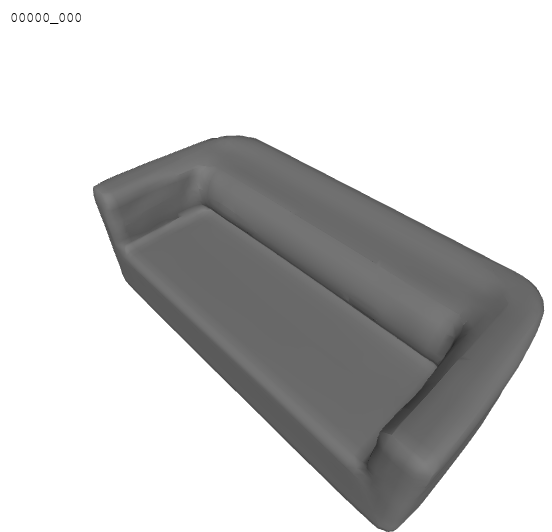

In [26]:
from exercise_3.util.mesh_collection_to_gif import  meshes_to_gif
from exercise_3.util.misc import show_gif

# create list of meshes (just exported) to be visualized
mesh_paths = sorted([x for x in Path("exercise_3/runs/3_2_deepsdf_generalization/interpolation").iterdir() if int(x.name.split('.')[0].split("_")[1]) == 0], key=lambda x: int(x.name.split('.')[0].split("_")[0]))
mesh_paths = mesh_paths + mesh_paths[::-1]

# create a visualization of the interpolation process
meshes_to_gif(mesh_paths, "exercise_3/runs/3_2_deepsdf_generalization/latent_interp.gif", 20)
show_gif("exercise_3/runs/3_2_deepsdf_generalization/latent_interp.gif")

## Submission

This is the end of exercise 3 🙂. Please create a zip containing all files we provided, everything you modified, your visualization images/gif (no need to submit generated OBJs), including your checkpoints. Name it with your matriculation number(s) as described in exercise 1. Make sure this notebook can be run without problems. Then, submit via Moodle.

**Note**: The maximum submission file size limit for Moodle is 100M. You do not need to submit your overfitting checkpoints; however, the generalization checkpoint will be >200M. The easiest way to still be able to submit that one is to split it with zip like this: `zip -s 100M model_best.ckpt.zip model_best.ckpt` which creates a `.zip` and a `.z01`. You can then submit both files alongside another zip containing all your code and outputs.

**Submission Deadline**: 16.06.2022, 23:55

## References

[1] Dai, Angela, Charles Ruizhongtai Qi, and Matthias Nießner. "Shape completion using 3d-encoder-predictor cnns and shape synthesis." Proceedings of the IEEE Conference on Computer Vision and Pattern Recognition. 2017.

[2] Park, Jeong Joon, et al. "Deepsdf: Learning continuous signed distance functions for shape representation." Proceedings of the IEEE/CVF Conference on Computer Vision and Pattern Recognition. 2019.